In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days

%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("~/Desktop/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

34


In [87]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d_R.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: Richards')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print ("bi-logisticQ approximation splitting point: %d"%(vL))
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print ("tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [8]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])*(t- coeffs[3]) )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQR','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d_QR.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logisticQR')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x


In [9]:
dfp = pd.read_csv("~/Desktop/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [10]:
sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

445250514

In [11]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("~/Desktop/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [12]:
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,954532,North America,North America,NaN,2298.0,140.0,17724.0,NaN,1227253,71920.0,200801.0,NaN,NaN
1,742300,Europe,Europe,NaN,79.0,12.0,18030.0,NaN,1399142,137421.0,519421.0,NaN,NaN
2,239144,Asia,Asia,NaN,136.0,2.0,5627.0,NaN,533977,18963.0,275870.0,NaN,NaN
3,116920,South America,South America,NaN,222.0,6.0,9816.0,NaN,190321,9486.0,63915.0,NaN,NaN
4,1127,Australia/Oceania,Oceania,NaN,19.0,1.0,31.0,NaN,8367,113.0,7127.0,NaN,NaN


In [13]:
df.tail()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
224,116920,South America,Total:,NaN,222.0,6.0,9816.0,NaN,190321,9486.0,63915.0,NaN,NaN
225,1127,Australia/Oceania,Total:,NaN,19.0,1.0,31.0,NaN,8367,113.0,7127.0,NaN,NaN
226,25915,Africa,Total:,NaN,91.0,5.0,126.0,NaN,41537,1696.0,13926.0,NaN,NaN
227,61,NaN,Total:,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
228,447423,Europe,European Union,237.551663,79.0,12.0,13378.0,23623.957007,1022788,105770.0,469345.0,10518579.0,2297.106837


In [14]:
dfAll.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,954532,North America,North America,NaN,2298.0,140.0,17724.0,NaN,1227253,71920.0,200801.0,NaN,NaN
1,742300,Europe,Europe,NaN,79.0,12.0,18030.0,NaN,1399142,137421.0,519421.0,NaN,NaN
2,239144,Asia,Asia,NaN,136.0,2.0,5627.0,NaN,533977,18963.0,275870.0,NaN,NaN
3,116920,South America,South America,NaN,222.0,6.0,9816.0,NaN,190321,9486.0,63915.0,NaN,NaN
4,1127,Australia/Oceania,Oceania,NaN,19.0,1.0,31.0,NaN,8367,113.0,7127.0,NaN,NaN


In [15]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
88,760,Europe,Lithuania,17.0,0.0,0.0,17.0,48771.0,1399,45.0,594.0,132768.0,514.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


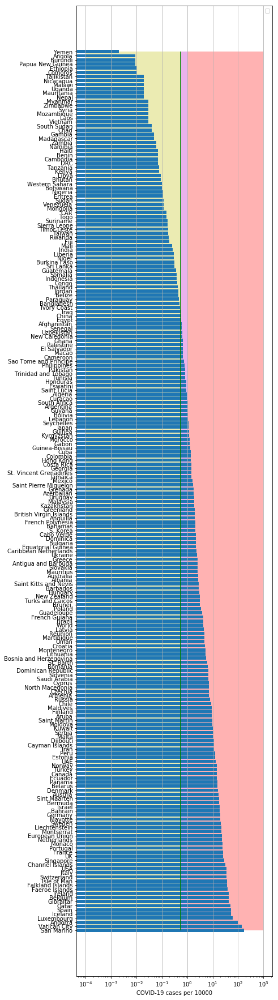

In [16]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


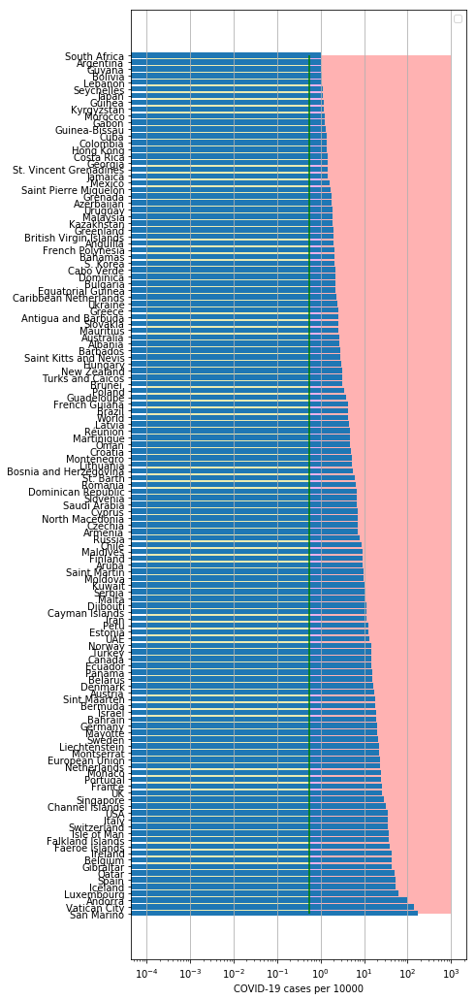

In [17]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="coronage1.png")

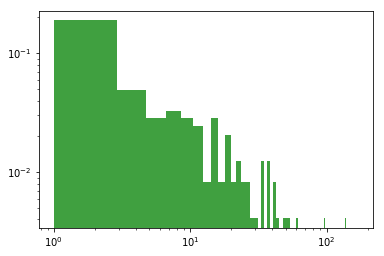

In [18]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [19]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
          date   cases  active    death
62 2020-04-27  229422   85069  24198.0
63 2020-04-28  232128   84403  23822.0
64 2020-04-29  236899   79695  24275.0
65 2020-04-30  239639   77112  24543.0
66 2020-05-01  242988   75714  24824.0
GB
          date   cases  active    death
61 2020-04-27  157149  135713  24393.0
62 2020-04-28  161145  139123  25302.0
63 2020-04-29  165221  138780  26097.0
64 2020-04-30  171253  144138  26771.0
65 2020-05-01  177454  149600  27510.0
IT
          date   cases  active    death
64 2020-04-27  199414  105813  26977.0
65 2020-04-28  201505  105205  27359.0
66 2020-04-29  203591  104657  27682.0
67 2020-04-30  205463  101551  27967.0
68 2020-05-01  207428  100943  28236.0
LT
          date  cases  active  death   tests
49 2020-04-27   1344     931   41.4  111806
50 2020-04-28   1375     764   44.0  118201
51 2020-04-29   1385     751   45.0  125555
52 2020-04-30   1399     760   45.0  132768
53 2020-05-01   1406     728   45.0  138270
Ukr
          date

IE
          date  cases  active  death
49 2020-04-27   9096  7180.0  765.0
50 2020-04-28   9511  7484.0  773.0
51 2020-04-29   9771  7596.0  784.0
52 2020-04-30  10118  7804.0  792.0
53 2020-05-01  10551  8160.0  800.0
MX
          date  cases  active   death
50 2020-04-27  15529  5009.0  1434.0
51 2020-04-28  16752  3760.0  1569.0
52 2020-04-29  17799  4644.0  1732.0
53 2020-04-30  19224  5942.0  1859.0
54 2020-05-01  20739  6390.0  1972.0
PM
          date  cases  active  death
48 2020-04-27   6021  5399.0  167.0
49 2020-04-28   6200  5540.0  176.0
50 2020-04-29   6378  5673.0  178.0
51 2020-04-30   6532  5768.0  188.0
52 2020-05-01   6720  5906.0  192.0
PU
          date  cases   active   death
51 2020-04-27  28699  19492.0   782.0
52 2020-04-28  31190  21157.0   854.0
53 2020-04-29  33931  22951.0   943.0
54 2020-04-30  36976  25520.0  1051.0
55 2020-05-01  40459  28206.0  1124.0
SB
          date  cases  active  death
48 2020-04-27   8275  6904.0  162.0
49 2020-04-28   8497  7069

In [20]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)

In [21]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.8144708180517595
intercept: -3.145362781222279
slope: [0.13714056]


/usr/local/lib/python3.5/dist-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


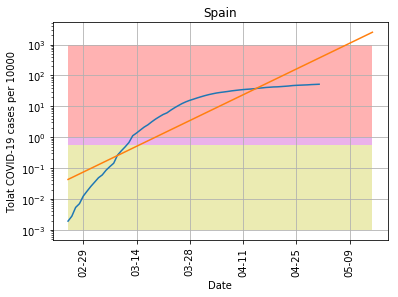

In [22]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-05-15', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("coronaSP.png")
plt.show()

In [23]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.915796890029416
intercept: -4.657661743796957
slope: [0.14656988]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


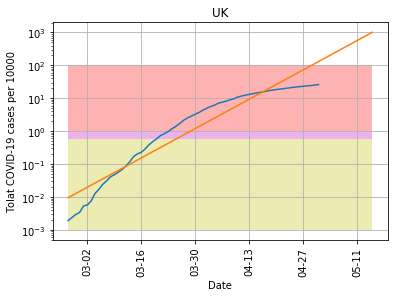

In [24]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-05-15', "coronaGB.png", model1, 'UK',100)

In [25]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0718751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9948570514359175
intercept: 1.9498475449423724
slope: [-0.05222936]


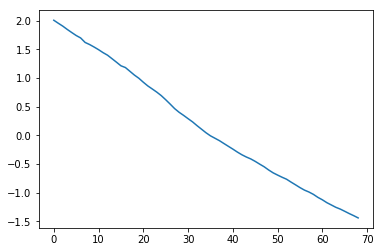

In [26]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


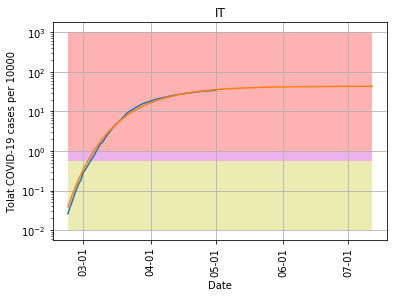

In [27]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("coronaIT.png")
plt.show()

In [28]:
cs=y_pred11[-1]/10000.*populationIT

In [29]:
cs

261546.4554336608

In [30]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT,populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:33: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


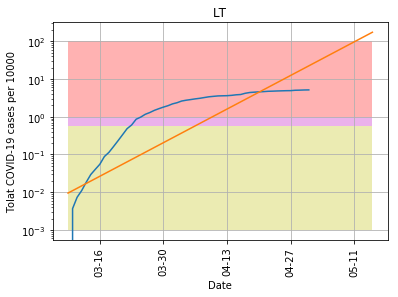

In [31]:
ss1t = plotpred(dfLT,populationLT,'2020-03-09', '2020-05-15', "coronaLT.png", model1, 'LT',100)

In [32]:
#ss1t

In [33]:
36*0.9665024109925366

34.79408679573132

In [34]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9948570514359175
intercept: -6.500174642840944
slope: [0.1685342]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


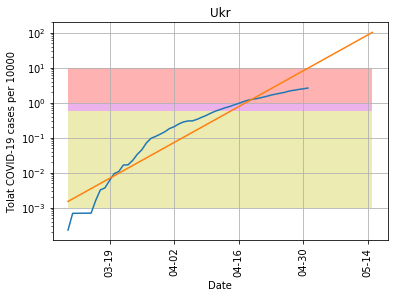

In [35]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-05-15', "coronaUkr.png", model11, 'Ukr',10)

In [36]:
#dfT = pd.read_csv("~/Desktop/coronaTests.csv",",")

In [37]:
#dfT.head()

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


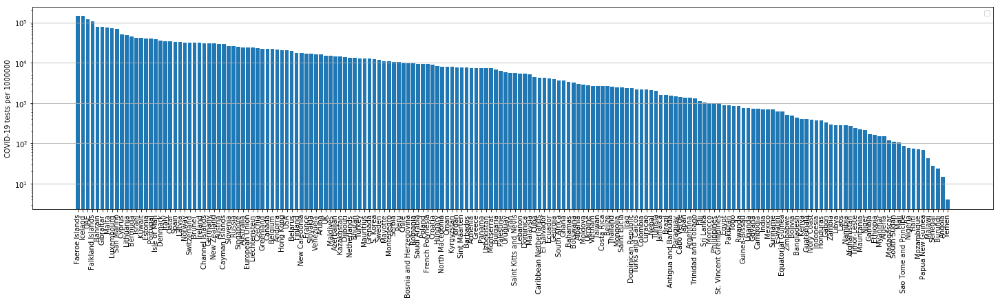

In [38]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("coronaTests.png")
plt.show()

In [39]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9948570514359175
intercept: -4.276443515549751
slope: [0.15707328]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


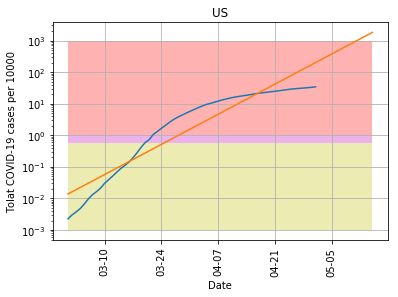

In [40]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-05-15', "coronaUS.png", model11, 'US',1000)

In [41]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
228  European Union  0.103413


(0, 0.15)

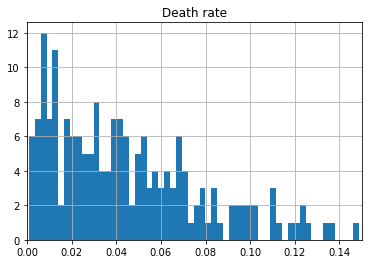

In [42]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

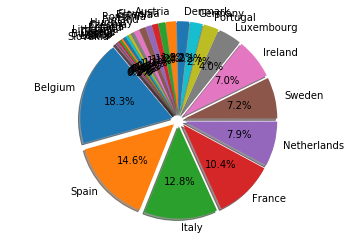

In [43]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [44]:
dfTTh.head()

,Country,Deathsper1Mpop
18,Belgium,665.0
8,Spain,531.0
9,Italy,467.0
11,France,377.0
20,Netherlands,286.0


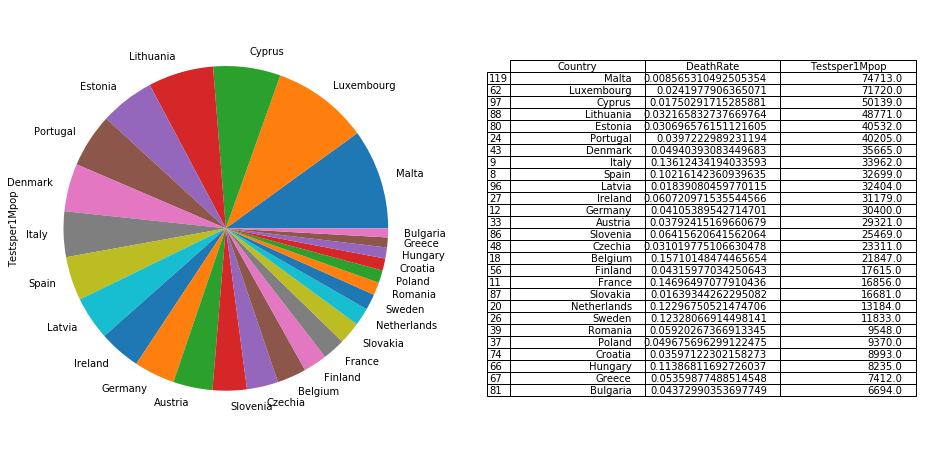

In [45]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("DeathRate2.png")
plt.show()

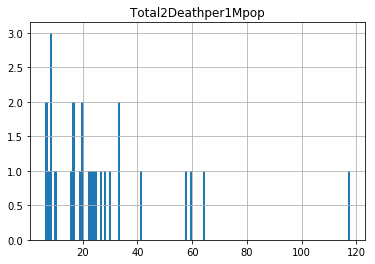

In [46]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [47]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
8,Spain,5197.0,531.0
9,Italy,3431.0,467.0
11,France,2564.0,377.0
12,Germany,1958.0,80.0
18,Belgium,4231.0,665.0


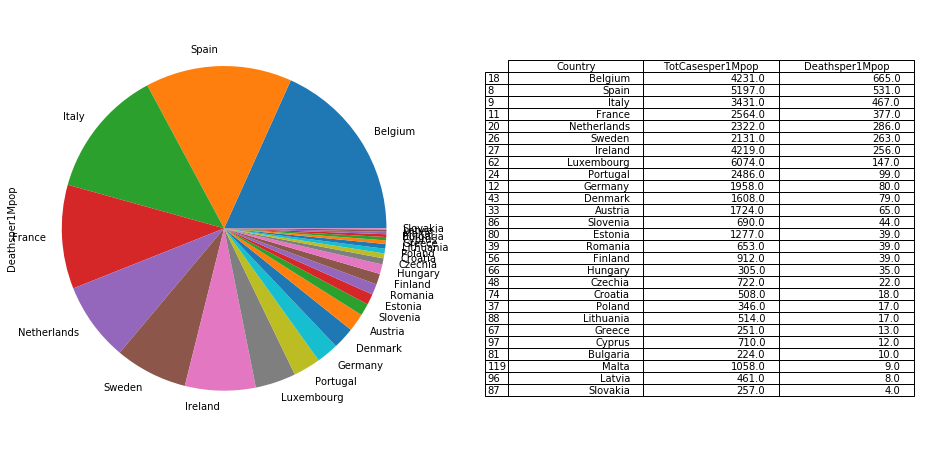

In [48]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("DeathRate1.png")
plt.show()

In [49]:
dfAll.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,954532,North America,North America,0.0,2298.0,140.0,17724.0,0.0,1227253,71920.0,200801.0,0.0,0.0
1,742300,Europe,Europe,0.0,79.0,12.0,18030.0,0.0,1399142,137421.0,519421.0,0.0,0.0
2,239144,Asia,Asia,0.0,136.0,2.0,5627.0,0.0,533977,18963.0,275870.0,0.0,0.0
3,116920,South America,South America,0.0,222.0,6.0,9816.0,0.0,190321,9486.0,63915.0,0.0,0.0
4,1127,Australia/Oceania,Oceania,0.0,19.0,1.0,31.0,0.0,8367,113.0,7127.0,0.0,0.0


In [50]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
8,Spain,0.158935
9,Italy,0.101025
11,France,0.152112
12,Germany,0.064408
18,Belgium,0.193665


In [51]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

In [52]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))

     Country  Cases2Testsper1Mpop
     Belgium             0.193665
      Sweden             0.180090
 Netherlands             0.176123
       Spain             0.158935
      France             0.152112
     Ireland             0.135315
       Italy             0.101025
  Luxembourg             0.084690
     Romania             0.068391
     Germany             0.064408
    Portugal             0.061833
     Austria             0.058797
     Croatia             0.056488
     Finland             0.051774
     Denmark             0.045086
     Hungary             0.037037
      Poland             0.036926
      Greece             0.033864
    Bulgaria             0.033463
     Estonia             0.031506
     Czechia             0.030973
    Slovenia             0.027092
    Slovakia             0.015407
      Latvia             0.014227
       Malta             0.014161
      Cyprus             0.014161
   Lithuania             0.010539


In [53]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
36,Qatar,0.000851,33920.000000
30,Singapore,0.000936,24600.000000
91,Djibouti,0.001823,13918.000000
117,Maldives,0.002037,14815.000000
64,Bahrain,0.002524,78799.000000
132,Equatorial Guinea,0.003175,609.000000
92,Hong Kong,0.003846,20674.000000
135,Guinea-Bissau,0.003891,762.000000
73,Uzbekistan,0.004298,7247.000000
68,Oman,0.004495,7923.000000


In [54]:
#dfTst = pd.read_csv("~/Desktop/tests.csv",",")

In [55]:
#y = dfT['tests']
#x = np.array(range(dfTst['tests'].size)).reshape((-1, 1))
#model = LinearRegression().fit(x, y)
#r_sq = model.score(x, y)
#print('coefficient of determination:', r_sq)
#print('intercept:', model.intercept_)
#print('slope:', model.coef_)

In [81]:
#f = lambda t:128.01 + np.exp(0.36*(t + 2) - 5.21) - 38.95*t - 88.08

In [82]:
#f(54)

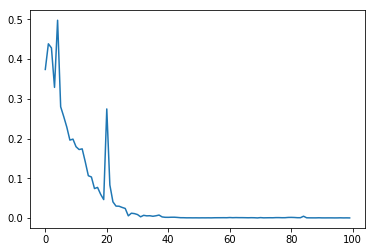

In [56]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [57]:
#np.diff(np.log(dfCN["cases"].values))

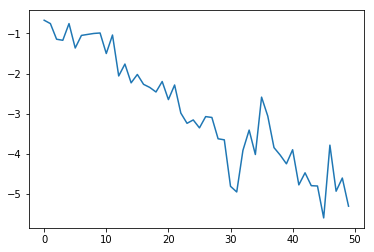

In [58]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until


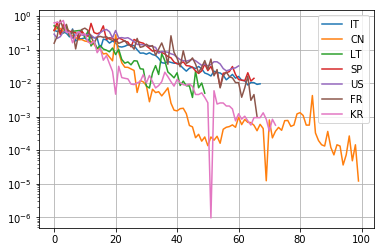

In [59]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

61 61
coefficient of determination: 0.9442226998542661
intercept: -7.311104881166656
slope: [-0.19972895]


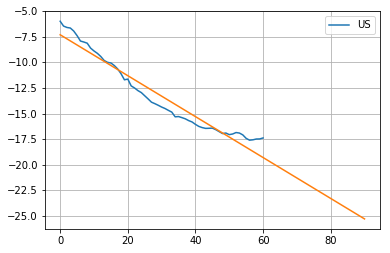

In [60]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("logdiffUS.png")
plt.show()

68 68
coefficient of determination: 0.926784754202108
intercept: -8.705630867371099
slope: [-0.14174917]


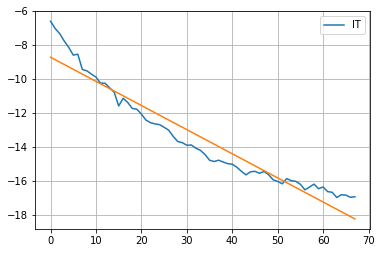

In [61]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [62]:
#model11.coef_

In [63]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

50 50
coefficient of determination: 0.9763403707070663
intercept: -14.355493287910095
slope: [-0.09795929]


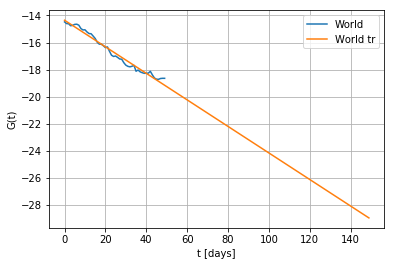

In [64]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("logdifflogcoronaW.png")

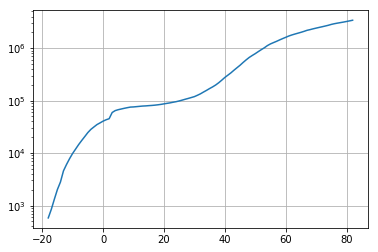

In [65]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [66]:
dfW['cases'].values

array([    580,     845,    1317,    2015,    2800,    4581,    6058,
          7813,    9823,   11950,   14553,   17391,   20630,   24545,
         28266,   31439,   34876,   37552,   40553,   43099,   45134,
         59287,   64438,   67100,   69197,   71329,   73332,   75184,
         75700,   76677,   77673,   78651,   79205,   80087,   80828,
         81820,   83112,   84615,   86604,   88585,   90443,   93016,
         95314,   98425,  102050,  106099,  109991,  114381,  118948,
        126214,  134576,  145483,  156653,  169593,  182490,  198238,
        218822,  244933,  275597,  305036,  337489,  378860,  422629,
        471035,  531864,  596366,  663079,  723279,  784738,  858355,
        936237, 1016330, 1117928, 1203058, 1274578, 1347566, 1432869,
       1519195, 1605277, 1700004, 1780713, 1853505, 1925330, 2000065,
       2084633, 2183942, 2252370, 2332650, 2407467, 2482272, 2557917,
       2638909, 2725972, 2833697, 2921571, 2995209, 3065871, 3139009,
       3221029, 3308

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 4.82834808e+06  2.94229173e+00 -1.85334974e+01  1.69232463e-02]


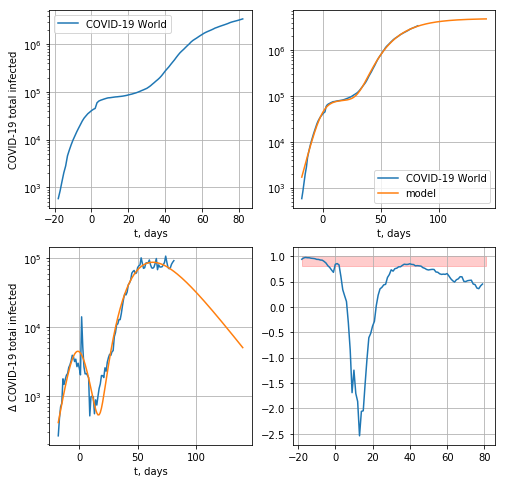

18381.109368431546


In [67]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

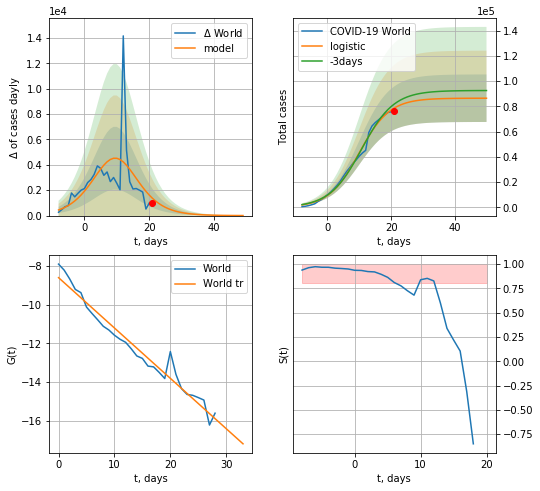

World data at: 2020-05-01
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +29 days
	 deltaDaycases:  4
	 total cases:  86453 ± 18830
	 total death:  6090 ± 3979
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


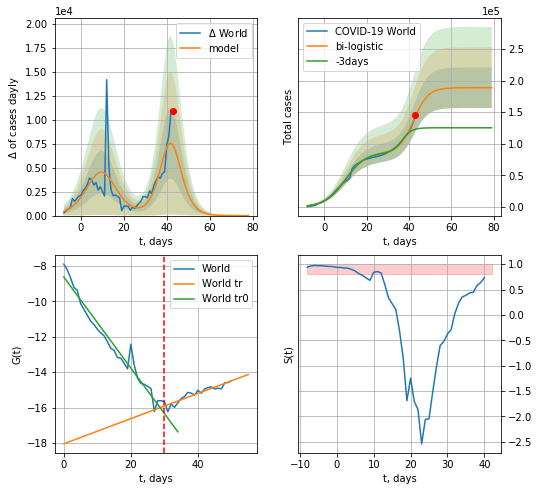

World data at: 2020-05-01
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +36 days
	 deltaDaycases:  0
	 total cases:  188699 ± 32065
	 total death:  13293 ± 6776
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


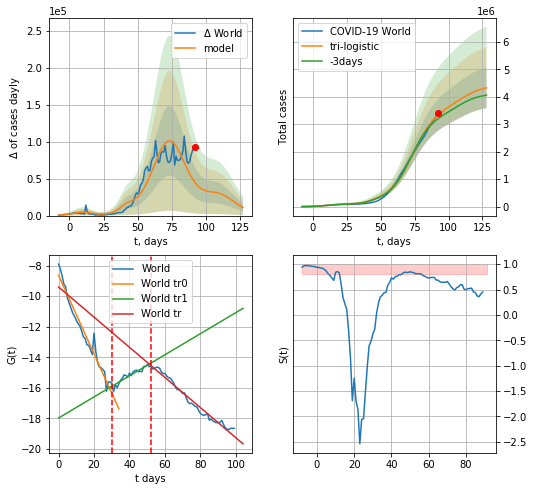

World data at: 2020-05-01
+3 day model MAPE: 0.04234567659181243
model: tri-logistic
coeffs:  [3.38676813e+06 1.18097245e-01 7.35313304e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.1710266741300097
forecast at the end of period: +36 days
	 deltaDaycases:  10930
	 total cases:  4323581 ± 739447
	 total death:  304585 ± 156276
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.974190
 intercept: -9.396212
 slope: -0.098696


In [68]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

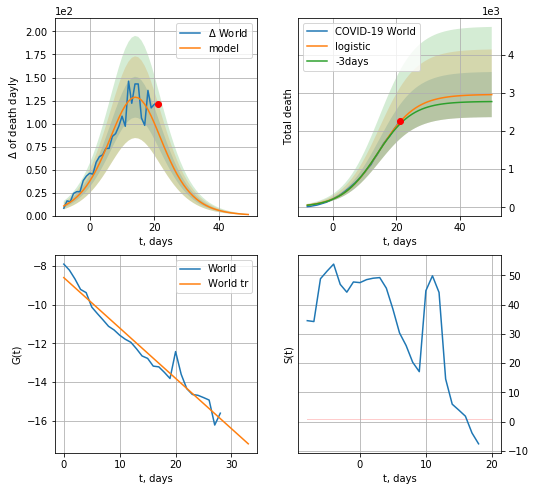

World data at: 2020-05-01
+3 day model MAPE: 0.02922470086968507
model: logistic
coeffs:  [2.95655981e+03 1.74166848e-01 1.46351620e+01]
rational stdev:  0.20032621918861032
forecast at the end of period: +29 days
	 total death:  2950 ± 591
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


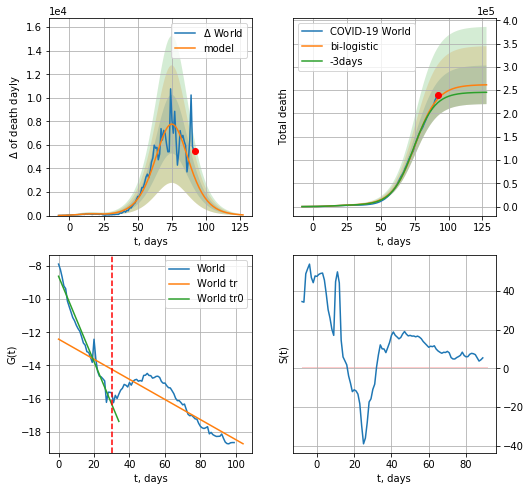

World data at: 2020-05-01
+3 day model MAPE: 0.038918409020150875
model: bi-logistic
coeffs:  [2.59068077e+05 1.20012084e-01 7.53545019e+01] [2.95655981e+03 1.74166848e-01 1.46351620e+01]
rational stdev:  0.158475194772278
forecast at the end of period: +36 days
	 deltaDaydeath:  59
	 total death:  261558 ± 41450
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.753570
 intercept: -12.415918
 slope: -0.060565


In [69]:
vL = 30
vL1=52
x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[:],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [70]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


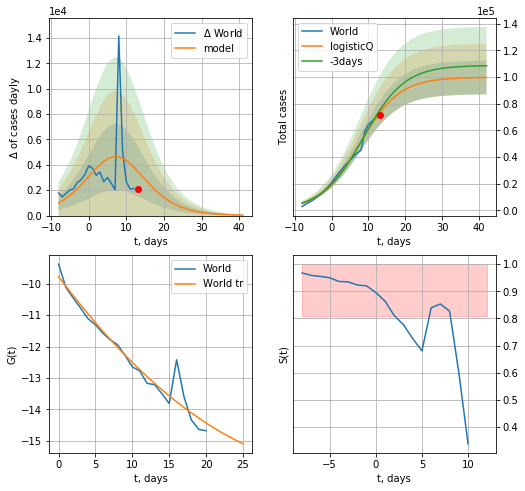

World data at: 2020-05-01
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +29 days
	 deltaDaycases: 33
	 total cases: 99699 ± 12657
	 total death: 7023 ± 2674
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


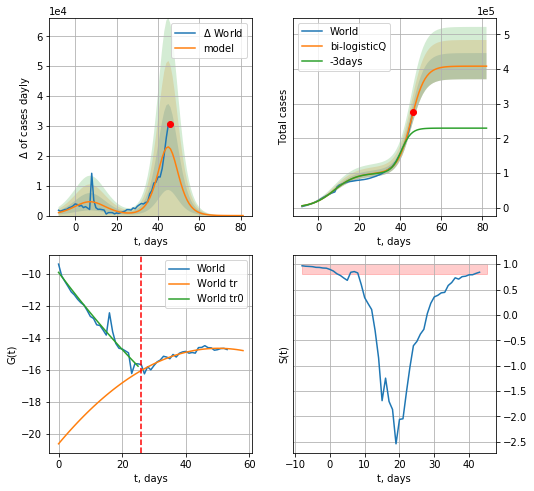

World data at: 2020-05-01
+3 day model MAPE: 0.322399
model: bi-logisticQ
coeffs: [ 3.08550720e+05  9.52088730e-05  4.52981129e+01 -3.08910430e+03]
rational stdev: 0.092561
forecast at the end of period: +36 days
	 deltaDaycases: 1
	 total cases: 408410 ± 37802
	 total death: 28771 ± 7989
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


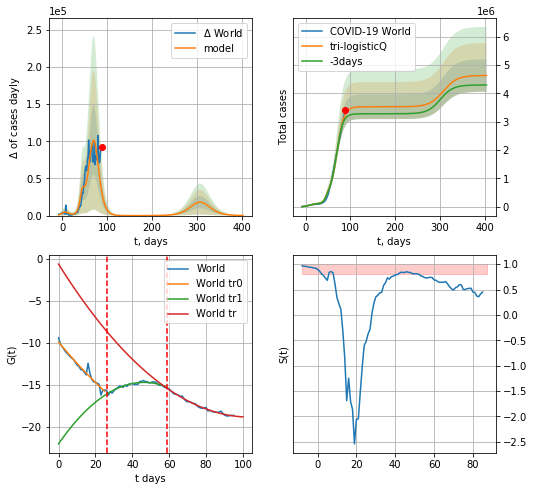

World data at: 2020-05-01
+3 day model MAPE: 0.048398
model: bi-logisticQ
coeffs: [ 3.11650074e+06  5.52925237e-06  7.05863274e+01 -2.34749051e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.123549
forecast at the end of period: +316 days
	 deltaDaycases: 136
	 total cases: 4626657 ± 571620
	 total death: 325935 ± 120807
tri-logisticQ approximation splitting points: 26,59
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.874764
 intercept_: -22.035447570025077
 coeffs_: [ 0.          0.31660897 -0.00341999]
trend coefficient of determination: 0.988881
 intercept_: -0.593904199773867
 coeffs_: [ 0.         -0.35113113  0.00168812]


In [77]:
vL=30 - 4
vL1=59
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*9-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*50-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

In [99]:
#x = forecastR("World",dfW[:30],d1,7*9-dT,1.0)
#xx = forecast2R("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


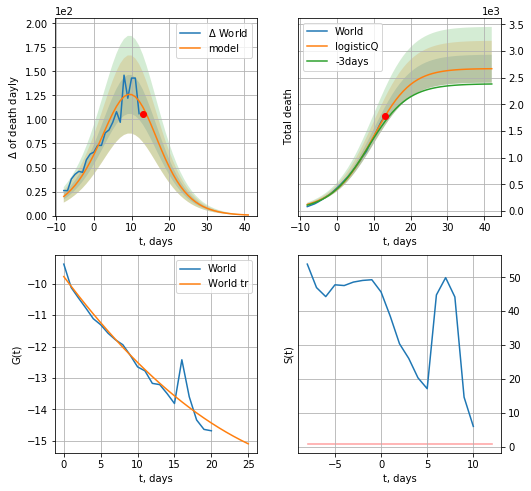

World data at: 2020-05-01
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +29 days
	 total death: 2667 ± 261
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


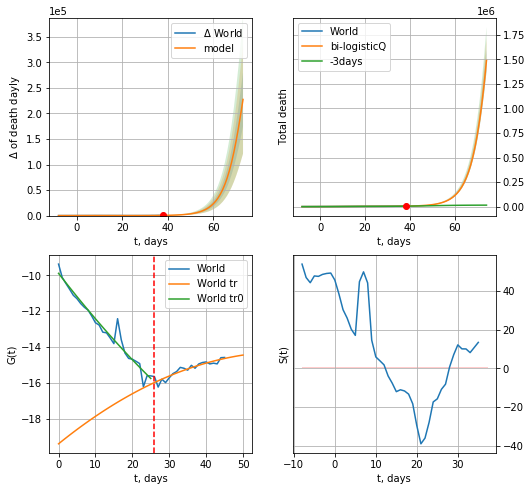

World data at: 2020-05-01
+3 day model MAPE: 0.10565529103719425
model: bi-logisticQ
coeffs:  [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02] [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev:  0.07659002399997471
forecast at the end of period: +36 days
	 deltaDaydeath:  227468
	 total death:  1488262 ± 113986
bi-logistic approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:380: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


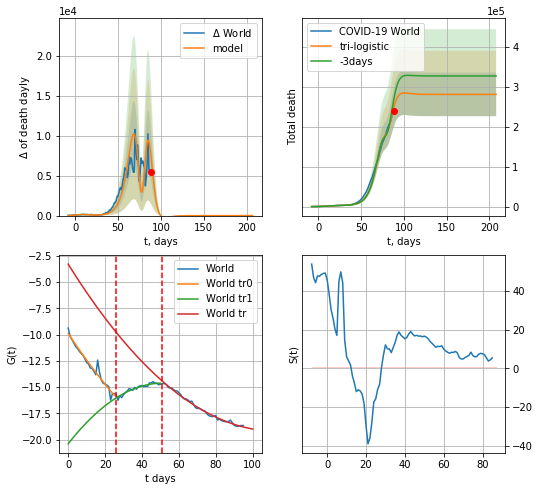

World data at: 2020-05-01
+3 day model MAPE: 0.0841193074515938
model: tri-logistic
coeffs:  [-6.14333915e+06  1.08738700e-04  7.96836810e+01 -2.01159763e+03] [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02
  6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
forecast rational stdev:  0.19367419785364667
forecast at the end of period: +120 days
	 deltaDaydeath:  0
	 total death:  281372 ± 54494
tri-logistic approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.991564
 intercept_: -3.299213480047852
 coeffs_: [ 0.         -0.28148732  0.00124726]


In [100]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*9-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


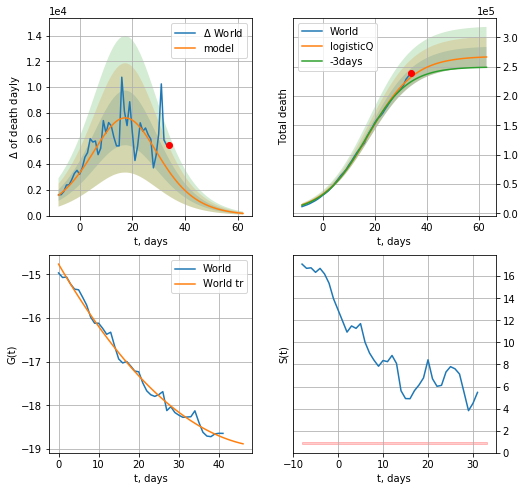

World data at: 2020-05-01
+3 day model MAPE: 0.037705
model: logisticQ
coeffs: [ 2.67813157e+05  6.47545737e-05  1.76037082e+01 -1.73554099e+03]
rational stdev: 0.064162
forecast at the end of period: +29 days
	 total death: 266465 ± 17097
trend coefficient of determination: 0.991226
 intercept_: -14.764042467877175
 coeffs_: [ 0.         -0.15764423  0.00148045]


In [101]:
x = forecastRRR("World",dfW[58:],d1,7*9-dT,1.0,False,cases='death')

In [92]:
#trend(dfSP,'SP',10)

In [93]:
#np.log(np.diff(dfFR["cases"].values)[:]/dfFR["cases"].values[1:]**2)

In [94]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

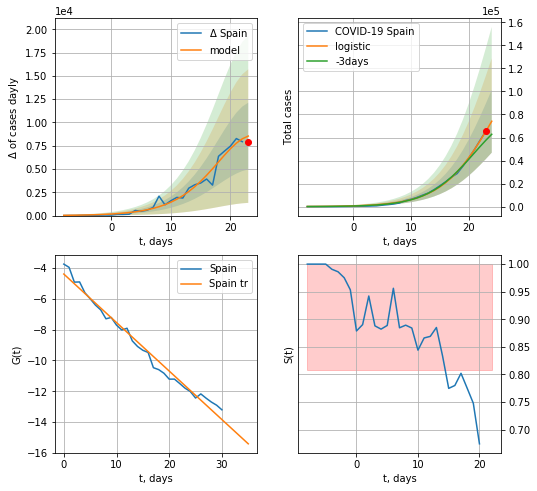

Spain data at: 2020-05-01
+3 day model MAPE: 0.17994225331219452
model: logistic
coeffs:  [1.55796358e+05 2.21769203e-01 2.44355993e+01]
rational stdev:  0.3682790859287634
forecast at the end of period: +1 days
	 deltaDaycases:  8536
	 total cases:  74138 ± 27303
	 total death:  7574 ± 8368
trend coefficient of determination: 0.981962
 intercept: -4.388643
 slope: -0.315050


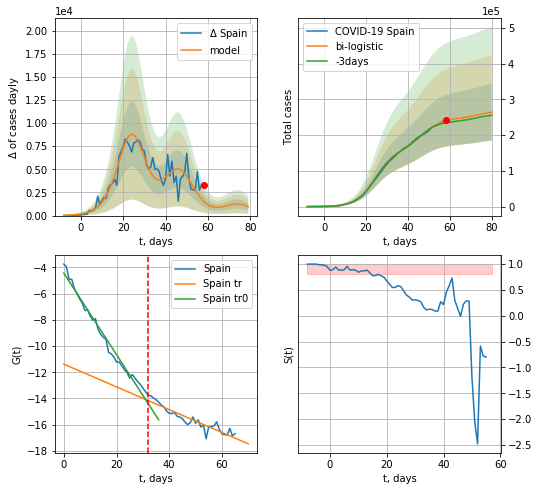

Spain data at: 2020-05-01
+3 day model MAPE: 0.025327027369179664
model: bi-logistic
coeffs:  [9.16215213e+04 2.09411928e-01 4.67180048e+01] [1.55796358e+05 2.21769203e-01 2.44355993e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.3009338297022761
forecast at the end of period: +22 days
	 deltaDaycases:  965
	 total cases:  264514 ± 79601
	 total death:  27023 ± 24396
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.981698
 intercept: -4.427117
 slope: -0.311203
trend coefficient of determination: 0.868955
 intercept: -11.376787
 slope: -0.086937


In [102]:
vL = 32#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,5*7-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*8-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

SP
          date   cases  active    death
62 2020-04-27  229422   85069  24198.0
63 2020-04-28  232128   84403  23822.0
64 2020-04-29  236899   79695  24275.0
65 2020-04-30  239639   77112  24543.0
66 2020-05-01  242988   75714  24824.0


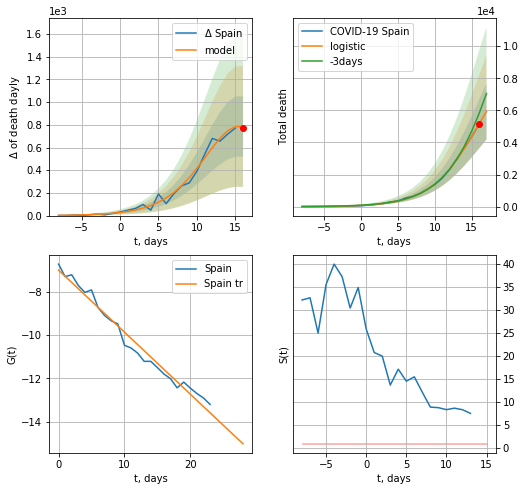

Spain data at: 2020-05-01
+3 day model MAPE: 0.15747030887395475
model: logistic
coeffs:  [1.03877331e+04 3.04619794e-01 1.60547713e+01]
rational stdev:  0.29538659014568974
forecast at the end of period: +1 days
	 total death:  5936 ± 1753
trend coefficient of determination: 0.976452
 intercept: -6.992078
 slope: -0.287044


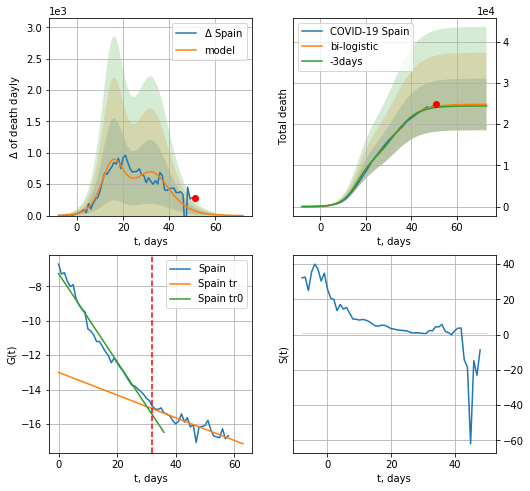

Spain data at: 2020-05-01
+3 day model MAPE: 0.012845316043719322
model: bi-logistic
coeffs:  [1.44010530e+04 1.88462215e-01 3.28371238e+01] [1.03877331e+04 3.04619794e-01 1.60547713e+01]
rational stdev:  0.25275335688805645
forecast at the end of period: +22 days
	 deltaDaydeath:  1
	 total death:  24781 ± 6263
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.975844
 intercept: -7.265510
 slope: -0.256124
trend coefficient of determination: 0.764300
 intercept: -13.004770
 slope: -0.065859


In [103]:
vL = 32#len(dfSP[:])-7-dT
dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,5*7-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*8-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


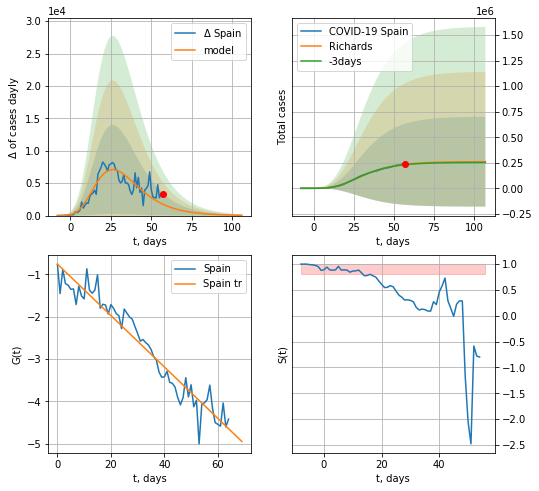

Spain data at: 2020-05-01
+3 day model MAPE: 0.01869011959954783
model: Richards
coeffs:  [ 2.61475400e+05  6.94442566e+00 -3.44671345e+01  1.06885150e-02]
rational stdev:  1.6859302808411536
forecast at the end of period: +50 days
	 deltaDaycases:  51
	 total cases:  260802 ± 439695
	 total death:  26644 ± 134759
trend coefficient of determination: 0.934548
 intercept: -0.759192
 slope: -0.060683


In [104]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:72: RuntimeWarning: divide by zero encountered in true_divide


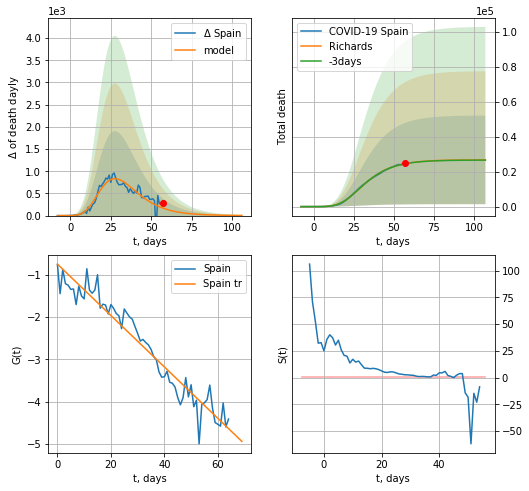

Spain data at: 2020-05-01
+3 day model MAPE: 0.0035418517691056636
model: Richards
coeffs:  [ 2.68065579e+04  8.48991490e+00 -2.62930608e+01  9.99229678e-03]
rational stdev:  0.9479263806719471
forecast at the end of period: +50 days
	 total death:  26773 ± 25379
trend coefficient of determination: 0.934260
 intercept: -0.755049
 slope: -0.060593


In [105]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


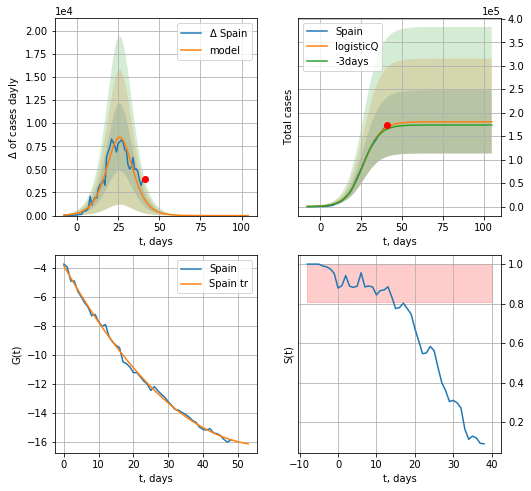

Spain data at: 2020-05-01
+3 day model MAPE: 0.028157
model: logisticQ
coeffs: [ 1.80489569e+05  4.90633148e-06  2.63952659e+01 -3.83458431e+04]
rational stdev: 0.373397
forecast at the end of period: +64 days
	 deltaDaycases: 0
	 total cases: 180489 ± 67394
	 total death: 18439 ± 20655
trend coefficient of determination: 0.997432
 intercept_: -3.859009253100683
 coeffs_: [ 0.         -0.42385579  0.00363487]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:264: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


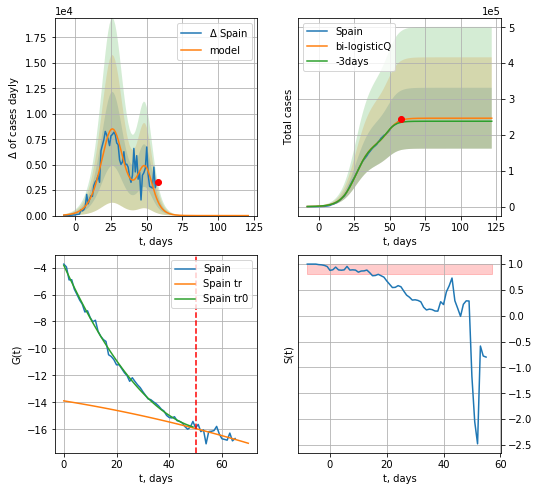

Spain data at: 2020-05-01
+3 day model MAPE: 0.025435011602753948
model: bi-logisticQ
coeffs:  [ 6.60162661e+04  4.72789273e-06  4.92648339e+01 -5.71338738e+04] [ 1.80489569e+05  4.90633148e-06  2.63952659e+01 -3.83458431e+04]
rational stdev:  0.3442221869051798
forecast at the end of period: +64 days
	 deltaDaycases:  0
	 total cases:  246505 ± 84852
	 total death:  25183 ± 26005
bi-logistic approximation splitting point: 50
trend coefficient of determination: 0.997202
 intercept_: -3.834231460165485
 coeffs_: [ 0.         -0.42809872  0.00374483]
trend coefficient of determination: 0.362585
 intercept_: -13.890945960252187
 coeffs_: [ 0.         -0.03148953 -0.00019197]


In [113]:
x = forecastRRR('Spain',dfSP[:50],d1,7*14-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:183: RuntimeWarning: divide by zero encountered in true_divide


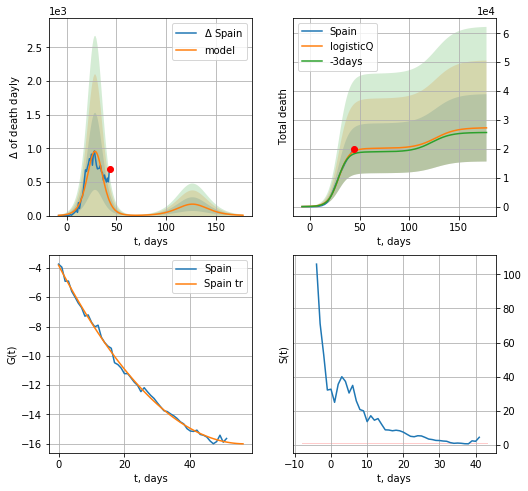

Spain data at: 2020-05-01
+3 day model MAPE: 0.047659
model: logisticQ
coeffs: [ 2.01699087e+04  3.58845360e-06  2.90799625e+01 -5.28330410e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.427384
forecast at the end of period: +134 days
	 total death: 27260 ± 11650
trend coefficient of determination: 0.997257
 intercept_: -3.8205605117453345
 coeffs_: [ 0.         -0.43034096  0.00380056]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:320: RuntimeWarning: divide by zero encountered in true_divide


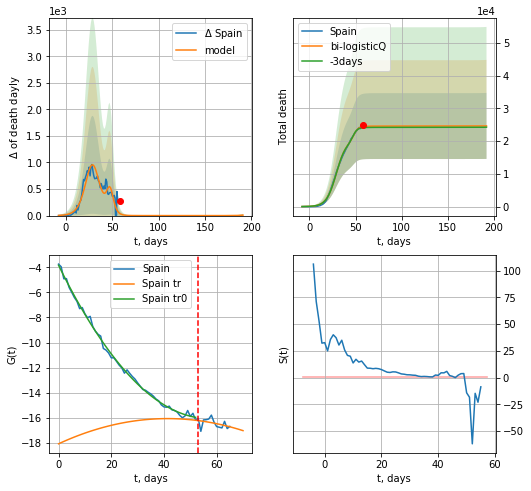

Spain data at: 2020-05-01
+3 day model MAPE: 0.014707851020993576
model: bi-logisticQ
coeffs:  [ 4.44571733e+03  5.67801334e-06  4.79538259e+01 -6.99106095e+04] [ 2.01699087e+04  3.58845360e-06  2.90799625e+01 -5.28330410e+04]
S.Korea scenario coeffs:  [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev:  0.40895939173058393
forecast at the end of period: +134 days
	 deltaDaydeath:  8
	 total death:  24666 ± 10087
bi-logistic approximation splitting point: 53
trend coefficient of determination: 0.997263
 intercept_: -3.832767611938573
 coeffs_: [ 0.         -0.4283769   0.00375264]
trend coefficient of determination: 0.180177
 intercept_: -18.07249642467462
 coeffs_: [ 0.          0.09708986 -0.00117243]


In [116]:
x = forecastRRR('Spain',dfSP[:53],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=53)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


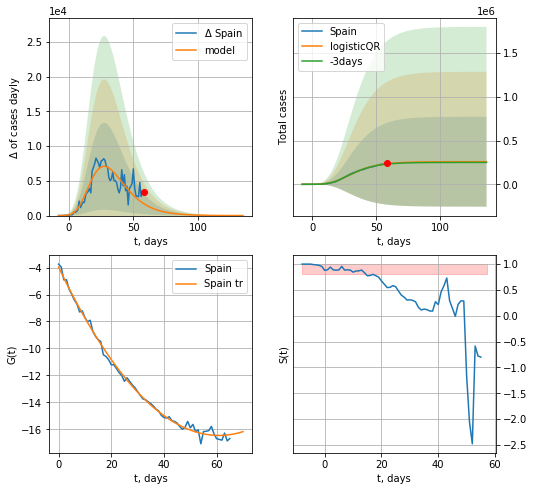

Spain data at: 2020-05-01
+3 day model MAPE: 0.019543720349794767
model: logisticQR
coeffs:  [ 2.58870914e+05  3.86717012e-02 -6.54579624e+01 -1.00347995e+03
  1.71770352e-03]
rational stdev:  1.9842748340535288
forecast at the end of period: +78 days
	 deltaDaycases:  3
	 total cases:  258834 ± 513599
	 total death:  26442 ± 157404
trend coefficient of determination: 0.995661
 intercept_: -3.9587901803305954
 coeffs_: [ 0.         -0.41076128  0.00337553]


In [117]:
x = forecastQR('Spain',dfSP[:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

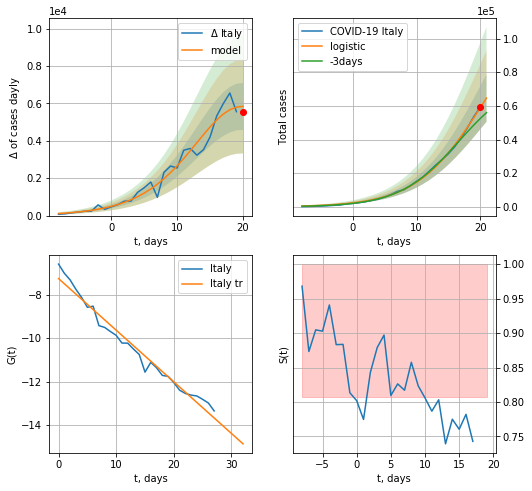

Italy data at: 2020-05-01
+3 day model MAPE: 0.1545703725042627
model: logistic
coeffs:  [1.21492367e+05 1.92504372e-01 2.03342758e+01]
rational stdev:  0.21800555140478417
forecast at the end of period: +1 days
	 deltaDaycases:  5840
	 total cases:  64633 ± 14090
	 total death:  8798 ± 5754
trend coefficient of determination: 0.973351
 intercept: -7.256152
 slope: -0.237823


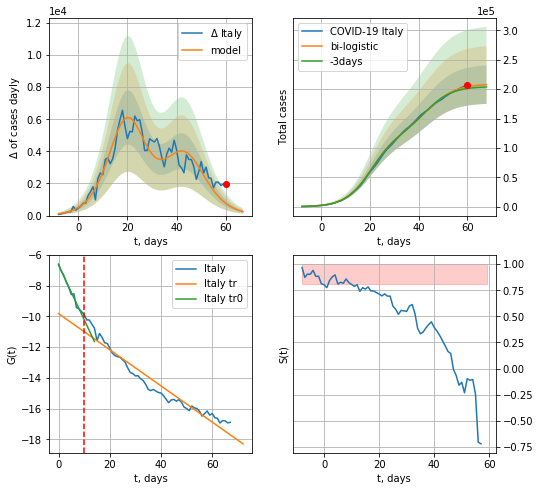

Italy data at: 2020-05-01
+3 day model MAPE: 0.015671466483583838
model: bi-logistic
coeffs:  [8.76843292e+04 1.70915018e-01 4.36474675e+01] [1.21492367e+05 1.92504372e-01 2.03342758e+01]
rational stdev:  0.15758561564268758
forecast at the end of period: +8 days
	 deltaDaycases:  248
	 total cases:  207819 ± 32749
	 total death:  28289 ± 13373
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.940252
 intercept: -9.814327
 slope: -0.117838


In [118]:
x = forecast('Italy',dfIT[:-6-dT],d1,5*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,6*7-dT,x,1.0)

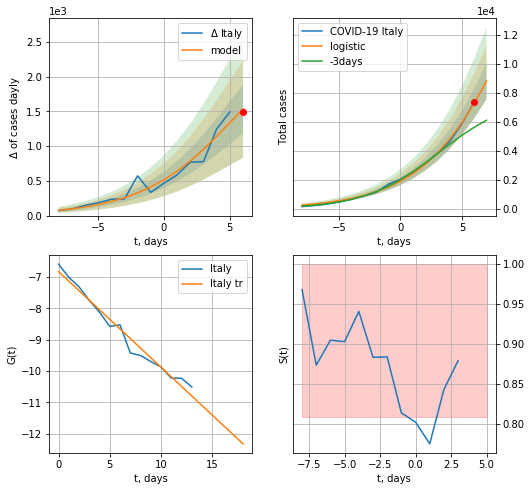

Italy data at: 2020-05-01
+3 day model MAPE: 0.4420796150765939
model: logistic
coeffs:  [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.1413171221665118
forecast at the end of period: +1 days
	 deltaDaycases:  1534
	 total cases:  8819 ± 1246
	 total death:  1200 ± 508
trend coefficient of determination: 0.972659
 intercept: -6.827339
 slope: -0.305199


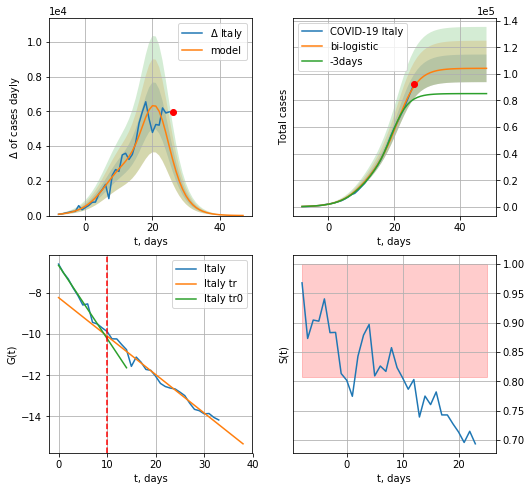

Italy data at: 2020-05-01
+3 day model MAPE: 0.1396868970300245
model: bi-logistic
coeffs:  [7.26693885e+04 3.23703466e-01 2.12981095e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.09972560756251159
forecast at the end of period: +22 days
	 deltaDaycases:  5
	 total cases:  104164 ± 10387
	 total death:  14179 ± 4242
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.981847
 intercept: -8.219306
 slope: -0.187258


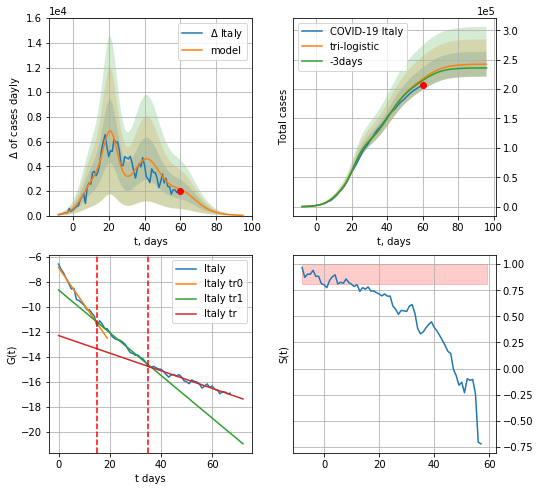

Italy data at: 2020-05-01
+3 day model MAPE: 0.012961044982784303
model: tri-logistic
coeffs:  [1.02436582e+05 1.71876846e-01 4.13923349e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01 7.26693885e+04
 3.23703466e-01 2.12981095e+01]
scenario coeffs:  [0.35, 1.0, 1.5]
forecast rational stdev:  0.08716450654094145
forecast at the end of period: +36 days
	 deltaDaycases:  21
	 total cases:  242355 ± 21124
	 total death:  32990 ± 8626
tri-logistic approximation splitting points: 15,35
trend0 coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544
trend1 coefficient of determination: 0.978019
 intercept: -8.656402
 slope: -0.170599
trend coefficient of determination: 0.962340
 intercept: -12.295046
 slope: -0.070303


In [119]:
vL = 15#len(dfSP[:])-11-dT
vL1=35
x = forecast('Italy',dfIT[:vL],d1,5*7-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.35,1.,1.5],vL=[vL,vL1])

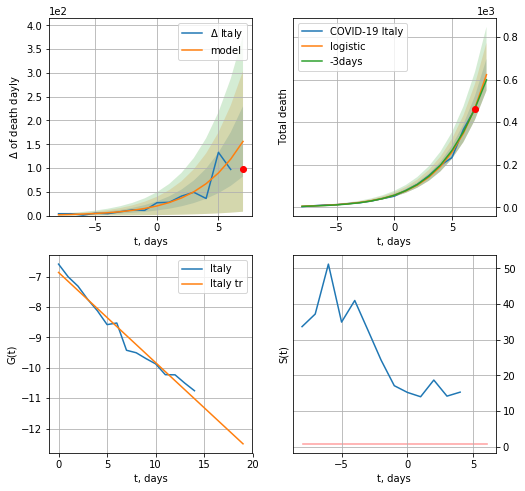

Italy data at: 2020-05-01
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +1 days
	 total death:  622 ± 74
trend coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544


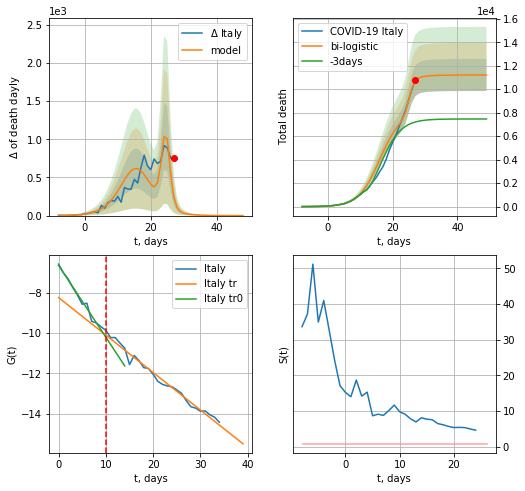

Italy data at: 2020-05-01
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +22 days
	 deltaDaydeath:  0
	 total death:  11211 ± 1365
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


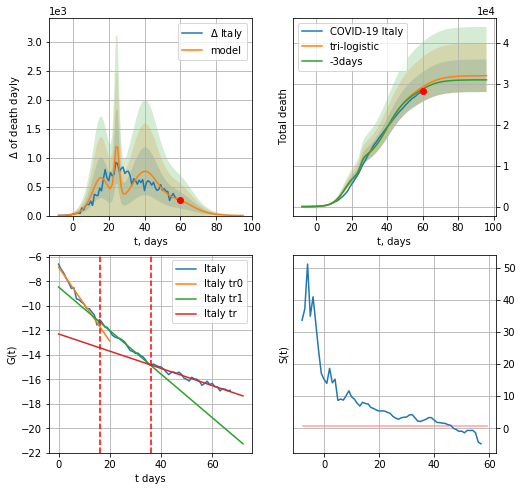

Italy data at: 2020-05-01
+3 day model MAPE: 0.018669552936374394
model: tri-logistic
coeffs:  [1.65990472e+04 1.79313926e-01 4.06039022e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.12438390131294191
forecast at the end of period: +36 days
	 deltaDaydeath:  1
	 total death:  31951 ± 3974
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976838
 intercept: -6.838821
 slope: -0.302120
trend1 coefficient of determination: 0.986419
 intercept: -8.458056
 slope: -0.177939
trend coefficient of determination: 0.958833
 intercept: -12.295657
 slope: -0.070292


In [120]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,5*7-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


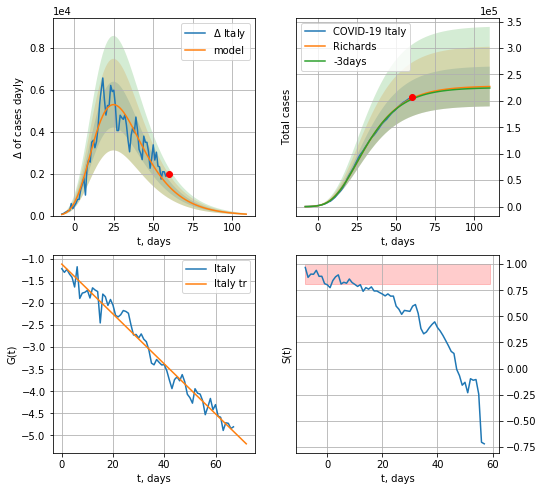

Italy data at: 2020-05-01
+3 day model MAPE: 0.007302230254912688
model: Richards
coeffs:  [ 2.28220825e+05  5.31498572e+00 -4.45912796e+01  1.19267442e-02]
rational stdev:  0.16540963110491727
forecast at the end of period: +50 days
	 deltaDaycases:  69
	 total cases:  227161 ± 37574
	 total death:  30922 ± 15344
trend coefficient of determination: 0.974665
 intercept: -1.116875
 slope: -0.056580


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


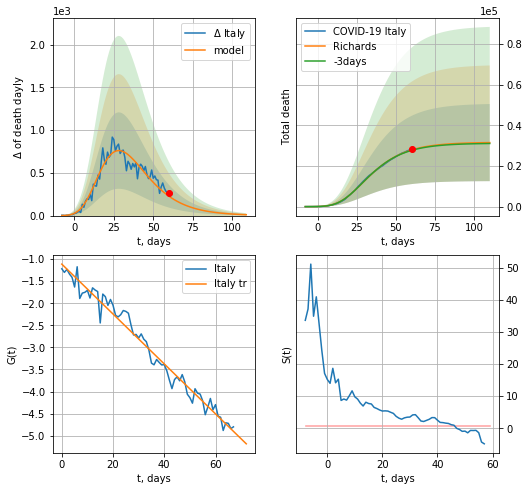

Italy data at: 2020-05-01
+3 day model MAPE: 0.007803453607774768
model: Richards
coeffs:  [ 3.16615117e+04  5.75345068e+00 -3.93379145e+01  1.14286653e-02]
rational stdev:  0.6022963931503941
forecast at the end of period: +50 days
	 total death:  31511 ± 18979
trend coefficient of determination: 0.974605
 intercept: -1.113050
 slope: -0.056537


In [121]:
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0)
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


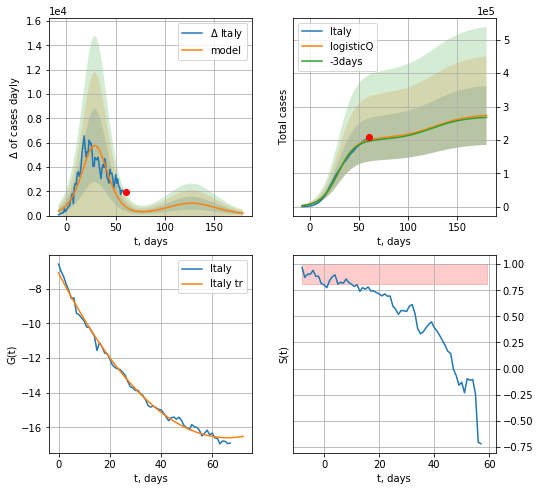

Italy data at: 2020-05-01
+3 day model MAPE: 0.019619
model: logisticQ
coeffs: [ 2.04383665e+05  8.67263057e-07  2.91652029e+01 -1.29590220e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.323334
forecast at the end of period: +120 days
	 deltaDaycases: 191
	 total cases: 273305 ± 88368
	 total death: 37203 ± 36086
trend coefficient of determination: 0.994758
 intercept_: -7.095655278253213
 coeffs_: [ 0.         -0.28813308  0.002185  ]


In [122]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


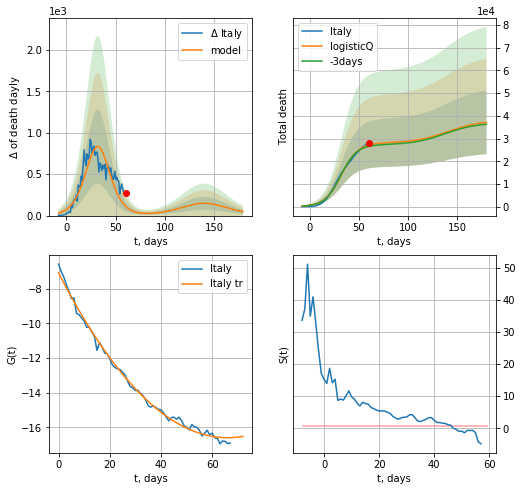

Italy data at: 2020-05-01
+3 day model MAPE: 0.022361
model: logisticQ
coeffs: [ 2.80105178e+04  1.01030143e-06  3.21324987e+01 -1.17666277e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.378098
forecast at the end of period: +120 days
	 total death: 37097 ± 14026
trend coefficient of determination: 0.994758
 intercept_: -7.095655278253213
 coeffs_: [ 0.         -0.28813308  0.002185  ]


In [396]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [123]:
dT

34

FR
          date     cases  active    death
72 2020-04-27  163273.0   97036  23293.0
73 2020-04-28  165911.0   95365  23660.0
74 2020-04-29  166420.0   94105  24087.0
75 2020-04-30  167178.0   93326  24376.0
76 2020-05-01  167346.0   92540  24594.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


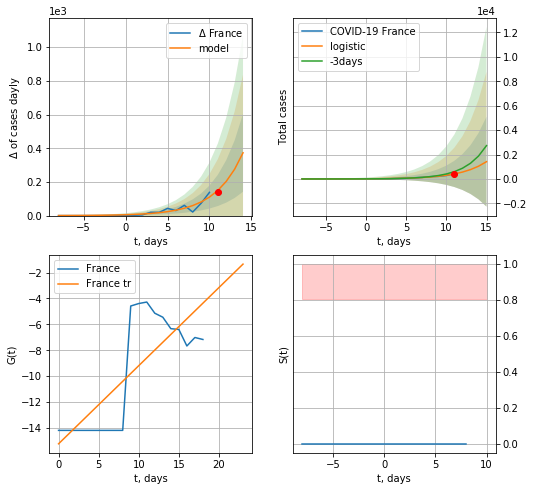

France data at: 2020-05-01
+3 day model MAPE: 0.3579011645535763
model: logistic
coeffs:  [9.13757357e+04 3.09894510e-01 2.83979795e+01]
rational stdev:  2.5989080654975822
forecast at the end of period: +4 days
	 deltaDaycases:  372
	 total cases:  1415 ± 3678
	 total death:  208 ± 1621
trend coefficient of determination: 0.603781
 intercept: -15.217380
 slope: 0.602806


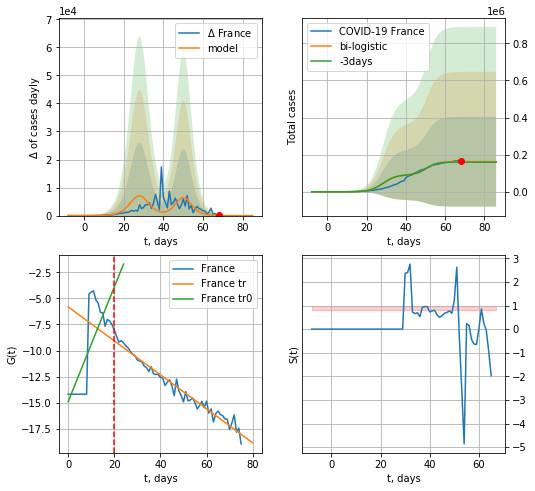

France data at: 2020-05-01
+3 day model MAPE: 0.016396919859530373
model: bi-logistic
coeffs:  [7.08136337e+04 3.65204787e-01 5.05899324e+01] [9.13757357e+04 3.09894510e-01 2.83979795e+01]
rational stdev:  1.4925554727395776
forecast at the end of period: +18 days
	 deltaDaycases:  0
	 total cases:  162189 ± 242076
	 total death:  23836 ± 106729
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.576236
 intercept: -14.895009
 slope: 0.549077
trend coefficient of determination: 0.966899
 intercept: -5.810761
 slope: -0.162781


In [124]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,6*7-dT-4,1.0)
xx = forecast2('France',dfFR,d1,8*7-dT-4,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [125]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

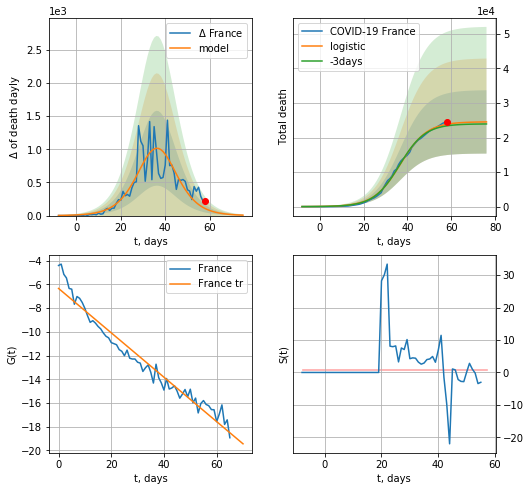

France data at: 2020-05-01
+3 day model MAPE: 0.020517337631579168
model: logistic
coeffs:  [2.45559875e+04 1.65544319e-01 3.67670110e+01]
rational stdev:  0.37398419304243685
forecast at the end of period: +18 days
	 total death:  24518 ± 9169
trend coefficient of determination: 0.954820
 intercept: -6.331962
 slope: -0.187346


In [126]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*8-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


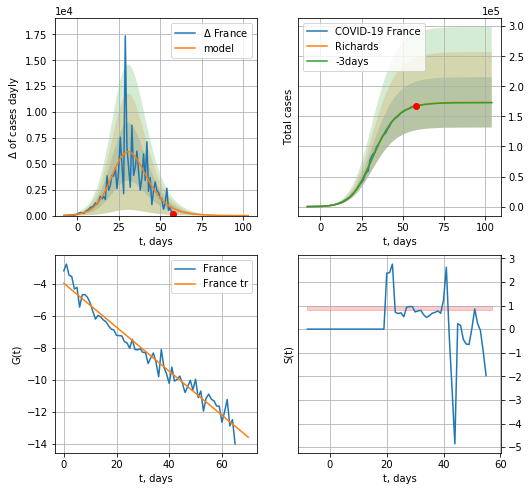

France data at: 2020-05-01
+3 day model MAPE: 0.0021606915700604556
model: Richards
coeffs:  [1.73445810e+05 2.10640852e-01 2.69704688e+01 5.89454844e-01]
rational stdev:  0.24107101392517993
forecast at the end of period: +46 days
	 deltaDaycases:  2
	 total cases:  173425 ± 41807
	 total death:  25487 ± 18432
trend coefficient of determination: 0.964044
 intercept: -3.978338
 slope: -0.137194


In [127]:
x = forecastRR('France',dfFR[10:],d1,12*7-dT-4,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


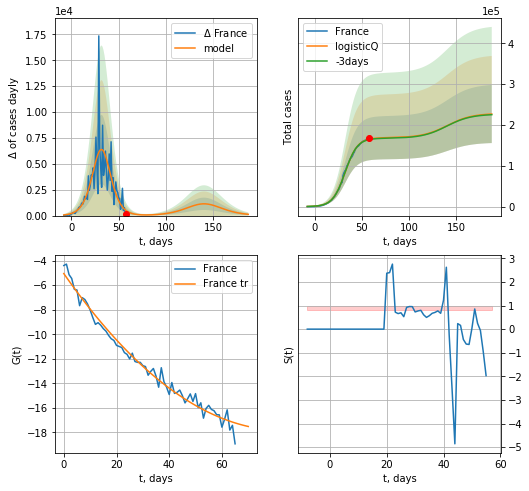

France data at: 2020-05-01
+3 day model MAPE: 0.006839
model: logisticQ
coeffs: [ 1.68765163e+05  3.06179827e-06  3.22715834e+01 -4.94325241e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.313598
forecast at the end of period: +130 days
	 deltaDaycases: 121
	 total cases: 226955 ± 71172
	 total death: 33354 ± 31379
trend coefficient of determination: 0.981843
 intercept_: -5.051453587883749
 coeffs_: [ 0.         -0.30742037  0.00184749]


In [128]:
x = forecastRRR('France',dfFR[10:],d1,24*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


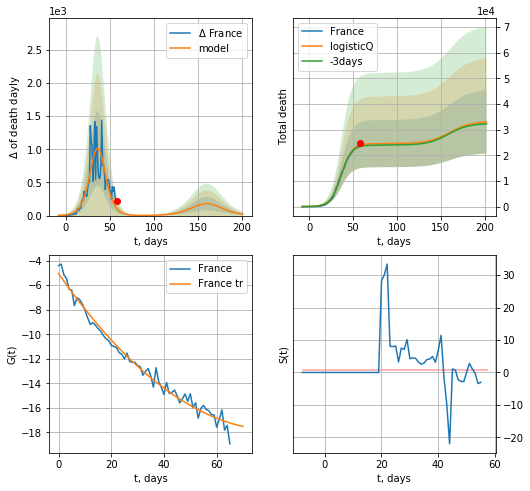

France data at: 2020-05-01
+3 day model MAPE: 0.020549
model: logisticQ
coeffs: [ 2.45537072e+04  2.79893270e-06  3.67662640e+01 -5.91021047e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.374225
forecast at the end of period: +144 days
	 total death: 32988 ± 12345
trend coefficient of determination: 0.981843
 intercept_: -5.051453587883749
 coeffs_: [ 0.         -0.30742037  0.00184749]


In [129]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [130]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [131]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


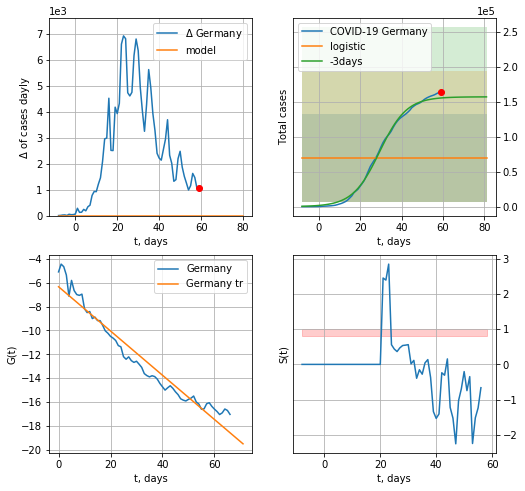

Germany data at: 2020-05-01
+3 day model MAPE: 0.555282431740532
model: logistic
coeffs:  [ 6.91156618e+04 -3.24545042e+00  1.06895071e+02]
rational stdev:  0.9048382370064479
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  69115 ± 62538
	 total death:  2837 ± 7701
trend coefficient of determination: 0.944200
 intercept: -6.333687
 slope: -0.185580


In [132]:
x = forecast('Germany',dfGR[:],d1,7*8-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


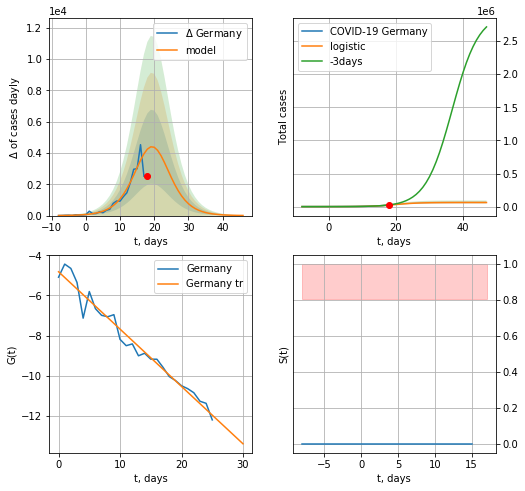

Germany data at: 2020-05-01
+3 day model MAPE: 0.18319320379671997
model: logistic
coeffs:  [6.16394025e+04 2.86275294e-01 1.98444846e+01]
rational stdev:  0.17054836328949527
forecast at the end of period: +29 days
	 deltaDaycases:  8
	 total cases:  61613 ± 10508
	 total death:  2529 ± 1293
trend coefficient of determination: 0.966826
 intercept: -4.817840
 slope: -0.285777


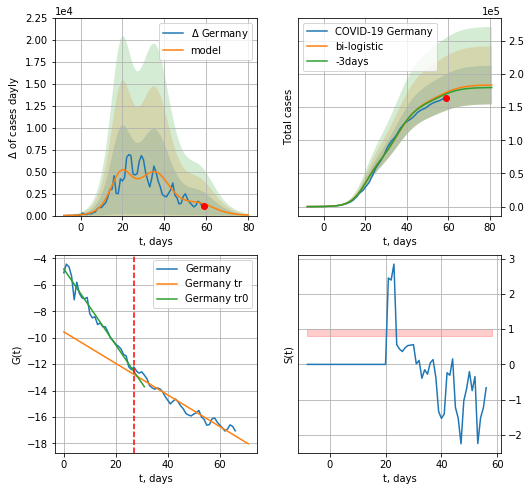

Germany data at: 2020-05-01
+3 day model MAPE: 0.013381282463052225
model: bi-logistic
coeffs:  [9.74525851e+04 1.95161446e-01 3.59306244e+01] [6.16394025e+04 2.86275294e-01 1.98444846e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.15917498329747728
forecast at the end of period: +22 days
	 deltaDaycases:  55
	 total cases:  183195 ± 29160
	 total death:  7520 ± 3590
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970373
 intercept: -4.806769
 slope: -0.287106
trend coefficient of determination: 0.942813
 intercept: -9.558427
 slope: -0.119237


In [133]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,9*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*8-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
          date   cases  active   death
63 2020-04-27  158758   38132  6126.0
64 2020-04-28  159912   33198  6314.0
65 2020-04-29  161539   31572  6467.0
66 2020-04-30  163009   32886  6623.0
67 2020-05-01  164077   30441  6736.0


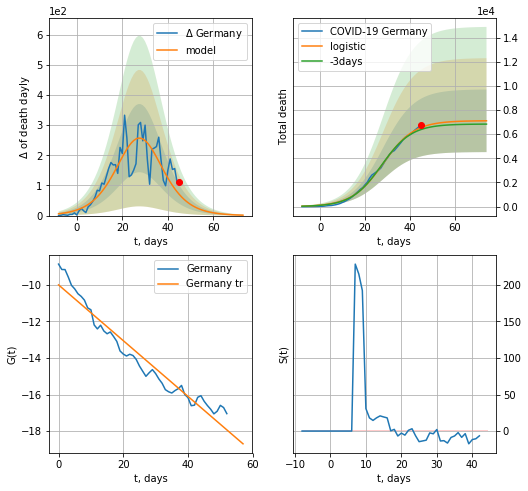

Germany data at: 2020-05-01
+3 day model MAPE: 0.027250945294330173
model: logistic
coeffs:  [7.11777288e+03 1.44594470e-01 2.79953092e+01]
rational stdev:  0.36466988053789134
forecast at the end of period: +29 days
	 total death:  7108 ± 2592
trend coefficient of determination: 0.943060
 intercept: -10.012918
 slope: -0.152224


In [134]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,9*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


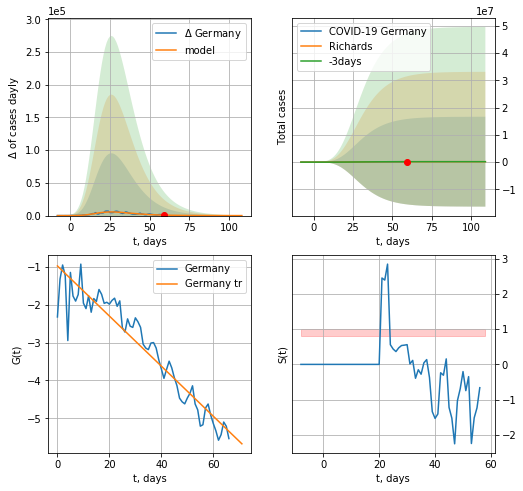

Germany data at: 2020-05-01
+3 day model MAPE: 0.007235944135070032
model: Richards
coeffs:  [ 1.70980764e+05  2.15903046e+00 -8.63853704e+00  4.18848890e-02]
rational stdev:  96.40975309691768
forecast at the end of period: +50 days
	 deltaDaycases:  9
	 total cases:  170882 ± 16474777
	 total death:  7015 ± 2028943
trend coefficient of determination: 0.903758
 intercept: -0.967666
 slope: -0.066319


In [135]:
x = forecastRR('Germany',dfGR[:],d1,12*7-dT,1.0,addpred=False,xcoef=[0.25,1.,5.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


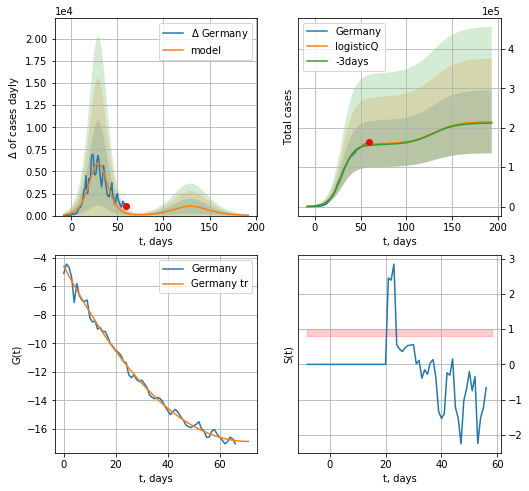

Germany data at: 2020-05-01
+3 day model MAPE: 0.015202
model: logisticQ
coeffs: [ 1.59476650e+05  1.31498321e-06  2.97618158e+01 -1.13590493e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.372272
forecast at the end of period: +134 days
	 deltaDaycases: 37
	 total cases: 215476 ± 80216
	 total death: 8846 ± 9879
trend coefficient of determination: 0.993588
 intercept_: -4.581306613832961
 coeffs_: [ 0.         -0.34736665  0.00245152]


In [136]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:183: RuntimeWarning: invalid value encountered in true_divide


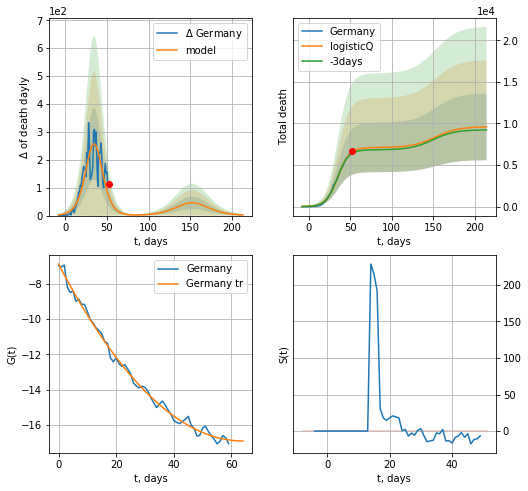

Germany data at: 2020-05-01
+3 day model MAPE: 0.027242
model: logisticQ
coeffs: [ 7.10406218e+03  2.29677913e-05  3.49686444e+01 -6.27255086e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.418090
forecast at the end of period: +162 days
	 total death: 9591 ± 4010
trend coefficient of determination: 0.993922
 intercept_: -6.9024810429775005
 coeffs_: [ 0.         -0.31224624  0.00243933]


In [395]:
x = forecastRRR('Germany',dfGR[7:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

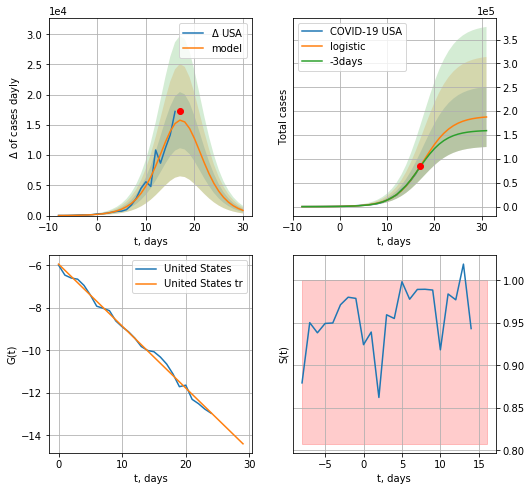

USA data at: 2020-05-01
+3 day model MAPE: 0.02944277425803263
model: logistic
coeffs:  [1.89999777e+05 3.33354123e-01 1.76550850e+01]
rational stdev:  0.3349926957690878
forecast at the end of period: +14 days
	 deltaDaycases:  855
	 total cases:  187803 ± 62912
	 total death:  10917 ± 10971
trend coefficient of determination: 0.994747
 intercept: -5.944308
 slope: -0.291379


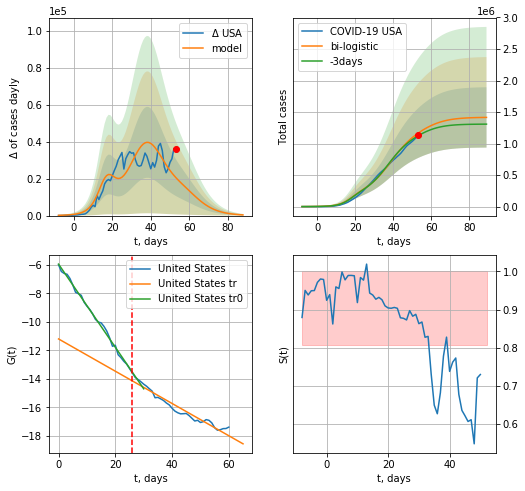

USA data at: 2020-05-01
+3 day model MAPE: 0.039257706185424394
model: bi-logistic
coeffs:  [9.81689666e+05 1.53808688e-01 3.81873538e+01] [1.89999777e+05 3.33354123e-01 1.76550850e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.3381891884115883
forecast at the end of period: +36 days
	 deltaDaycases:  371
	 total cases:  1414863 ± 478491
	 total death:  82251 ± 83449
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.995329
 intercept: -5.941731
 slope: -0.291701
trend coefficient of determination: 0.943982
 intercept: -11.193115
 slope: -0.113245


In [138]:
x = forecast('USA',dfUS[:26],d1,16*3-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,10*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=26)

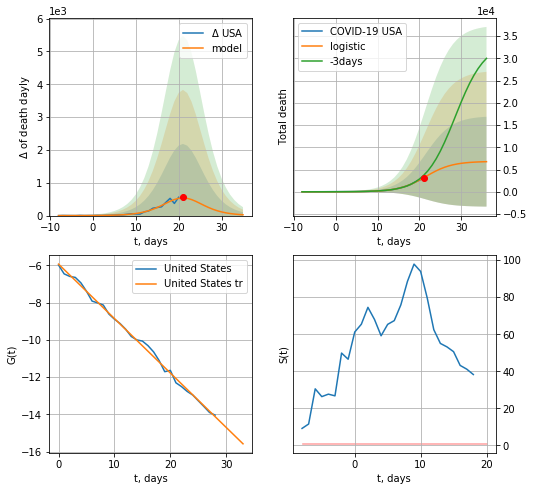

USA data at: 2020-05-01
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +15 days
	 total death:  6765 ± 10099
trend coefficient of determination: 0.996563
 intercept: -5.939898
 slope: -0.291951


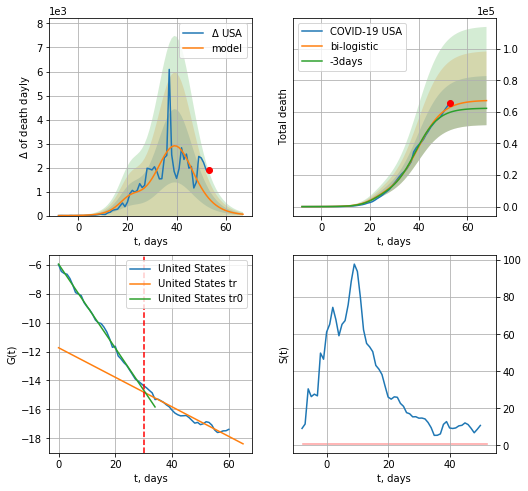

USA data at: 2020-05-01
+3 day model MAPE: 0.057313032675113465
model: bi-logistic
coeffs:  [6.05497074e+04 1.91907853e-01 3.97937158e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.23183728584165375
forecast at the end of period: +15 days
	 deltaDaydeath:  56
	 total death:  67114 ± 15559
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996662
 intercept: -5.952610
 slope: -0.290589
trend coefficient of determination: 0.938226
 intercept: -11.737283
 slope: -0.102252


In [139]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*7-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*7-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


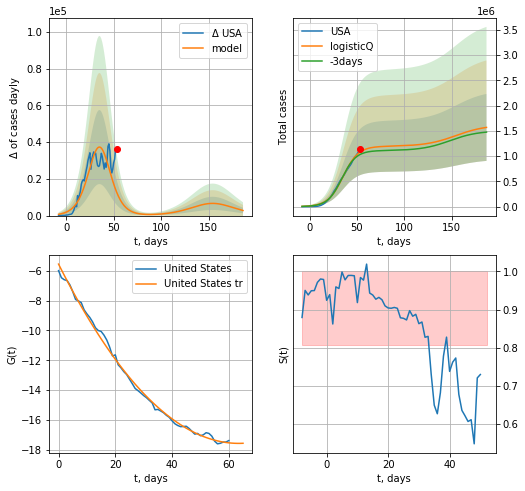

USA data at: 2020-05-01
+3 day model MAPE: 0.047588
model: logisticQ
coeffs: [ 1.19413534e+06  1.59392193e-06  3.54539301e+01 -7.83502895e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.422988
forecast at the end of period: +134 days
	 deltaDaycases: 2771
	 total cases: 1568417 ± 663421
	 total death: 91178 ± 115701
trend coefficient of determination: 0.996523
 intercept_: -5.552758970127716
 coeffs_: [ 0.         -0.37858484  0.00298127]


In [140]:
x = forecastRRR('USA',dfUS[:],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


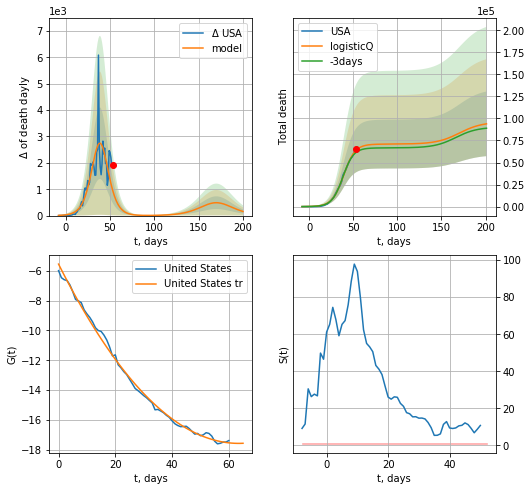

USA data at: 2020-05-01
+3 day model MAPE: 0.040372
model: logisticQ
coeffs: [ 7.08969605e+04  1.03314360e-05  3.90842474e+01 -1.49666086e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.390243
forecast at the end of period: +148 days
	 total death: 93891 ± 36640
trend coefficient of determination: 0.996523
 intercept_: -5.552758970127716
 coeffs_: [ 0.         -0.37858484  0.00298127]


In [141]:
x = forecastRRR('USA',dfUS[:],d1,7*26-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


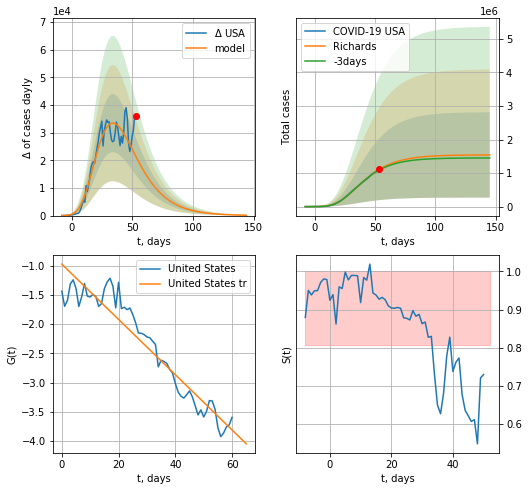

USA data at: 2020-05-01
+3 day model MAPE: 0.020675797126674233
model: Richards
coeffs:  [ 1.54244097e+06  5.52126089e+00 -4.18690378e+01  1.07419773e-02]
rational stdev:  0.8257993330956127
forecast at the end of period: +92 days
	 deltaDaycases:  134
	 total cases:  1540235 ± 1271925
	 total death:  89540 ± 221826
trend coefficient of determination: 0.911703
 intercept: -0.973091
 slope: -0.047284


In [142]:
x = forecastRR('USA',dfUS[:],d1,7*18-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


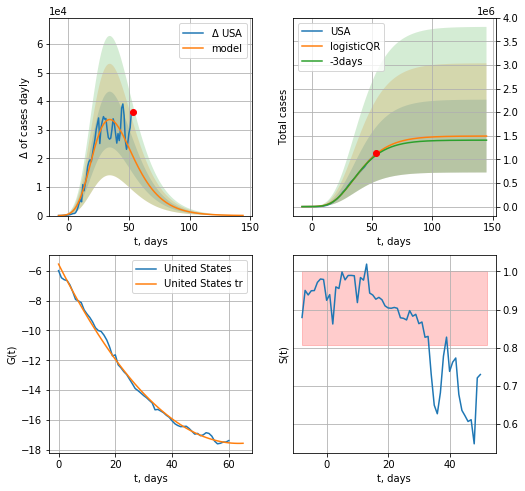

USA data at: 2020-05-01
+3 day model MAPE: 0.021778557526255633
model: logisticQR
coeffs:  [ 1.49378360e+06  2.08735029e-02 -7.16928475e+01 -6.95353739e+02
  3.51263187e-03]
rational stdev:  0.515937359715684
forecast at the end of period: +92 days
	 deltaDaycases:  54
	 total cases:  1493107 ± 770349
	 total death:  86800 ± 134350
trend coefficient of determination: 0.996523
 intercept_: -5.552758970127716
 coeffs_: [ 0.         -0.37858484  0.00298127]


In [143]:
x = forecastQR('USA',dfUS[:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
          date   cases  active    death
61 2020-04-27  157149  135713  24393.0
62 2020-04-28  161145  139123  25302.0
63 2020-04-29  165221  138780  26097.0
64 2020-04-30  171253  144138  26771.0
65 2020-05-01  177454  149600  27510.0


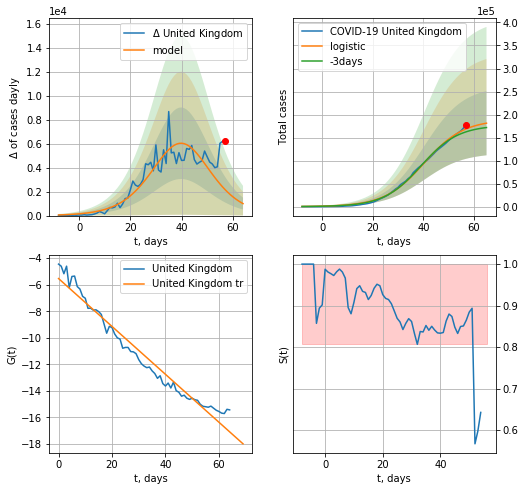

United Kingdom data at: 2020-05-01
+3 day model MAPE: 0.04175441494777236
model: logistic
coeffs:  [1.88879673e+05 1.27944681e-01 4.02932605e+01]
rational stdev:  0.3847474119831569
forecast at the end of period: +8 days
	 deltaDaycases:  999
	 total cases:  181200 ± 69716
	 total death:  28090 ± 32422
trend coefficient of determination: 0.961413
 intercept: -5.534961
 slope: -0.180654


In [144]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,6*7-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

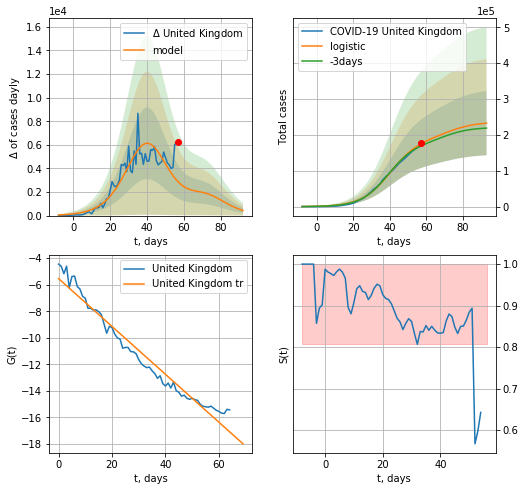

United Kingdom data at: 2020-05-01
+3 day model MAPE: 0.03647312961404621
model: logistic
coeffs:  [1.88879673e+05 1.27944681e-01 4.02932605e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3847474119831569
forecast at the end of period: +36 days
	 deltaDaycases:  434
	 total cases:  232670 ± 89519
	 total death:  36070 ± 41633
trend coefficient of determination: 0.961413
 intercept: -5.534961
 slope: -0.180654


In [145]:
x = forecast('United Kingdom',dfGB[:],d1,10*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:131: RuntimeWarning: divide by zero encountered in true_divide


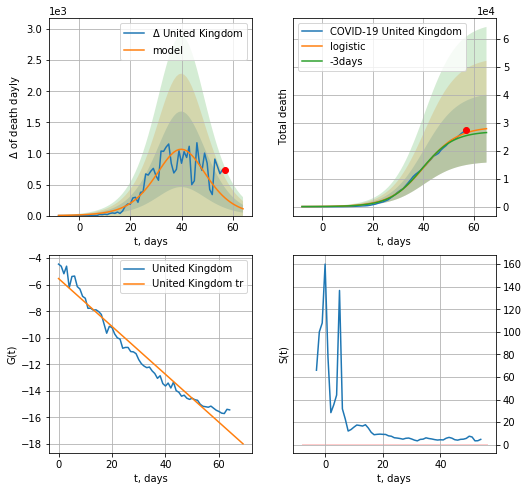

United Kingdom data at: 2020-05-01
+3 day model MAPE: 0.04142199632135374
model: logistic
coeffs:  [2.85354365e+04 1.49683204e-01 4.03621989e+01]
rational stdev:  0.43532284465832755
forecast at the end of period: +8 days
	 total death:  27838 ± 12118
trend coefficient of determination: 0.961413
 intercept: -5.534961
 slope: -0.180654


In [146]:
x = forecast('United Kingdom',dfGB[:],d1,6*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


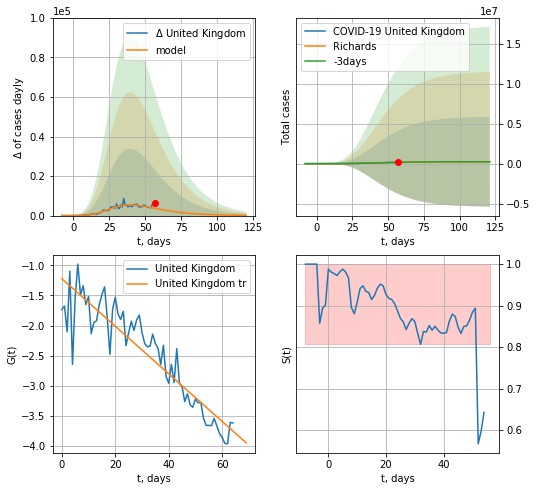

United Kingdom data at: 2020-05-01
+3 day model MAPE: 0.015306361956297735
model: Richards
coeffs:  [ 2.48543989e+05  2.76528274e+00 -2.41256382e+01  2.16487010e-02]
rational stdev:  22.84652227712362
forecast at the end of period: +64 days
	 deltaDaycases:  118
	 total cases:  246615 ± 5634315
	 total death:  38231 ± 2620336
trend coefficient of determination: 0.836063
 intercept: -1.220046
 slope: -0.039516


In [147]:
x = forecastRR('United Kingdom',dfGB[:],d1,14*7-dT,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


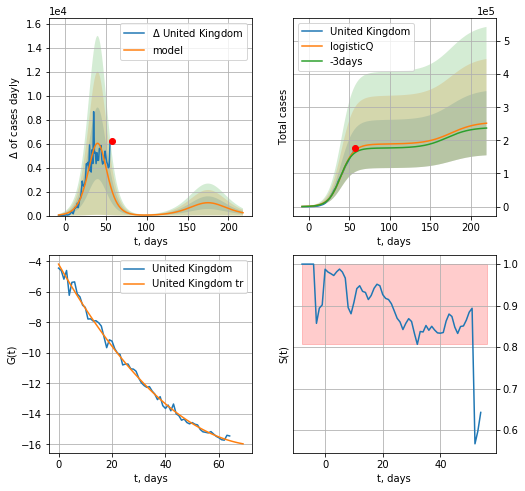

United Kingdom data at: 2020-05-01
+3 day model MAPE: 0.041820
model: logisticQ
coeffs: [ 1.88832107e+05  2.16025361e-06  4.02892824e+01 -5.91922264e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.384875
forecast at the end of period: +162 days
	 deltaDaycases: 240
	 total cases: 251849 ± 96930
	 total death: 39043 ± 45080
trend coefficient of determination: 0.995001
 intercept_: -4.184782317199019
 coeffs_: [ 0.         -0.30927022  0.00200984]


In [89]:
x = forecastRRR('United Kingdom',dfGB[:],d1,28*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:183: RuntimeWarning: divide by zero encountered in true_divide


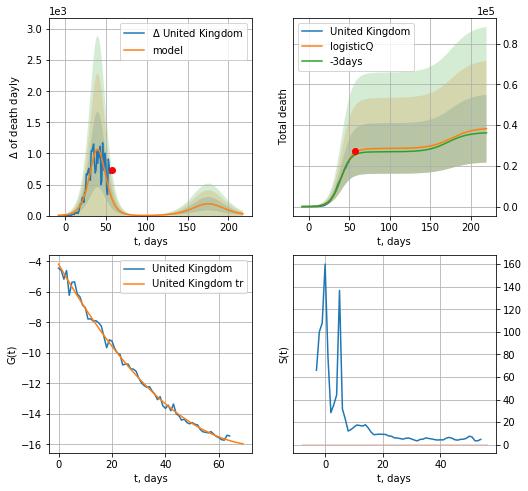

United Kingdom data at: 2020-05-01
+3 day model MAPE: 0.041466
model: logisticQ
coeffs: [ 2.85295287e+04  2.96090325e-06  4.03595575e+01 -5.05161047e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.435365
forecast at the end of period: +162 days
	 total death: 38254 ± 16654
trend coefficient of determination: 0.995001
 intercept_: -4.184782317199019
 coeffs_: [ 0.         -0.30927022  0.00200984]


In [149]:
x = forecastRRR('United Kingdom',dfGB[:],d1,28*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [134]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [169]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [170]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [171]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [172]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [150]:
dT

34

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


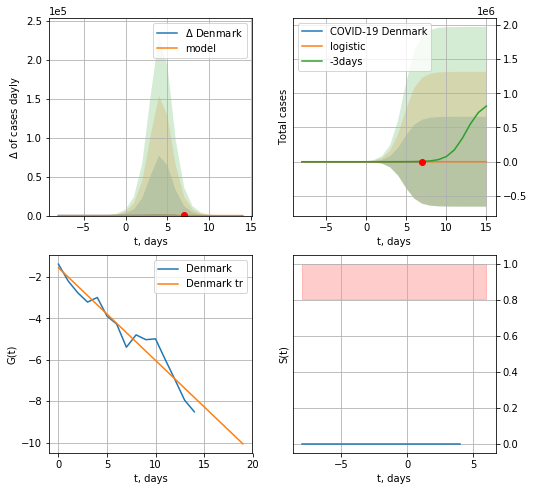

Denmark data at: 2020-05-01
+3 day model MAPE: 0.9299494930201694
model: logistic
coeffs:  [849.15572285   1.15642837   4.69716859]
rational stdev:  772.2918388633376
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  849 ± 655791
	 total death:  41 ± 94991
trend coefficient of determination: 0.941867
 intercept: -1.561623
 slope: -0.447087


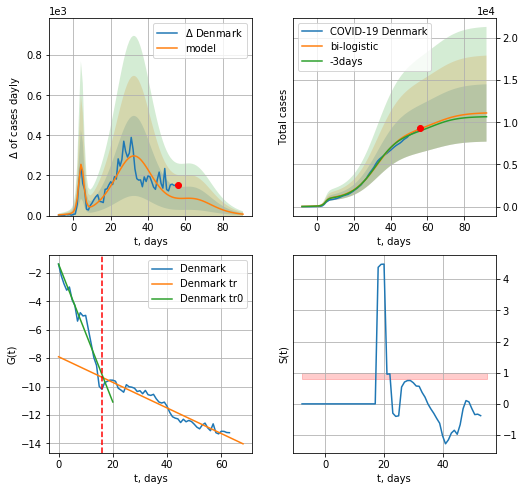

Denmark data at: 2020-05-01
+3 day model MAPE: 0.027051551392905323
model: bi-logistic
coeffs:  [8.23627310e+03 1.43493470e-01 3.28159434e+01] [849.15572285   1.15642837   4.69716859]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3063738780701767
forecast at the end of period: +36 days
	 deltaDaycases:  7
	 total cases:  11097 ± 3399
	 total death:  548 ± 503
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.932975
 intercept: -1.384195
 slope: -0.485107
trend coefficient of determination: 0.942212
 intercept: -7.903125
 slope: -0.090097


In [151]:
vL = 16
x = forecast('Denmark',dfDK[:vL],d1,6*7-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,10*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


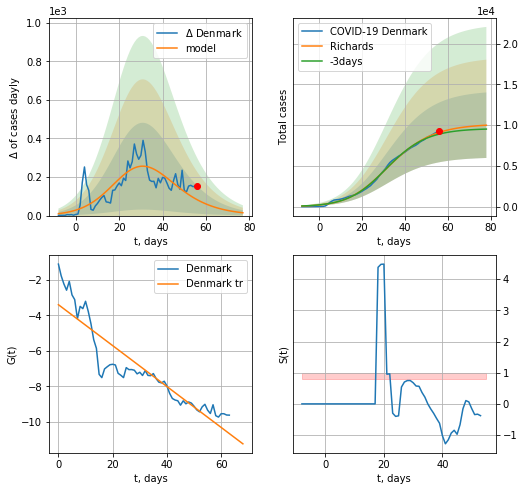

Denmark data at: 2020-05-01
+3 day model MAPE: 0.024964621524139835
model: Richards
coeffs:  [1.01450575e+04 1.46984791e-01 2.56029087e+01 6.02304168e-01]
rational stdev:  0.40246486408261
forecast at the end of period: +22 days
	 deltaDaycases:  14
	 total cases:  9984 ± 4018
	 total death:  493 ± 595
trend coefficient of determination: 0.843485
 intercept: -3.396217
 slope: -0.115163


In [152]:
x = forecastRR('Denmark',dfDK[:],d1,8*7-dT,1.0)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp


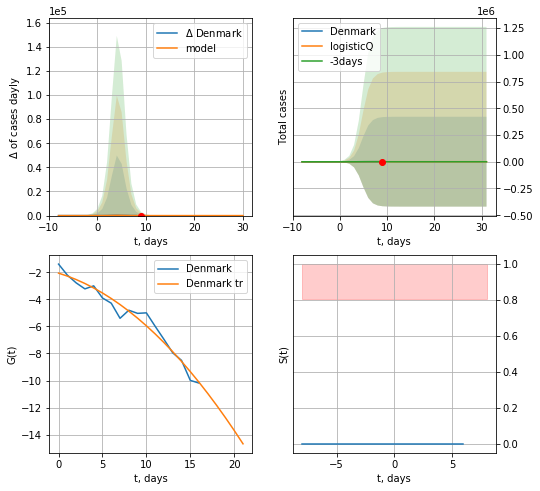

Denmark data at: 2020-05-01
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +22 days
	 deltaDaycases: 0
	 total cases: 862 ± 420260
	 total death: 42 ± 61395
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:264: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


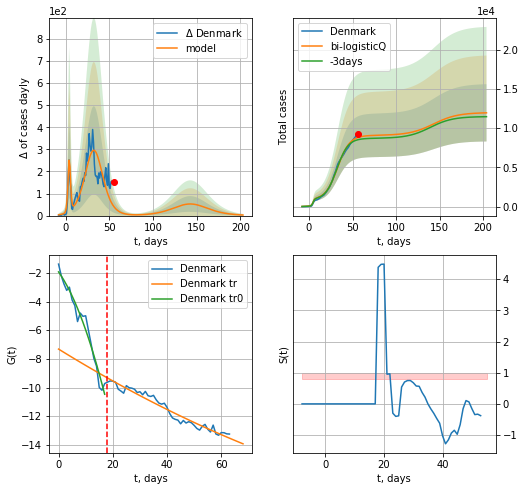

Denmark data at: 2020-05-01
+3 day model MAPE: 0.03421511346347985
model: bi-logisticQ
coeffs:  [ 8.21618462e+03  1.29451996e-06  3.28308302e+01 -1.11224579e+05] [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
S.Korea scenario coeffs:  [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev:  0.30541493882934817
forecast at the end of period: +148 days
	 deltaDaycases:  2
	 total cases:  11953 ± 3650
	 total death:  590 ± 540
bi-logistic approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.952187
 intercept_: -7.316405920262203
 coeffs_: [ 0.         -0.11699919  0.0002904 ]


In [153]:
x = forecastRRR('Denmark',dfDK[:18],d1,8*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
          date  cases  active  death
61 2020-04-27   7599    7362  205.0
62 2020-04-28   7660    7422  206.0
63 2020-04-29   7710    7471  207.0
64 2020-04-30   7738    7496  210.0
65 2020-05-01   7783    7541  210.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


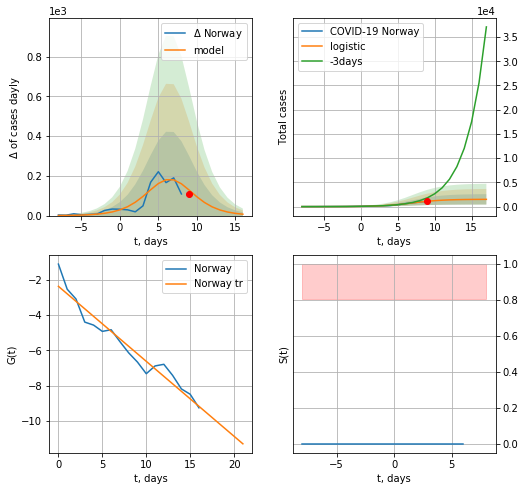

Norway data at: 2020-05-01
+3 day model MAPE: 0.5371818041233266
model: logistic
coeffs:  [1.50888671e+03 4.87443897e-01 6.97859719e+00]
rational stdev:  0.7165081035353225
forecast at the end of period: +8 days
	 deltaDaycases:  7
	 total cases:  1497 ± 1073
	 total death:  40 ± 85
trend coefficient of determination: 0.944117
 intercept: -2.361427
 slope: -0.426195


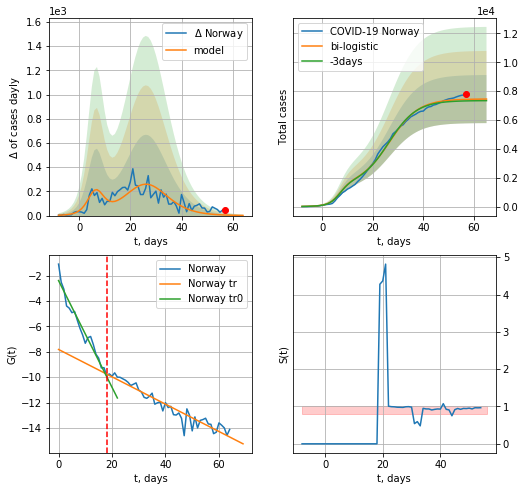

Norway data at: 2020-05-01
+3 day model MAPE: 0.014554810977311863
model: bi-logistic
coeffs:  [5.95255161e+03 1.74482659e-01 2.66190172e+01] [1.50888671e+03 4.87443897e-01 6.97859719e+00]
rational stdev:  0.22362117494004852
forecast at the end of period: +8 days
	 deltaDaycases:  1
	 total cases:  7454 ± 1666
	 total death:  201 ± 134
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.950087
 intercept: -2.394883
 slope: -0.419922
trend coefficient of determination: 0.915838
 intercept: -7.815941
 slope: -0.107613


In [154]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=18
x = forecast('Norway',dfNG[:vL],d1,6*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,6*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

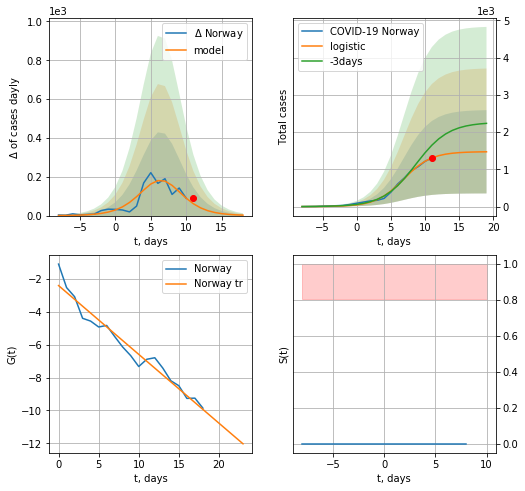

Norway data at: 2020-05-01
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +8 days
	 deltaDaycases:  2
	 total cases:  1471 ± 1117
	 total death:  39 ± 88
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


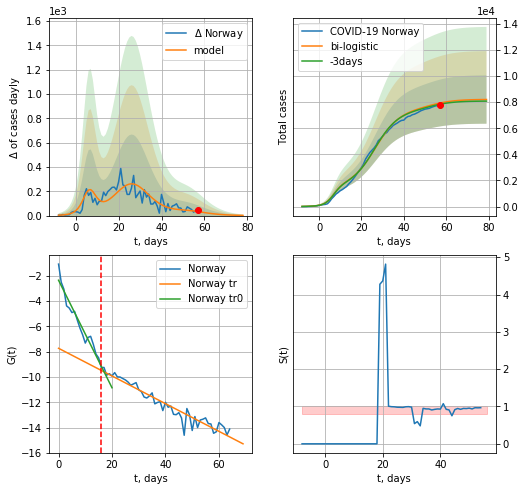

Norway data at: 2020-05-01
+3 day model MAPE: 0.011786241975096156
model: bi-logistic
coeffs:  [5.98811471e+03 1.73587188e-01 2.65428363e+01] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.2259243573047084
forecast at the end of period: +22 days
	 deltaDaycases:  1
	 total cases:  8202 ± 1853
	 total death:  221 ± 149
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.933194
 intercept: -2.371994
 slope: -0.424081
trend coefficient of determination: 0.925561
 intercept: -7.738389
 slope: -0.109210


In [155]:
vL = 16#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,6*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,8*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


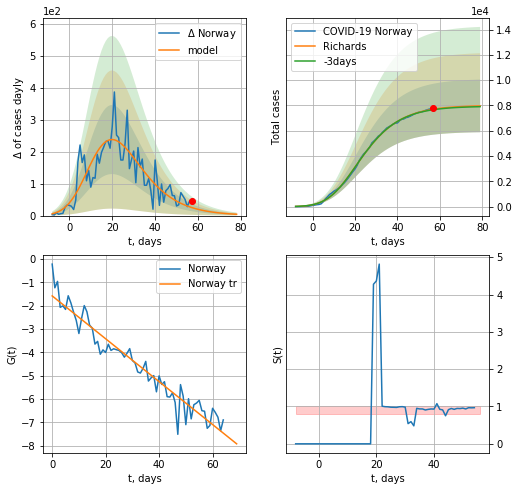

Norway data at: 2020-05-01
+3 day model MAPE: 0.005306440790838748
model: Richards
coeffs:  [8.01182138e+03 4.56094753e-01 1.85526428e+00 1.94156456e-01]
rational stdev:  0.2614929279166064
forecast at the end of period: +22 days
	 deltaDaycases:  4
	 total cases:  7967 ± 2083
	 total death:  214 ± 167
trend coefficient of determination: 0.931036
 intercept: -1.576192
 slope: -0.091905


In [156]:
x = forecastRR('Norway',dfNG[:],d1,8*7-dT,1.0)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


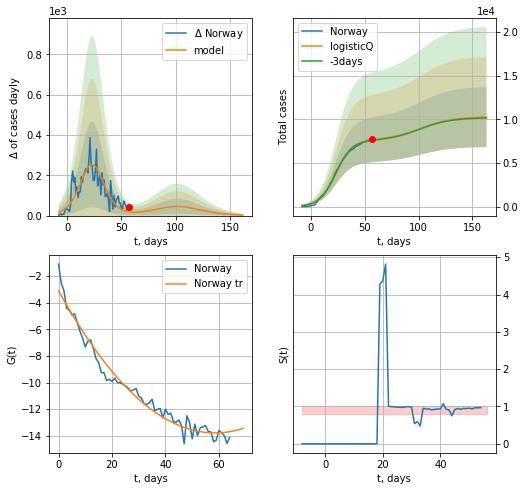

Norway data at: 2020-05-01
+3 day model MAPE: 0.010261
model: logisticQ
coeffs: [ 7.60426611e+03  1.15725511e-06  2.33387850e+01 -1.15123271e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.335592
forecast at the end of period: +106 days
	 deltaDaycases: 2
	 total cases: 10253 ± 3441
	 total death: 276 ± 277
trend coefficient of determination: 0.969910
 intercept_: -3.104680915327407
 coeffs_: [ 0.         -0.36510848  0.00312115]


In [157]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

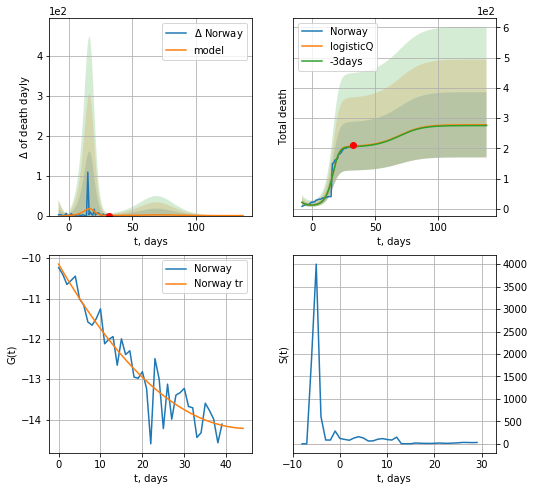

Norway data at: 2020-05-01
+3 day model MAPE: 0.009756
model: logisticQ
coeffs: [ 2.05487386e+02  1.00696186e-02  1.57153068e+01 -1.69461603e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.386928
forecast at the end of period: +106 days
	 total death: 278 ± 107
trend coefficient of determination: 0.901457
 intercept_: -10.147765305660595
 coeffs_: [ 0.         -0.17984731  0.00198485]


In [158]:
x = forecastRRR('Norway',dfNG[25:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

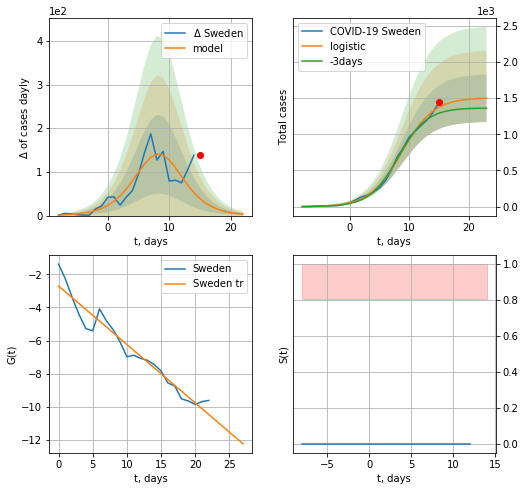

Sweden data at: 2020-05-01
+3 day model MAPE: 0.0730548600677782
model: logistic
coeffs:  [1.50473584e+03 3.76040161e-01 8.77120622e+00]
rational stdev:  0.21926973222081286
forecast at the end of period: +8 days
	 deltaDaycases:  3
	 total cases:  1497 ± 328
	 total death:  184 ± 121
trend coefficient of determination: 0.941971
 intercept: -2.710792
 slope: -0.352814


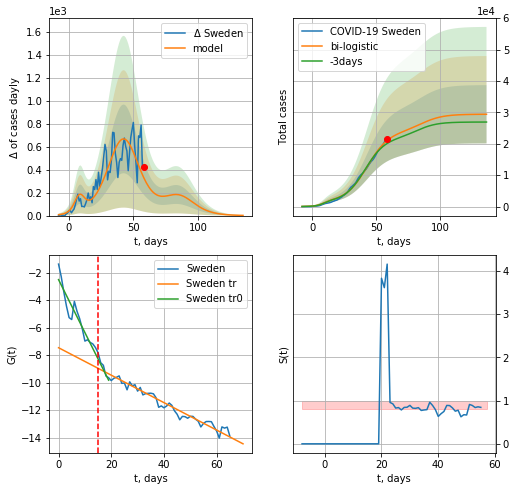

Sweden data at: 2020-05-01
+3 day model MAPE: 0.04844172838378611
model: bi-logistic
coeffs:  [2.23267562e+04 1.19147915e-01 4.27946806e+01] [1.50473584e+03 3.76040161e-01 8.77120622e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.31541186912933483
forecast at the end of period: +78 days
	 deltaDaycases:  1
	 total cases:  29399 ± 9272
	 total death:  3624 ± 3429
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.870123
 intercept: -2.515075
 slope: -0.384868
trend coefficient of determination: 0.951951
 intercept: -7.467165
 slope: -0.099836


In [159]:
vL = 15#len(dfSW)-12-dT
x = forecast('Sweden',dfSW[:-9-dT],d1,6*7-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
          date  cases  active   death
62 2020-04-27  18926   15647  2274.0
63 2020-04-28  19621   16261  2355.0
64 2020-04-29  20302   16835  2462.0
65 2020-04-30  21092   17501  2586.0
66 2020-05-01  21520   17862  2653.0


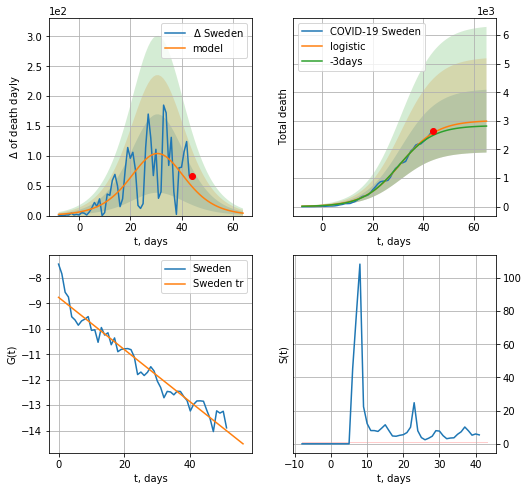

Sweden data at: 2020-05-01
+3 day model MAPE: 0.035614034158624616
model: logistic
coeffs:  [3.01783854e+03 1.37936735e-01 3.11173652e+01]
rational stdev:  0.3674852904769874
forecast at the end of period: +21 days
	 total death:  2989 ± 1098
trend coefficient of determination: 0.943670
 intercept: -8.759303
 slope: -0.102911


In [160]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


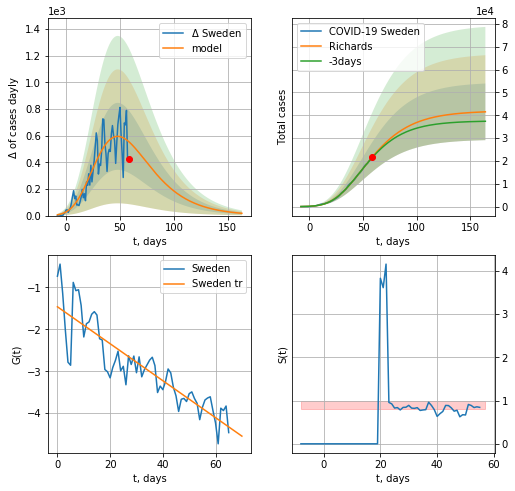

Sweden data at: 2020-05-01
+3 day model MAPE: 0.01186339541841746
model: Richards
coeffs:  [ 4.19356323e+04  7.25198263e-01 -2.49784730e+01  5.46369636e-02]
rational stdev:  0.2987741515781644
forecast at the end of period: +106 days
	 deltaDaycases:  17
	 total cases:  41508 ± 12401
	 total death:  5117 ± 4586
trend coefficient of determination: 0.784814
 intercept: -1.460783
 slope: -0.044089


In [161]:
x = forecastRR('Sweden',dfSW[:],d1,20*7-dT,1.0)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


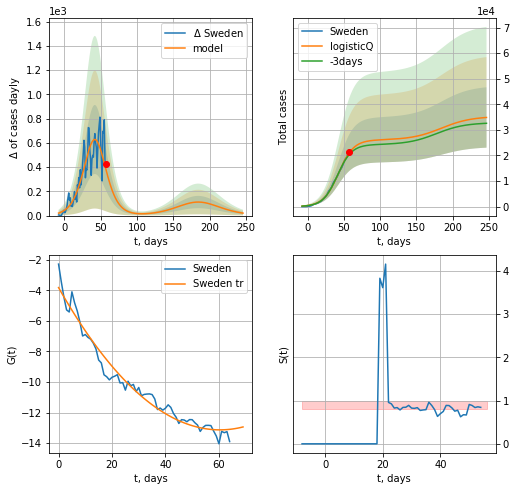

Sweden data at: 2020-05-01
+3 day model MAPE: 0.034422
model: logisticQ
coeffs: [ 2.60598140e+04  2.14386735e-06  4.23851383e+01 -4.48815371e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.338666
forecast at the end of period: +190 days
	 deltaDaycases: 20
	 total cases: 34857 ± 11805
	 total death: 4297 ± 4365
trend coefficient of determination: 0.967779
 intercept_: -3.8175692748912944
 coeffs_: [ 0.         -0.3084901   0.00255544]


In [162]:
x = forecastRRR('Sweden',dfSW[1:],d1,32*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:183: RuntimeWarning: invalid value encountered in true_divide


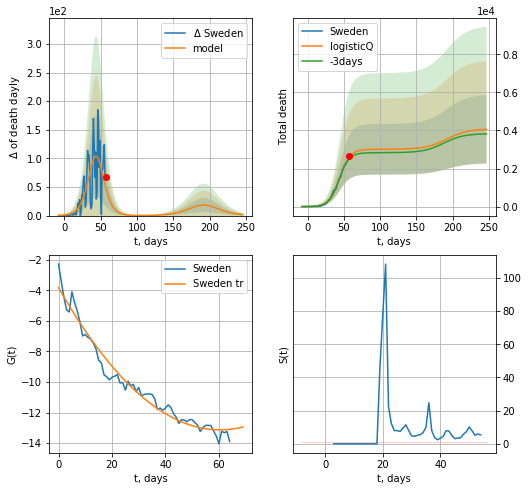

Sweden data at: 2020-05-01
+3 day model MAPE: 0.035811
model: logisticQ
coeffs: [ 3.01397176e+03  5.83078332e-06  4.40963605e+01 -2.36482827e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.442092
forecast at the end of period: +190 days
	 total death: 4058 ± 1794
trend coefficient of determination: 0.967779
 intercept_: -3.8175692748912944
 coeffs_: [ 0.         -0.3084901   0.00255544]


In [163]:
x = forecastRRR('Sweden',dfSW[1:],d1,32*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

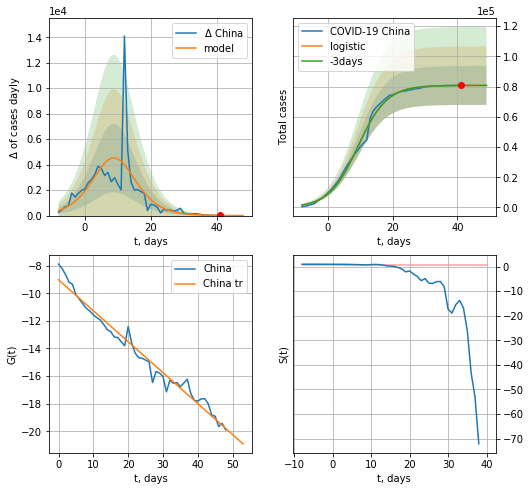

China data at: 2020-05-01
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +8 days
	 deltaDaycases:  2
	 total cases:  80799 ± 12904
	 total death:  4516 ± 2163
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


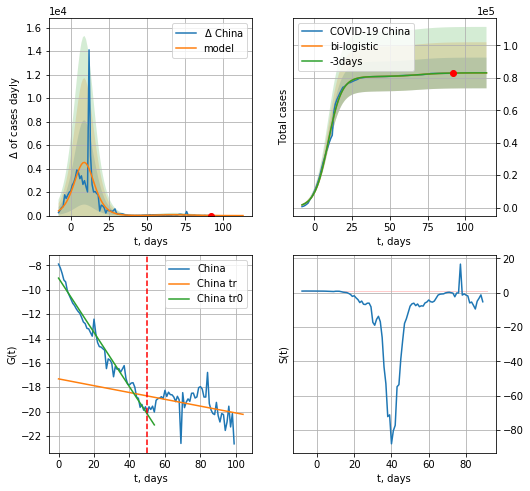

China data at: 2020-05-01
+3 day model MAPE: 0.00048348558649463375
model: bi-logistic
coeffs:  [2.25194852e+03 1.23178311e-01 6.83863530e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.11404373601414738
forecast at the end of period: +22 days
	 deltaDaycases:  1
	 total cases:  83053 ± 9471
	 total death:  4643 ± 1588
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.132548
 intercept: -17.315191
 slope: -0.028010


In [164]:
x = forecast('China',dfCN[:50],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
xx = forecast2('China',dfCN[:],d1,8*7-dT,x,1.0,vL=50)

In [165]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

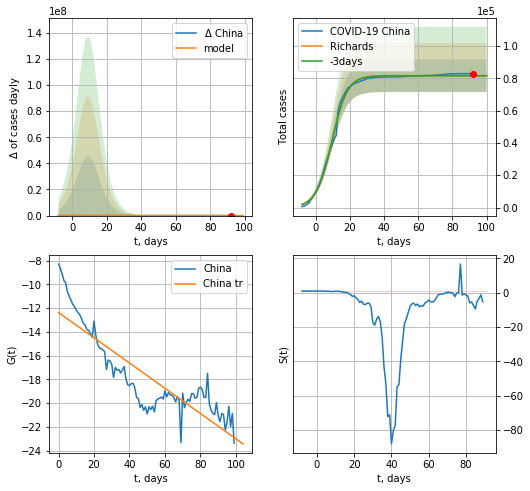

China data at: 2020-05-01
+3 day model MAPE: 0.0008067387461550089
model: Richards
coeffs:  [8.16071253e+04 2.11235414e-01 9.83264036e+00 1.06212728e+00]
rational stdev:  0.12319354612268121
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  81607 ± 10053
	 total death:  4562 ± 1686
trend coefficient of determination: 0.764296
 intercept: -12.377404
 slope: -0.106147


In [166]:
x = forecastRR('China',dfCN[:],d1,6*7-dT,1.0)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

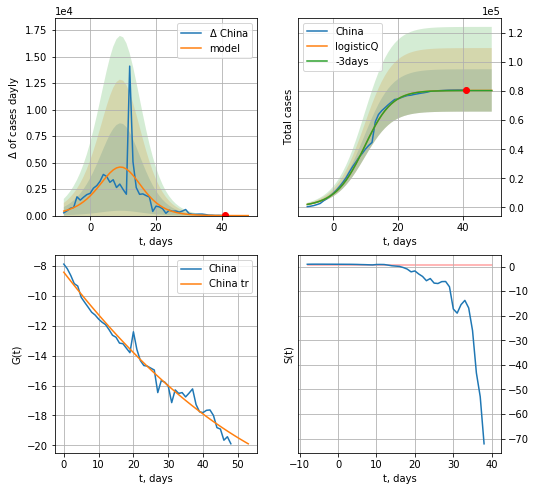

China data at: 2020-05-01
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +8 days
	 deltaDaycases: 0
	 total cases: 80415 ± 14556
	 total death: 4495 ± 2441
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:264: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


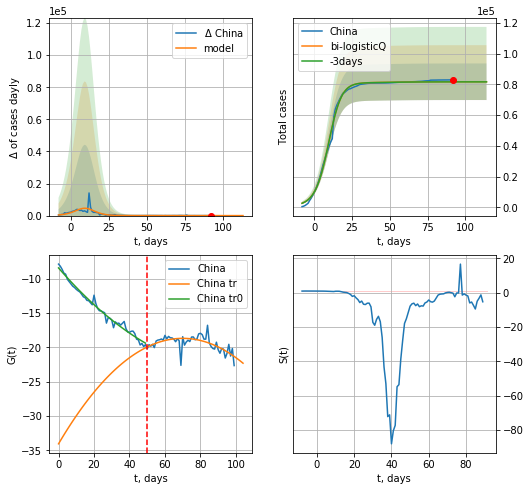

China data at: 2020-05-01
+3 day model MAPE: 0.0009599770836176141
model: bi-logisticQ
coeffs:  [1.25448947e+03 8.66768061e-04 2.50125771e+01 1.97482967e-03] [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev:  0.1453856310179759
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  81671 ± 11873
	 total death:  4565 ± 1991
bi-logistic approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.414626
 intercept_: -34.03354421012391
 coeffs_: [ 0.          0.43834637 -0.00313019]


In [167]:
x = forecastRRR('China',dfCN[:50],d1,6*7-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,8*7-dT,x,1.0,vL=50)

In [168]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
          date    cases  active  death
72 2020-04-27  10752.0  1654.0  244.0
73 2020-04-28  10761.0  1593.0  246.0
74 2020-04-29  10765.0  1459.0  247.0
75 2020-04-30  10774.0  1454.0  248.0
76 2020-05-01  10780.0  1407.0  250.0


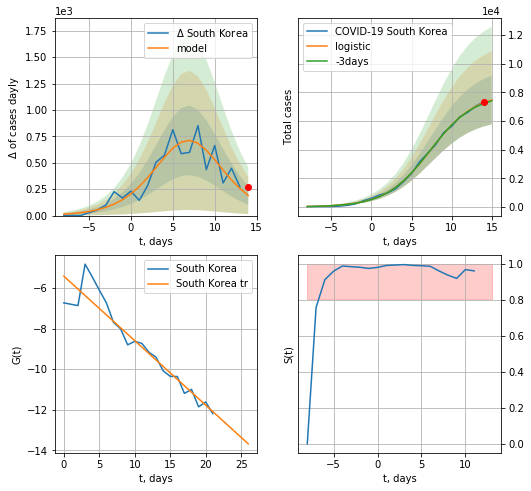

South Korea data at: 2020-05-01
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +1 days
	 deltaDaycases:  190
	 total cases:  7461 ± 1698
	 total death:  173 ± 118
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


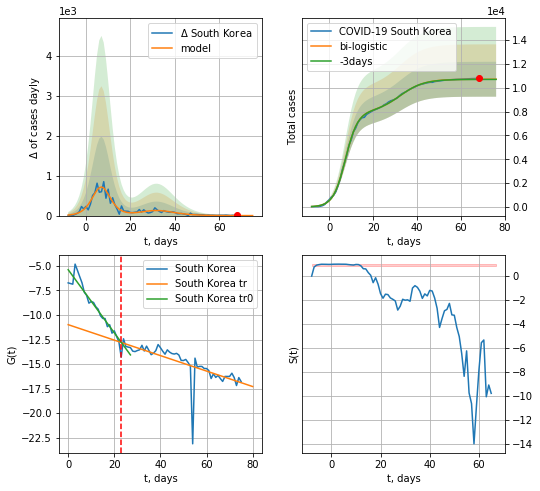

South Korea data at: 2020-05-01
+3 day model MAPE: 0.0013501009862283363
model: bi-logistic
coeffs:  [2.76828573e+03 1.83695234e-01 3.22598882e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.13658550123161298
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  10708 ± 1462
	 total death:  248 ± 101
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.508515
 intercept: -10.987619
 slope: -0.078698


In [169]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,5*7-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,6*7-dT,x,1.0,vL=23)

In [174]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

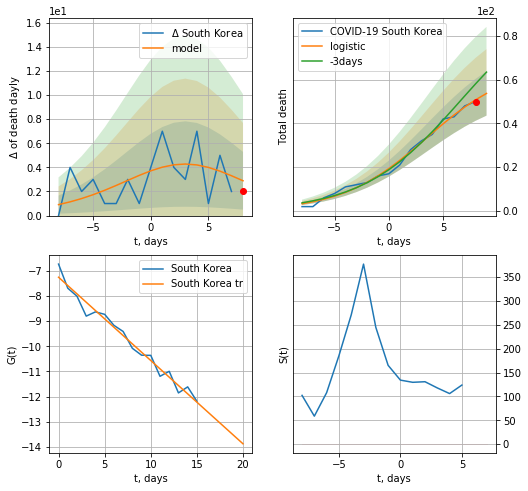

South Korea data at: 2020-05-01
model: logistic
coeffs:  [66.59757424  0.25734808  3.46382915]
rational stdev:  0.18867115045959354
forecast at the end of period: +1 days
	 total death:  53 ± 10
trend coefficient of determination: 0.972428
 intercept: -7.252219
 slope: -0.331355


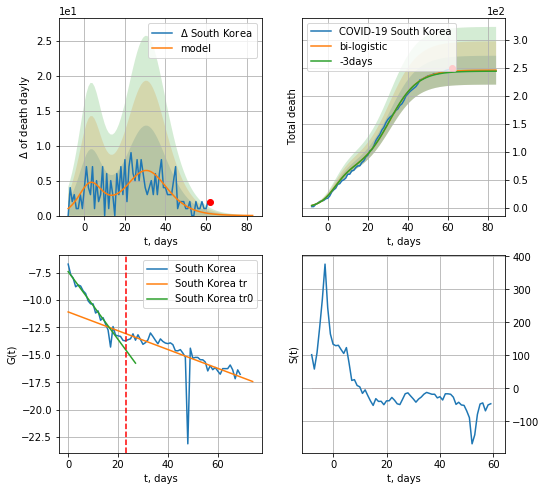

South Korea data at: 2020-05-01
+3 day model MAPE: 0.006713573299445094
model: bi-logistic
coeffs:  [1.79803771e+02 1.43334053e-01 3.10354343e+01] [66.59757424  0.25734808  3.46382915]
rational stdev:  0.10487390920007719
forecast at the end of period: +22 days
	 deltaDaydeath:  0
	 total death:  246 ± 25
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.950305
 intercept: -7.416817
 slope: -0.308862
trend coefficient of determination: 0.472726
 intercept: -11.089826
 slope: -0.085709


In [170]:
x = forecast('South Korea',dfKR[6:23],d1,5*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[6:],d1,8*7-dT,x,1.0,vL=23,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


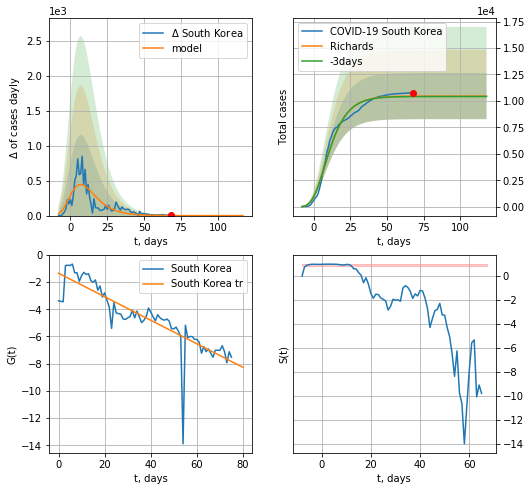

South Korea data at: 2020-05-01
+3 day model MAPE: 0.0039728973051126396
model: Richards
coeffs:  [ 1.04591181e+04  3.03287438e+01 -4.05644695e+01  3.82183833e-03]
rational stdev:  0.208143709788433
forecast at the end of period: +50 days
	 deltaDaycases:  0
	 total cases:  10459 ± 2176
	 total death:  242 ± 151
trend coefficient of determination: 0.730869
 intercept: -1.345415
 slope: -0.086550


In [171]:
x = forecastRR('South Korea',dfKR[:],d1,12*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


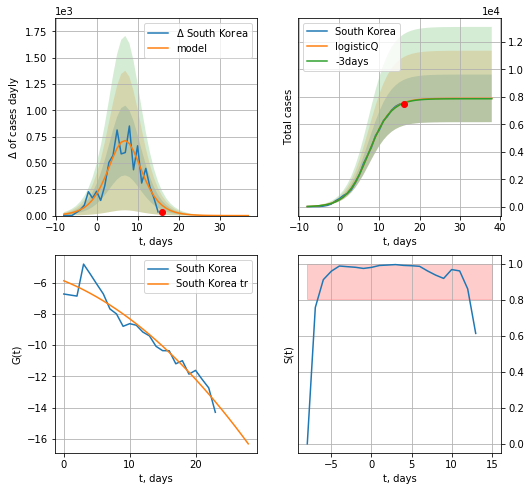

South Korea data at: 2020-05-01
+3 day model MAPE: 0.003361
model: logisticQ
coeffs: [ 7.90013984e+03  8.06152941e-05  7.33800031e+00 -4.48711989e+03]
rational stdev: 0.219238
forecast at the end of period: +22 days
	 deltaDaycases: 0
	 total cases: 7900 ± 1731
	 total death: 183 ± 120
trend coefficient of determination: 0.934689
 intercept_: -5.890495861491463
 coeffs_: [ 0.         -0.17096071 -0.00718004]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:264: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


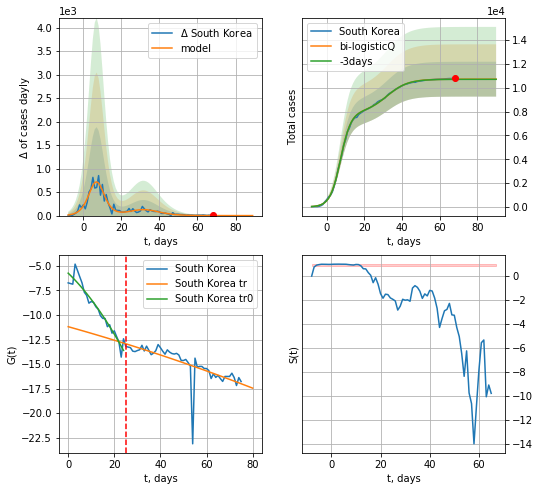

South Korea data at: 2020-05-01
+3 day model MAPE: 0.001307
model: bi-logisticQ
coeffs: [ 2.81229102e+03  1.94091213e-06  3.20706657e+01 -9.27577379e+04]
rational stdev: 0.136308
forecast at the end of period: +22 days
	 deltaDaycases: 0
	 total cases: 10712 ± 1460
	 total death: 248 ± 101
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.925965
 intercept_: -5.745633553515705
 coeffs_: [ 0.         -0.22458651 -0.00428776]
trend coefficient of determination: 0.504844
 intercept_: -11.19357033976762
 coeffs_: [ 0.         -0.06571011 -0.00015571]


In [92]:
vL=25
x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


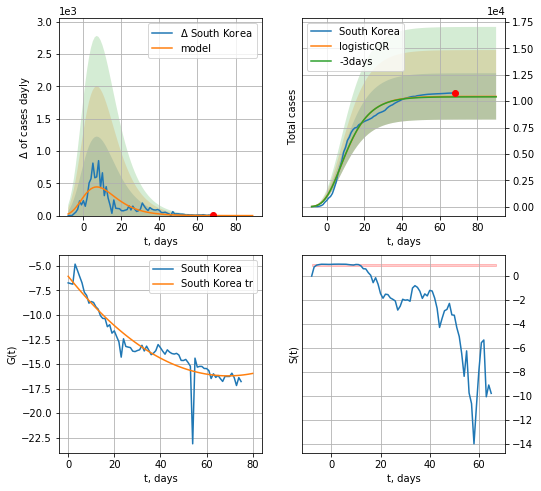

South Korea data at: 2020-05-01
+3 day model MAPE: 0.003949096098559204
model: logisticQR
coeffs:  [ 1.04506766e+04  1.56373499e-01 -6.40938401e+01 -2.12488009e+03
  3.35326635e-04]
rational stdev:  0.20982745312483425
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  10450 ± 2192
	 total death:  242 ± 152
trend coefficient of determination: 0.873080
 intercept_: -6.064015314209907
 coeffs_: [ 0.         -0.29289943  0.00211639]


In [173]:
x = forecastQR('South Korea',dfKR[:],d1,8*7-dT,1.0)

SG
          date  cases  active  death
95 2020-04-27  14423   13314   14.0
96 2020-04-28  14951   13809   14.0
97 2020-04-29  15641   14439   14.0
98 2020-04-30  16169   14910   15.0
99 2020-05-01  17101   15817   16.0


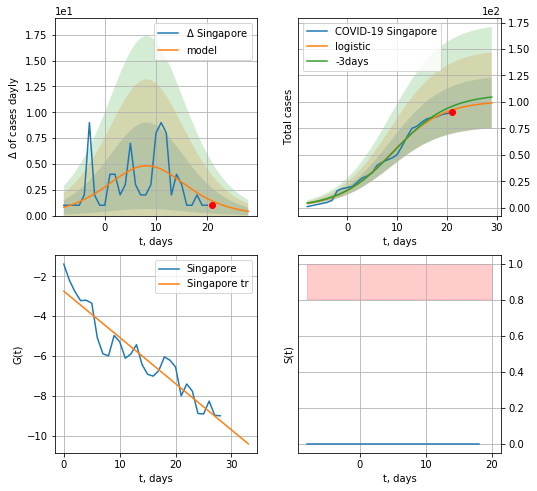

Singapore data at: 2020-05-01
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  99 ± 23
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


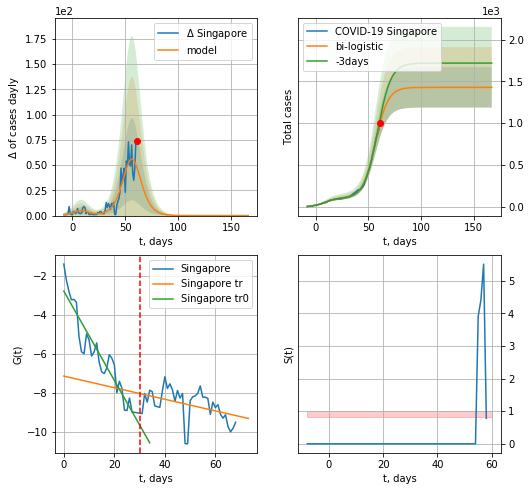

Singapore data at: 2020-05-01
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +106 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  1 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


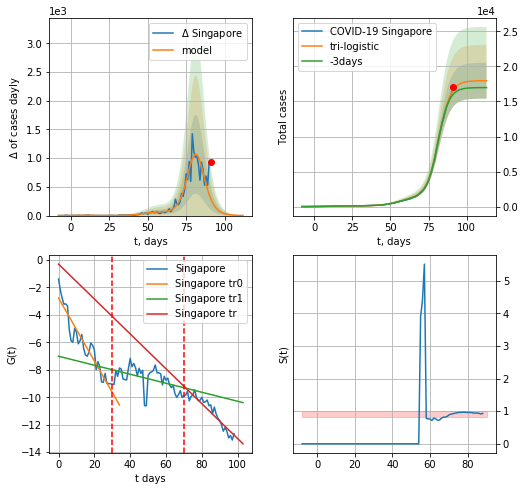

Singapore data at: 2020-05-01
+3 day model MAPE: 0.04011829335221464
model: tri-logistic
coeffs:  [1.65423154e+04 2.58407669e-01 8.17597038e+01] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.14246265061071797
forecast at the end of period: +22 days
	 deltaDaycases:  1
	 total cases:  17965 ± 2559
	 total death:  16 ± 6
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.885110
 intercept: -0.301830
 slope: -0.127065


In [174]:
vL = 30
vL1 = 70
dfSG = read_df(pd.DataFrame(),"SG")
x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Singapore",dfSG,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


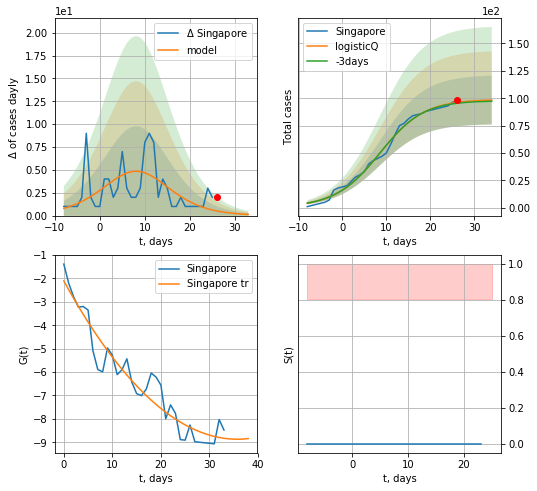

Singapore data at: 2020-05-01
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +8 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:264: RuntimeWarning: overflow encountered in exp


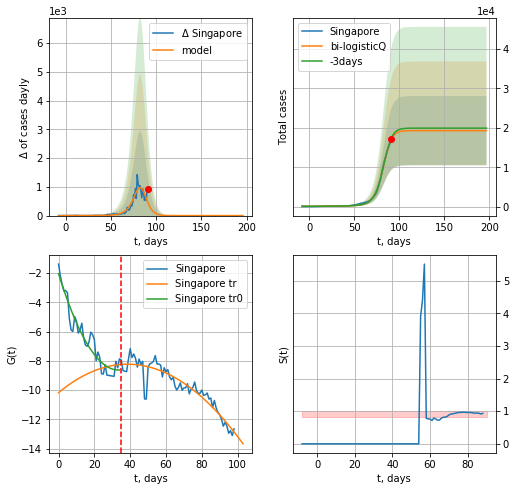

Singapore data at: 2020-05-01
+3 day model MAPE: 0.020035
model: bi-logisticQ
coeffs: [ 1.91913103e+04  1.62477944e-03  8.19085849e+01 -4.25720805e+01]
S.Korea scenario coeffs: [0.35, 0.5, 4.0, 1.0]
rational stdev: 0.455178
forecast at the end of period: +106 days
	 deltaDaycases: 0
	 total cases: 19290 ± 8780
	 total death: 18 ± 24
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.862920
 intercept_: -10.17759337146799
 coeffs_: [ 0.          0.10093689 -0.00130997]


In [85]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=[0.35,.5,4.,1.],vL=vL)

In [181]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


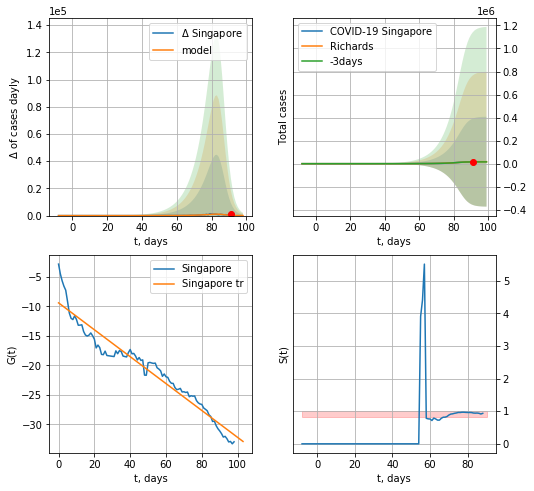

Singapore data at: 2020-05-01
+3 day model MAPE: 0.10297932085101628
model: Richards
coeffs:  [1.72866147e+04 1.28438849e-01 8.60287687e+01 3.08439444e+00]
rational stdev:  22.60428041586045
forecast at the end of period: +8 days
	 deltaDaycases:  15
	 total cases:  17253 ± 390011
	 total death:  16 ± 1085
trend coefficient of determination: 0.935537
 intercept: -9.402945
 slope: -0.228229


In [176]:
x = forecastRR('Singapore',dfSG[:],d1,6*7-dT,1.0)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)

In [183]:
#trend3(dfLT,dfES,dfLV[:],'LT','ES','LV',40,40,40)
#x = forecastRRR('Singapore',dfSG[35:],d1,6*7-dT,1.0)

In [184]:
#+1932/2944.#2020-04-03
#shift = 1.0#1+1849/1900.#2020-04-02
#shift = 1.+3288./2809
#x =forecast('Lithuania',dfLT[:],d1,8*7-dT,shift,addpred=True,xcoef=[0.25,1.,3.])
#xx =forecast2('Lithuania',dfLT[:],d1,3*7-dT,x)

In [185]:
#x =forecastR('Lithuania',dfLT[:],d1,7*6-dT,shift)

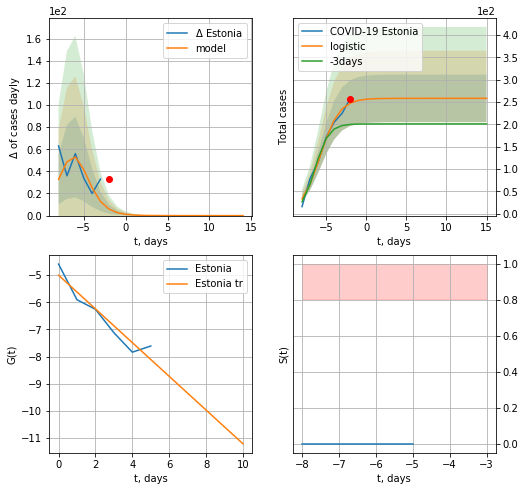

Estonia data at: 2020-05-01
+3 day model MAPE: 0.26329059885154926
model: logistic
coeffs:  [258.51169182   0.83984365  -5.73516243]
rational stdev:  0.20630354623999803
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  258 ± 53
	 total death:  7 ± 4
trend coefficient of determination: 0.908255
 intercept: -5.002820
 slope: -0.620580


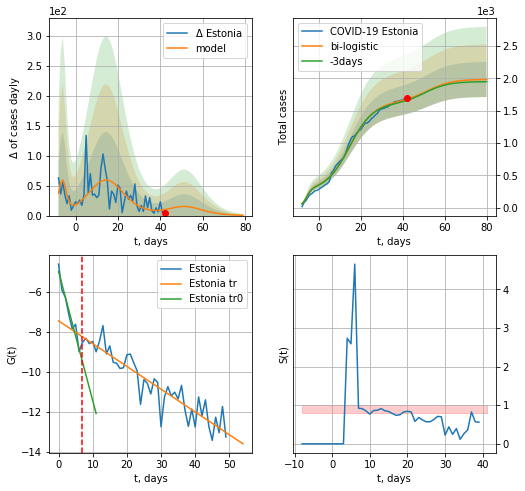

Estonia data at: 2020-05-01
+3 day model MAPE: 0.011030221647066343
model: bi-logistic
coeffs:  [1.38155985e+03 1.72355639e-01 1.48630157e+01] [258.51169182   0.83984365  -5.73516243]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.13676153308756303
forecast at the end of period: +38 days
	 deltaDaycases:  0
	 total cases:  1982 ± 271
	 total death:  60 ± 24
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.942621
 intercept: -4.958003
 slope: -0.647470
trend coefficient of determination: 0.841110
 intercept: -7.437992
 slope: -0.114105


In [177]:
shift = 1.0
x = forecast('Estonia',dfES[:7],d1,17,1.)
xx = forecast2('Estonia',dfES[:],d1,12*6-dT,x,1.,addpred=True,xcoef=[0.25,1.,3.5],vL=7)

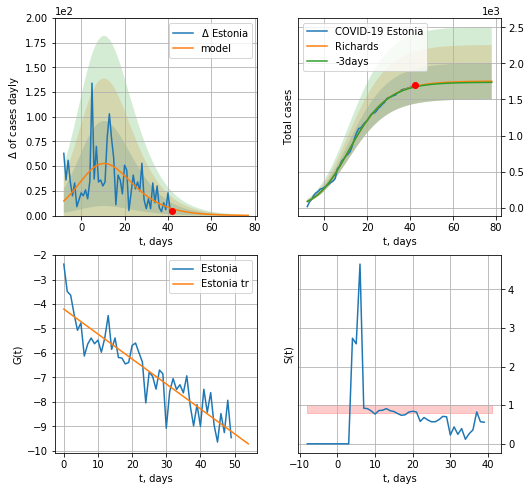

Estonia data at: 2020-05-01
+3 day model MAPE: 0.005398196233037725
model: Richards
coeffs:  [1.75514288e+03 2.06243640e-01 3.97150033e+00 4.89825222e-01]
rational stdev:  0.1430879353968304
forecast at the end of period: +36 days
	 deltaDaycases:  0
	 total cases:  1753 ± 250
	 total death:  53 ± 22
trend coefficient of determination: 0.822469
 intercept: -4.207694
 slope: -0.102076


In [178]:
x = forecastRR('Estonia',dfES[:],d1,7*10-dT,1.)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
#xx = forecast2R('Estonia',dfES[:],d1,7*5-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


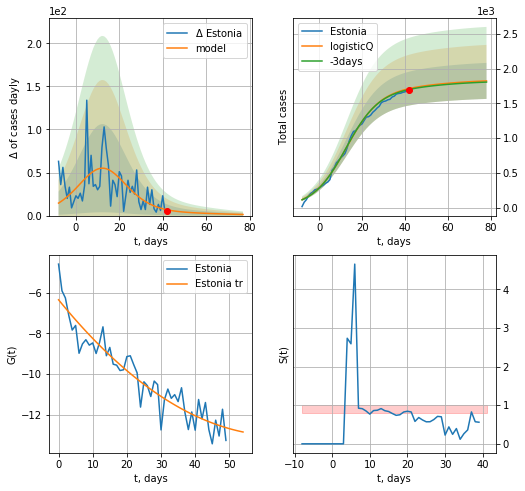

Estonia data at: 2020-05-01
+3 day model MAPE: 0.007559
model: logisticQ
coeffs: [ 1.69746195e+03  2.89525228e-06  1.26281808e+01 -4.42535598e+04]
S.Korea scenario coeffs: [0.0875, 0.5, 4.0, 1]
rational stdev: 0.141939
forecast at the end of period: +36 days
	 deltaDaycases: 1
	 total cases: 1823 ± 258
	 total death: 55 ± 23
trend coefficient of determination: 0.883441
 intercept_: -6.3484872075335215
 coeffs_: [ 0.         -0.20574708  0.00158183]


In [179]:
x = forecastRRR('Estonia',dfES[:],d1,7*10-dT,1.,addpred=True,xcoef=[0.35/4,.5,4.,1])

LV
          date  cases  active  death
51 2020-04-27  818.0   538.0   13.0
52 2020-04-28  836.0   556.0   13.0
53 2020-04-29  849.0   486.0   15.0
54 2020-04-30  858.0   495.0   15.0
55 2020-05-01  870.0   506.0   16.0


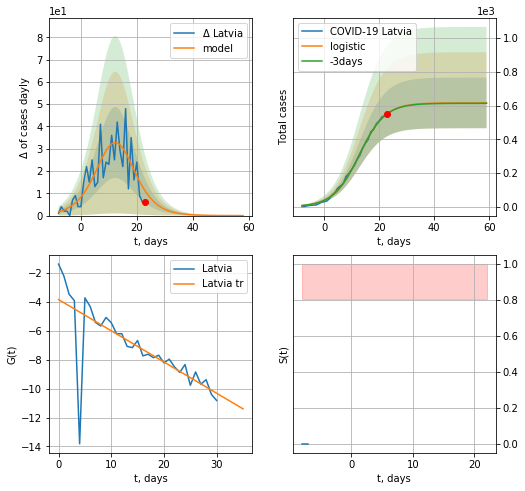

Latvia data at: 2020-05-01
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +36 days
	 deltaDaycases:  0
	 total cases:  616 ± 150
	 total death:  11 ± 8
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


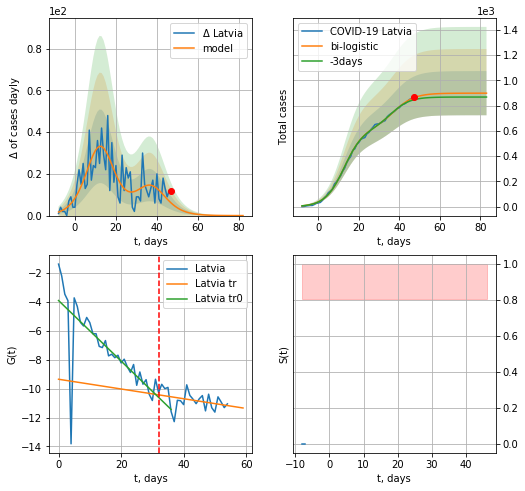

Latvia data at: 2020-05-01
+3 day model MAPE: 0.02061983221595437
model: bi-logistic
coeffs:  [2.83189213e+02 1.96834859e-01 3.74000028e+01] [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.19450486838604958
forecast at the end of period: +36 days
	 deltaDaycases:  0
	 total cases:  899 ± 174
	 total death:  16 ± 9
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.543521
 intercept: -3.904452
 slope: -0.209287
trend coefficient of determination: 0.123571
 intercept: -9.349424
 slope: -0.033693


In [180]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
x = forecast('Latvia',dfLV[:vL],d1,10*7-dT,1.)
xx=forecast2('Latvia',dfLV[:],d1,10*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


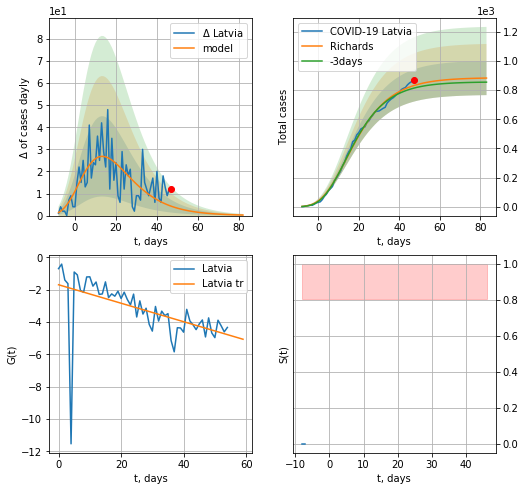

Latvia data at: 2020-05-01
+3 day model MAPE: 0.022210086464021568
model: Richards
coeffs:  [ 8.85601952e+02  1.12129665e+01 -4.55759242e+01  7.37456832e-03]
rational stdev:  0.13250682832850152
forecast at the end of period: +36 days
	 deltaDaycases:  0
	 total cases:  882 ± 116
	 total death:  16 ± 6
trend coefficient of determination: 0.279224
 intercept: -1.694818
 slope: -0.057107


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


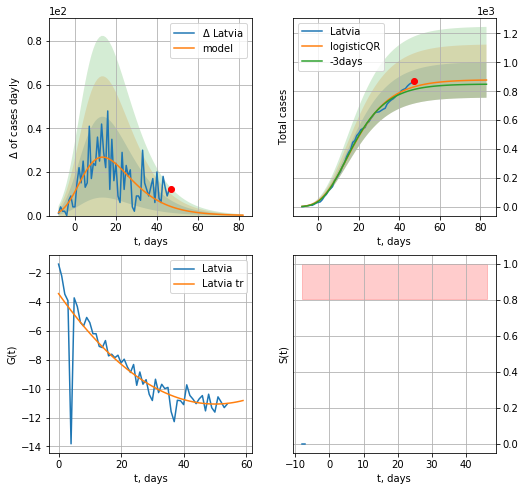

Latvia data at: 2020-05-01
+3 day model MAPE: 0.023171431930029344
model: logisticQR
coeffs:  [ 8.79499814e+02  4.49423880e-02 -7.04103522e+01 -1.13377497e+03
  1.49907529e-03]
rational stdev:  0.13975568147324294
forecast at the end of period: +36 days
	 deltaDaycases:  0
	 total cases:  877 ± 122
	 total death:  16 ± 6
trend coefficient of determination: 0.735897
 intercept_: -3.428003990089236
 coeffs_: [ 0.         -0.30493318  0.00304435]


In [181]:
x = forecastRR('Latvia',dfLV[:],d1,7*10-dT,1.)
x = forecastQR('Latvia',dfLV[:],d1,7*10-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


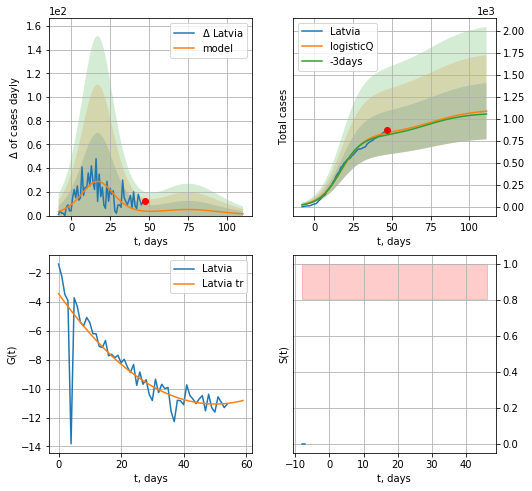

Latvia data at: 2020-05-01
+3 day model MAPE: 0.027954
model: logisticQ
coeffs: [ 8.17623506e+02  8.83020037e-07  1.73570378e+01 -1.58123287e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.294327
forecast at the end of period: +64 days
	 deltaDaycases: 1
	 total cases: 1084 ± 319
	 total death: 19 ± 16
trend coefficient of determination: 0.735897
 intercept_: -3.428003990089236
 coeffs_: [ 0.         -0.30493318  0.00304435]


In [183]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*14-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


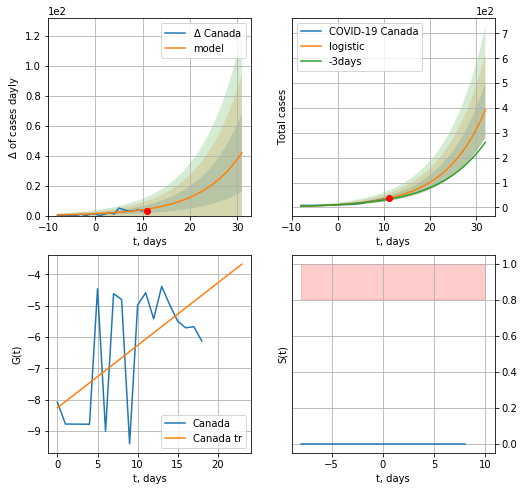

Canada data at: 2020-05-01
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  24 ± 20
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


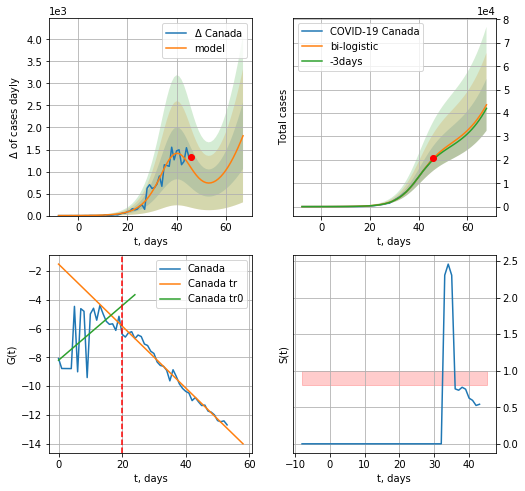

Canada data at: 2020-05-01
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +22 days
	 deltaDaycases:  1812
	 total cases:  43528 ± 11096
	 total death:  2680 ± 2049
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


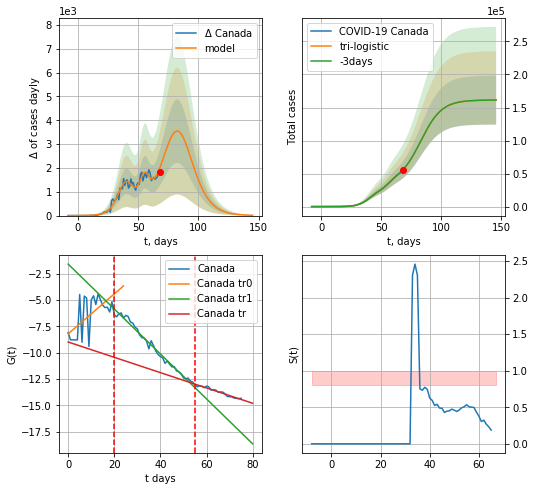

Canada data at: 2020-05-01
+3 day model MAPE: 0.0028810331926846498
model: tri-logistic
coeffs:  [1.18726004e+04 3.53613608e-01 5.57773321e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  0.22932802804788013
forecast at the end of period: +78 days
	 deltaDaycases:  11
	 total cases:  161129 ± 36951
	 total death:  9923 ± 6826
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.953851
 intercept: -8.977447
 slope: -0.072796


In [184]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,8*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
          date    cases  active   death
72 2020-04-27  48500.0   27525  2707.0
73 2020-04-28  50026.0   27977  2859.0
74 2020-04-29  51597.0   28274  2996.0
75 2020-04-30  53236.0   28629  3184.0
76 2020-05-01  55061.0   28919  3391.0


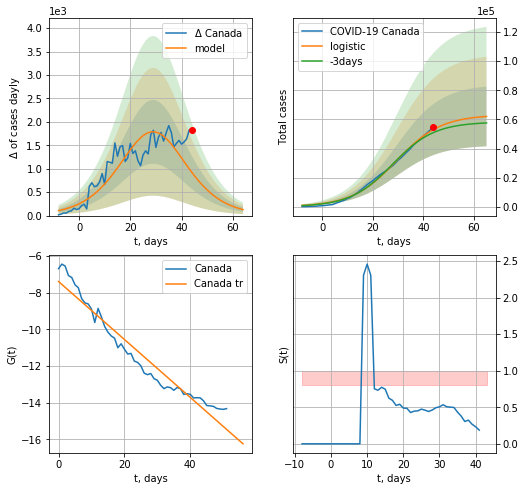

Canada data at: 2020-05-01
+3 day model MAPE: 0.04382244260593576
model: logistic
coeffs:  [6.31229492e+04 1.13407703e-01 2.93713029e+01]
rational stdev:  0.3305822858020712
forecast at the end of period: +21 days
	 deltaDaycases:  128
	 total cases:  62031 ± 20506
	 total death:  3820 ± 3788
trend coefficient of determination: 0.941219
 intercept: -7.394636
 slope: -0.157961


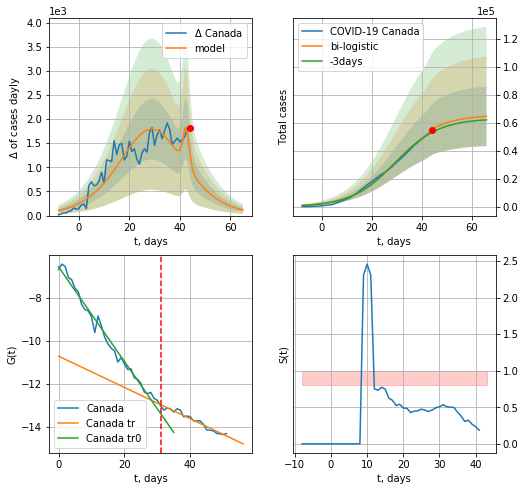

Canada data at: 2020-05-01
+3 day model MAPE: 0.04382033824999715
model: bi-logistic
coeffs:  [2.52610831e+03 1.32713461e+00 4.29791434e+01] [6.31229492e+04 1.13407703e-01 2.93713029e+01]
rational stdev:  0.3296469549691873
forecast at the end of period: +22 days
	 deltaDaycases:  115
	 total cases:  64673 ± 21319
	 total death:  3982 ± 3937
bi-logistic approximation splitting point: 31
trend0 coefficient of determination: 0.983688
 intercept: -6.573152
 slope: -0.220036
trend coefficient of determination: 0.953851
 intercept: -10.724551
 slope: -0.072796


In [185]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,3*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,8*7-dT,x,1.,vL=31,cases='cases')

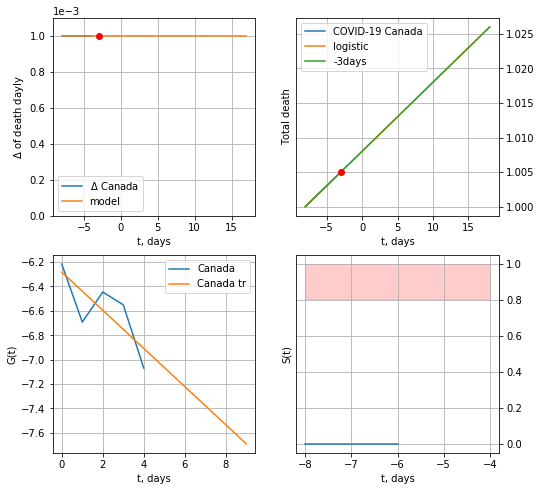

Canada data at: 2020-05-01
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


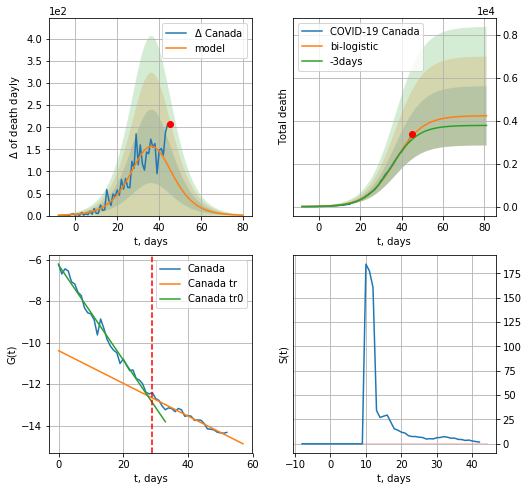

Canada data at: 2020-05-01
+3 day model MAPE: 0.053840743619956305
model: bi-logistic
coeffs:  [4.24166668e+03 1.48175813e-01 3.67775227e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.32629938342652604
forecast at the end of period: +36 days
	 deltaDaydeath:  0
	 total death:  4236 ± 1382
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.959209
 intercept: -10.386003
 slope: -0.078713


In [186]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,10*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


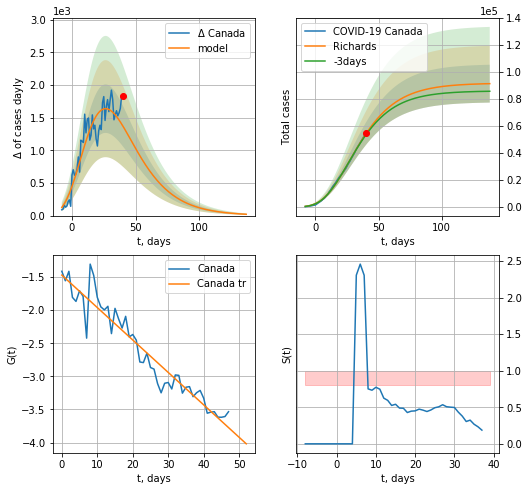

Canada data at: 2020-05-01
+3 day model MAPE: 0.016052341097942277
model: Richards
coeffs:  [ 9.17298099e+04  4.18899800e+00 -6.43684078e+01  1.16467595e-02]
rational stdev:  0.15343025620256223
forecast at the end of period: +98 days
	 deltaDaycases:  20
	 total cases:  91324 ± 14011
	 total death:  5624 ± 2588
trend coefficient of determination: 0.920765
 intercept: -1.469160
 slope: -0.049046


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


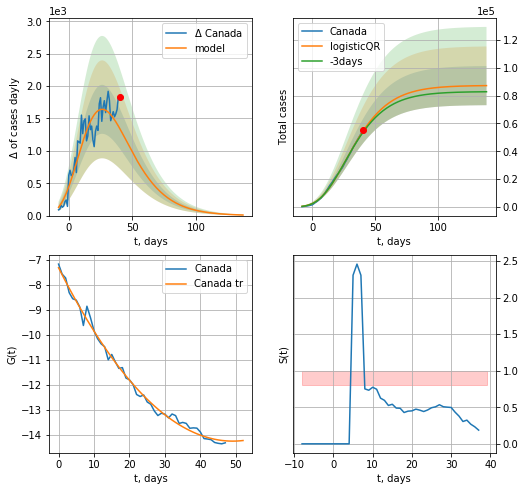

Canada data at: 2020-05-01
+3 day model MAPE: 0.016383761201290488
model: logisticQR
coeffs:  [ 8.73666330e+04  1.11705405e-02 -9.29439007e+01 -7.31475894e+02
  5.22805250e-03]
rational stdev:  0.16128713917121365
forecast at the end of period: +98 days
	 deltaDaycases:  8
	 total cases:  87231 ± 14069
	 total death:  5372 ± 2599
trend coefficient of determination: 0.993116
 intercept_: -7.319051535160558
 coeffs_: [ 0.         -0.28244787  0.00287509]


In [187]:
x = forecastRR('Canada',dfCA[28:],d1,14*7,1.)
x = forecastQR('Canada',dfCA[28:],d1,14*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


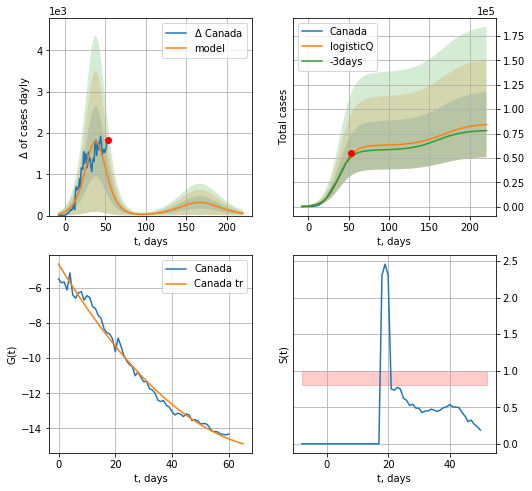

Canada data at: 2020-05-01
+3 day model MAPE: 0.044387
model: logisticQ
coeffs: [ 6.28397997e+04  1.58381095e-06  3.82758055e+01 -7.20038376e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.397065
forecast at the end of period: +168 days
	 deltaDaycases: 53
	 total cases: 84144 ± 33410
	 total death: 5182 ± 6172
trend coefficient of determination: 0.985077
 intercept_: -4.646792557919564
 coeffs_: [ 0.         -0.26703397  0.00168712]


In [188]:
x = forecastRRR('Canada',dfCA[15:],d1,7*24,1.,addpred=True,xcoef=koreaCoeffs)

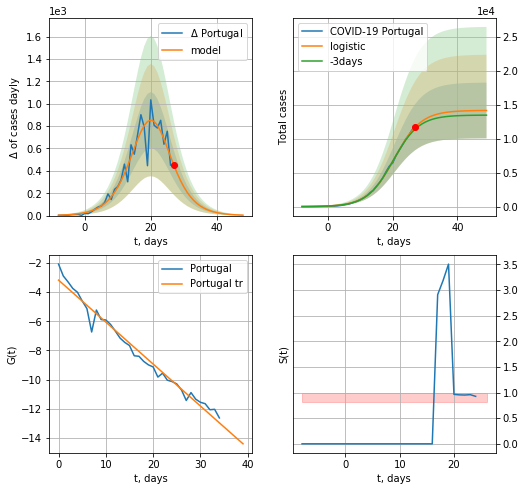

Portugal data at: 2020-05-01
+3 day model MAPE: 0.02892624169663467
model: logistic
coeffs:  [1.41442510e+04 2.41786786e-01 2.05224861e+01]
rational stdev:  0.2898390257045352
forecast at the end of period: +22 days
	 deltaDaycases:  3
	 total cases:  14129 ± 4095
	 total death:  561 ± 487
trend coefficient of determination: 0.976589
 intercept: -3.176863
 slope: -0.287805


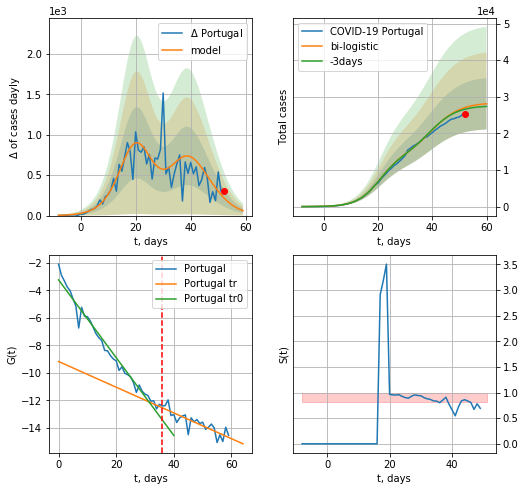

Portugal data at: 2020-05-01
+3 day model MAPE: 0.018590382078001986
model: bi-logistic
coeffs:  [1.13600023e+04 2.17694013e-01 3.88718594e+01] [1.41442510e+04 2.41786786e-01 2.05224861e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.249331565881871
forecast at the end of period: +8 days
	 deltaDaycases:  60
	 total cases:  28082 ± 7001
	 total death:  1115 ± 834
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975280
 intercept: -3.225895
 slope: -0.283479
trend coefficient of determination: 0.708588
 intercept: -9.173968
 slope: -0.093735


In [189]:
vL = 36
x = forecast('Portugal',dfPT[:vL],d1,8*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,6*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


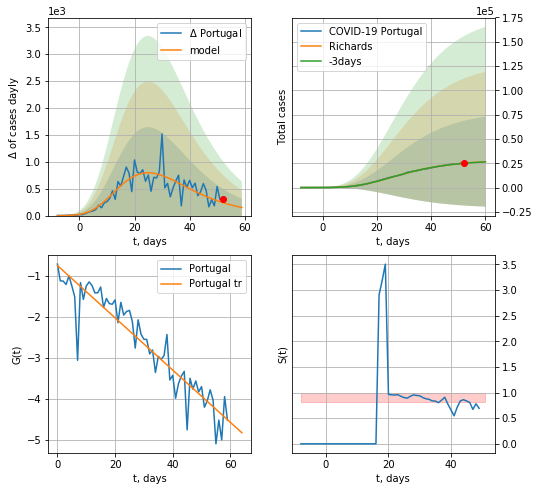

Portugal data at: 2020-05-01
+3 day model MAPE: 0.006119630352746595
model: Richards
coeffs:  [ 2.85887567e+04  6.85007840e+00 -3.37140390e+01  1.11130655e-02]
rational stdev:  1.736917175885659
forecast at the end of period: +8 days
	 deltaDaycases:  150
	 total cases:  26609 ± 46218
	 total death:  1057 ± 5507
trend coefficient of determination: 0.875476
 intercept: -0.743697
 slope: -0.063930


In [190]:
x = forecastRR('Portugal',dfPT[:],d1,6*7-dT,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


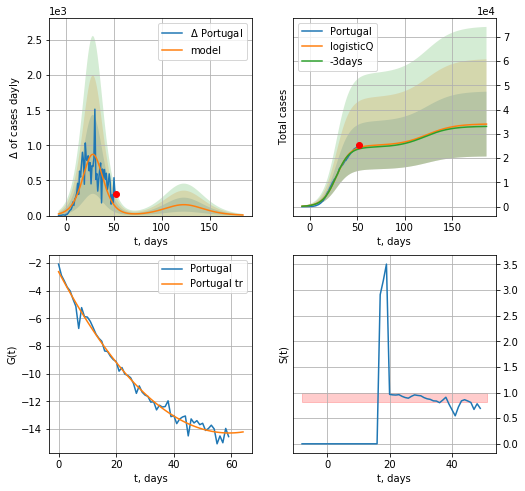

Portugal data at: 2020-05-01
+3 day model MAPE: 0.023576
model: logisticQ
coeffs: [ 2.52250680e+04  1.37647204e-06  2.83438081e+01 -1.00549147e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.392666
forecast at the end of period: +134 days
	 deltaDaycases: 8
	 total cases: 34045 ± 13368
	 total death: 1352 ± 1592
trend coefficient of determination: 0.988768
 intercept_: -2.6290482802486395
 coeffs_: [ 0.         -0.39428307  0.00333096]


In [191]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

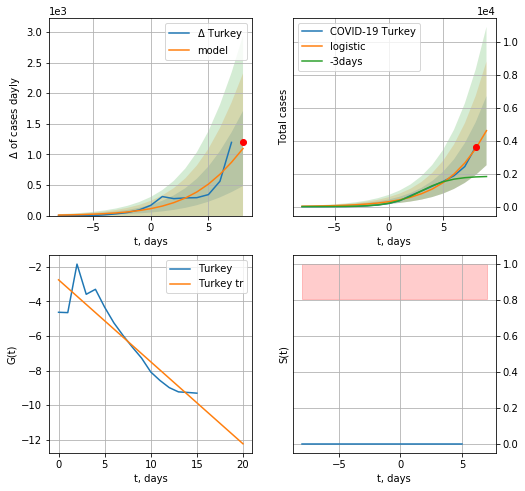

Turkey data at: 2020-05-01
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +1 days
	 deltaDaycases:  1095
	 total cases:  4611 ± 2098
	 total death:  122 ± 166
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


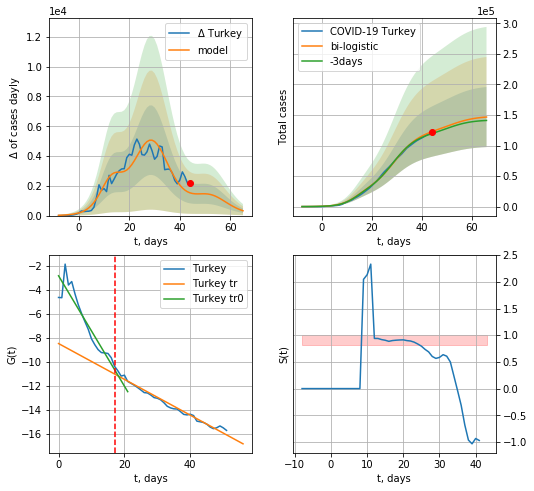

Turkey data at: 2020-05-01
+3 day model MAPE: 0.027604733709744915
model: bi-logistic
coeffs:  [9.90924110e+04 2.01199252e-01 2.91057276e+01] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3354761480358731
forecast at the end of period: +22 days
	 deltaDaycases:  324
	 total cases:  146568 ± 49170
	 total death:  3901 ± 3926
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.977403
 intercept: -8.477793
 slope: -0.149672


In [192]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,5*7-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,8*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


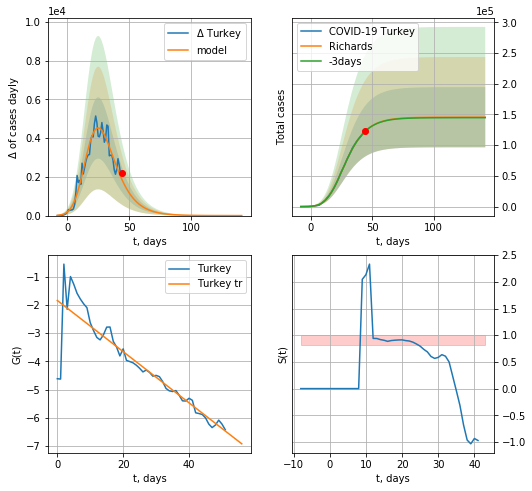

Turkey data at: 2020-05-01
+3 day model MAPE: 0.001581857179675338
model: Richards
coeffs:  [1.45516725e+05 4.53816342e-01 8.44417988e+00 2.04953308e-01]
rational stdev:  0.3366486968820245
forecast at the end of period: +98 days
	 deltaDaycases:  0
	 total cases:  145513 ± 48987
	 total death:  3873 ± 3911
trend coefficient of determination: 0.810399
 intercept: -1.844770
 slope: -0.090668


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


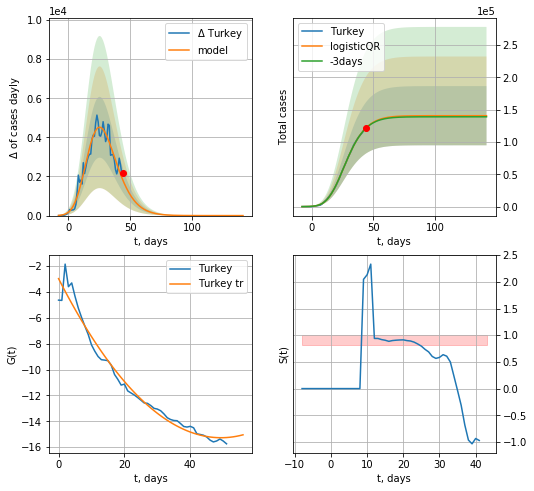

Turkey data at: 2020-05-01
+3 day model MAPE: 0.003968079143160577
model: logisticQR
coeffs:  [ 1.40805616e+05  2.27032717e-02 -6.30916423e+01 -6.30908303e+01
  2.20820596e-02]
rational stdev:  0.3256067985531073
forecast at the end of period: +98 days
	 deltaDaycases:  0
	 total cases:  140805 ± 45847
	 total death:  3748 ± 3661
trend coefficient of determination: 0.975727
 intercept_: -2.960535569594539
 coeffs_: [ 0.         -0.49905072  0.00505877]


In [193]:
x = forecastRR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1])
x = forecastQR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


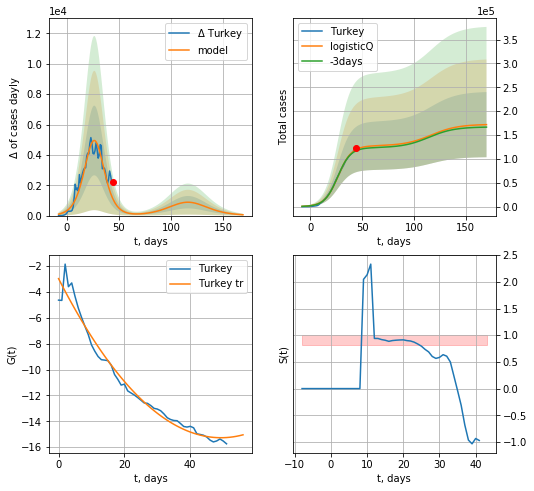

Turkey data at: 2020-05-01
+3 day model MAPE: 0.022870
model: logisticQ
coeffs: [ 1.27349120e+05  3.18621385e-06  2.67548222e+01 -4.87903929e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.397465
forecast at the end of period: +126 days
	 deltaDaycases: 54
	 total cases: 171770 ± 68272
	 total death: 4572 ± 5451
trend coefficient of determination: 0.975727
 intercept_: -2.960535569594539
 coeffs_: [ 0.         -0.49905072  0.00505877]


In [194]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [195]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.01839080459770115

In [196]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

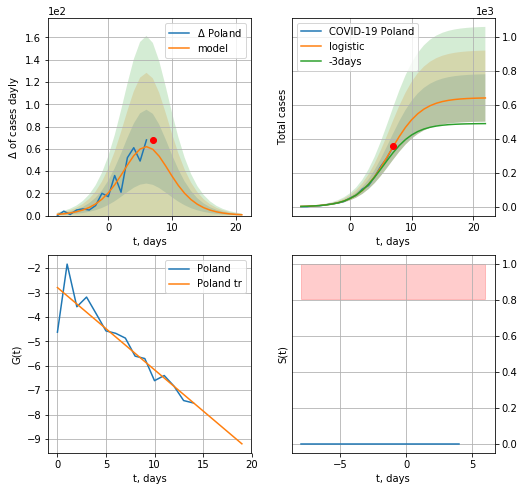

Poland data at: 2020-05-01
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +15 days
	 deltaDaycases:  0
	 total cases:  639 ± 139
	 total death:  31 ± 20
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


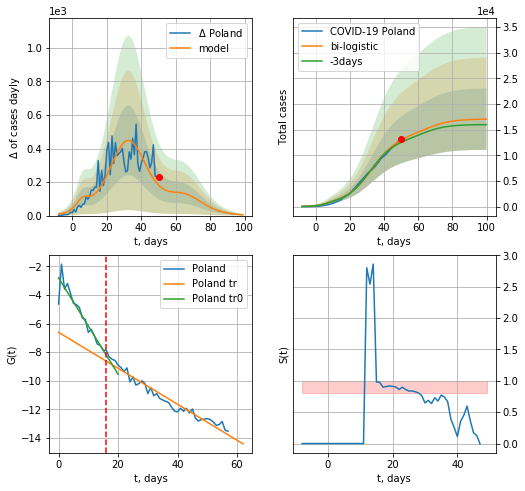

Poland data at: 2020-05-01
+3 day model MAPE: 0.038088370706511866
model: bi-logistic
coeffs:  [1.31677139e+04 1.34652500e-01 3.28107064e+01] [6.41107567e+02 3.87606719e-01 6.46563498e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3513069095912681
forecast at the end of period: +50 days
	 deltaDaycases:  4
	 total cases:  17067 ± 5995
	 total death:  847 ± 892
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.953580
 intercept: -6.609583
 slope: -0.125831


In [197]:
vL=16
vL1=38
x =  forecast('Poland',dfPL[:vL],d1,7*7-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,12*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


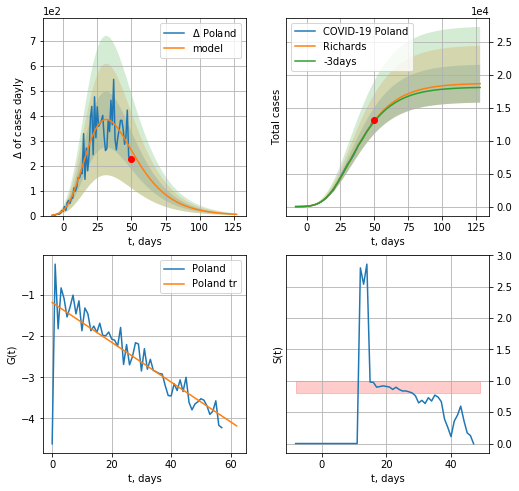

Poland data at: 2020-05-01
+3 day model MAPE: 0.009997961446654288
model: Richards
coeffs:  [ 1.87553283e+04  3.09905724e+00 -3.92119006e+01  1.81546041e-02]
rational stdev:  0.1540187328077414
forecast at the end of period: +78 days
	 deltaDaycases:  4
	 total cases:  18670 ± 2875
	 total death:  927 ± 428
trend coefficient of determination: 0.699676
 intercept: -1.186985
 slope: -0.048274


In [198]:
x =  forecastRR('Poland',dfPL[:],d1,16*7-dT)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


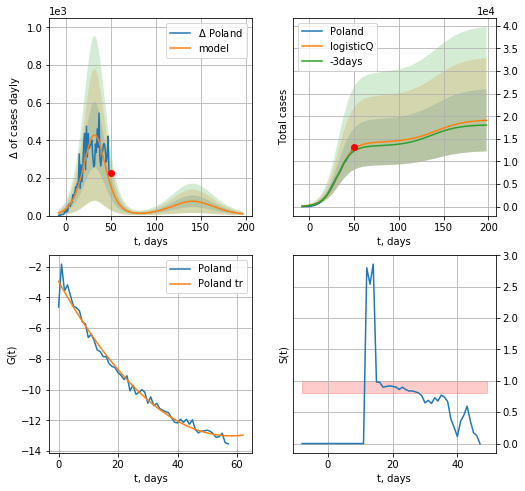

Poland data at: 2020-05-01
+3 day model MAPE: 0.037079
model: logisticQ
coeffs: [ 1.42253600e+04  2.11565969e-06  3.24639789e+01 -5.69488902e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.360558
forecast at the end of period: +148 days
	 deltaDaycases: 9
	 total cases: 19104 ± 6888
	 total death: 949 ± 1026
trend coefficient of determination: 0.983240
 intercept_: -2.9618002756254684
 coeffs_: [ 0.         -0.34709555  0.00299614]


In [199]:
x =  forecastRRR('Poland',dfPL[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
          date    cases  active  death
65 2020-04-27  15589.0    8006  208.0
66 2020-04-28  15728.0    7772  210.0
67 2020-04-29  15834.0    7386  215.0
68 2020-04-30  15946.0    7163  222.0
69 2020-05-01  16101.0    6720  225.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


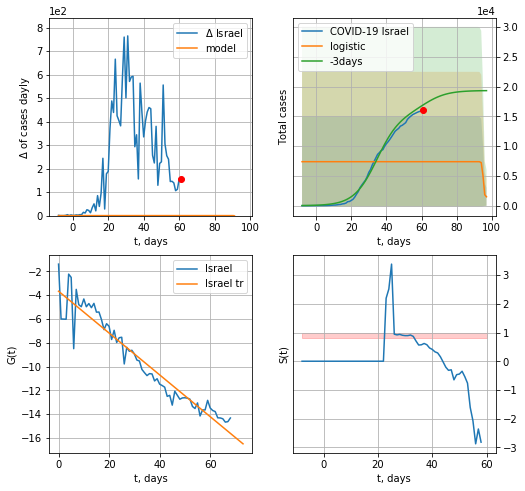

Israel data at: 2020-05-01
+3 day model MAPE: 0.5683370953926038
model: logistic
coeffs:  [ 5.91050100e+03 -3.15705570e+00  9.51333567e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.0210839302324313
forecast at the end of period: +36 days
	 deltaDaycases:  -343
	 total cases:  1493 ± 1525
	 total death:  20 ± 61
trend coefficient of determination: 0.919749
 intercept: -3.667819
 slope: -0.175791


In [200]:
dfIS = read_df(pd.DataFrame(),"IS")
x = forecast('Israel',dfIS[:],d1,10*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


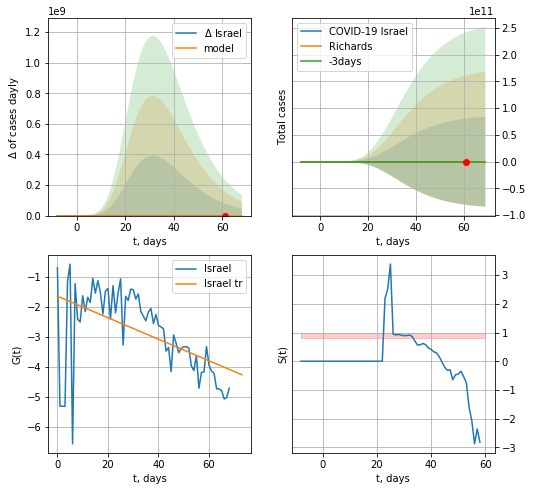

Israel data at: 2020-05-01
+3 day model MAPE: 0.0052401496675652404
model: Richards
coeffs:  [ 1.73361517e+04  1.31864326e+01 -2.72692202e+01  6.47027318e-03]
rational stdev:  5053090.549220648
forecast at the end of period: +8 days
	 deltaDaycases:  61
	 total cases:  16625 ± 84009311164
	 total death:  232 ± 3516951022
trend coefficient of determination: 0.271419
 intercept: -1.642505
 slope: -0.035879


In [201]:
x = forecastRR('Israel',dfIS[:],d1,6*7-dT)
#xx = forecast2R('Israel',dfIS[:],d1,7*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


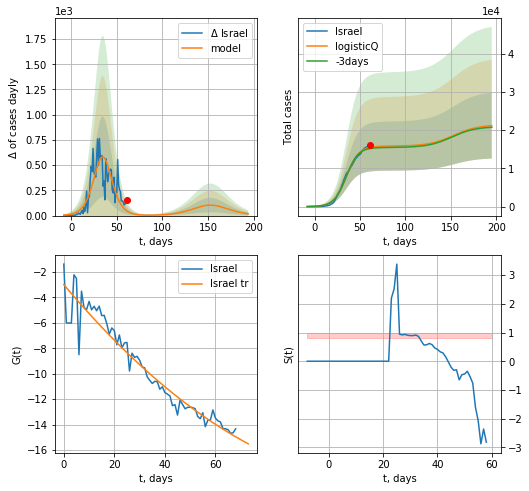

Israel data at: 2020-05-01
+3 day model MAPE: 0.019518
model: logisticQ
coeffs: [ 1.58258759e+04  1.25138632e-06  3.50884986e+01 -1.17701213e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.406572
forecast at the end of period: +134 days
	 deltaDaycases: 17
	 total cases: 21193 ± 8616
	 total death: 296 ± 361
trend coefficient of determination: 0.927187
 intercept_: -2.9954776721803684
 coeffs_: [ 0.         -0.23601825  0.00088582]


In [202]:
x = forecastRRR('Israel',dfIS[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


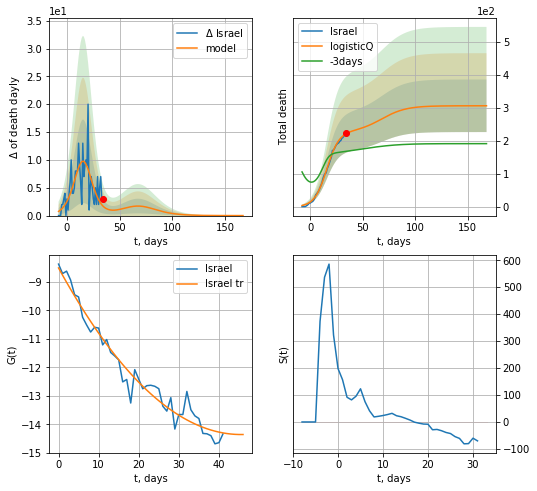

Israel data at: 2020-05-01
+3 day model MAPE: 0.323444
model: logisticQ
coeffs: [ 2.26189172e+02  1.38584208e-04  1.55778963e+01 -1.22084434e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.259876
forecast at the end of period: +134 days
	 total death: 306 ± 79
trend coefficient of determination: 0.961106
 intercept_: -8.519354701590775
 coeffs_: [ 0.         -0.25644348  0.00281908]


In [203]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


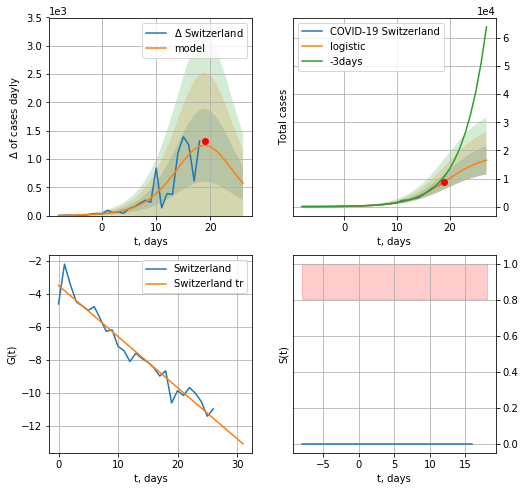

Switzerland data at: 2020-05-01
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +8 days
	 deltaDaycases:  567
	 total cases:  16525 ± 5057
	 total death:  975 ± 895
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


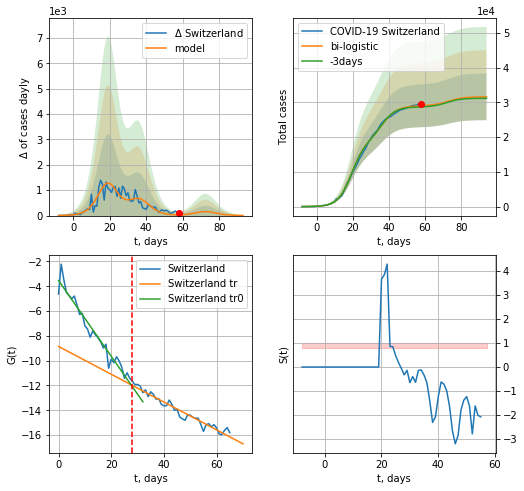

Switzerland data at: 2020-05-01
+3 day model MAPE: 0.011078092653103958
model: bi-logistic
coeffs:  [1.03469534e+04 2.41330762e-01 3.64480592e+01] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.21245995994801767
forecast at the end of period: +36 days
	 deltaDaycases:  4
	 total cases:  31624 ± 6718
	 total death:  1867 ± 1189
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.945791
 intercept: -8.855100
 slope: -0.112197


In [204]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*6-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*10-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


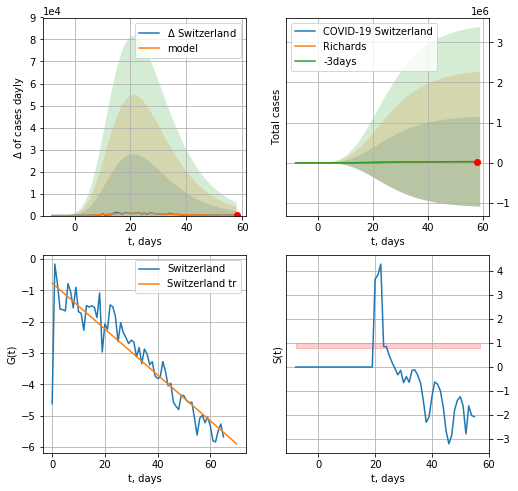

Switzerland data at: 2020-05-01
+3 day model MAPE: 0.0017625281555990668
model: Richards
coeffs:  [ 3.03790730e+04  6.37695069e+00 -2.12442578e+01  1.53083478e-02]
rational stdev:  37.74696979098731
forecast at the end of period: +1 days
	 deltaDaycases:  78
	 total cases:  29602 ± 1117422
	 total death:  1747 ± 197831
trend coefficient of determination: 0.832558
 intercept: -0.772228
 slope: -0.073224


In [205]:
x = forecastRR('Switzerland',dfSZ[:],d1,7*5-dT)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


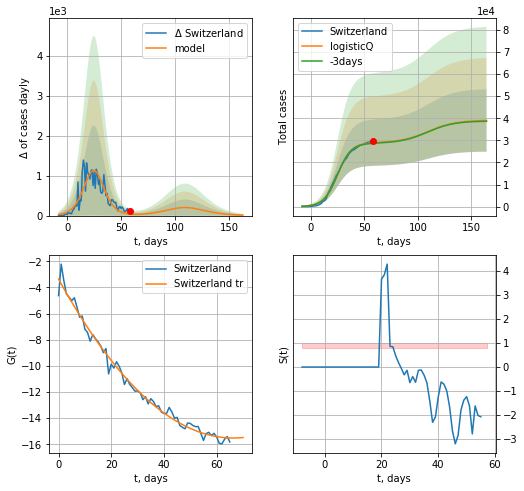

Switzerland data at: 2020-05-01
+3 day model MAPE: 0.009162
model: logisticQ
coeffs: [ 2.89036380e+04  1.23331932e-06  2.51500499e+01 -1.27205429e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.361987
forecast at the end of period: +106 days
	 deltaDaycases: 11
	 total cases: 39002 ± 14118
	 total death: 2302 ± 2499
trend coefficient of determination: 0.987150
 intercept_: -3.3578702088942904
 coeffs_: [ 0.         -0.36682256  0.00276614]


In [206]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=True,xcoef=koreaCoeffs)

In [207]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
          date    cases  active  death
48 2020-04-27   9410.0    8179  239.0
49 2020-04-28   9866.0    8513  250.0
50 2020-04-29  10406.0    8907  261.0
51 2020-04-30  10861.0    9176  272.0
52 2020-05-01  11411.0    9634  279.0


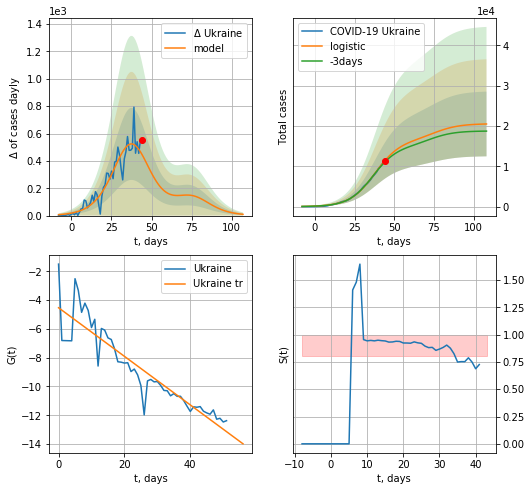

Ukraine data at: 2020-05-01
+3 day model MAPE: 0.033731289655809606
model: logistic
coeffs:  [1.64399350e+04 1.26589552e-01 3.78371365e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3916728662146737
forecast at the end of period: +64 days
	 deltaDaycases:  9
	 total cases:  20480 ± 8021
	 total death:  512 ± 601
trend coefficient of determination: 0.836936
 intercept: -4.533254
 slope: -0.168698


In [389]:
dfUR = read_df(pd.DataFrame(),"Ukr")
x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:131: RuntimeWarning: invalid value encountered in true_divide


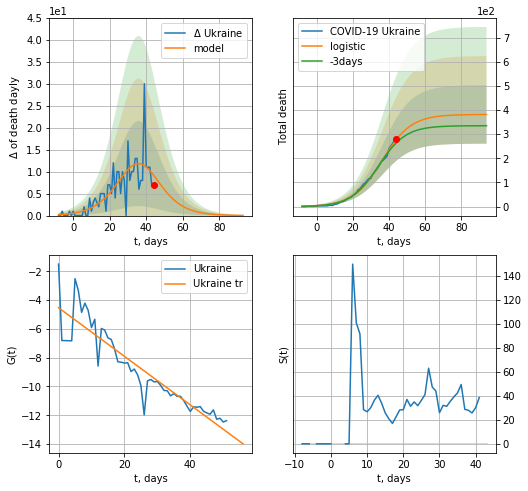

Ukraine data at: 2020-05-01
+3 day model MAPE: 0.05635952311742011
model: logistic
coeffs:  [3.81789644e+02 1.24039806e-01 3.62428418e+01]
rational stdev:  0.3169775250159932
forecast at the end of period: +50 days
	 total death:  381 ± 120
trend coefficient of determination: 0.836936
 intercept: -4.533254
 slope: -0.168698


In [390]:
x=forecast('Ukraine',dfUR[:],d1,12*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


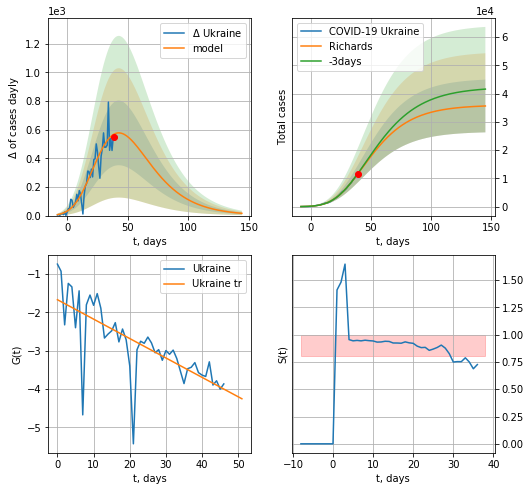

Ukraine data at: 2020-05-01
+3 day model MAPE: 0.009945986876487057
model: Richards
coeffs:  [ 3.59418449e+04  5.11010574e-01 -9.86669739e+00  8.93383693e-02]
rational stdev:  0.2619313373153715
forecast at the end of period: +106 days
	 deltaDaycases:  15
	 total cases:  35601 ± 9325
	 total death:  891 ± 700
trend coefficient of determination: 0.523863
 intercept: -1.671375
 slope: -0.050638


In [391]:
x=forecastRR('Ukraine',dfUR[5:],d1,7*20-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


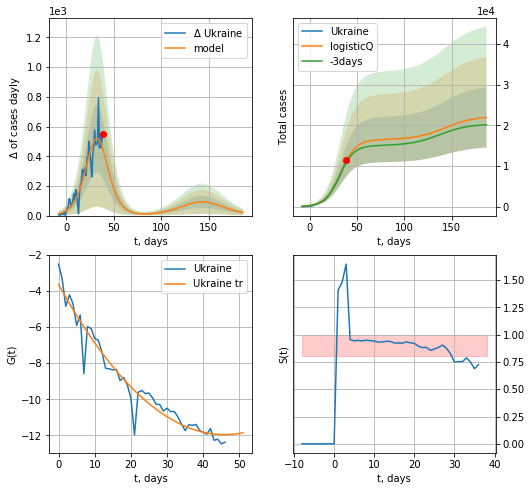

Ukraine data at: 2020-05-01
+3 day model MAPE: 0.034489
model: logisticQ
coeffs: [ 1.64548321e+04  6.66857815e-06  3.28541766e+01 -1.89389729e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.338090
forecast at the end of period: +148 days
	 deltaDaycases: 20
	 total cases: 21943 ± 7418
	 total death: 549 ± 556
trend coefficient of determination: 0.938363
 intercept_: -3.6340534471368686
 coeffs_: [ 0.         -0.36322464  0.003963  ]


In [392]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*26-dT,addpred=True,xcoef=koreaCoeffs)

In [212]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

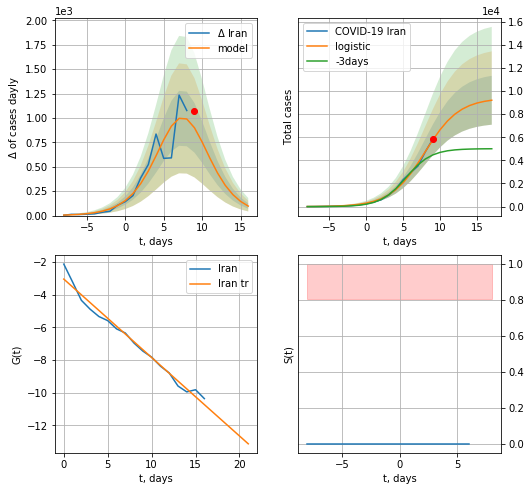

Iran data at: 2020-05-01
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +8 days
	 deltaDaycases:  97
	 total cases:  9198 ± 2113
	 total death:  585 ± 403
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


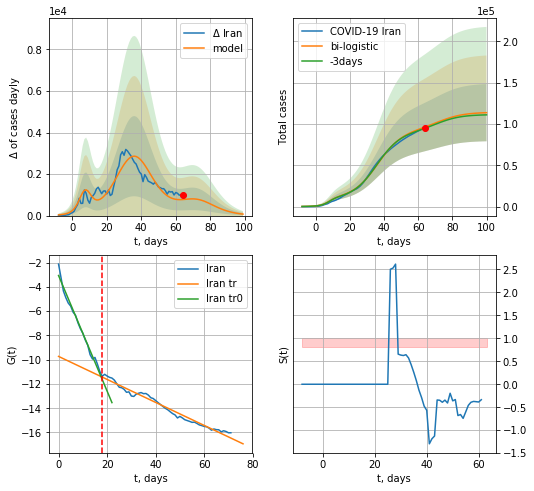

Iran data at: 2020-05-01
+3 day model MAPE: 0.015883130852148913
model: bi-logistic
coeffs:  [8.37928777e+04 1.35652695e-01 3.62426770e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.30439635830207534
forecast at the end of period: +36 days
	 deltaDaycases:  71
	 total cases:  113622 ± 34586
	 total death:  7235 ± 6606
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.976568
 intercept: -9.728368
 slope: -0.094815


In [213]:
x = forecast('Iran',dfIN[:18],d1,6*7-dT)
xx = forecast2('Iran',dfIN[:],d1,10*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


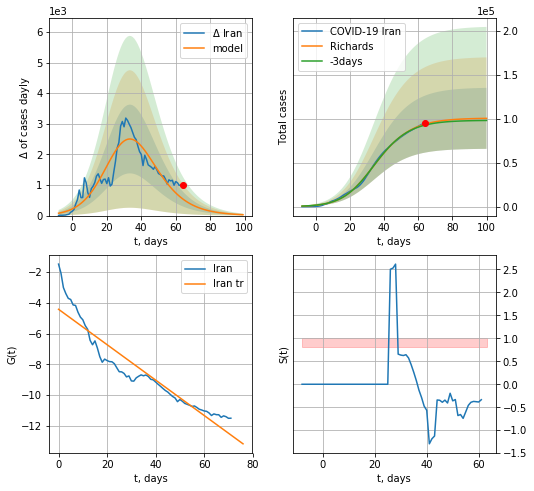

Iran data at: 2020-05-01
+3 day model MAPE: 0.01283104182660751
model: Richards
coeffs:  [1.00943742e+05 1.43585094e-01 2.80987021e+01 6.06278557e-01]
rational stdev:  0.3453854115112891
forecast at the end of period: +36 days
	 deltaDaycases:  28
	 total cases:  100626 ± 34754
	 total death:  6408 ± 6639
trend coefficient of determination: 0.887467
 intercept: -4.424223
 slope: -0.115123


In [214]:
x = forecastRR('Iran',dfIN[:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


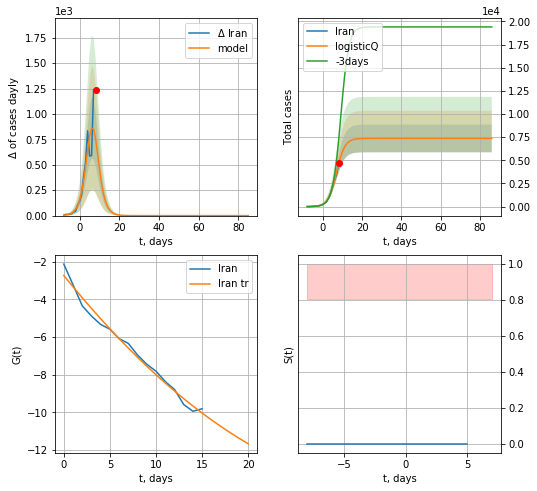

Iran data at: 2020-05-01
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +78 days
	 deltaDaycases: 0
	 total cases: 7368 ± 1495
	 total death: 469 ± 285
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:264: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


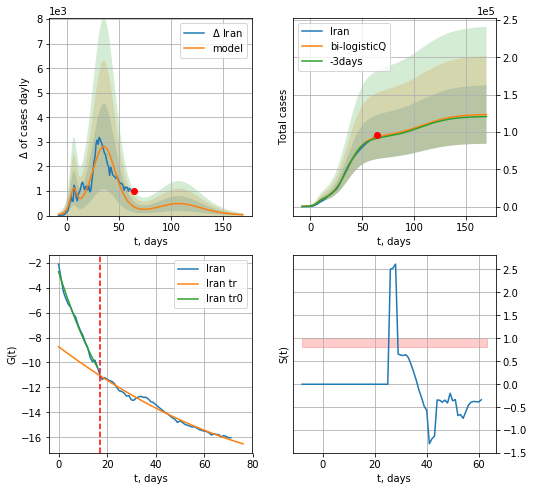

Iran data at: 2020-05-01
+3 day model MAPE: 0.019157694064713814
model: bi-logisticQ
coeffs:  [ 8.63906785e+04  1.27128840e-06  3.59173389e+01 -1.01928142e+05] [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
S.Korea scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.31716973308393187
forecast at the end of period: +106 days
	 deltaDaycases:  34
	 total cases:  123473 ± 39161
	 total death:  7863 ± 7481
bi-logistic approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.984197
 intercept_: -8.73544448349413
 coeffs_: [ 0.         -0.14542143  0.00056697]


In [215]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=[0.35,.5,3,1])
xx = forecast2RRR('Iran',dfIN[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,3,1],vL=17)

RS
          date     cases  active   death
58 2020-04-27   87147.0   79007   794.0
59 2020-04-28   93558.0   84235   867.0
60 2020-04-29   99399.0   88141   972.0
61 2020-04-30  106498.0   93806  1073.0
62 2020-05-01  114431.0  100042  1169.0


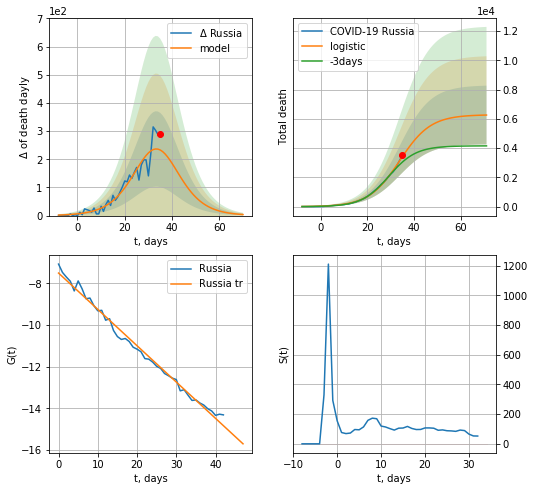

Russia data at: 2020-05-01
+3 day model MAPE: 0.14757543295712078
model: logistic
coeffs:  [6.27992072e+03 1.50857839e-01 3.38186518e+01]
rational stdev:  0.320701105725444
forecast at the end of period: +36 days
	 total death:  6256 ± 2006
trend coefficient of determination: 0.989912
 intercept: -7.507610
 slope: -0.174441


In [216]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,10*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

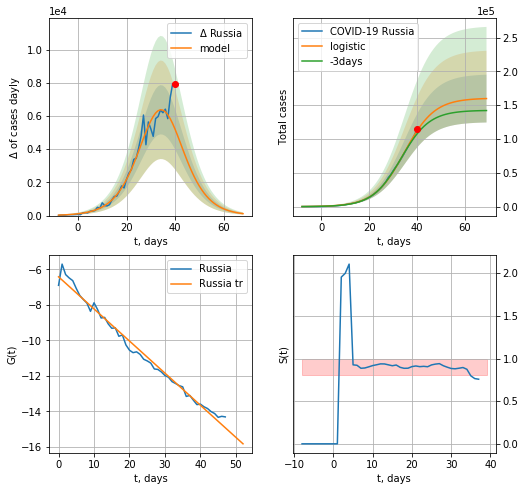

Russia data at: 2020-05-01
+3 day model MAPE: 0.0482965934410832
model: logistic
coeffs:  [1.60429957e+05 1.59107677e-01 3.47373141e+01]
rational stdev:  0.22103510193841241
forecast at the end of period: +29 days
	 deltaDaycases:  117
	 total cases:  159744 ± 35309
	 total death:  1631 ± 1081
trend coefficient of determination: 0.986328
 intercept: -6.419469
 slope: -0.181055


In [217]:
x = forecast('Russia',dfRS[14:],d1,9*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


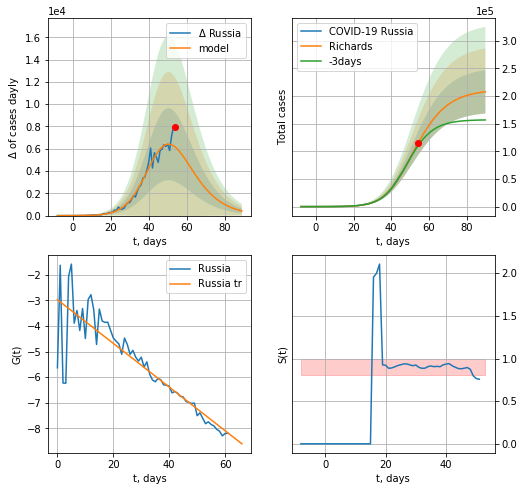

Russia data at: 2020-05-01
+3 day model MAPE: 0.04656138743593096
model: Richards
coeffs:  [2.11758820e+05 2.13367350e-01 4.35368207e+01 4.74317208e-01]
rational stdev:  0.1884916238462707
forecast at the end of period: +36 days
	 deltaDaycases:  418
	 total cases:  207763 ± 39161
	 total death:  2122 ± 1199
trend coefficient of determination: 0.781394
 intercept: -2.974619
 slope: -0.085277


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


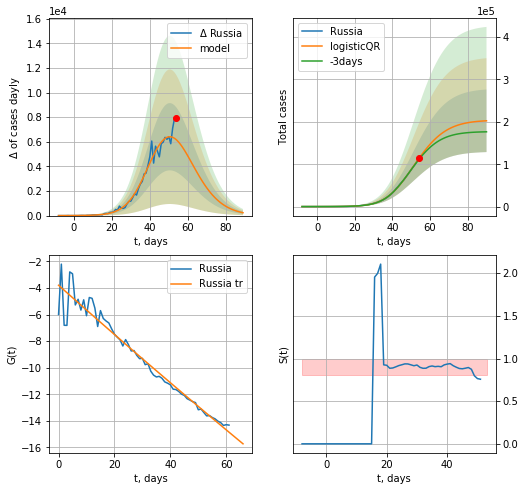

Russia data at: 2020-05-01
+3 day model MAPE: 0.02507872143672913
model: logisticQR
coeffs:  [ 2.03979353e+05  9.05410163e-03 -8.05319467e+00 -7.88812832e+00
  8.52498435e-02]
rational stdev:  0.36467580193347343
forecast at the end of period: +36 days
	 deltaDaycases:  233
	 total cases:  202534 ± 73859
	 total death:  2069 ± 2263
trend coefficient of determination: 0.948540
 intercept_: -3.7962087718427213
 coeffs_: [ 0.00000000e+00 -1.87155036e-01  9.74847251e-05]


In [218]:
x = forecastRR('Russia',dfRS[:],d1,10*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]
x = forecastQR('Russia',dfRS[:],d1,10*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


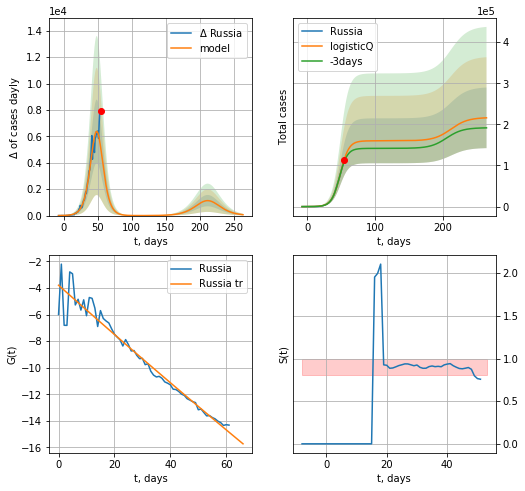

Russia data at: 2020-05-01
+3 day model MAPE: 0.049160
model: logisticQ
coeffs: [ 1.60071884e+05  1.38266145e-05  4.87079495e+01 -1.14825206e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.341377
forecast at the end of period: +211 days
	 deltaDaycases: 67
	 total cases: 215939 ± 73716
	 total death: 2205 ± 2258
trend coefficient of determination: 0.948540
 intercept_: -3.7962087718427213
 coeffs_: [ 0.00000000e+00 -1.87155036e-01  9.74847251e-05]


In [219]:
x = forecastRRR('Russia',dfRS[:],d1,35*7-dT,addpred=True,xcoef=koreaCoeffs)

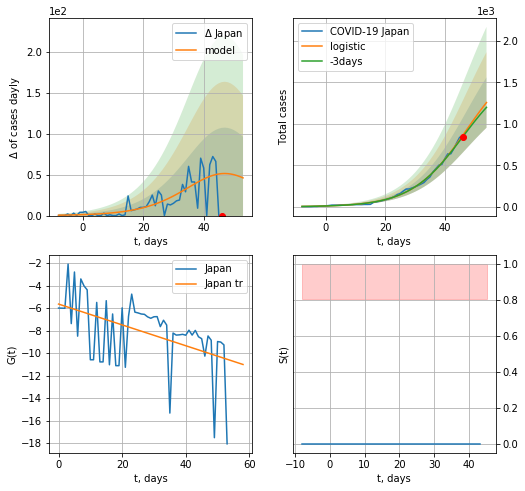

Japan data at: 2020-05-01
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +8 days
	 deltaDaycases:  45
	 total cases:  1257 ± 304
	 total death:  39 ± 28
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


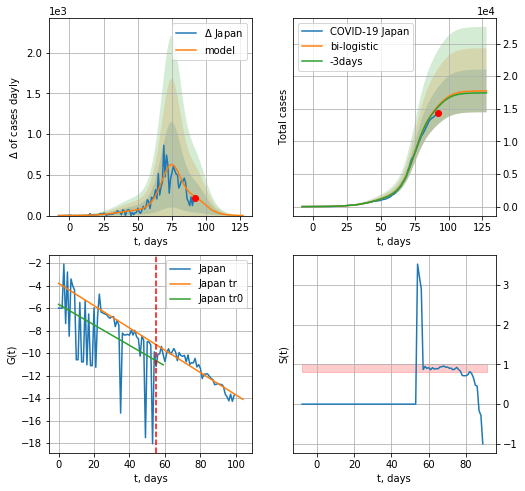

Japan data at: 2020-05-01
+3 day model MAPE: 0.01079673678941386
model: bi-logistic
coeffs:  [1.27074931e+04 1.89365436e-01 7.50793925e+01] [1.86668601e+03 1.09971339e-01 4.74124632e+01]
scenario coeffs:  [0.25, 1.0, 1.25]
rational stdev:  0.1843985951785667
forecast at the end of period: +36 days
	 deltaDaycases:  1
	 total cases:  17745 ± 3272
	 total death:  564 ± 312
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.848229
 intercept: -3.802817
 slope: -0.099201


In [220]:
x = forecast('Japan',dfJP[:55],d1,6*7-dT)
xx = forecast2('Japan',dfJP[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.25],vL=55)

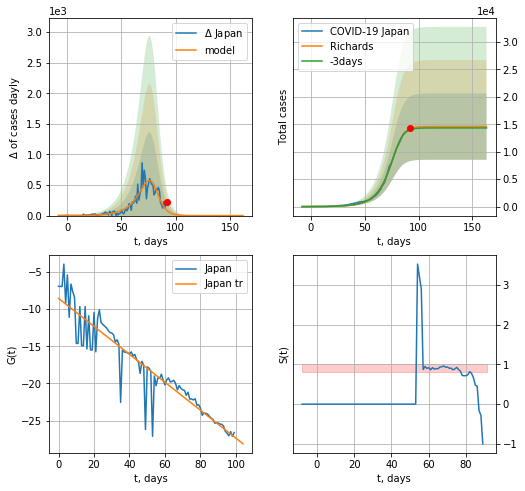

Japan data at: 2020-05-01
+3 day model MAPE: 0.012215015525975308
model: Richards
coeffs:  [1.45797539e+04 9.41465047e-02 8.01176286e+01 2.34341970e+00]
rational stdev:  0.4148019588556151
forecast at the end of period: +71 days
	 deltaDaycases:  0
	 total cases:  14579 ± 6047
	 total death:  463 ± 576
trend coefficient of determination: 0.871818
 intercept: -8.564346
 slope: -0.188055


In [221]:
x = forecastRR('Japan',dfJP[:],d1,15*7-dT)

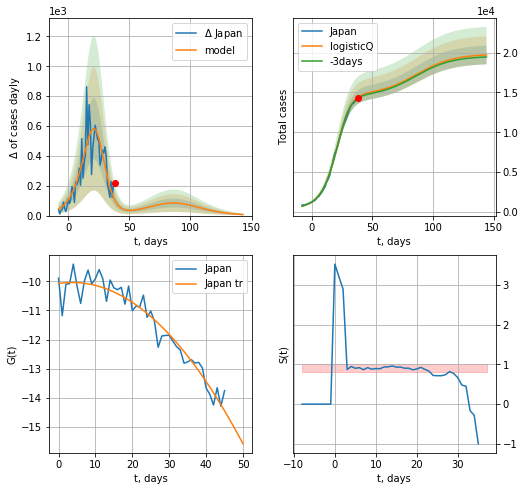

Japan data at: 2020-05-01
+3 day model MAPE: 0.009112
model: logisticQ
coeffs: [ 1.46267003e+04  1.67506808e-03  1.96747284e+01 -7.29209208e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.059544
forecast at the end of period: +106 days
	 deltaDaycases: 7
	 total cases: 19708 ± 1173
	 total death: 626 ± 111
trend coefficient of determination: 0.931657
 intercept_: -10.076813297133606
 coeffs_: [ 0.          0.01949293 -0.00259254]


In [222]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


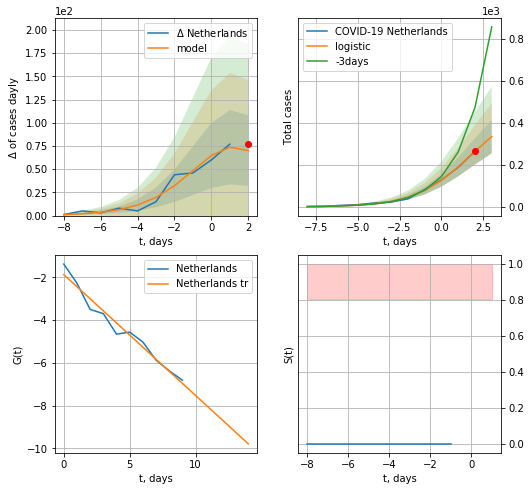

Netherlands data at: 2020-05-01
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +1 days
	 deltaDaycases:  70
	 total cases:  334 ± 79
	 total death:  41 ± 29
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


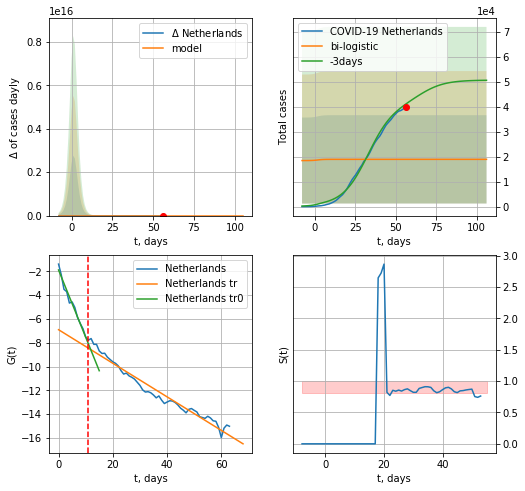

Netherlands data at: 2020-05-01
+3 day model MAPE: 0.5435734497756249
model: bi-logistic
coeffs:  [ 1.47312990e+04 -3.44607819e+00  1.14177379e+02] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.9341480424813318
forecast at the end of period: +50 days
	 deltaDaycases:  0
	 total cases:  18901 ± 17657
	 total death:  2324 ± 6512
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.961699
 intercept: -6.901110
 slope: -0.141092


In [223]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,5*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
          date  cases  active   death
60 2020-04-27  38245   33477  4518.0
61 2020-04-28  38416   33600  4566.0
62 2020-04-29  38802   33841  4711.0
63 2020-04-30  39316   34271  4795.0
64 2020-05-01  39791   34648  4893.0


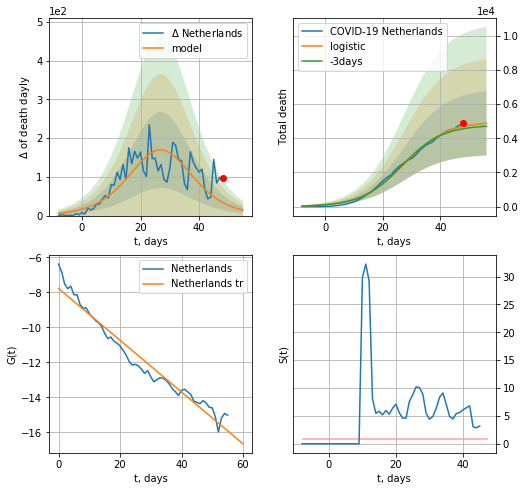

Netherlands data at: 2020-05-01
+3 day model MAPE: 0.03000041811299161
model: logistic
coeffs:  [4.97377231e+03 1.36257503e-01 2.73509287e+01]
rational stdev:  0.3859541286330028
forecast at the end of period: +8 days
	 total death:  4875 ± 1881
trend coefficient of determination: 0.957977
 intercept: -7.771017
 slope: -0.148035


In [224]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,6*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


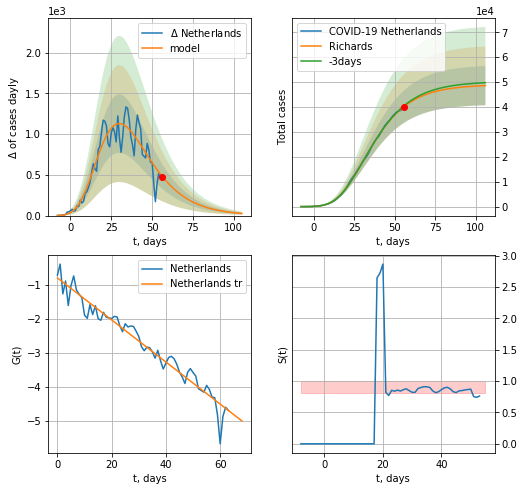

Netherlands data at: 2020-05-01
+3 day model MAPE: 0.01005867926134344
model: Richards
coeffs:  [ 4.89680689e+04  2.56847051e+00 -2.78695303e+01  2.47347669e-02]
rational stdev:  0.16180905536188678
forecast at the end of period: +50 days
	 deltaDaycases:  26
	 total cases:  48568 ± 7858
	 total death:  5972 ± 2898
trend coefficient of determination: 0.949507
 intercept: -0.791099
 slope: -0.061911


In [225]:
x = forecastRR('Netherlands',dfNL[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


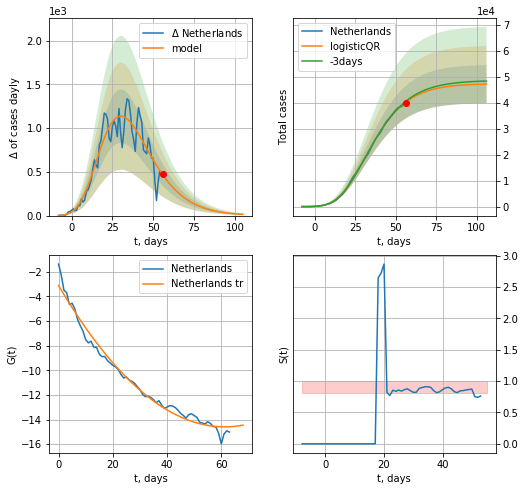

Netherlands data at: 2020-05-01
+3 day model MAPE: 0.009237044026166628
model: logisticQR
coeffs:  [ 4.73491101e+04  1.97276367e-02 -6.48534272e+01 -3.91179274e+02
  6.42651725e-03]
rational stdev:  0.1556404467178237
forecast at the end of period: +50 days
	 deltaDaycases:  13
	 total cases:  47194 ± 7345
	 total death:  5803 ± 2709
trend coefficient of determination: 0.981280
 intercept_: -3.1219941407348877
 coeffs_: [ 0.         -0.37475276  0.00305994]


In [226]:
x = forecastQR('Netherlands',dfNL[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


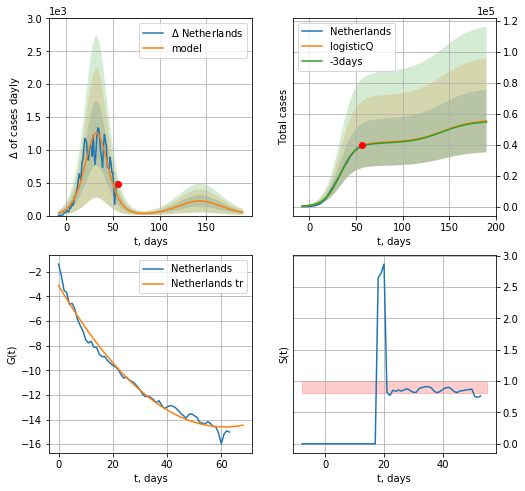

Netherlands data at: 2020-05-01
+3 day model MAPE: 0.009699
model: logisticQ
coeffs: [ 4.14901058e+04  1.72708446e-06  3.28821614e+01 -7.01316044e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.365979
forecast at the end of period: +134 days
	 deltaDaycases: 47
	 total cases: 55377 ± 20266
	 total death: 6809 ± 7475
trend coefficient of determination: 0.981280
 intercept_: -3.1219941407348877
 coeffs_: [ 0.         -0.37475276  0.00305994]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:183: RuntimeWarning: invalid value encountered in true_divide


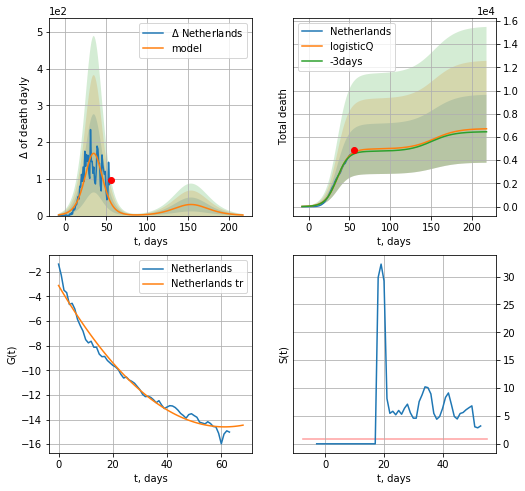

Netherlands data at: 2020-05-01
+3 day model MAPE: 0.030133
model: logisticQ
coeffs: [ 4.97044884e+03  1.73869151e-06  3.53388472e+01 -7.84409927e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.436316
forecast at the end of period: +162 days
	 total death: 6709 ± 2927
trend coefficient of determination: 0.981280
 intercept_: -3.1219941407348877
 coeffs_: [ 0.         -0.37475276  0.00305994]


In [227]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [228]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


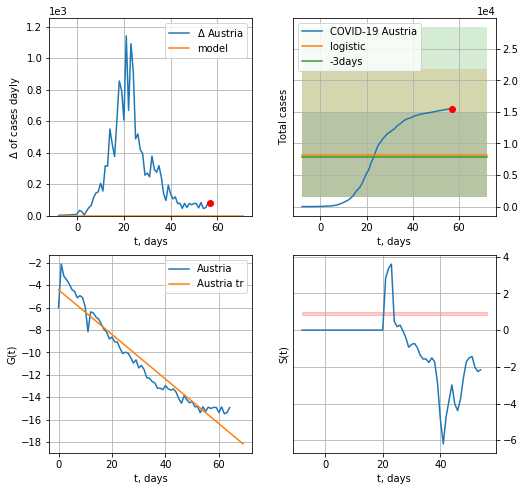

Austria data at: 2020-05-01
+3 day model MAPE: 0.04988160919108472
model: logistic
coeffs:  [ 7.73956076e+03 -2.79535373e+00  1.05315239e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.8200515955745038
forecast at the end of period: +15 days
	 deltaDaycases:  0
	 total cases:  8223 ± 6743
	 total death:  311 ± 765
trend coefficient of determination: 0.937701
 intercept: -4.420169
 slope: -0.199172


In [229]:
x = forecast('Austria',dfAT[:],d1,7*7-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


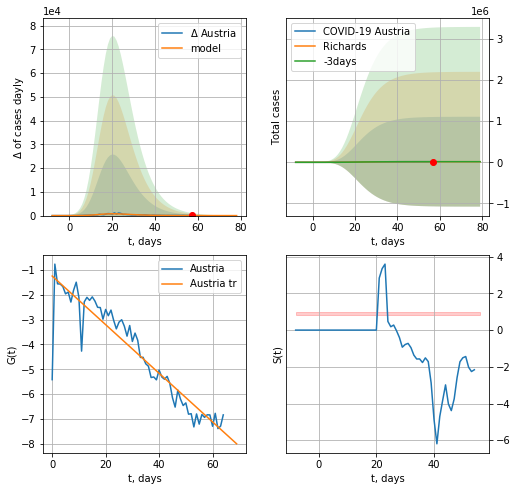

Austria data at: 2020-05-01
+3 day model MAPE: 0.006745698188951472
model: Richards
coeffs:  [1.52791369e+04 9.01639558e-01 8.11747109e+00 1.60511860e-01]
rational stdev:  71.48623663164864
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  15275 ± 1092009
	 total death:  579 ± 124171
trend coefficient of determination: 0.871323
 intercept: -1.250459
 slope: -0.097723


In [230]:
x = forecastRR('Austria',dfAT[:],d1,8*7-dT,addpred=False,xcoef=[0.25,1.,2.2,1.])
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


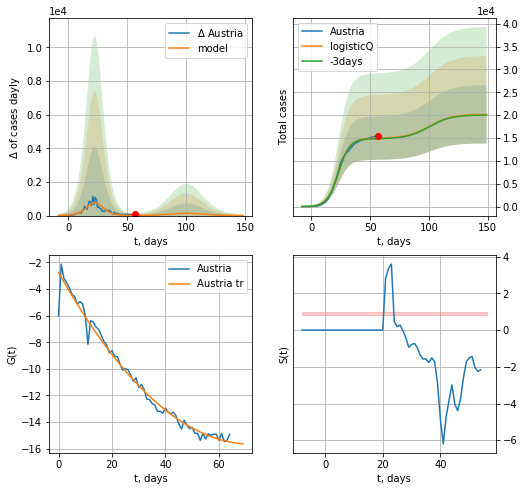

Austria data at: 2020-05-01
+3 day model MAPE: 0.008246
model: logisticQ
coeffs: [ 1.49271529e+04  1.62868827e-06  2.30559180e+01 -1.27683350e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.315626
forecast at the end of period: +92 days
	 deltaDaycases: 3
	 total cases: 20181 ± 6369
	 total death: 765 ± 724
trend coefficient of determination: 0.978814
 intercept_: -2.752379559676063
 coeffs_: [ 0.         -0.35804086  0.00248257]


In [231]:
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


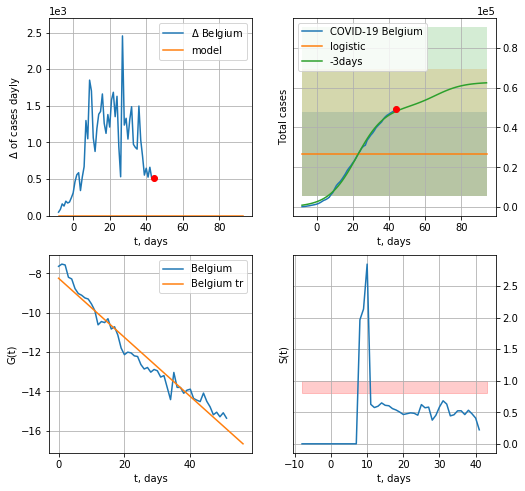

Belgium data at: 2020-05-01
+3 day model MAPE: 0.4501378534918783
model: logistic
coeffs:  [ 2.13382264e+04 -4.37835566e+00  1.74116485e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.7977550970446761
forecast at the end of period: +50 days
	 deltaDaycases:  0
	 total cases:  26672 ± 21278
	 total death:  4190 ± 10027
trend coefficient of determination: 0.958762
 intercept: -8.251812
 slope: -0.150196


In [232]:
vL=9
x = forecast('Belgium',dfBG[vL:],d1,12*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
          date  cases  active   death
57 2020-04-27  46687   28602  7207.0
58 2020-04-28  47334   29060  7331.0
59 2020-04-29  47859   29075  7501.0
60 2020-04-30  48519   29349  7594.0
61 2020-05-01  49032   29437  7703.0


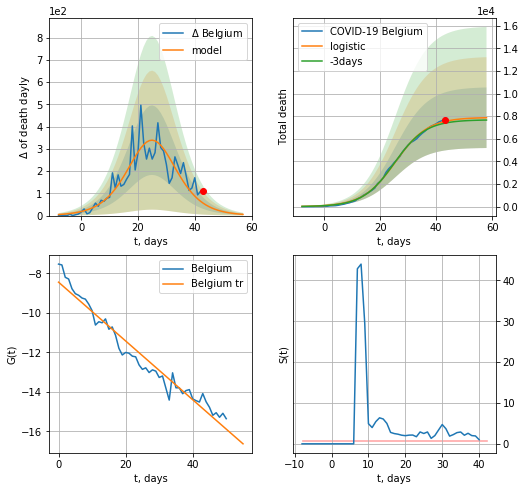

Belgium data at: 2020-05-01
+3 day model MAPE: 0.020989804795601766
model: logistic
coeffs:  [7.89357218e+03 1.71867953e-01 2.53986611e+01]
rational stdev:  0.34055230379756873
forecast at the end of period: +15 days
	 total death:  7864 ± 2678
trend coefficient of determination: 0.957067
 intercept: -8.449315
 slope: -0.148776


In [233]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,7*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:59: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


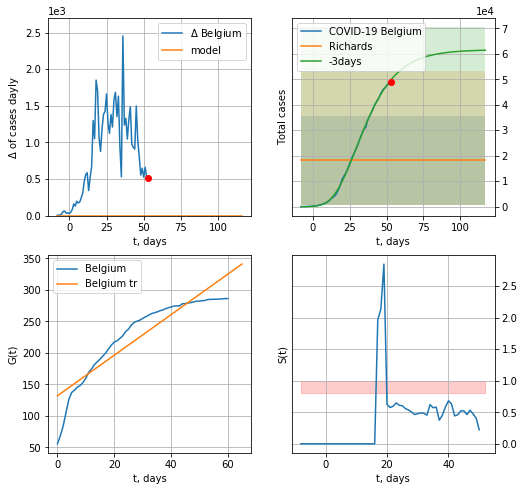

Belgium data at: 2020-05-01
+3 day model MAPE: 0.638008275741979
model: Richards
coeffs:  [ 1.82538548e+04 -1.15935378e+00 -2.27394067e+01 -2.69204003e+01]
rational stdev:  0.9547524107975535
forecast at the end of period: +64 days
	 deltaDaycases:  0
	 total cases:  18253 ± 17427
	 total death:  2867 ± 8211
trend coefficient of determination: 0.847865
 intercept: 131.910176
 slope: 3.214310


In [234]:
x = forecastRR('Belgium',dfBG[:],d1,14*7-dT,addpred=False,xcoef=[0.25,1.,2.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


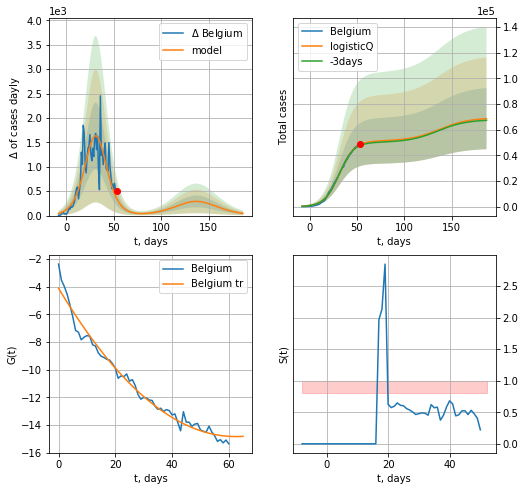

Belgium data at: 2020-05-01
+3 day model MAPE: 0.015015
model: logisticQ
coeffs: [ 5.11295477e+04  1.76779475e-06  3.14917258e+01 -7.23012390e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.347751
forecast at the end of period: +134 days
	 deltaDaycases: 45
	 total cases: 68528 ± 23830
	 total death: 10765 ± 11230
trend coefficient of determination: 0.978808
 intercept_: -4.110056536199428
 coeffs_: [ 0.         -0.34360732  0.00275182]


In [235]:
x = forecastRRR('Belgium',dfBG[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

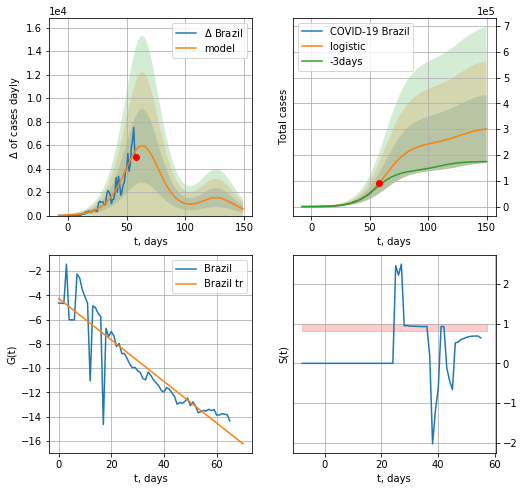

Brazil data at: 2020-05-01
+3 day model MAPE: 0.12008916855175293
model: logistic
coeffs:  [2.45705165e+05 9.65265917e-02 6.36341847e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.4380220381287924
forecast at the end of period: +92 days
	 deltaDaycases:  561
	 total cases:  300913 ± 131806
	 total death:  20926 ± 27498
trend coefficient of determination: 0.820752
 intercept: -4.238362
 slope: -0.171352


In [236]:
x = forecast('Brazil',dfBZ[:],d1,18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


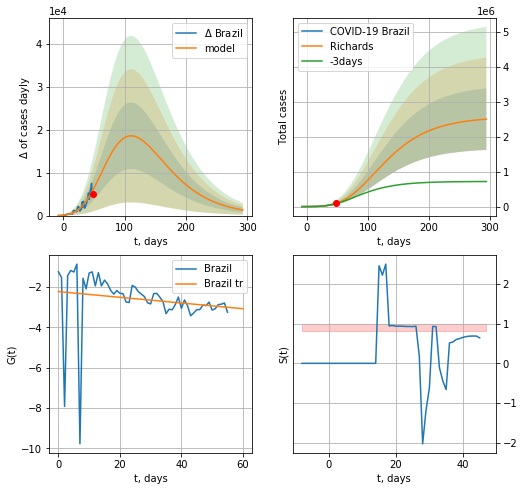

Brazil data at: 2020-05-01
+3 day model MAPE: 0.07425647381144604
model: Richards
coeffs:  [ 2.56593369e+06  6.73843422e-01 -6.50690196e+01  2.96535955e-02]
rational stdev:  0.3515946481505765
forecast at the end of period: +246 days
	 deltaDaycases:  1301
	 total cases:  2500560 ± 879183
	 total death:  173896 ± 183422
trend coefficient of determination: 0.027554
 intercept: -2.224481
 slope: -0.014145


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


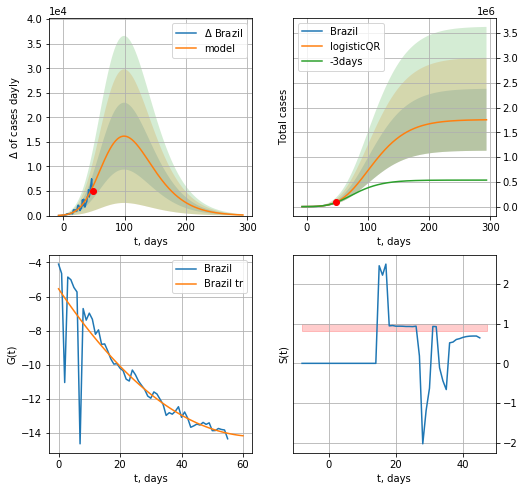

Brazil data at: 2020-05-01
+3 day model MAPE: 0.07806542691748339
model: logisticQR
coeffs:  [ 1.75569434e+06  3.53231230e-03 -2.71494902e+02 -2.82300596e+02
  9.52725769e-03]
rational stdev:  0.35656741732726377
forecast at the end of period: +246 days
	 deltaDaycases:  124
	 total cases:  1752517 ± 624890
	 total death:  121875 ± 130369
trend coefficient of determination: 0.789862
 intercept_: -5.545608895826947
 coeffs_: [ 0.         -0.26862433  0.00208207]


In [237]:
x = forecastRR('Brazil',dfBZ[10:],d1,40*7-dT)
x = forecastQR('Brazil',dfBZ[10:],d1,40*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


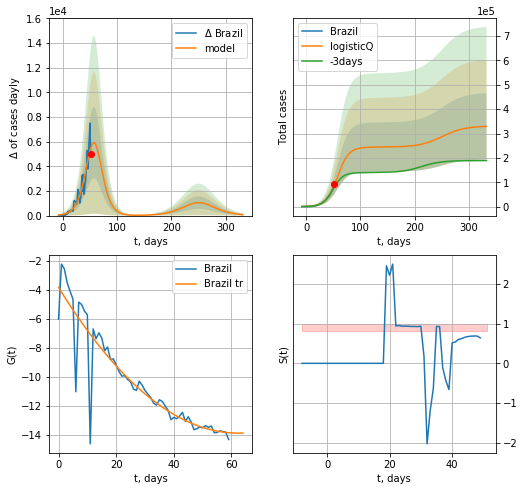

Brazil data at: 2020-05-01
+3 day model MAPE: 0.121062
model: logisticQ
coeffs: [ 2.44312552e+05  8.07395076e-06  5.75205431e+01 -1.19458483e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.413694
forecast at the end of period: +281 days
	 deltaDaycases: 76
	 total cases: 329282 ± 136222
	 total death: 22899 ± 28419
trend coefficient of determination: 0.831837
 intercept_: -3.8360884448133774
 coeffs_: [ 0.         -0.32295348  0.00259044]


In [238]:
x = forecastRRR('Brazil',dfBZ[6:],d1,45*7-dT,addpred=True,xcoef=koreaCoeffs)

In [239]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

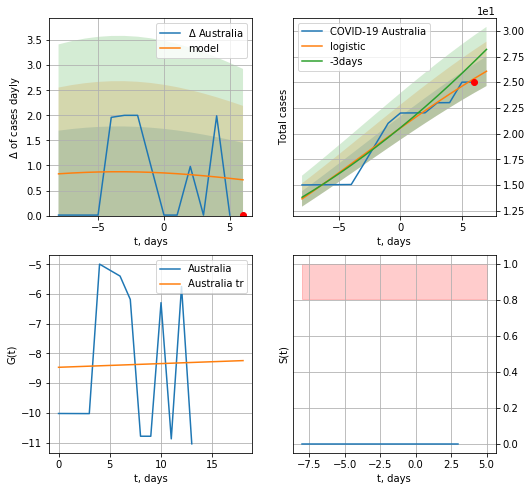

Australia data at: 2020-05-01
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +1 days
	 deltaDaycases:  0
	 total cases:  26 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


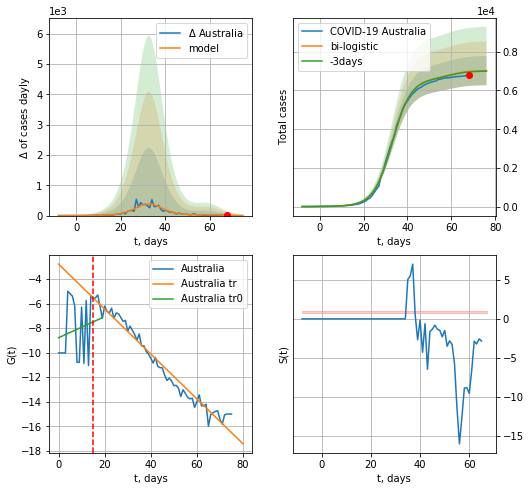

Australia data at: 2020-05-01
+3 day model MAPE: 0.0038467503538846004
model: bi-logistic
coeffs:  [6.58403971e+03 2.34897909e-01 3.31083146e+01] [35.98153551  0.09728993 -2.93367767]
scenario coeffs:  [0.0625, 1.0, 1.8]
rational stdev:  0.10700675785783331
forecast at the end of period: +8 days
	 deltaDaycases:  2
	 total cases:  7022 ± 751
	 total death:  96 ± 30
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.968103
 intercept: -2.788572
 slope: -0.182970


In [240]:
x = forecast('Australia',dfAS[:15],d1,5*7-dT,pMAPE=False)
xx = forecast2('Australia',dfAS[:],d1,6*7-dT,x,vL=15,addpred=True,xcoef=[0.25/4,1.,1.8])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


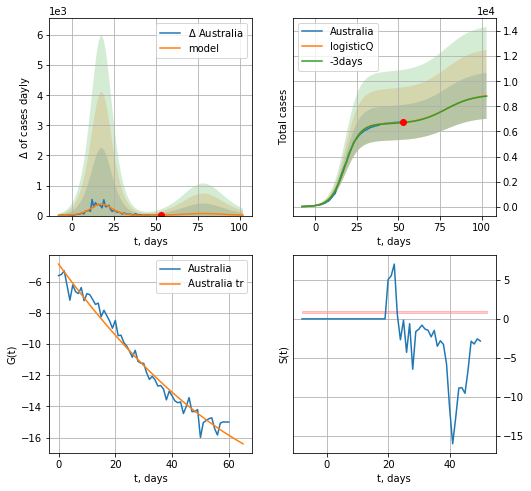

Australia data at: 2020-05-01
+3 day model MAPE: 0.003998
model: logisticQ
coeffs: [ 6.62446167e+03  3.07140509e-06  1.80560288e+01 -7.55015126e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.207090
forecast at the end of period: +50 days
	 deltaDaycases: 15
	 total cases: 8840 ± 1830
	 total death: 121 ± 75
trend coefficient of determination: 0.977188
 intercept_: -4.8710697155955485
 coeffs_: [ 0.         -0.25032559  0.00112281]


In [241]:
x = forecastRRR('Australia',dfAS[15:],d1,12*7-dT,addpred=True,xcoef=koreaCoeffs)

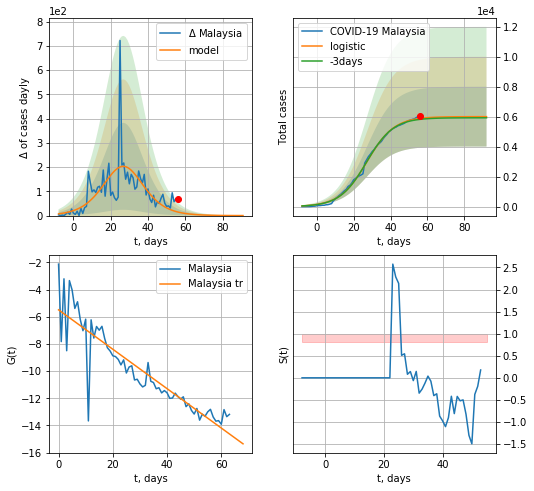

Malaysia data at: 2020-05-01
+3 day model MAPE: 0.011005477975639924
model: logistic
coeffs:  [5.99763316e+03 1.35604215e-01 2.72108444e+01]
rational stdev:  0.33241215067525137
forecast at the end of period: +36 days
	 deltaDaycases:  0
	 total cases:  5996 ± 1993
	 total death:  101 ± 100
trend coefficient of determination: 0.805274
 intercept: -5.488274
 slope: -0.145122


In [242]:
x = forecast('Malaysia',dfML[:],d1,10*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

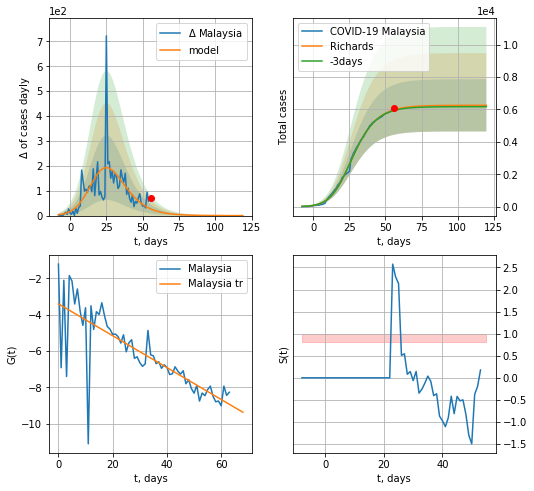

Malaysia data at: 2020-05-01
+3 day model MAPE: 0.007918458070155409
model: Richards
coeffs:  [6.25488228e+03 2.33244582e-01 1.73266277e+01 4.35301625e-01]
rational stdev:  0.2579192950456339
forecast at the end of period: +64 days
	 deltaDaycases:  0
	 total cases:  6254 ± 1613
	 total death:  106 ± 82
trend coefficient of determination: 0.626071
 intercept: -3.399964
 slope: -0.087813


In [243]:
x = forecastRR('Malaysia',dfML[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


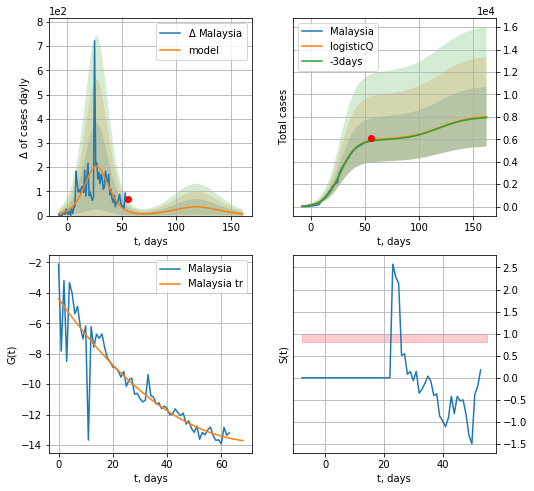

Malaysia data at: 2020-05-01
+3 day model MAPE: 0.011047
model: logisticQ
coeffs: [ 5.99700815e+03  2.52240802e-06  2.72099234e+01 -5.37253645e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.332567
forecast at the end of period: +106 days
	 deltaDaycases: 6
	 total cases: 8016 ± 2665
	 total death: 136 ± 135
trend coefficient of determination: 0.834354
 intercept_: -4.403382592891479
 coeffs_: [ 0.         -0.25013453  0.00166705]


In [244]:
x = forecastRRR('Malaysia',dfML[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
          date   cases  active  death
59 2020-04-27  1472.0     239   19.0
60 2020-04-28  1474.0     226   19.0
61 2020-04-29  1476.0     216   19.0
62 2020-04-30  1479.0     208   19.0
63 2020-05-01  1485.0     202   20.0


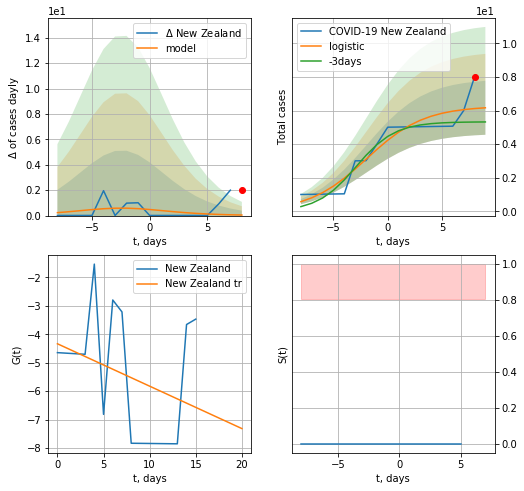

New Zealand data at: 2020-05-01
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +1 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


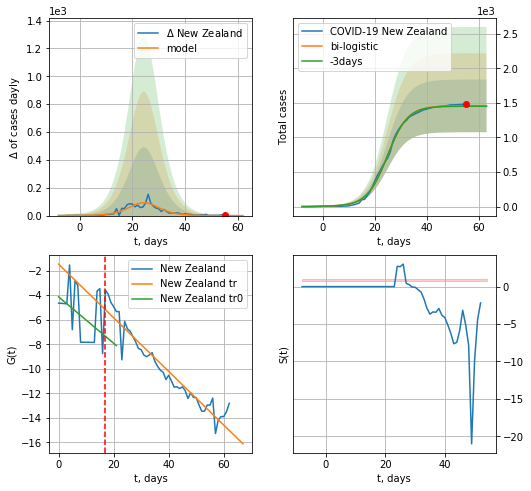

New Zealand data at: 2020-05-01
+3 day model MAPE: 0.003731696527171081
model: bi-logistic
coeffs:  [1.45010889e+03 2.55440198e-01 2.48346131e+01] [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.2611598726979032
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  1456 ± 380
	 total death:  19 ± 14
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.920760
 intercept: -1.466327
 slope: -0.218699


In [245]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
x = forecast('New Zealand',dfZL[:vL],d1,5*7-dT,pMAPE=False)
xx = forecast2('New Zealand',dfZL[:],d1,6*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#

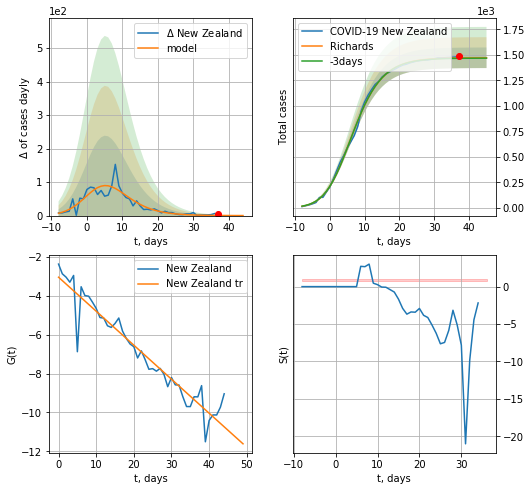

New Zealand data at: 2020-05-01
+3 day model MAPE: 0.0025288678755097885
model: Richards
coeffs:  [1.47229145e+03 4.23666955e-01 2.14979000e+00 4.83049225e-01]
rational stdev:  0.0685454847075191
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  1471 ± 100
	 total death:  19 ± 3
trend coefficient of determination: 0.915894
 intercept: -3.037617
 slope: -0.175028


In [246]:
x = forecastRR('New Zealand',dfZL[18:],d1,6*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


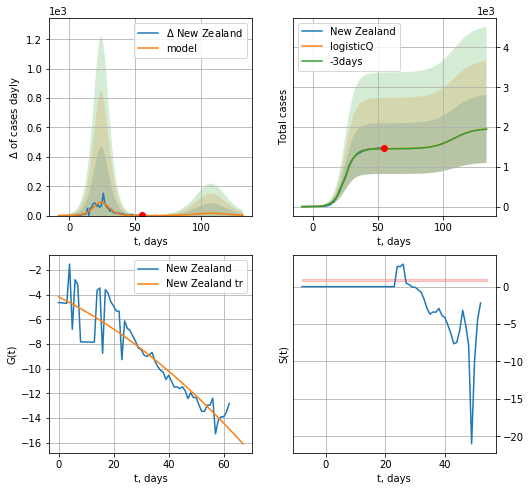

New Zealand data at: 2020-05-01
+3 day model MAPE: 0.003643
model: logisticQ
coeffs: [ 1.45725256e+03  4.23510799e-06  2.47931374e+01 -5.96441588e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.437703
forecast at the end of period: +78 days
	 deltaDaycases: 2
	 total cases: 1952 ± 854
	 total death: 26 ± 34
trend coefficient of determination: 0.832451
 intercept_: -4.1908555918418315
 coeffs_: [ 0.         -0.10988901 -0.00100988]


In [90]:
x = forecastRRR('New Zealand',dfZL[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
          date    cases  active  death
59 2020-04-27  11289.0    9474   75.0
60 2020-04-28  12208.0   10136   79.0
61 2020-04-29  13181.0   11025   84.0
62 2020-04-30  14027.0   11552   89.0
63 2020-05-01  14917.0   11906   93.0


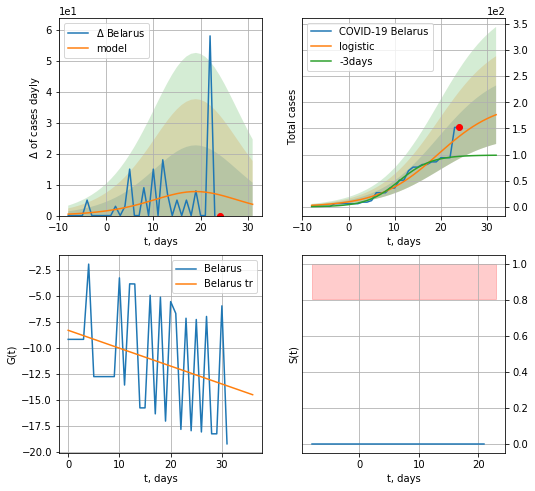

Belarus data at: 2020-05-01
+3 day model MAPE: 0.45662004942481244
model: logistic
coeffs:  [2.01843698e+02 1.53900219e-01 1.94560978e+01]
rational stdev:  0.31755857499649554
forecast at the end of period: +8 days
	 deltaDaycases:  3
	 total cases:  176 ± 55
	 total death:  1 ± 0
trend coefficient of determination: 0.089858
 intercept: -8.339930
 slope: -0.172092


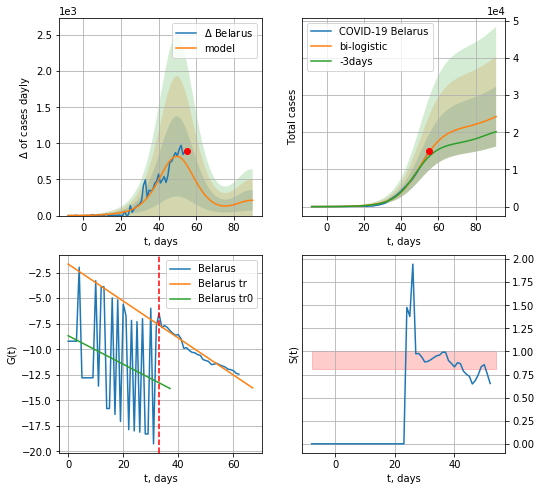

Belarus data at: 2020-05-01
+3 day model MAPE: 0.09878358387716586
model: bi-logistic
coeffs:  [2.12811682e+04 1.54126142e-01 5.01971002e+01] [2.01843698e+02 1.53900219e-01 1.94560978e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3321893726115379
forecast at the end of period: +36 days
	 deltaDaycases:  211
	 total cases:  24235 ± 8050
	 total death:  151 ± 150
bi-logistic approximation splitting point: 33
trend0 coefficient of determination: 0.064228
 intercept: -8.674644
 slope: -0.139700
trend coefficient of determination: 0.941658
 intercept: -1.663843
 slope: -0.180894


In [248]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:33],d1,6*7-dT)
xx = forecast2('Belarus',dfBR[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=33)

BR
          date    cases  active  death
59 2020-04-27  11289.0    9474   75.0
60 2020-04-28  12208.0   10136   79.0
61 2020-04-29  13181.0   11025   84.0
62 2020-04-30  14027.0   11552   89.0
63 2020-05-01  14917.0   11906   93.0


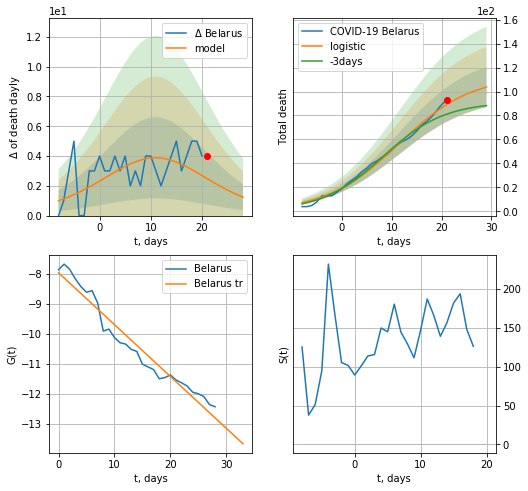

Belarus data at: 2020-05-01
+3 day model MAPE: 0.11032075302984327
model: logistic
coeffs:  [112.90863629   0.13759232  11.42170904]
rational stdev:  0.16140654022983175
forecast at the end of period: +8 days
	 total death:  103 ± 16
trend coefficient of determination: 0.951933
 intercept: -7.972589
 slope: -0.172411


In [249]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[34:],d1,6*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


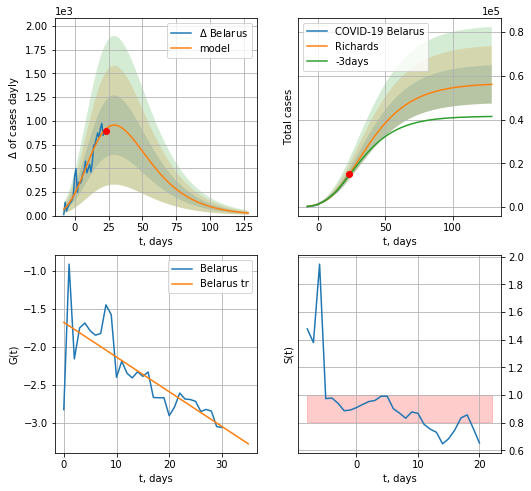

Belarus data at: 2020-05-01
+3 day model MAPE: 0.03899341625105965
model: Richards
coeffs:  [ 5.66658371e+04  1.85717535e+00 -4.98820660e+01  2.49716995e-02]
rational stdev:  0.15619408016135758
forecast at the end of period: +106 days
	 deltaDaycases:  26
	 total cases:  56102 ± 8762
	 total death:  349 ± 163
trend coefficient of determination: 0.617277
 intercept: -1.676972
 slope: -0.045615


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


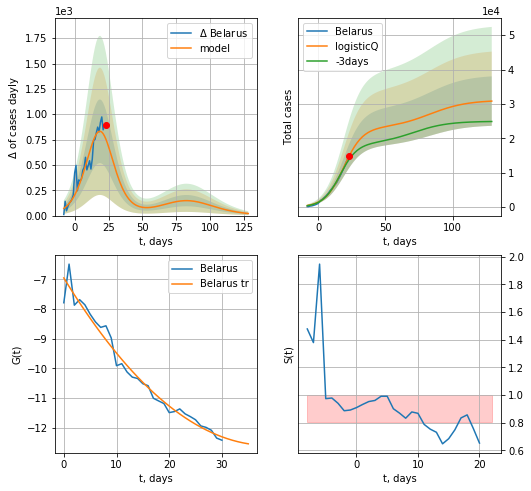

Belarus data at: 2020-05-01
+3 day model MAPE: 0.080316
model: logisticQ
coeffs: [ 2.29811112e+04  7.40082700e-06  1.90374670e+01 -1.94229543e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.233241
forecast at the end of period: +106 days
	 deltaDaycases: 20
	 total cases: 30838 ± 7192
	 total death: 192 ± 134
trend coefficient of determination: 0.971876
 intercept_: -6.951496653778041
 coeffs_: [ 0.         -0.29132645  0.00375298]


In [250]:
x = forecastRR('Belarus',dfBR[32:],d1,20*7-dT)
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


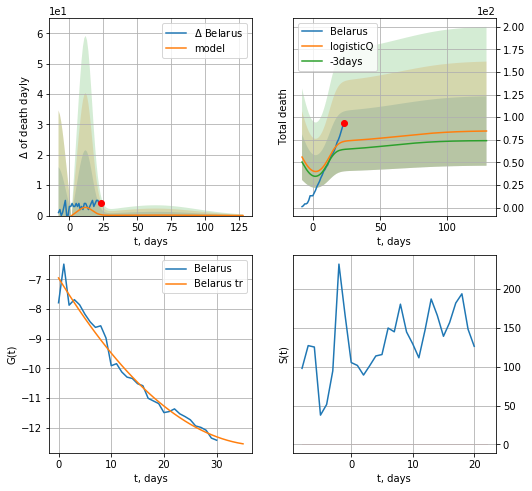

Belarus data at: 2020-05-01
+3 day model MAPE: 0.139152
model: logisticQ
coeffs: [ 6.26748644e+01  1.05693898e-02  5.42386518e+00 -1.18347330e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.453735
forecast at the end of period: +106 days
	 total death: 84 ± 38
trend coefficient of determination: 0.971876
 intercept_: -6.951496653778041
 coeffs_: [ 0.         -0.29132645  0.00375298]


In [403]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

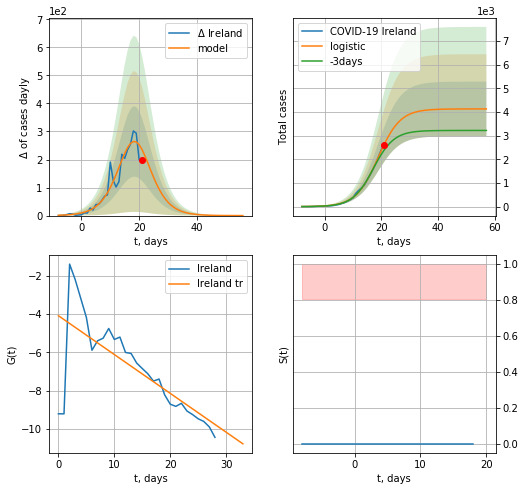

Ireland data at: 2020-05-01
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +36 days
	 deltaDaycases:  0
	 total cases:  4127 ± 1154
	 total death:  250 ± 209
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


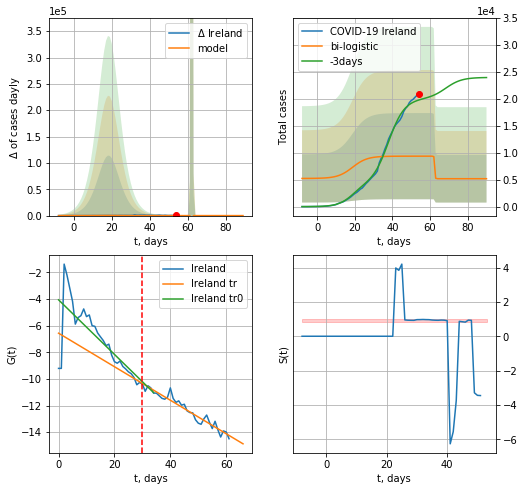

Ireland data at: 2020-05-01
+3 day model MAPE: 0.52927855919496
model: bi-logistic
coeffs:  [4174.78611034   -7.77659453   62.51317356] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.8542230133529494
forecast at the end of period: +36 days
	 deltaDaycases:  0
	 total cases:  5171 ± 4417
	 total death:  313 ± 802
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.935498
 intercept: -6.569422
 slope: -0.125770


In [251]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,10*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


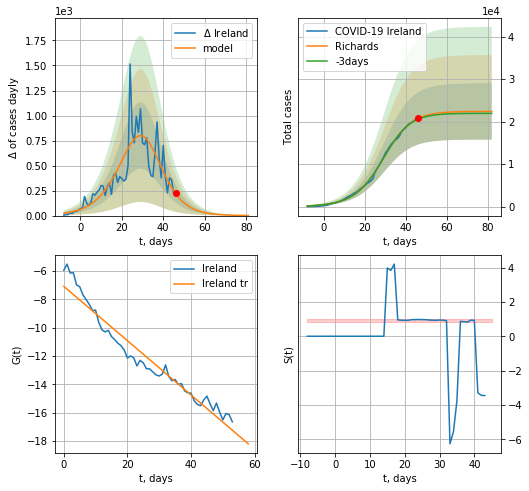

Ireland data at: 2020-05-01
+3 day model MAPE: 0.010304265862750624
model: Richards
coeffs:  [2.24205738e+04 1.25123384e-01 3.07807208e+01 1.21672007e+00]
rational stdev:  0.2958005129538763
forecast at the end of period: +36 days
	 deltaDaycases:  1
	 total cases:  22413 ± 6629
	 total death:  1360 ± 1206
trend coefficient of determination: 0.945757
 intercept: -7.085857
 slope: -0.191530


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp


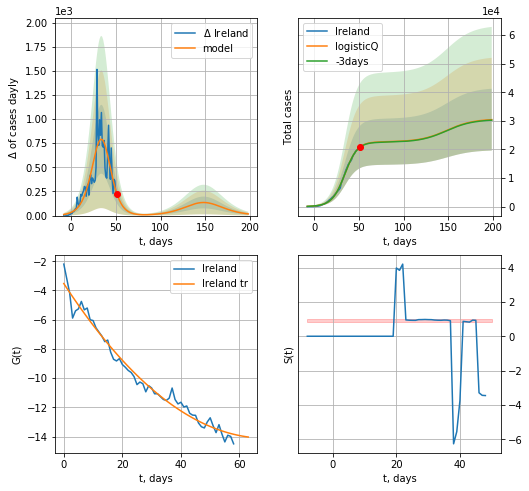

Ireland data at: 2020-05-01
+3 day model MAPE: 0.003127
model: logisticQ
coeffs: [ 2.26651459e+04  1.94393473e-04  3.40707174e+01 -6.84128321e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.355400
forecast at the end of period: +148 days
	 deltaDaycases: 17
	 total cases: 30440 ± 10818
	 total death: 1848 ± 1970
trend coefficient of determination: 0.978361
 intercept_: -3.527042458221759
 coeffs_: [ 0.         -0.30682614  0.00222515]


In [252]:
x = forecastRR('Ireland',dfIR[8:],d1,10*7-dT)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

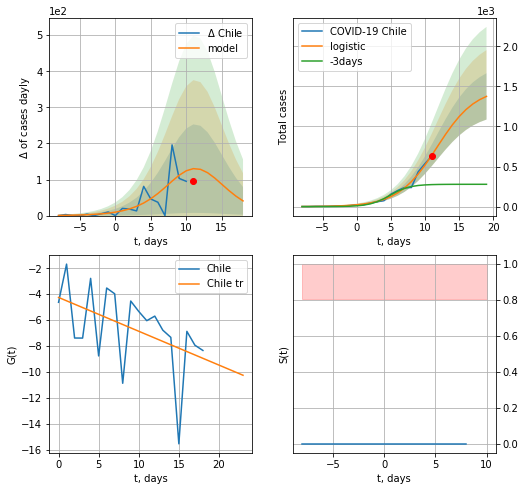

Chile data at: 2020-05-01
+3 day model MAPE: 1.7934705345739388
model: logistic
coeffs:  [1.48202088e+03 3.52936511e-01 1.17607351e+01]
rational stdev:  0.2100967778814968
forecast at the end of period: +8 days
	 deltaDaycases:  40
	 total cases:  1375 ± 288
	 total death:  18 ± 11
trend coefficient of determination: 0.220917
 intercept: -4.249067
 slope: -0.261154


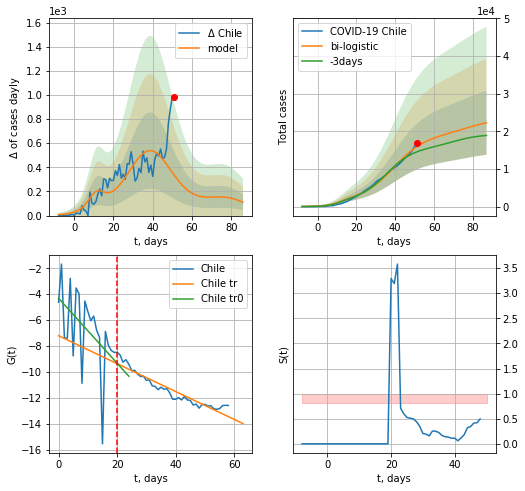

Chile data at: 2020-05-01
+3 day model MAPE: 0.10269067231173239
model: bi-logistic
coeffs:  [1.75488056e+04 1.21879643e-01 3.90294014e+01] [1.48202088e+03 3.52936511e-01 1.17607351e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3811146314204421
forecast at the end of period: +36 days
	 deltaDaycases:  110
	 total cases:  22263 ± 8484
	 total death:  306 ± 349
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.233377
 intercept: -4.310588
 slope: -0.250901
trend coefficient of determination: 0.899028
 intercept: -7.206332
 slope: -0.107677


In [253]:
vL=20
x = forecast('Chile',dfCL[:vL],d1,6*7-dT)
xx = forecast2('Chile',dfCL[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


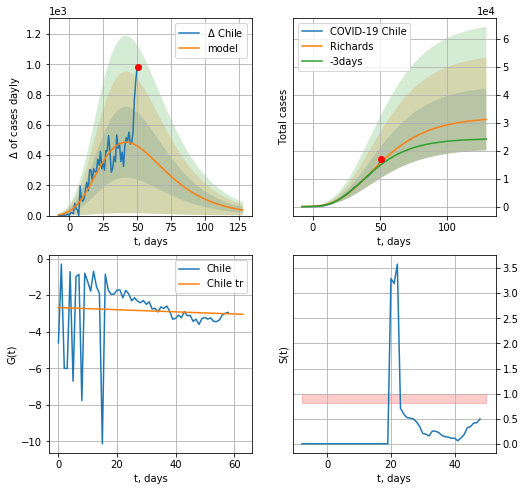

Chile data at: 2020-05-01
+3 day model MAPE: 0.06307101290464702
model: Richards
coeffs:  [ 3.20440266e+04  4.03173598e+00 -6.82967048e+01  1.02663958e-02]
rational stdev:  0.3538223706949107
forecast at the end of period: +78 days
	 deltaDaycases:  36
	 total cases:  31169 ± 11028
	 total death:  428 ± 454
trend coefficient of determination: 0.003545
 intercept: -2.681332
 slope: -0.005872


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


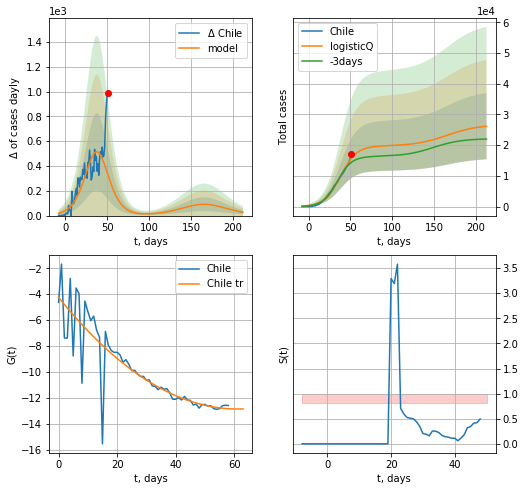

Chile data at: 2020-05-01
+3 day model MAPE: 0.097652
model: logisticQ
coeffs: [ 1.97384329e+04  1.40090189e-06  3.80651697e+01 -7.42822380e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.411703
forecast at the end of period: +162 days
	 deltaDaycases: 27
	 total cases: 26181 ± 10779
	 total death: 360 ± 444
trend coefficient of determination: 0.739955
 intercept_: -4.242579736495545
 coeffs_: [ 0.         -0.28165801  0.0023007 ]


In [254]:
x = forecastRR('Chile',dfCL[:],d1,16*7-dT)
x = forecastRRR('Chile',dfCL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

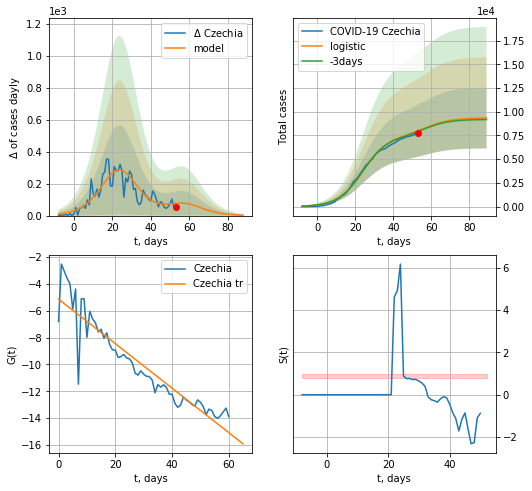

Czechia data at: 2020-05-01
+3 day model MAPE: 0.010460275416491001
model: logistic
coeffs:  [7.48407391e+03 1.51968964e-01 2.40759318e+01]
scenario coeffs:  [0.25, 1.0, 2.4]
rational stdev:  0.3426734992619939
forecast at the end of period: +36 days
	 deltaDaycases:  2
	 total cases:  9338 ± 3200
	 total death:  289 ± 297
trend coefficient of determination: 0.865159
 intercept: -5.142149
 slope: -0.165771


In [255]:
x = forecast('Czechia',dfCH[:],d1,10*7-dT,shift=1.,addpred=True,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


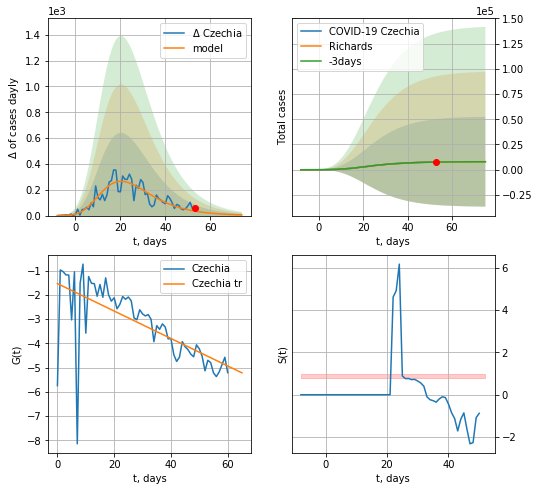

Czechia data at: 2020-05-01
+3 day model MAPE: 0.009028712976216964
model: Richards
coeffs:  [ 8.03348256e+03  3.15383900e+00 -1.80979204e+01  2.89175560e-02]
rational stdev:  5.577658085492407
forecast at the end of period: +22 days
	 deltaDaycases:  5
	 total cases:  7976 ± 44490
	 total death:  247 ± 4133
trend coefficient of determination: 0.442064
 intercept: -1.532280
 slope: -0.056605


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


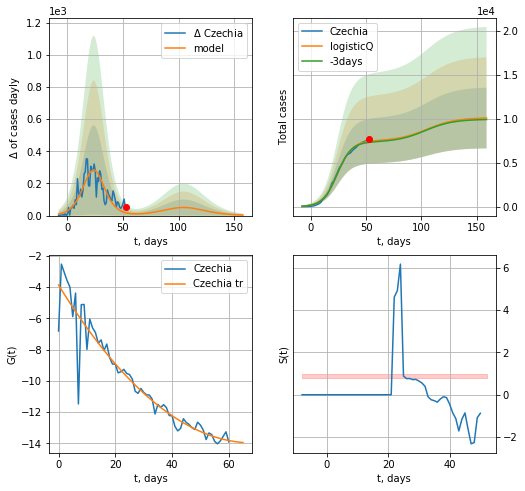

Czechia data at: 2020-05-01
+3 day model MAPE: 0.016549
model: logisticQ
coeffs: [ 7.48378707e+03  1.40676455e-06  2.40758501e+01 -1.07980473e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.342781
forecast at the end of period: +106 days
	 deltaDaycases: 3
	 total cases: 10092 ± 3459
	 total death: 313 ± 321
trend coefficient of determination: 0.901637
 intercept_: -3.8690597710713828
 coeffs_: [ 0.         -0.29527012  0.00215857]


In [256]:
x = forecastRR('Czechia',dfCH[:],d1,8*7-dT)
x = forecastRRR('Czechia',dfCH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

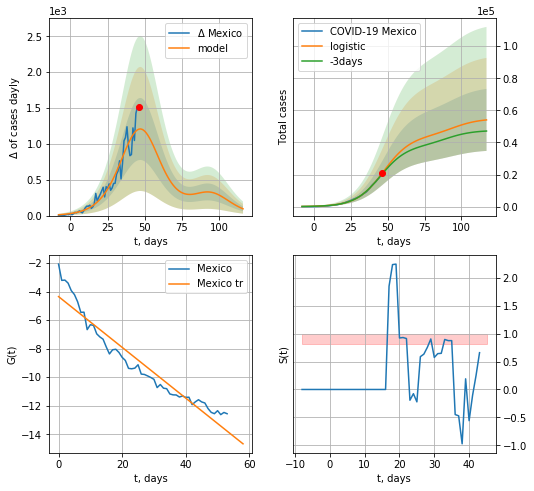

Mexico data at: 2020-05-01
+3 day model MAPE: 0.029887734918160505
model: logistic
coeffs:  [4.39346761e+04 1.09410609e-01 4.73109196e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.35759047283502277
forecast at the end of period: +71 days
	 deltaDaycases:  94
	 total cases:  54023 ± 19318
	 total death:  5136 ± 5509
trend coefficient of determination: 0.926223
 intercept: -4.353104
 slope: -0.177765


In [257]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


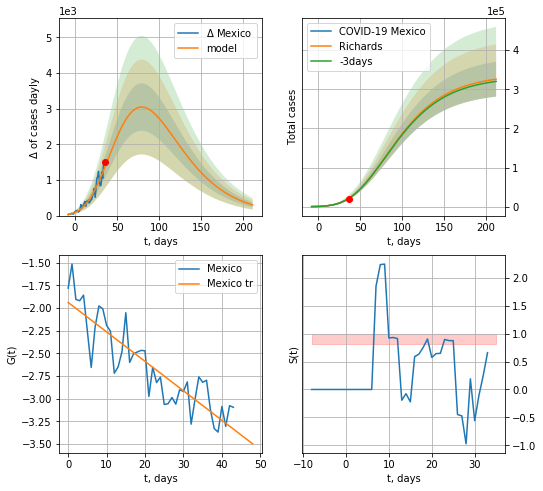

Mexico data at: 2020-05-01
+3 day model MAPE: 0.0009099572976703538
model: Richards
coeffs:  [ 3.38010754e+05  5.21542372e-01 -4.12559164e+01  4.80849404e-02]
rational stdev:  0.1366337719461911
forecast at the end of period: +176 days
	 deltaDaycases:  299
	 total cases:  325977 ± 44539
	 total death:  30996 ± 12705
trend coefficient of determination: 0.784223
 intercept: -1.938814
 slope: -0.032449


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


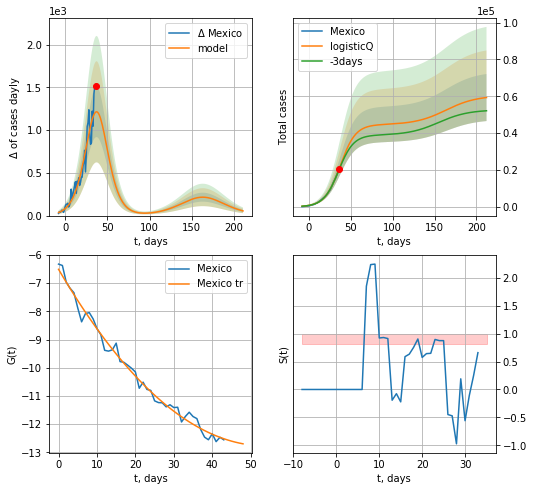

Mexico data at: 2020-05-01
+3 day model MAPE: 0.027443
model: logisticQ
coeffs: [ 4.45578350e+04  1.43564048e-05  3.75374878e+01 -7.56075908e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.215496
forecast at the end of period: +176 days
	 deltaDaycases: 54
	 total cases: 59294 ± 12777
	 total death: 5638 ± 3644
trend coefficient of determination: 0.987907
 intercept_: -6.507624509271491
 coeffs_: [ 0.         -0.23251836  0.00215763]


In [258]:
x = forecastRR('Mexico',dfMX[10:],d1,30*7-dT,addpred=False,xcoef=[.25,1.,2.])#
x = forecastRRR('Mexico',dfMX[10:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
          date  cases  active  death   tests
49 2020-04-27   1344     931   41.4  111806
50 2020-04-28   1375     764   44.0  118201
51 2020-04-29   1385     751   45.0  125555
52 2020-04-30   1399     760   45.0  132768
53 2020-05-01   1406     728   45.0  138270


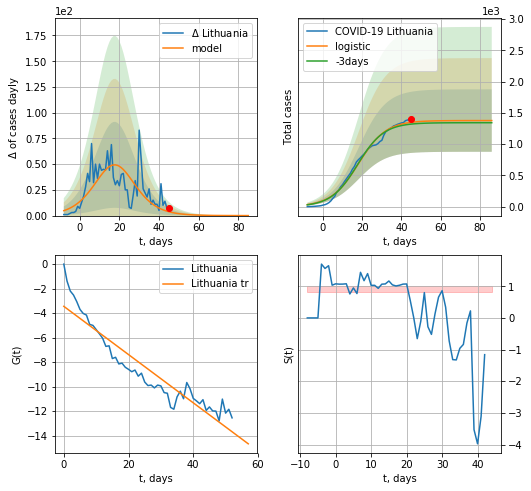

Lithuania data at: 2020-05-01
+3 day model MAPE: 0.021760608702180412
model: logistic
coeffs:  [1.37722144e+03 1.43356920e-01 1.81120647e+01]
rational stdev:  0.36280919377803833
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  1377 ± 499
	 total death:  44 ± 47
trend coefficient of determination: 0.877099
 intercept: -3.446686
 slope: -0.196899


In [397]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
x = forecast('Lithuania',dfLT[:],d1,6*7-1)
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [398]:
#np.diff(dfLT["cases"])

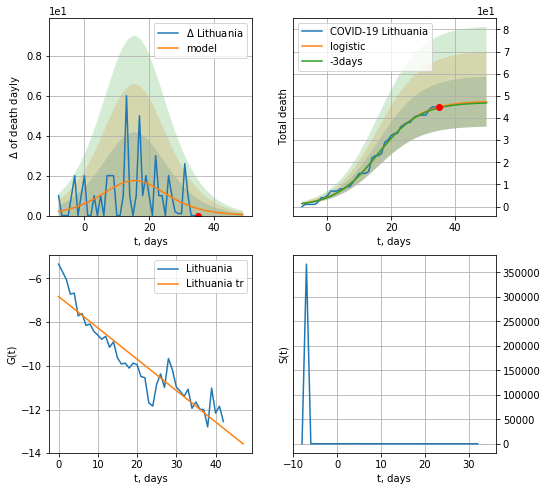

Lithuania data at: 2020-05-01
+3 day model MAPE: 0.009695992792634391
model: logistic
coeffs:  [47.67427788  0.14712766 15.92781238]
rational stdev:  0.23762280429794286
forecast at the end of period: +15 days
	 total death:  47 ± 11
trend coefficient of determination: 0.870811
 intercept: -6.823224
 slope: -0.143546


In [399]:
x = forecast('Lithuania',dfLT[10:],d1,7*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


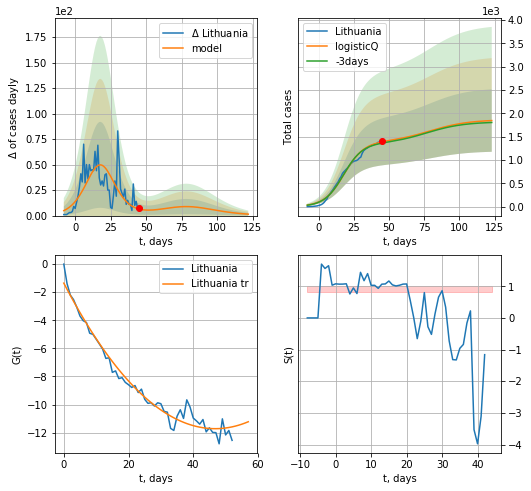

Lithuania data at: 2020-05-01
+3 day model MAPE: 0.019924
model: logisticQ
coeffs: [ 1.37716912e+03  9.74833489e-07  1.81118828e+01 -1.47020481e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.362844
forecast at the end of period: +78 days
	 deltaDaycases: 1
	 total cases: 1845 ± 669
	 total death: 59 ± 64
trend coefficient of determination: 0.972390
 intercept_: -1.354285813614327
 coeffs_: [ 0.         -0.44313738  0.00473604]


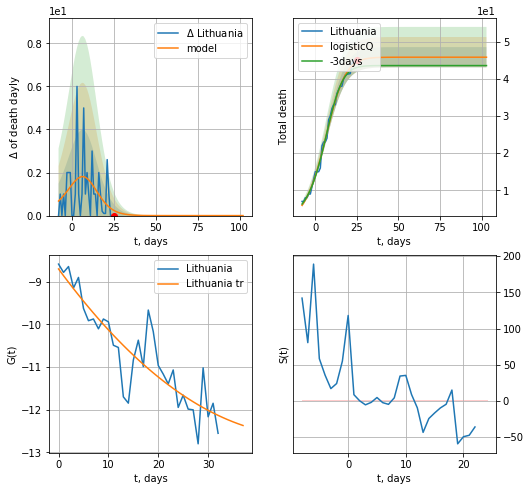

Lithuania data at: 2020-05-01
+3 day model MAPE: 0.036303
model: logisticQ
coeffs: [ 4.58083834e+01  1.24331829e-03  5.56326659e+00 -1.20553981e+02]
rational stdev: 0.059308
forecast at the end of period: +78 days
	 total death: 45 ± 2
trend coefficient of determination: 0.792528
 intercept_: -8.70419031130156
 coeffs_: [ 0.         -0.15868797  0.00161235]


In [400]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


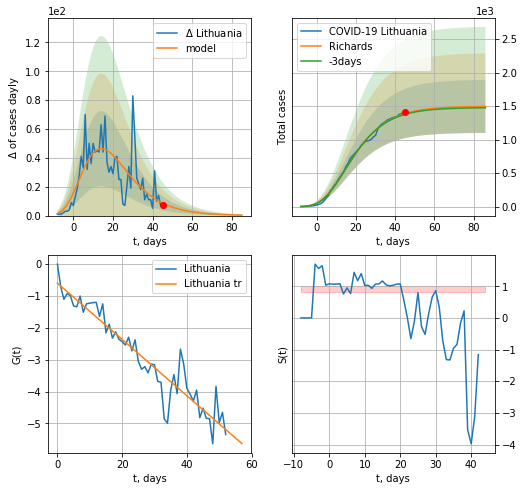

Lithuania data at: 2020-05-01
+3 day model MAPE: 0.008856923033377534
model: Richards
coeffs:  [ 1.49800262e+03  1.26051934e+01 -4.45443425e+01  6.70658301e-03]
rational stdev:  0.2644725667782295
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  1494 ± 395
	 total death:  48 ± 38
trend coefficient of determination: 0.895303
 intercept: -0.598175
 slope: -0.088363


In [401]:
x = forecastRR('Lithuania',dfLT[:],d1,6*7-1)
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


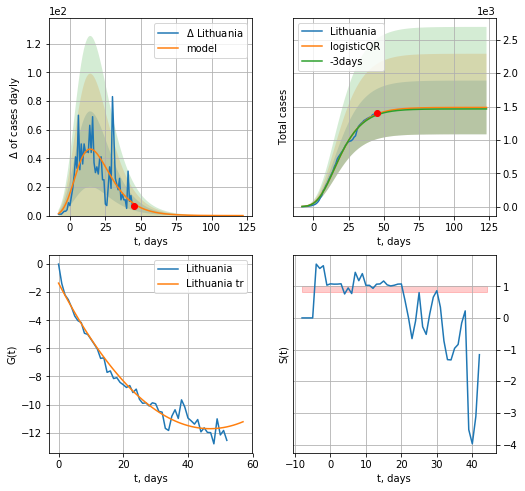

Lithuania data at: 2020-05-01
+3 day model MAPE: 0.009559779137292425
model: logisticQR
coeffs:  [ 1.48613447e+03  4.65315742e-02 -6.69558503e+01 -1.03296689e+03
  1.61751152e-03]
rational stdev:  0.2707986249463549
forecast at the end of period: +78 days
	 deltaDaycases:  0
	 total cases:  1486 ± 402
	 total death:  47 ± 38
trend coefficient of determination: 0.972390
 intercept_: -1.354285813614327
 coeffs_: [ 0.         -0.44313738  0.00473604]


In [402]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
          date   cases  active  death
51 2020-04-27  3729.0     518   88.0
52 2020-04-28  3741.0     529   89.0
53 2020-04-29  3769.0     546   89.0
54 2020-04-30  3784.0     481   90.0
55 2020-05-01  3802.0     497   92.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


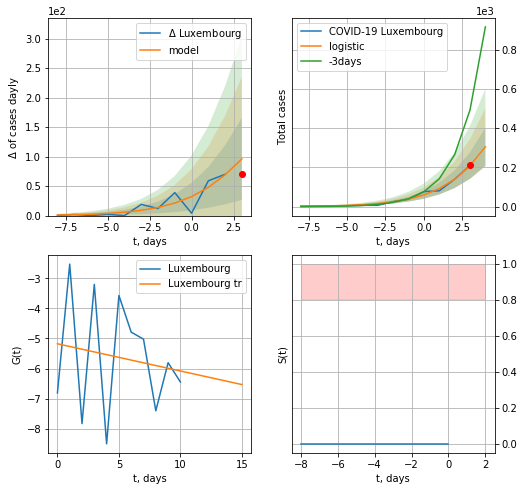

Luxembourg data at: 2020-05-01
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +1 days
	 deltaDaycases:  96
	 total cases:  305 ± 98
	 total death:  7 ± 6
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


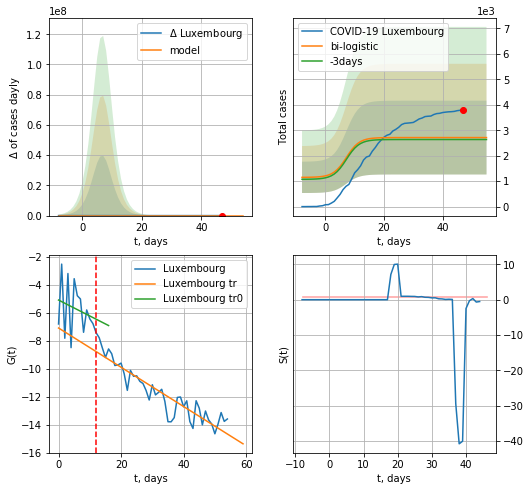

Luxembourg data at: 2020-05-01
+3 day model MAPE: 0.028979287427481692
model: bi-logistic
coeffs:  [1022.17923676  -14.32099289  138.88980101] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.5337533412728925
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  2712 ± 1448
	 total death:  65 ± 104
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.843540
 intercept: -7.095733
 slope: -0.140274


In [265]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,5*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,6*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


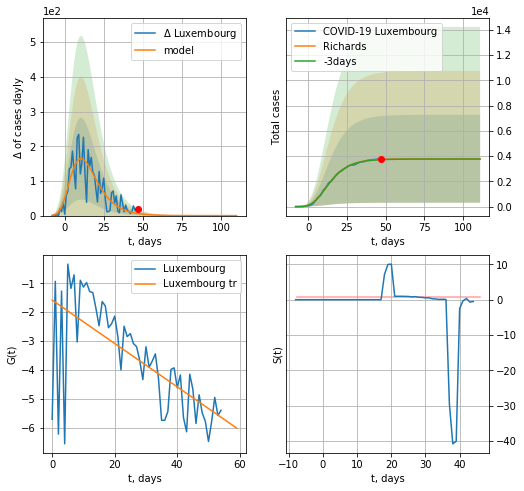

Luxembourg data at: 2020-05-01
+3 day model MAPE: 0.005355620552056351
model: Richards
coeffs:  [ 3.78502225e+03  1.91067654e+01 -3.19452380e+01  6.20573313e-03]
rational stdev:  0.9189299972199245
forecast at the end of period: +64 days
	 deltaDaycases:  0
	 total cases:  3784 ± 3478
	 total death:  91 ± 250
trend coefficient of determination: 0.450994
 intercept: -1.583354
 slope: -0.075162


In [266]:
x = forecastRR("Luxembourg",dfLX[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


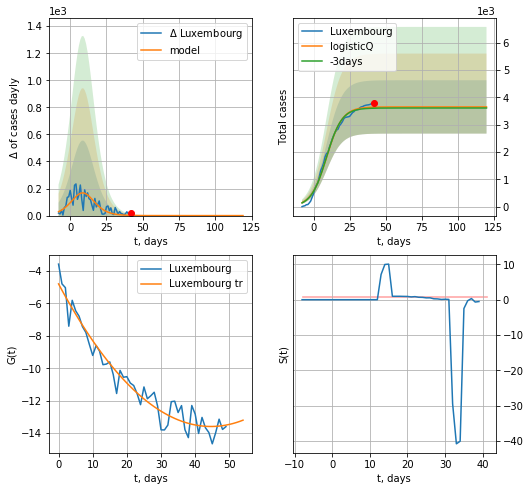

Luxembourg data at: 2020-05-01
+3 day model MAPE: 0.010497
model: logisticQ
coeffs: [ 3.65371386e+03  1.43234681e-06 -1.28474625e+05  9.11386110e+00]
rational stdev: 0.267041
forecast at the end of period: +78 days
	 deltaDaycases: 0
	 total cases: 3653 ± 975
	 total death: 88 ± 70
trend coefficient of determination: 0.944838
 intercept_: -4.793575419867656
 coeffs_: [ 0.         -0.39420389  0.00441783]


In [267]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
          date    cases   active   death
58 2020-04-27  23240.0  21020.0   663.0
59 2020-04-28  24258.0  21830.0   871.0
60 2020-04-29  24675.0  22235.0   883.0
61 2020-04-30  24934.0  22476.0   900.0
62 2020-05-01  26336.0  23360.0  1063.0


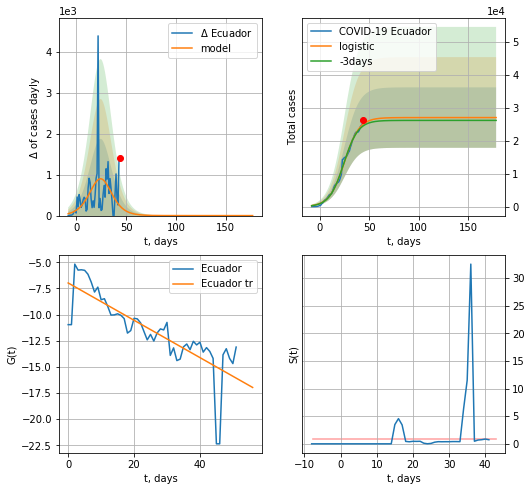

Ecuador data at: 2020-05-01
+3 day model MAPE: 0.02196253524327044
model: logistic
coeffs:  [2.70924947e+04 1.32939930e-01 2.49752466e+01]
rational stdev:  0.3390300500705225
forecast at the end of period: +134 days
	 deltaDaycases:  0
	 total cases:  27092 ± 9185
	 total death:  1093 ± 1111
trend coefficient of determination: 0.644517
 intercept: -6.978462
 slope: -0.178472


In [268]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[10:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


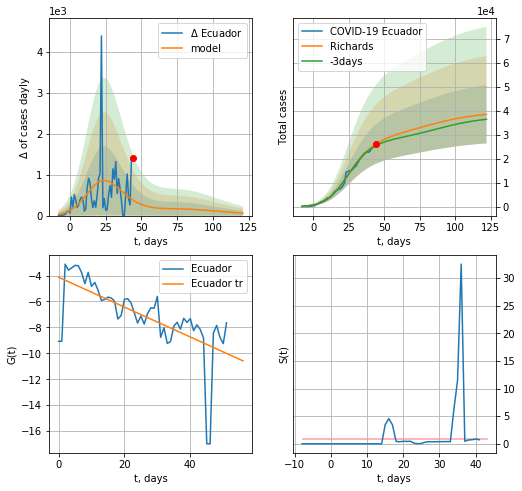

Ecuador data at: 2020-05-01
+3 day model MAPE: 0.029061133851678717
model: Richards
coeffs:  [2.95111004e+04 2.06403790e-01 1.61616990e+01 4.63005058e-01]
scenario coeffs:  [0.35, 0.5, 4.0, 1.0]
rational stdev:  0.31542007903478425
forecast at the end of period: +78 days
	 deltaDaycases:  57
	 total cases:  38532 ± 12153
	 total death:  1555 ± 1471
trend coefficient of determination: 0.425704
 intercept: -4.131318
 slope: -0.115215


In [269]:
x = forecastRR("Ecuador",dfED[10:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,4.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


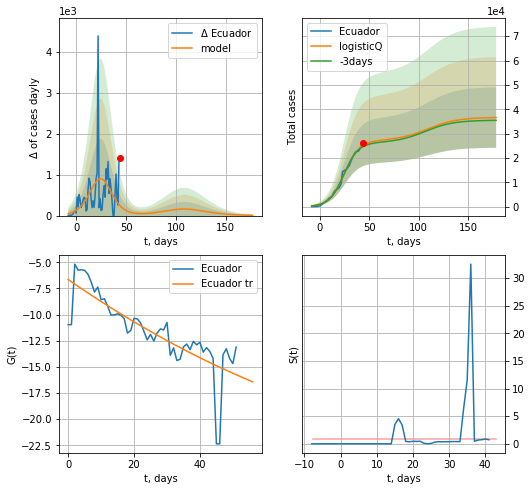

Ecuador data at: 2020-05-01
+3 day model MAPE: 0.021898
model: logisticQ
coeffs: [ 2.70848535e+04  3.54529281e-06  2.49712865e+01 -3.74805922e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.339077
forecast at the end of period: +134 days
	 deltaDaycases: 6
	 total cases: 36584 ± 12404
	 total death: 1476 ± 1501
trend coefficient of determination: 0.646703
 intercept_: -6.651868524591974
 coeffs_: [ 0.         -0.21770193  0.00076957]


In [270]:
x = forecastRRR("Ecuador",dfED[10:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
          date   cases  active  death
62 2020-04-27  4695.0    2002  193.0
63 2020-04-28  4740.0    1741  199.0
64 2020-04-29  4906.0    1900  206.0
65 2020-04-30  4995.0    1784  211.0
66 2020-05-01  5051.0    1833  218.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


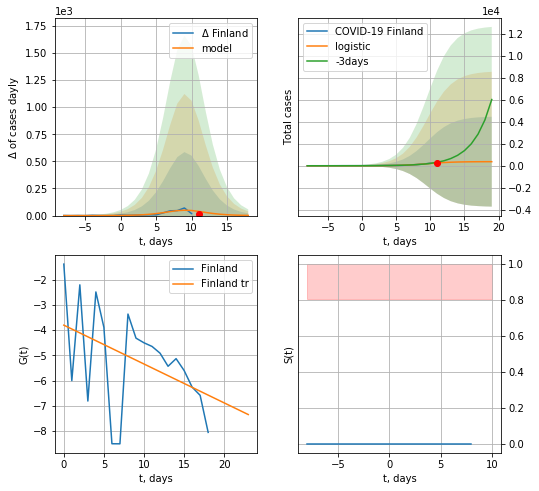

Finland data at: 2020-05-01
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +8 days
	 deltaDaycases:  1
	 total cases:  370 ± 4089
	 total death:  16 ± 529
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


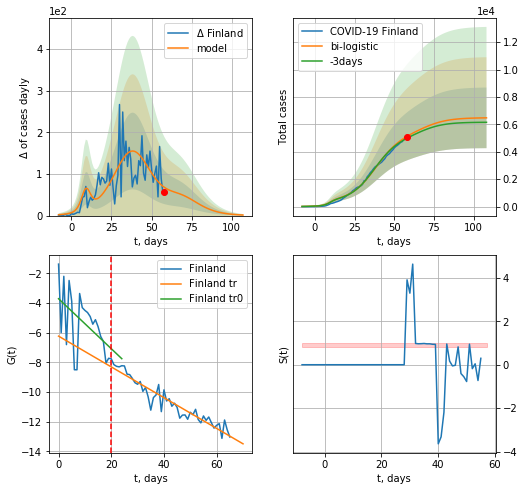

Finland data at: 2020-05-01
+3 day model MAPE: 0.027781483861608173
model: bi-logistic
coeffs:  [4.89078863e+03 1.24356214e-01 3.83273402e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.34150570879397396
forecast at the end of period: +50 days
	 deltaDaycases:  1
	 total cases:  6476 ± 2211
	 total death:  279 ± 285
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.907790
 intercept: -6.235646
 slope: -0.103603


In [271]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,6*7-dT)
xx = forecast2("Finland",dfFI[:],d1,12*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


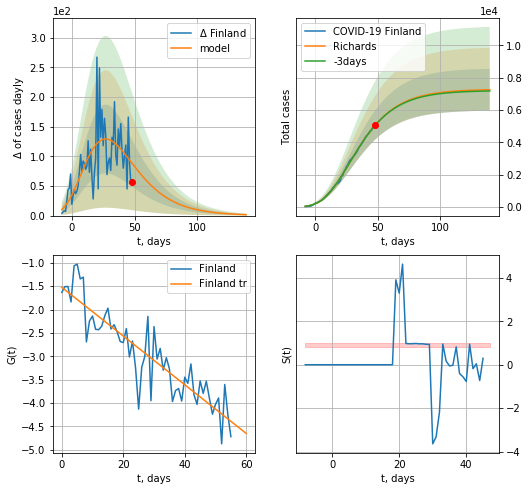

Finland data at: 2020-05-01
+3 day model MAPE: 0.003086626790067961
model: Richards
coeffs:  [ 7.28616781e+03  1.89374950e+00 -4.75380828e+01  2.57725811e-02]
rational stdev:  0.17884810035278936
forecast at the end of period: +92 days
	 deltaDaycases:  1
	 total cases:  7256 ± 1297
	 total death:  313 ± 167
trend coefficient of determination: 0.804985
 intercept: -1.524530
 slope: -0.052153


In [272]:
x = forecastRR("Finland",dfFI[10:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


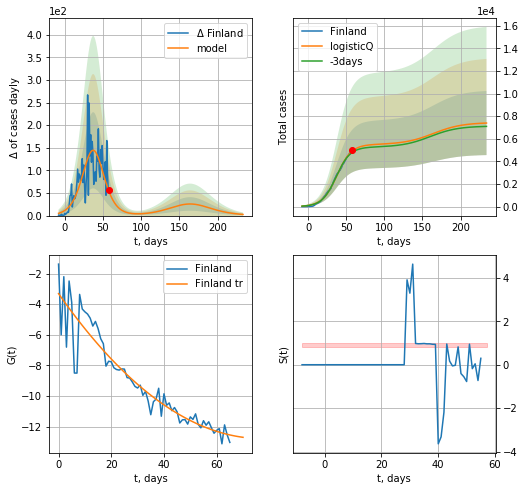

Finland data at: 2020-05-01
+3 day model MAPE: 0.026368
model: logisticQ
coeffs: [ 5.49639481e+03  1.62667782e-06  3.76879537e+01 -6.45635727e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.383424
forecast at the end of period: +176 days
	 deltaDaycases: 2
	 total cases: 7395 ± 2835
	 total death: 319 ± 366
trend coefficient of determination: 0.876172
 intercept_: -3.3133296316179575
 coeffs_: [ 0.         -0.2449607   0.00158464]


In [273]:
x = forecastRRR("Finland",dfFI[:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

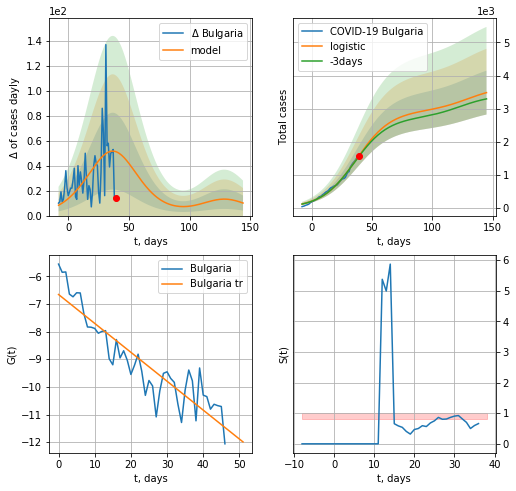

Bulgaria data at: 2020-05-01
+3 day model MAPE: 0.015574916569850937
model: logistic
coeffs:  [2.93718621e+03 7.02683581e-02 3.70613076e+01]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.1899307078596889
forecast at the end of period: +106 days
	 deltaDaycases:  10
	 total cases:  3483 ± 661
	 total death:  152 ± 86
trend coefficient of determination: 0.825321
 intercept: -6.659878
 slope: -0.104527


In [274]:
x = forecast('Bulgaria',dfBL[5:],d1,20*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


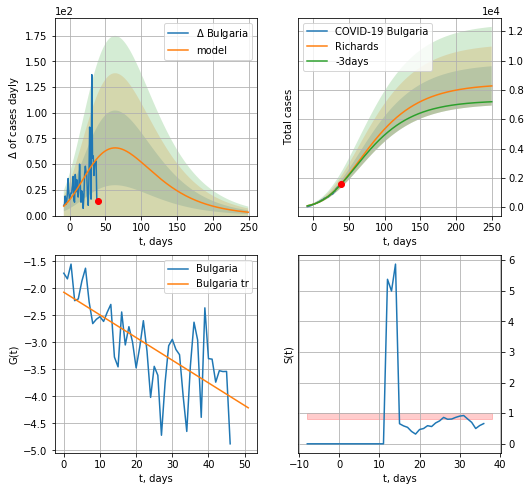

Bulgaria data at: 2020-05-01
+3 day model MAPE: 0.011418003577429404
model: Richards
coeffs:  [ 8.42155390e+03  9.49521344e-01 -1.12324355e+02  2.26291281e-02]
rational stdev:  0.16216100199451347
forecast at the end of period: +211 days
	 deltaDaycases:  3
	 total cases:  8268 ± 1340
	 total death:  361 ± 175
trend coefficient of determination: 0.519112
 intercept: -2.070650
 slope: -0.041944


In [275]:
x = forecastRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=False,xcoef=[0.25,1.,4.5])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


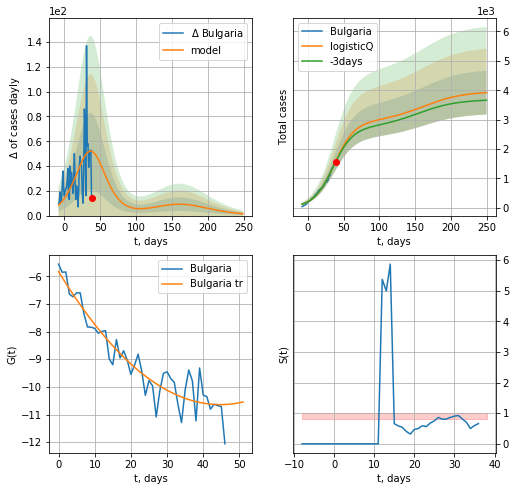

Bulgaria data at: 2020-05-01
+3 day model MAPE: 0.014767
model: logisticQ
coeffs: [ 2.92634947e+03  3.45303682e-06  3.69567234e+01 -2.03730728e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.190056
forecast at the end of period: +211 days
	 deltaDaycases: 1
	 total cases: 3920 ± 745
	 total death: 171 ± 97
trend coefficient of determination: 0.889952
 intercept_: -5.830798131906305
 coeffs_: [ 0.         -0.21512215  0.00240479]


In [276]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
          date  cases  active  death
60 2020-04-27   2938   232.0   54.0
61 2020-04-28   2947   228.0   54.0
62 2020-04-29   2954   216.0   54.0
63 2020-04-30   2960   187.0   54.0
64 2020-05-01   2966   180.0   54.0


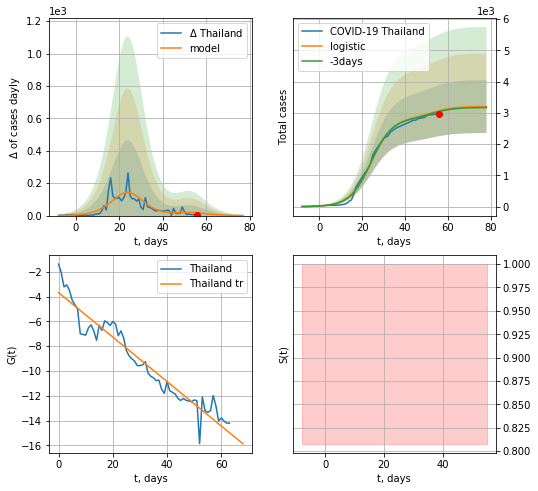

Thailand data at: 2020-05-01
+3 day model MAPE: 0.00844360254068692
model: logistic
coeffs:  [2.84880955e+03 2.00483179e-01 2.42570404e+01]
scenario coeffs:  [0.125, 1.0, 2.2]
rational stdev:  0.26502442137173454
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  3202 ± 848
	 total death:  58 ± 46
trend coefficient of determination: 0.927250
 intercept: -3.681830
 slope: -0.179178


In [277]:
dfTH = read_df(pd.DataFrame(),"TH")
x = forecast("Thailand",dfTH[:],d1,8*7-dT,addpred=True,xcoef=[0.25/2,1.,2.2])
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [278]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


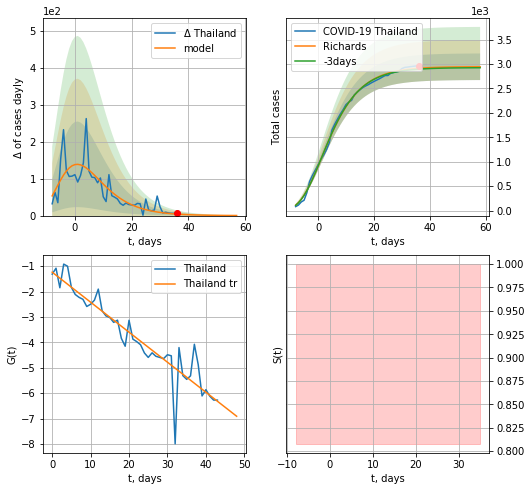

Thailand data at: 2020-05-01
+3 day model MAPE: 0.006112657379224627
model: Richards
coeffs:  [ 2.94655296e+03  1.47878379e+01 -3.54835964e+01  8.71631458e-03]
rational stdev:  0.0923603997462496
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  2944 ± 271
	 total death:  53 ± 14
trend coefficient of determination: 0.858030
 intercept: -1.234832
 slope: -0.118193


In [279]:
x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/6,.5,4,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


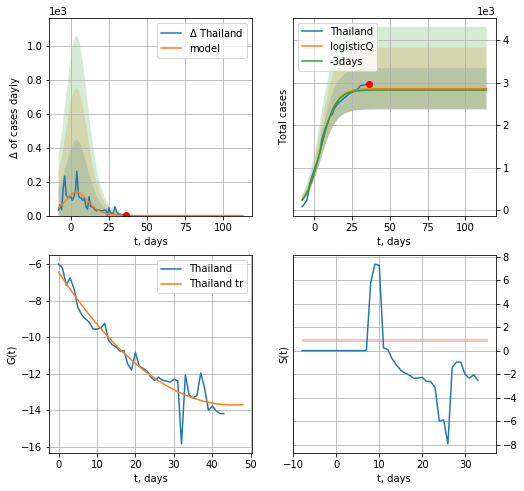

Thailand data at: 2020-05-01
+3 day model MAPE: 0.010767
model: logisticQ
coeffs: [ 2.85829279e+03  1.71231552e-06  4.27079352e+00 -1.13538711e+05]
rational stdev: 0.169587
forecast at the end of period: +78 days
	 deltaDaycases: 0
	 total cases: 2858 ± 484
	 total death: 52 ± 26
trend coefficient of determination: 0.926806
 intercept_: -6.446352118732534
 coeffs_: [ 0.         -0.32048809  0.00352838]


In [93]:
x = forecastRRR("Thailand",dfTH[20:],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,4,1])

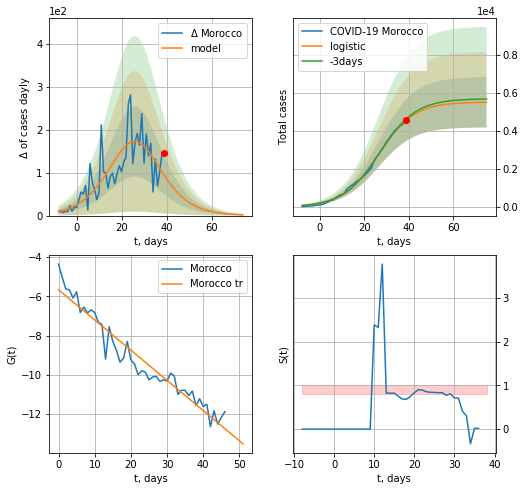

Morocco data at: 2020-05-01
+3 day model MAPE: 0.015573191267385622
model: logistic
coeffs:  [5.52149157e+03 1.25061738e-01 2.63550790e+01]
rational stdev:  0.24011122453331438
forecast at the end of period: +36 days
	 deltaDaycases:  1
	 total cases:  5508 ± 1322
	 total death:  206 ± 148
trend coefficient of determination: 0.935812
 intercept: -5.666812
 slope: -0.153759


In [281]:
x = forecast("Morocco",dfMR[5:],d1,10*7-dT)

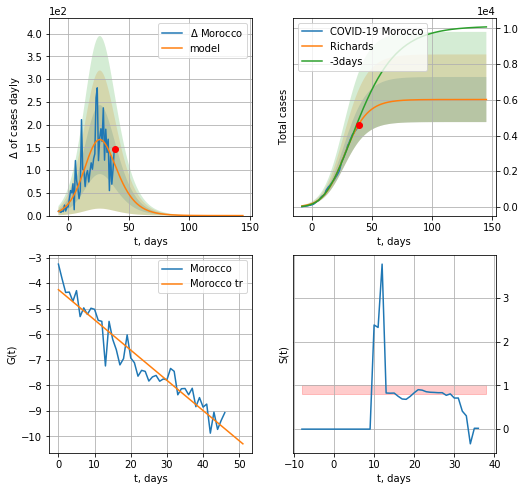

Morocco data at: 2020-05-01
+3 day model MAPE: 0.06451256147549869
model: Richards
coeffs:  [6.01495162e+03 1.49545203e-01 2.25484694e+01 6.67403569e-01]
rational stdev:  0.2099131242205364
forecast at the end of period: +106 days
	 deltaDaycases:  0
	 total cases:  6014 ± 1262
	 total death:  225 ± 141
trend coefficient of determination: 0.921571
 intercept: -4.254412
 slope: -0.118310


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


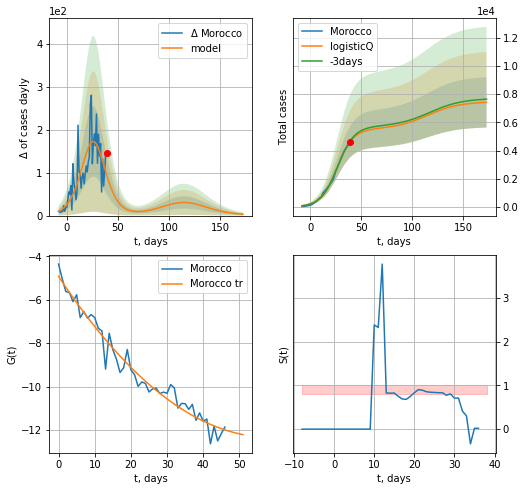

Morocco data at: 2020-05-01
+3 day model MAPE: 0.015356
model: logisticQ
coeffs: [ 5.51191830e+03  1.19298239e-05  2.63265628e+01 -1.04788171e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.240815
forecast at the end of period: +134 days
	 deltaDaycases: 3
	 total cases: 7415 ± 1785
	 total death: 277 ± 200
trend coefficient of determination: 0.962978
 intercept_: -4.925186138238542
 coeffs_: [ 0.         -0.25270241  0.00215159]


In [282]:
x = forecastRR("Morocco",dfMR[5:],d1,20*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1])
x = forecastRRR("Morocco",dfMR[5:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

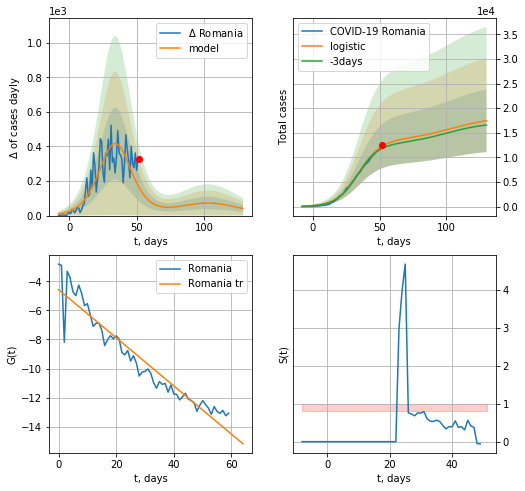

Romania data at: 2020-05-01
+3 day model MAPE: 0.03816794874132957
model: logistic
coeffs:  [1.34990989e+04 1.22285175e-01 3.44988921e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.3643888784921627
forecast at the end of period: +78 days
	 deltaDaycases:  40
	 total cases:  17443 ± 6356
	 total death:  1032 ± 1128
trend coefficient of determination: 0.914634
 intercept: -4.560776
 slope: -0.166108


In [283]:
#dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


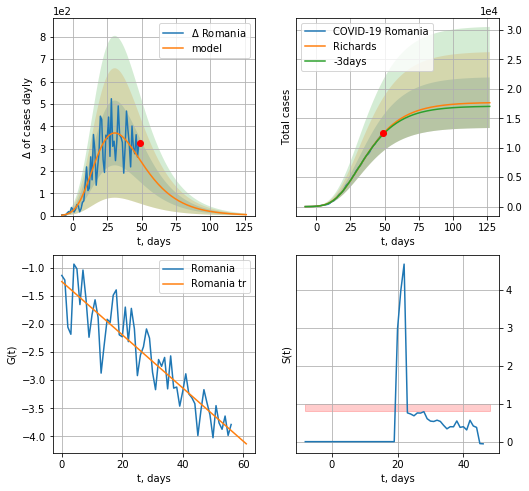

Romania data at: 2020-05-01
+3 day model MAPE: 0.011802289009215056
model: Richards
coeffs:  [ 1.77088997e+04  3.84815815e+00 -4.26225229e+01  1.48653540e-02]
rational stdev:  0.24326385836593167
forecast at the end of period: +78 days
	 deltaDaycases:  4
	 total cases:  17636 ± 4290
	 total death:  1044 ± 761
trend coefficient of determination: 0.824570
 intercept: -1.244499
 slope: -0.047362


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


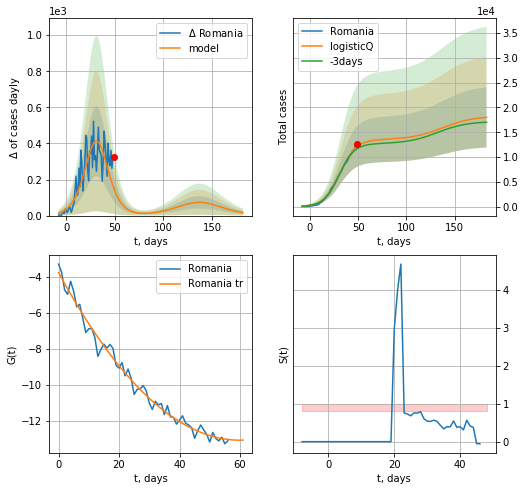

Romania data at: 2020-05-01
+3 day model MAPE: 0.038659
model: logisticQ
coeffs: [ 1.35030599e+04  1.97121832e-06  3.15060655e+01 -6.19495145e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.337555
forecast at the end of period: +134 days
	 deltaDaycases: 16
	 total cases: 18013 ± 6080
	 total death: 1066 ± 1079
trend coefficient of determination: 0.985269
 intercept_: -3.7643217680660177
 coeffs_: [ 0.         -0.30981571  0.00258267]


In [284]:
x = forecastRR("Romania",dfRM[8:],d1,16*7-dT)
xx = forecastRRR("Romania",dfRM[8:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

In [285]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
          date    cases  active     death
79 2020-04-27   980633  474133   99402.0
80 2020-04-28   989757  467363  101085.0
81 2020-04-29  1002358  455320  103033.0
82 2020-04-30  1013204  451651  104482.0
83 2020-05-01  1022788  447423  105770.0


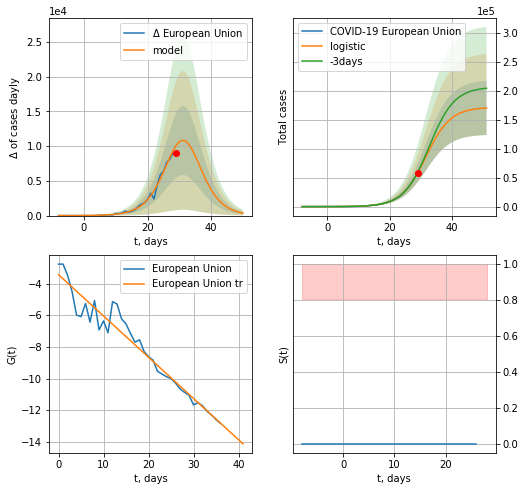

European Union data at: 2020-05-01
+3 day model MAPE: 0.026654473576493115
model: logistic
coeffs:  [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.2741183518342743
forecast at the end of period: +22 days
	 deltaDaycases:  352
	 total cases:  169976 ± 46593
	 total death:  17577 ± 14454
trend coefficient of determination: 0.946316
 intercept: -3.442935
 slope: -0.260531


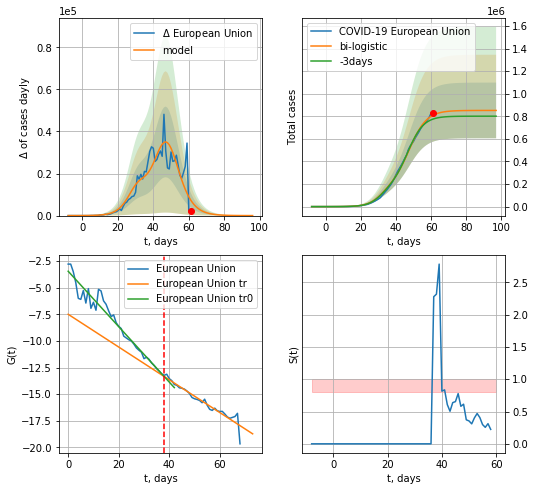

European Union data at: 2020-05-01
+3 day model MAPE: 0.04651829112234155
model: bi-logistic
coeffs:  [6.80547246e+05 2.01837730e-01 4.76694046e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.28952183224371997
forecast at the end of period: +36 days
	 deltaDaycases:  7
	 total cases:  851721 ± 246592
	 total death:  88079 ± 76502
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend coefficient of determination: 0.919561
 intercept: -7.491452
 slope: -0.154009


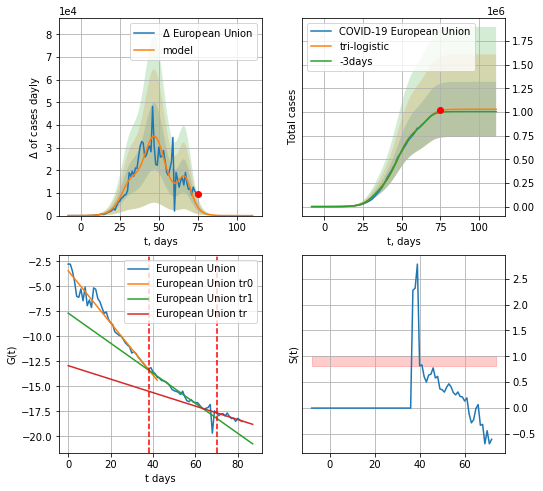

European Union data at: 2020-05-01
+3 day model MAPE: 0.019699388870328655
model: tri-logistic
coeffs:  [1.77353643e+05 3.34016451e-01 6.70787880e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01 6.80547246e+05
 2.01837730e-01 4.76694046e+01]
forecast rational stdev:  0.28196723113983785
forecast at the end of period: +36 days
	 deltaDaycases:  0
	 total cases:  1029105 ± 290174
	 total death:  106423 ± 90023
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend1 coefficient of determination: 0.917498
 intercept: -7.673048
 slope: -0.150226
trend coefficient of determination: 0.759026
 intercept: -12.924858
 slope: -0.067444


In [286]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,8*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,10*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,10*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


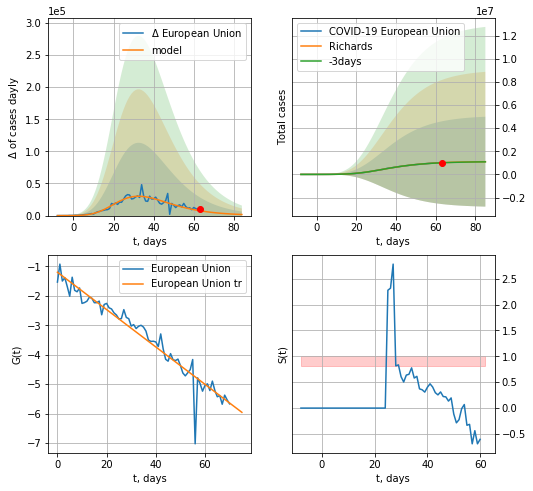

European Union data at: 2020-05-01
+3 day model MAPE: 0.007586891945296156
model: Richards
coeffs:  [ 1.12311495e+06  1.04633255e+00 -1.77988662e+00  7.22956955e-02]
rational stdev:  3.531019061713517
forecast at the end of period: +22 days
	 deltaDaycases:  1683
	 total cases:  1101444 ± 3889223
	 total death:  113904 ± 1206591
trend coefficient of determination: 0.935017
 intercept: -1.198420
 slope: -0.063485


In [287]:
x = forecastRR("European Union",dfEU[12:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


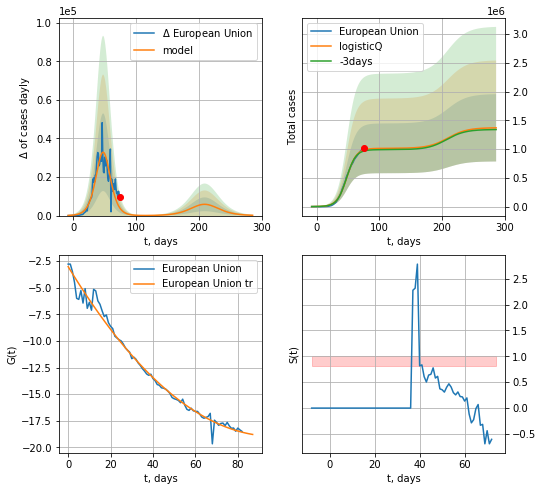

European Union data at: 2020-05-01
+3 day model MAPE: 0.018586
model: logisticQ
coeffs: [ 1.01349078e+06  1.37273737e-06  4.79853982e+01 -9.44356652e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.427064
forecast at the end of period: +211 days
	 deltaDaycases: 158
	 total cases: 1370067 ± 585107
	 total death: 141683 ± 181523
trend coefficient of determination: 0.986144
 intercept_: -3.0116513456684775
 coeffs_: [ 0.         -0.32851184  0.00169106]


In [91]:
x = forecastRRR("European Union",dfEU[:],d1,35*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


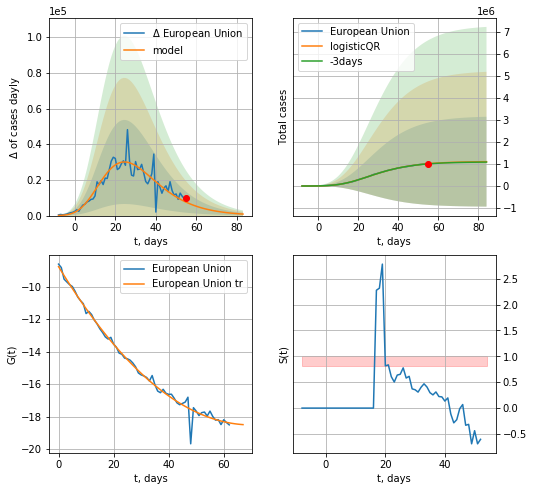

European Union data at: 2020-05-01
+3 day model MAPE: 0.007689790506003402
model: logisticQR
coeffs:  [ 1.11524459e+06  1.60349333e-02 -5.24093341e+01 -5.91005408e+02
  6.61894366e-03]
rational stdev:  1.846473242657206
forecast at the end of period: +29 days
	 deltaDaycases:  854
	 total cases:  1105682 ± 2041613
	 total death:  114342 ± 633388
trend coefficient of determination: 0.988114
 intercept_: -8.777150208002455
 coeffs_: [ 0.         -0.27841242  0.00199096]


In [289]:
x = forecastQR("European Union",dfEU[20:],d1,9*7-dT,addpred=False,xcoef=[0.35,.5,2.5,1.,1])

In [390]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [463]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [391]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [253]:
#dfIC[:]

IC
          date   cases  active  death
57 2020-04-27  1792.5     158  10.01
58 2020-04-28  1795.0     149  10.02
59 2020-04-29  1797.0     131  10.03
60 2020-04-30  1797.1     117  10.04
61 2020-05-01  1798.0      99  10.00


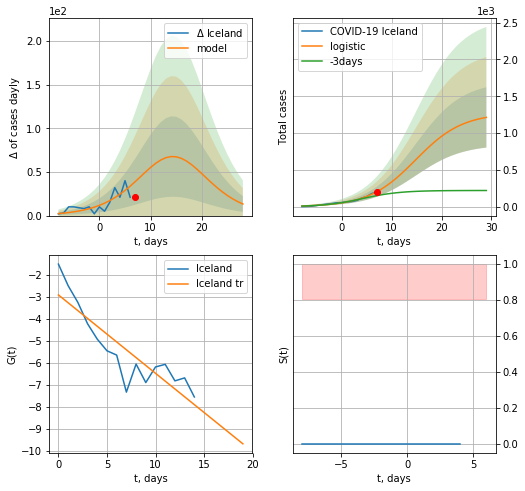

Iceland data at: 2020-05-01
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +22 days
	 deltaDaycases:  13
	 total cases:  1212 ± 409
	 total death:  6 ± 6
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109


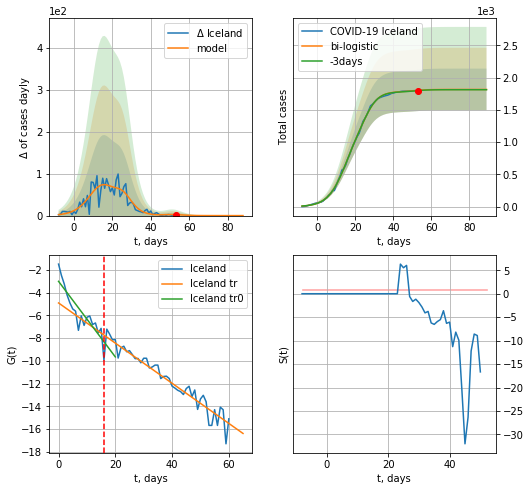

Iceland data at: 2020-05-01
+3 day model MAPE: 0.001924915388607576
model: bi-logistic
coeffs:  [5.11640930e+02 2.95157170e-01 2.60143894e+01] [1.27194861e+03 2.12945173e-01 1.48141483e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.1779161798641962
forecast at the end of period: +36 days
	 deltaDaycases:  0
	 total cases:  1815 ± 323
	 total death:  10 ± 5
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.772657
 intercept: -3.017482
 slope: -0.331878
trend coefficient of determination: 0.914134
 intercept: -4.916536
 slope: -0.176366


In [290]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
x = forecast("Iceland",dfIC[:vL],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
xx = forecast2("Iceland",dfIC[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


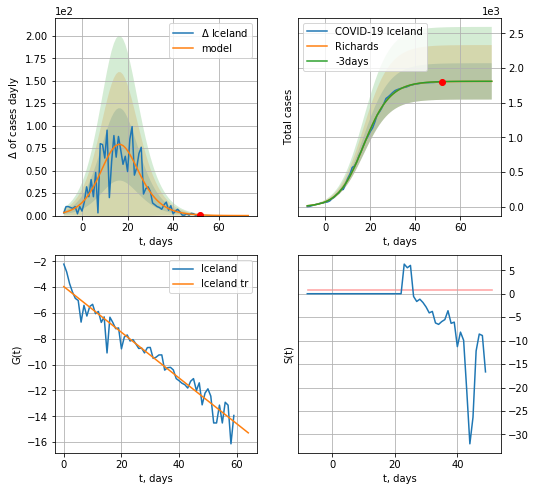

Iceland data at: 2020-05-01
+3 day model MAPE: 0.0008539241761814652
model: Richards
coeffs:  [1.80822505e+03 1.97593464e-01 1.59215776e+01 8.46183434e-01]
rational stdev:  0.14475586789480535
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  1808 ± 261
	 total death:  10 ± 4
trend coefficient of determination: 0.945369
 intercept: -3.952126
 slope: -0.177124


In [291]:
x = forecastRR("Iceland",dfIC[1:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


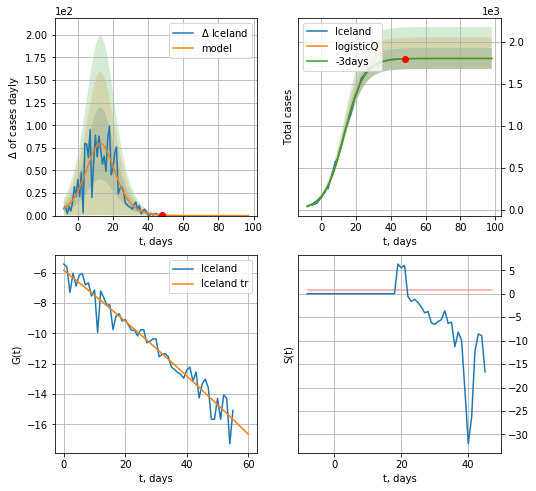

Iceland data at: 2020-05-01
+3 day model MAPE: 0.000012
model: logisticQ
coeffs: [ 1.80204765e+03  9.79205194e-06  1.33202402e+01 -1.80923115e+04]
rational stdev: 0.069619
forecast at the end of period: +50 days
	 deltaDaycases: 0
	 total cases: 1802 ± 125
	 total death: 10 ± 2
trend coefficient of determination: 0.949166
 intercept_: -5.847287633106838
 coeffs_: [ 0.         -0.16265467 -0.00029204]


In [94]:
x = forecastRRR("Iceland",dfIC[5:],d1,12*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

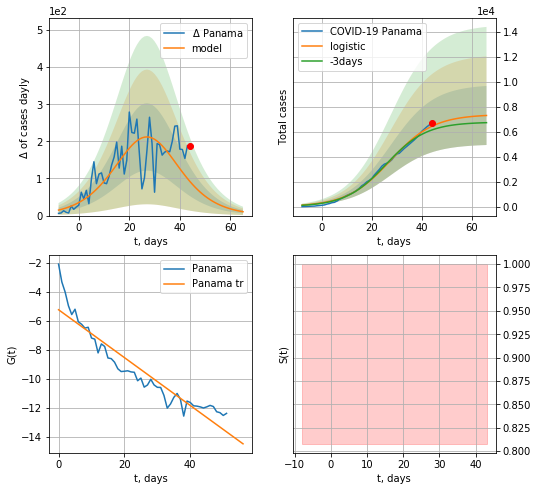

Panama data at: 2020-05-01
+3 day model MAPE: 0.05152595362214474
model: logistic
coeffs:  [7.38485435e+03 1.14855315e-01 2.74413172e+01]
rational stdev:  0.3239791412310827
forecast at the end of period: +22 days
	 deltaDaycases:  10
	 total cases:  7297 ± 2364
	 total death:  208 ± 202
trend coefficient of determination: 0.886262
 intercept: -5.244952
 slope: -0.165046


In [293]:
#dfPM = read_df(pd.DataFrame(),"PM")
x = forecast("Panama",dfPM[:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


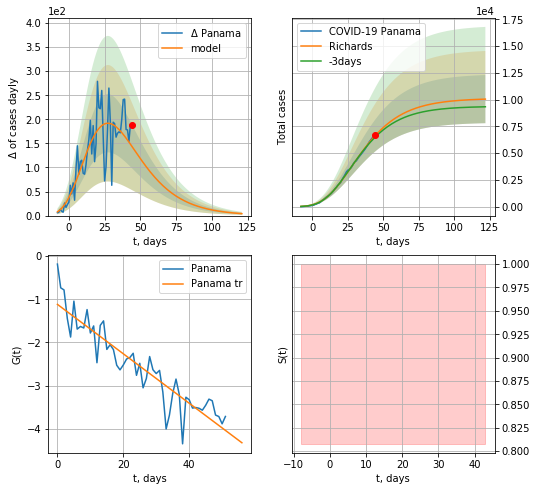

Panama data at: 2020-05-01
+3 day model MAPE: 0.022497835624766403
model: Richards
coeffs:  [ 1.01277788e+04  3.33979021e+00 -5.24390185e+01  1.55421641e-02]
rational stdev:  0.22390821929984778
forecast at the end of period: +78 days
	 deltaDaycases:  4
	 total cases:  10051 ± 2250
	 total death:  287 ± 192
trend coefficient of determination: 0.846120
 intercept: -1.116596
 slope: -0.057242


In [294]:
x = forecastRR("Panama",dfPM[:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


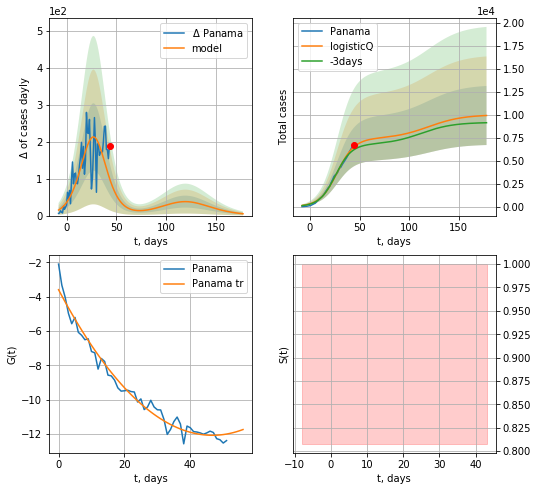

Panama data at: 2020-05-01
+3 day model MAPE: 0.050931
model: logisticQ
coeffs: [ 7.38303163e+03  1.50277163e-06  2.74368768e+01 -7.64077423e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.324043
forecast at the end of period: +134 days
	 deltaDaycases: 4
	 total cases: 9911 ± 3211
	 total death: 283 ± 275
trend coefficient of determination: 0.975286
 intercept_: -3.592450867046324
 coeffs_: [ 0.         -0.36340975  0.0038901 ]


In [295]:
x = forecastRRR("Panama",dfPM[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

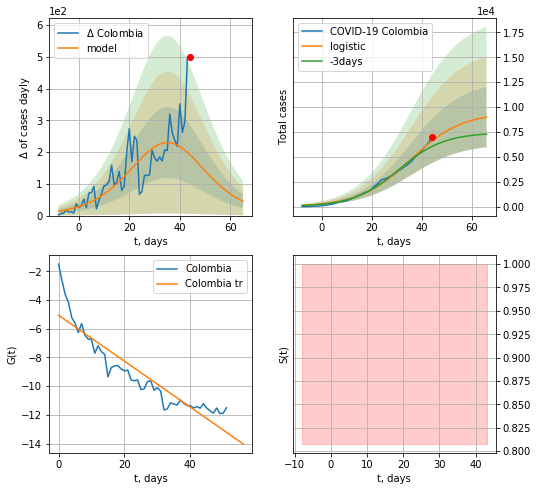

Colombia data at: 2020-05-01
+3 day model MAPE: 0.09846584393450633
model: logistic
coeffs:  [9.44141800e+03 9.76091643e-02 3.55628658e+01]
rational stdev:  0.3363803496385646
forecast at the end of period: +22 days
	 deltaDaycases:  44
	 total cases:  8981 ± 3021
	 total death:  402 ± 405
trend coefficient of determination: 0.849909
 intercept: -5.063518
 slope: -0.159765


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


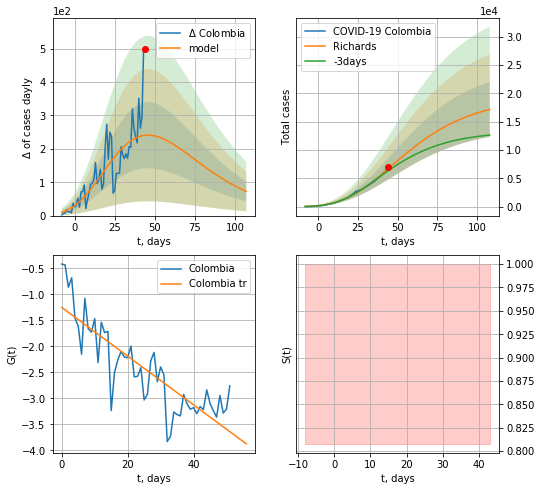

Colombia data at: 2020-05-01
+3 day model MAPE: 0.0602373235678721
model: Richards
coeffs:  [ 1.94052313e+04  2.54073061e+00 -8.07079751e+01  1.33755353e-02]
rational stdev:  0.28265424018516494
forecast at the end of period: +64 days
	 deltaDaycases:  72
	 total cases:  17167 ± 4852
	 total death:  769 ± 652
trend coefficient of determination: 0.707049
 intercept: -1.252419
 slope: -0.046813


In [296]:
x = forecast("Colombia",dfCB[:],d1,8*7-dT)
x = forecastRR("Colombia",dfCB[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


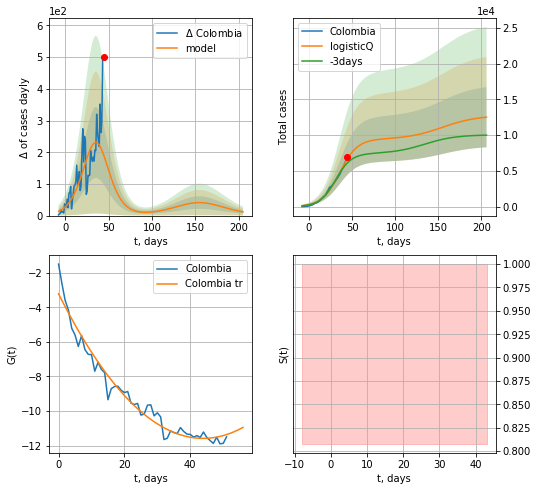

Colombia data at: 2020-05-01
+3 day model MAPE: 0.097743
model: logisticQ
coeffs: [ 9.43243241e+03  2.05274216e-06  3.55424667e+01 -4.75448830e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.336414
forecast at the end of period: +162 days
	 deltaDaycases: 11
	 total cases: 12521 ± 4212
	 total death: 561 ± 566
trend coefficient of determination: 0.963241
 intercept_: -3.2201631662107246
 coeffs_: [ 0.         -0.38103472  0.00433926]


In [297]:
x = forecastRRR("Colombia",dfCB[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
          date   cases  active  death
54 2020-04-27  3517.0  1527.0  432.0
55 2020-04-28  3649.0  1561.0  437.0
56 2020-04-29  3848.0  1702.0  444.0
57 2020-04-30  4006.0  1777.0  450.0
58 2020-05-01  4154.0  1880.0  453.0


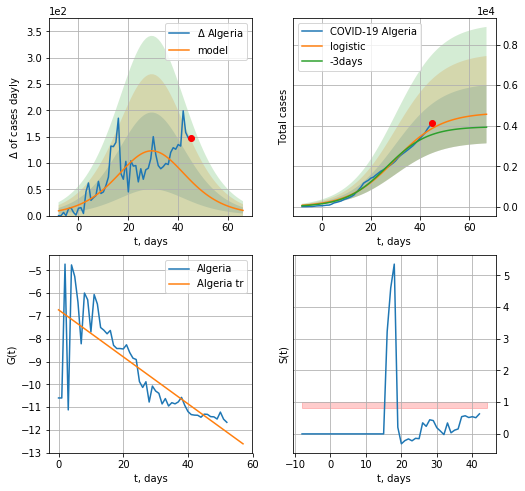

Algeria data at: 2020-05-01
+3 day model MAPE: 0.0908307206085568
model: logistic
coeffs:  [4.65705451e+03 1.05697677e-01 2.98781567e+01]
rational stdev:  0.3138403526533978
forecast at the end of period: +22 days
	 deltaDaycases:  9
	 total cases:  4566 ± 1433
	 total death:  498 ± 468
trend coefficient of determination: 0.621891
 intercept: -6.732993
 slope: -0.103078


In [298]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,8*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


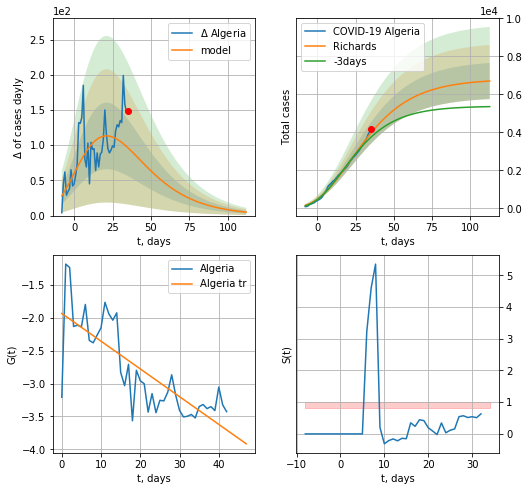

Algeria data at: 2020-05-01
+3 day model MAPE: 0.06250390093514022
model: Richards
coeffs:  [ 6.81093478e+03  4.11464816e+00 -7.75770500e+01  1.10391861e-02]
rational stdev:  0.14166743246181202
forecast at the end of period: +78 days
	 deltaDaycases:  4
	 total cases:  6704 ± 949
	 total death:  731 ± 310
trend coefficient of determination: 0.626519
 intercept: -1.932784
 slope: -0.042185


In [299]:
x = forecastRR("Algeria",dfAR[15:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


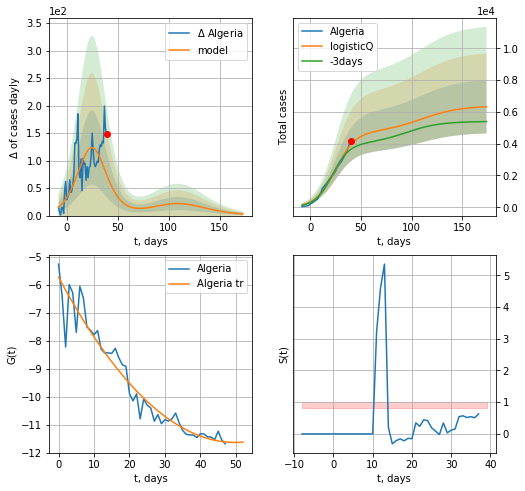

Algeria data at: 2020-05-01
+3 day model MAPE: 0.085962
model: logisticQ
coeffs: [ 4.70900978e+03  1.79545597e-06  2.51332995e+01 -5.79435864e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.265252
forecast at the end of period: +134 days
	 deltaDaycases: 2
	 total cases: 6321 ± 1676
	 total death: 689 ± 548
trend coefficient of determination: 0.936142
 intercept_: -5.731890743640559
 coeffs_: [ 0.         -0.23661459  0.00237824]


In [300]:
x = forecastRRR("Algeria",dfAR[10:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

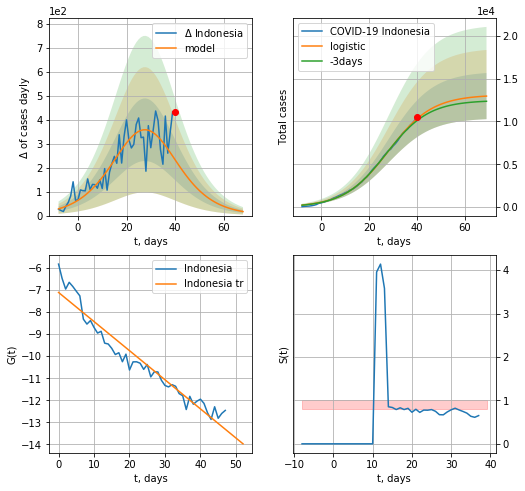

Indonesia data at: 2020-05-01
+3 day model MAPE: 0.022403002701476597
model: logistic
coeffs:  [1.30986288e+04 1.09358375e-01 2.80766069e+01]
rational stdev:  0.20758549150043237
forecast at the end of period: +29 days
	 deltaDaycases:  16
	 total cases:  12951 ± 2688
	 total death:  981 ± 610
trend coefficient of determination: 0.934907
 intercept: -7.115814
 slope: -0.131806


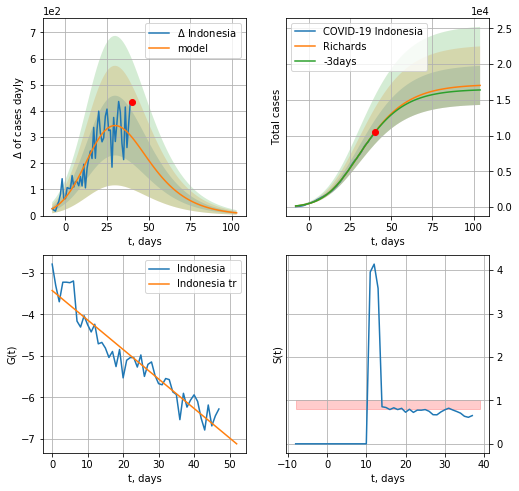

Indonesia data at: 2020-05-01
+3 day model MAPE: 0.004330134705969961
model: Richards
coeffs:  [1.71940497e+04 1.90015424e-01 1.28874879e+01 3.32868752e-01]
rational stdev:  0.1602657461715432
forecast at the end of period: +64 days
	 deltaDaycases:  10
	 total cases:  17032 ± 2729
	 total death:  1291 ± 620
trend coefficient of determination: 0.910367
 intercept: -3.424174
 slope: -0.070996


In [301]:
x = forecast("Indonesia",dfIE[5:],d1,9*7-dT)
x = forecastRR("Indonesia",dfIE[5:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


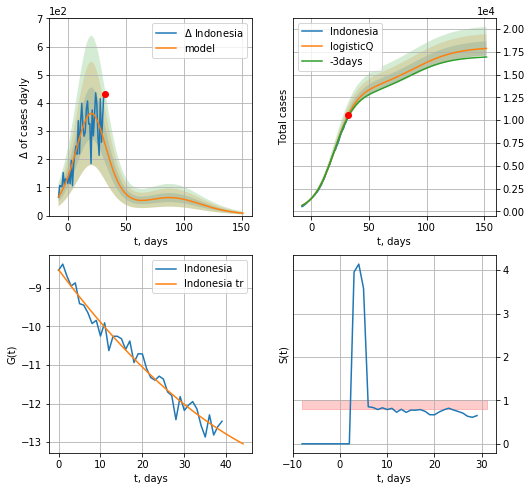

Indonesia data at: 2020-05-01
+3 day model MAPE: 0.017889
model: logisticQ
coeffs: [ 1.33127409e+04  4.53644215e-05  2.04462438e+01 -2.34401643e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.044008
forecast at the end of period: +120 days
	 deltaDaycases: 8
	 total cases: 17871 ± 786
	 total death: 1355 ± 178
trend coefficient of determination: 0.969308
 intercept_: -8.532444309670424
 coeffs_: [ 0.         -0.14581114  0.00098463]


In [302]:
x = forecastRRR("Indonesia",dfIE[13:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


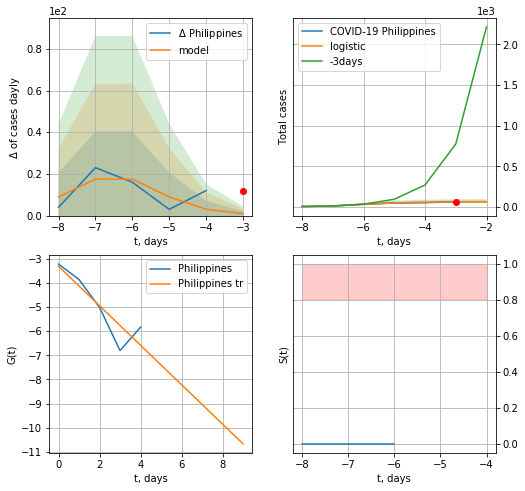

Philippines data at: 2020-05-01
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +1 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  4 ± 2
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


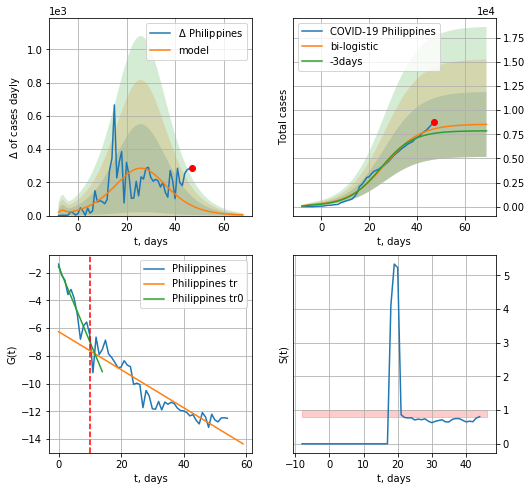

Philippines data at: 2020-05-01
+3 day model MAPE: 0.06365648506253643
model: bi-logistic
coeffs:  [8.49055290e+03 1.34378476e-01 2.63467150e+01] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.39533937183571854
forecast at the end of period: +22 days
	 deltaDaycases:  3
	 total cases:  8524 ± 3370
	 total death:  562 ± 666
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.850311
 intercept: -6.257748
 slope: -0.137179


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:304: RuntimeWarning: overflow encountered in exp


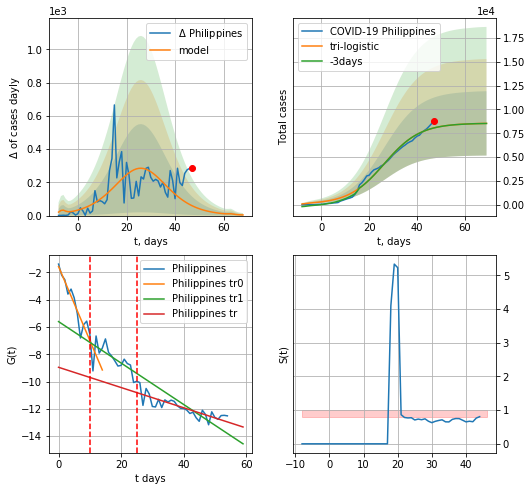

Philippines data at: 2020-05-01
+3 day model MAPE: 1.913527855287085e-13
model: tri-logistic
coeffs:  [ 9.52136494  1.44337567 63.61422719] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  8.49055290e+03
  1.34378476e-01  2.63467150e+01]
forecast rational stdev:  0.3953393718357176
forecast at the end of period: +22 days
	 deltaDaycases:  3
	 total cases:  8534 ± 3373
	 total death:  563 ± 667
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.701404
 intercept: -8.950834
 slope: -0.074158


In [303]:
vL=10
vL1=25
x = forecast("Philippines",dfPH[4:vL],d1,5*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,8*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


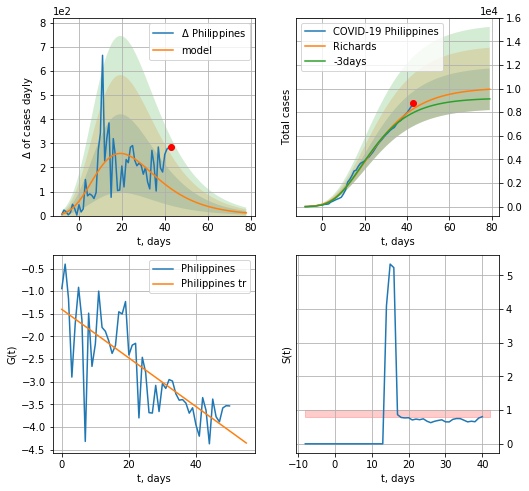

Philippines data at: 2020-05-01
+3 day model MAPE: 0.04359102396485834
model: Richards
coeffs:  [ 1.00970533e+04  6.04291771e+00 -4.39035582e+01  1.15771240e-02]
rational stdev:  0.17697687080631883
forecast at the end of period: +36 days
	 deltaDaycases:  11
	 total cases:  9937 ± 1758
	 total death:  655 ± 347
trend coefficient of determination: 0.603858
 intercept: -1.401525
 slope: -0.053693


In [304]:
x = forecastRR("Philippines",dfPH[4:],d1,10*7-dT,addpred=False,xcoef=[0.25,1.,2.3])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


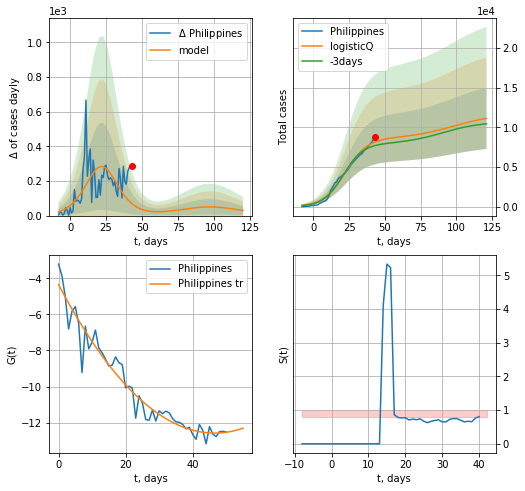

Philippines data at: 2020-05-01
+3 day model MAPE: 0.061028
model: logisticQ
coeffs: [ 8.61205785e+03  1.77442956e-06  2.23429435e+01 -7.38453176e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.345795
forecast at the end of period: +78 days
	 deltaDaycases: 29
	 total cases: 11131 ± 3849
	 total death: 734 ± 761
trend coefficient of determination: 0.943032
 intercept_: -4.351483070971691
 coeffs_: [ 0.         -0.35332977  0.00379712]


In [305]:
x = forecastRRR("Philippines",dfPH[4:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
          date  cases  active  death
58 2020-04-27   2534    1821  136.0
59 2020-04-28   2566    1851  138.0
60 2020-04-29   2576    1860  139.0
61 2020-04-30   2591    1077  140.0
62 2020-05-01   2612    1098  140.0


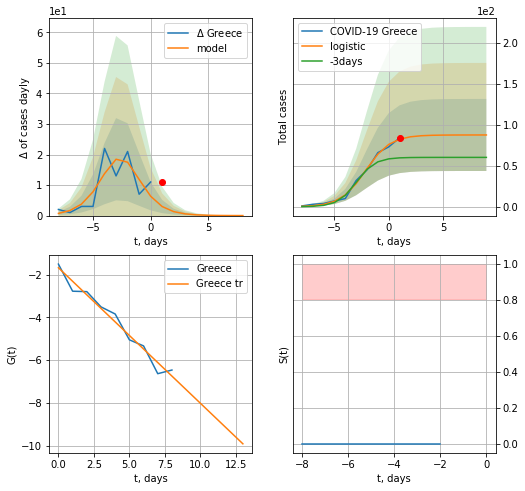

Greece data at: 2020-05-01
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  4 ± 6
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


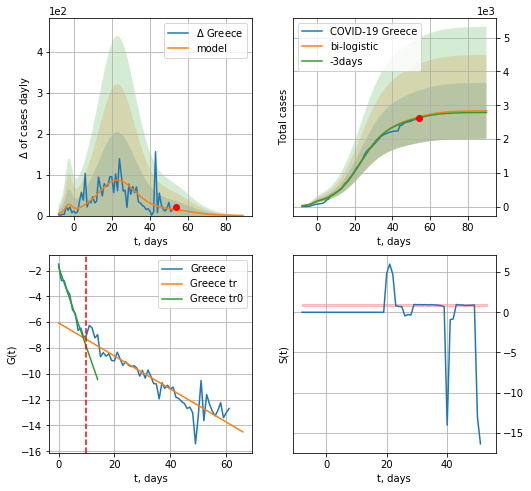

Greece data at: 2020-05-01
+3 day model MAPE: 0.012044952448485172
model: bi-logistic
coeffs:  [2.44371149e+03 1.40866973e-01 2.33101740e+01] [87.54984336  0.87627722 -2.15069813]
scenario coeffs:  [0.125, 1.0, 2.3]
rational stdev:  0.2920863997592188
forecast at the end of period: +36 days
	 deltaDaycases:  0
	 total cases:  2834 ± 827
	 total death:  151 ± 132
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.860658
 intercept: -6.061220
 slope: -0.127938


In [306]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,6*7-dT)
xx = forecast2("Greece",dfGC[:],d1,10*7-dT,x,addpred=True,xcoef=[.25/2,1.,2.3],vL=10)

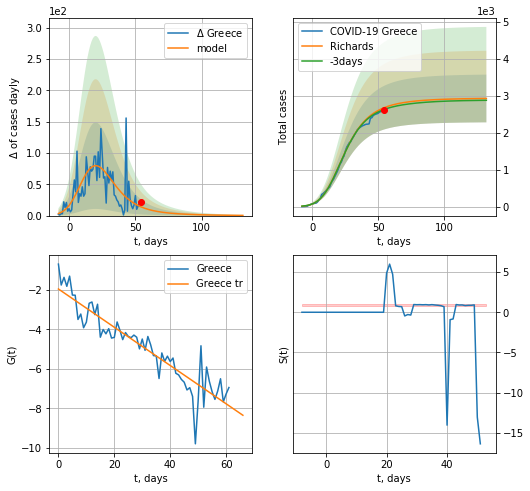

Greece data at: 2020-05-01
+3 day model MAPE: 0.018195810241823877
model: Richards
coeffs:  [2.70190676e+03 3.31912538e-01 5.70272950e+00 2.69505975e-01]
scenario coeffs:  [0.0875, 0.5, 4, 1]
rational stdev:  0.22059279911147656
forecast at the end of period: +78 days
	 deltaDaycases:  0
	 total cases:  2931 ± 646
	 total death:  157 ± 103
trend coefficient of determination: 0.848224
 intercept: -1.960234
 slope: -0.096762


In [307]:
x = forecastRR("Greece",dfGC[:],d1,16*7-dT,addpred=True,xcoef=[.35/4,.5,4,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


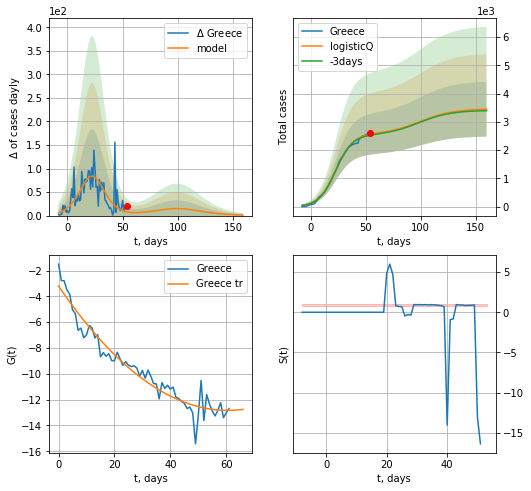

Greece data at: 2020-05-01
+3 day model MAPE: 0.013336
model: logisticQ
coeffs: [ 2.55620099e+03  1.57827843e-06  2.28264147e+01 -8.28652042e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.281658
forecast at the end of period: +106 days
	 deltaDaycases: 1
	 total cases: 3444 ± 970
	 total death: 184 ± 155
trend coefficient of determination: 0.934315
 intercept_: -3.2048083274574974
 coeffs_: [ 0.         -0.31800848  0.00262589]


In [308]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
          date  cases  active  death
52 2020-04-27   2649    1842  291.0
53 2020-04-28   2727    1891  300.0
54 2020-04-29   2775    1882  312.0
55 2020-04-30   2863    1931  323.0
56 2020-05-01   2942    1982  335.0


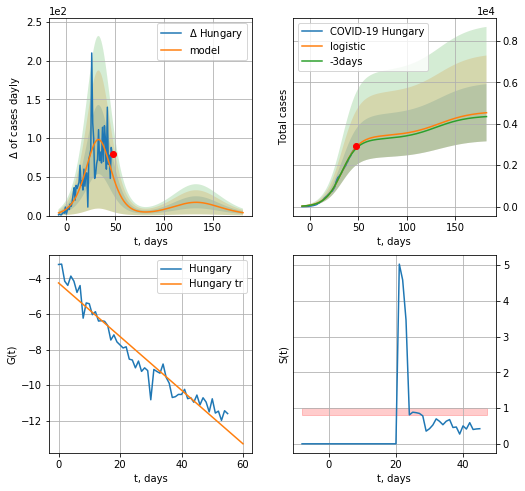

Hungary data at: 2020-05-01
+3 day model MAPE: 0.02412287183020813
model: logistic
coeffs:  [3.40695765e+03 1.15160375e-01 3.33349971e+01]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.3044739797178987
forecast at the end of period: +134 days
	 deltaDaycases:  3
	 total cases:  4531 ± 1379
	 total death:  515 ± 470
trend coefficient of determination: 0.938270
 intercept: -4.256962
 slope: -0.150768


In [309]:
dfHG = read_df(pd.DataFrame(),"HG")
x = forecast("Hungary",dfHG[:],d1,24*7-dT,addpred=True,xcoef=[.35,.5,4,1])
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


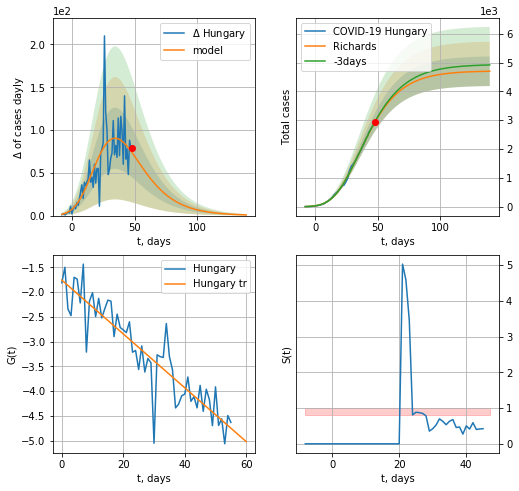

Hungary data at: 2020-05-01
+3 day model MAPE: 0.006524672997889159
model: Richards
coeffs:  [ 4.71117929e+03  4.35946836e-01 -2.19555802e+00  1.27288488e-01]
rational stdev:  0.10904770067219482
forecast at the end of period: +92 days
	 deltaDaycases:  0
	 total cases:  4697 ± 512
	 total death:  534 ± 174
trend coefficient of determination: 0.823285
 intercept: -1.758971
 slope: -0.054395


In [310]:
x = forecastRR("Hungary",dfHG[:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


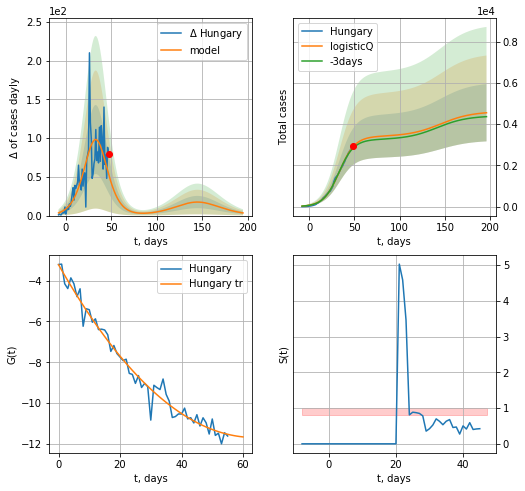

Hungary data at: 2020-05-01
+3 day model MAPE: 0.024245
model: logisticQ
coeffs: [ 3.40525532e+03  3.01610874e-06  3.33260876e+01 -3.81624076e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.304705
forecast at the end of period: +148 days
	 deltaDaycases: 3
	 total cases: 4550 ± 1386
	 total death: 518 ± 473
trend coefficient of determination: 0.975759
 intercept_: -3.227442033227767
 coeffs_: [ 0.         -0.26519647  0.00208085]


In [311]:
x = forecastRRR("Hungary",dfHG[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


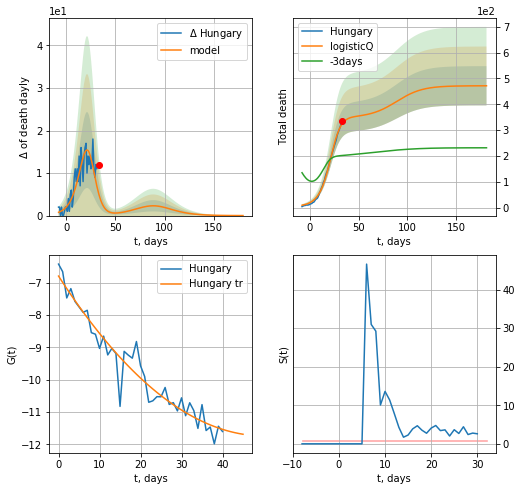

Hungary data at: 2020-05-01
+3 day model MAPE: 0.625966
model: logisticQ
coeffs: [ 3.48376831e+02  1.66359064e-03  2.03064753e+01 -8.46423830e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.161077
forecast at the end of period: +148 days
	 total death: 471 ± 75
trend coefficient of determination: 0.929201
 intercept_: -6.789163063573377
 coeffs_: [ 0.         -0.19728716  0.00196448]


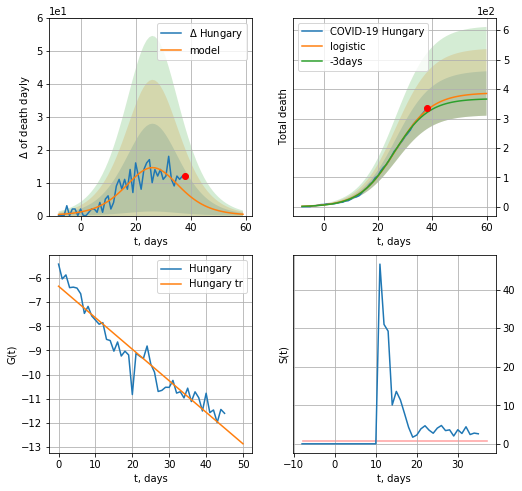

Hungary data at: 2020-05-01
+3 day model MAPE: 0.028898825776784196
model: logistic
coeffs:  [3.87474211e+02 1.50514530e-01 2.66159558e+01]
rational stdev:  0.19566953006179497
forecast at the end of period: +22 days
	 total death:  384 ± 75
trend coefficient of determination: 0.921500
 intercept: -6.341221
 slope: -0.130494


In [312]:
x = forecastRRR("Hungary",dfHG[15:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,8*7-dT,cases='death')

MT
          date  cases  active  death
50 2020-04-27  450.0     160    4.0
51 2020-04-28  458.0     151    4.0
52 2020-04-29  463.0     120    4.0
53 2020-04-30  465.0     110    4.0
54 2020-05-01  467.0      80    4.0


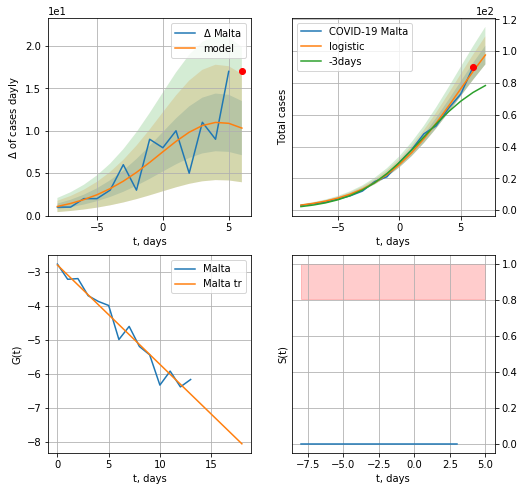

Malta data at: 2020-05-01
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +1 days
	 deltaDaycases:  10
	 total cases:  97 ± 5
	 total death:  0 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


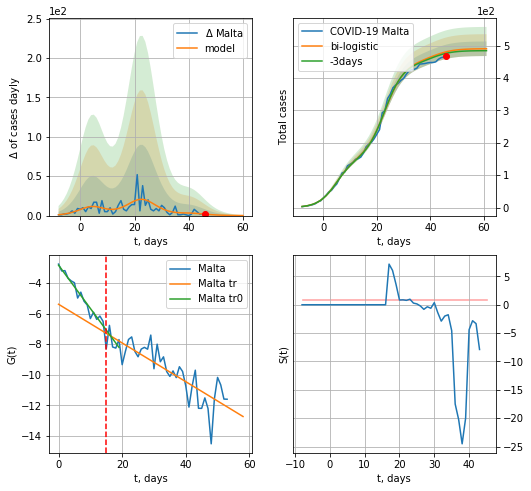

Malta data at: 2020-05-01
+3 day model MAPE: 0.010197484257950504
model: bi-logistic
coeffs:  [3.04878369e+02 2.68961496e-01 2.30699031e+01] [147.79636191   0.29837112   4.7799048 ]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.04585063981909019
forecast at the end of period: +15 days
	 deltaDaycases:  0
	 total cases:  490 ± 22
	 total death:  4 ± 0
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.954424
 intercept: -2.840997
 slope: -0.282680
trend coefficient of determination: 0.704394
 intercept: -5.395421
 slope: -0.126431


In [313]:
dfMT = read_df(pd.DataFrame(),"MT")
x = forecast("Malta",dfMT[:15],d1,5*7-dT,pMAPE=False)
xx = forecast2("Malta",dfMT[:],d1,7*7-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


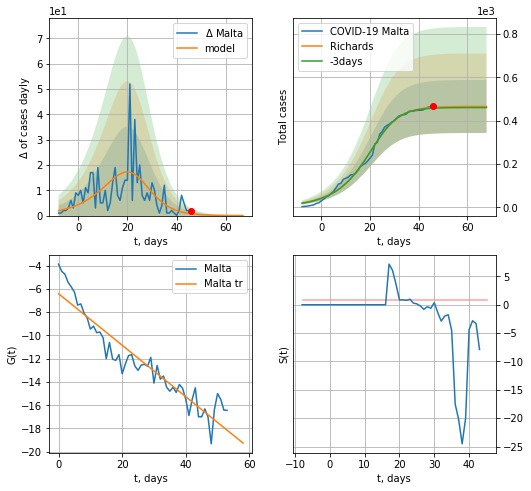

Malta data at: 2020-05-01
+3 day model MAPE: 0.009079590826835394
model: Richards
coeffs:  [4.65676906e+02 1.02607225e-01 2.36298328e+01 1.78732275e+00]
rational stdev:  0.26305116788992383
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  465 ± 122
	 total death:  3 ± 2
trend coefficient of determination: 0.890037
 intercept: -6.409444
 slope: -0.221447


In [314]:
x = forecastRR("Malta",dfMT[:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


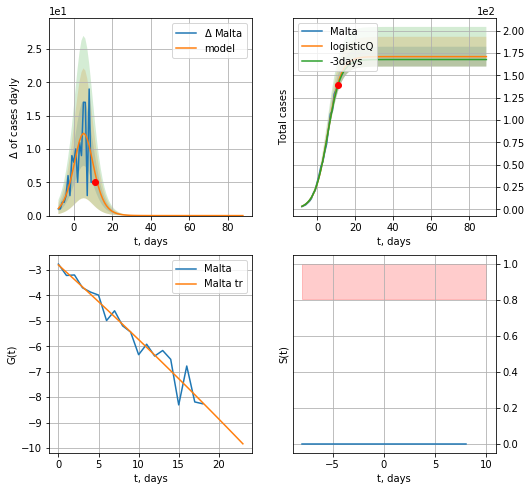

Malta data at: 2020-05-01
+3 day model MAPE: 0.017372
model: logisticQ
coeffs: [ 1.70905491e+02  1.60191203e-04  5.61725093e+00 -1.80321010e+03]
rational stdev: 0.064892
forecast at the end of period: +78 days
	 deltaDaycases: 0
	 total cases: 170 ± 11
	 total death: 1 ± 0
trend coefficient of determination: 0.945272
 intercept_: -2.8075452596601114
 coeffs_: [ 0.         -0.2833994  -0.00095541]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:264: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


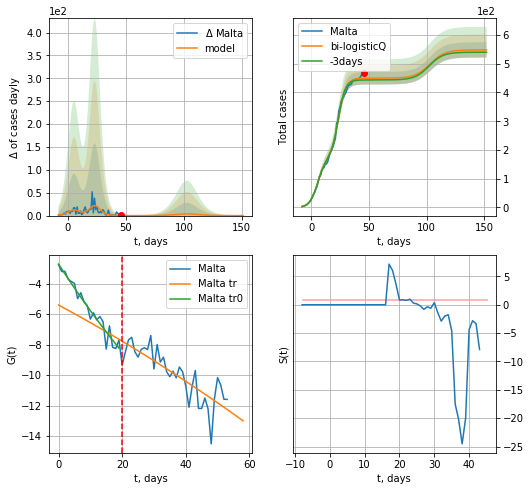

Malta data at: 2020-05-01
+3 day model MAPE: 0.013349
model: bi-logisticQ
coeffs: [ 2.78593617e+02  2.64177695e-06  2.36393136e+01 -1.17483072e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.048620
forecast at the end of period: +106 days
	 deltaDaycases: 0
	 total cases: 548 ± 26
	 total death: 4 ± 0
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.942709
 intercept_: -2.7278514236597555
 coeffs_: [ 0.         -0.32197154  0.00170311]
trend coefficient of determination: 0.663511
 intercept_: -5.412542564264208
 coeffs_: [ 0.         -0.11213756 -0.00032224]


In [86]:
x = forecastRRR("Malta",dfMT[:20],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,20*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=20)

SL
          date  cases  active  death
48 2020-04-27   1381   960.0  18.01
49 2020-04-28   1384   941.0  20.00
50 2020-04-29   1391   885.0  22.00
51 2020-04-30   1396   849.0  23.00
52 2020-05-01   1403   822.0  23.00


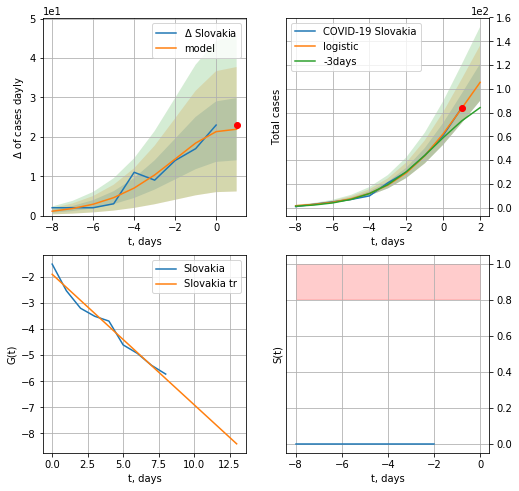

Slovakia data at: 2020-05-01
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +1 days
	 deltaDaycases:  21
	 total cases:  105 ± 15
	 total death:  1 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


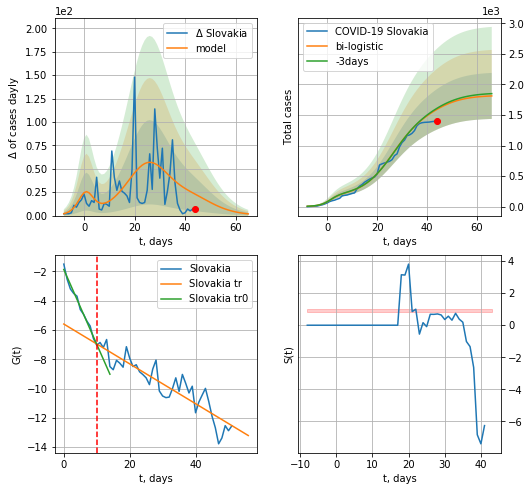

Slovakia data at: 2020-05-01
+3 day model MAPE: 0.011065584437506484
model: bi-logistic
coeffs:  [1.31550732e+03 1.65583436e-01 2.59880869e+01] [177.28786794   0.4996723    1.23158092]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.2077344140231041
forecast at the end of period: +22 days
	 deltaDaycases:  1
	 total cases:  1811 ± 376
	 total death:  29 ± 18
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.824873
 intercept: -5.593938
 slope: -0.135861


In [316]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
x = forecast("Slovakia",dfSL[:10],d1,5*7-dT,pMAPE=False)
xx = forecast2("Slovakia",dfSL[:],d1,8*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)

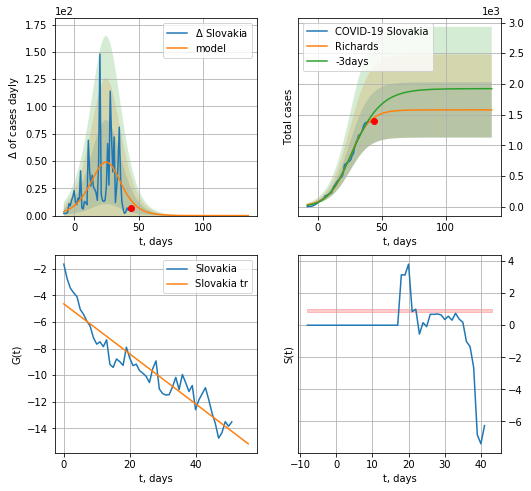

Slovakia data at: 2020-05-01
+3 day model MAPE: 0.061200494488915354
model: Richards
coeffs:  [1.57696576e+03 1.14381070e-01 2.61845500e+01 1.13313506e+00]
rational stdev:  0.28571213780199844
forecast at the end of period: +92 days
	 deltaDaycases:  0
	 total cases:  1576 ± 450
	 total death:  25 ± 21
trend coefficient of determination: 0.877166
 intercept: -4.639119
 slope: -0.187831


In [317]:
x = forecastRR("Slovakia",dfSL[:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


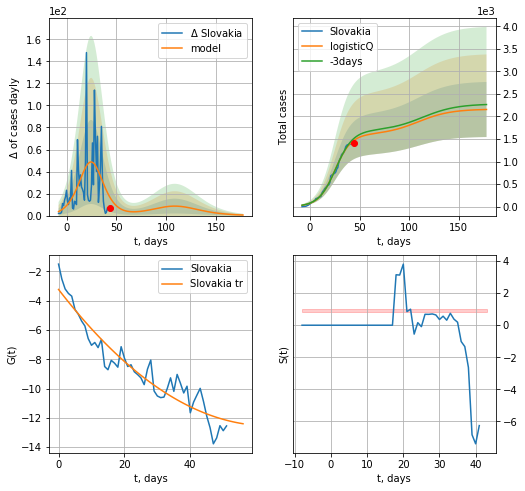

Slovakia data at: 2020-05-01
+3 day model MAPE: 0.029678
model: logisticQ
coeffs: [ 1.59749207e+03  2.59120634e-05  2.50047723e+01 -4.66459266e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.283319
forecast at the end of period: +134 days
	 deltaDaycases: 0
	 total cases: 2154 ± 610
	 total death: 35 ± 29
trend coefficient of determination: 0.900803
 intercept_: -3.233732518543274
 coeffs_: [ 0.         -0.29131816  0.00227999]


In [318]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
          date  cases  active  death
53 2020-04-27   1402  1098.0   83.0
54 2020-04-28   1408  1099.0   86.0
55 2020-04-29   1418   238.0   89.0
56 2020-04-30   1429  1105.0   91.0
57 2020-05-01   1434  1109.0   92.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


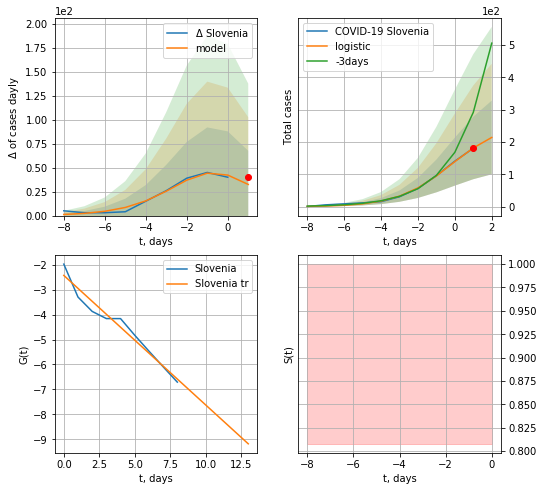

Slovenia data at: 2020-05-01
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +1 days
	 deltaDaycases:  32
	 total cases:  214 ± 113
	 total death:  13 ± 20
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


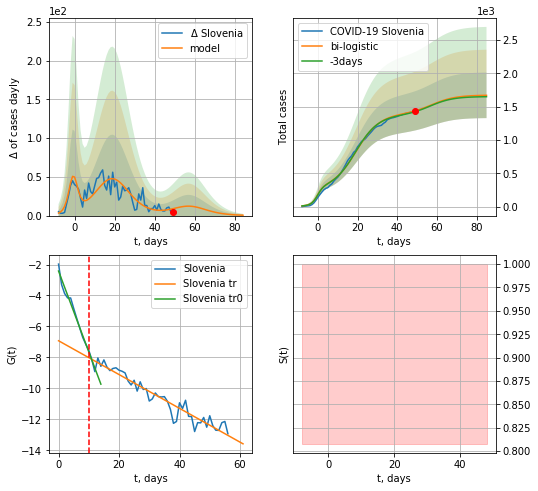

Slovenia data at: 2020-05-01
+3 day model MAPE: 0.008282782959460368
model: bi-logistic
coeffs:  [1.12925725e+03 1.68630912e-01 1.91911926e+01] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.20471601777940066
forecast at the end of period: +36 days
	 deltaDaycases:  0
	 total cases:  1669 ± 341
	 total death:  107 ± 65
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.926981
 intercept: -6.922026
 slope: -0.109082


In [340]:
dfSV = read_df(pd.DataFrame(),"SV")
x = forecast("Slovenia",dfSV[:10],d1,5*7-dT,pMAPE=False)
xx = forecast2("Slovenia",dfSV[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


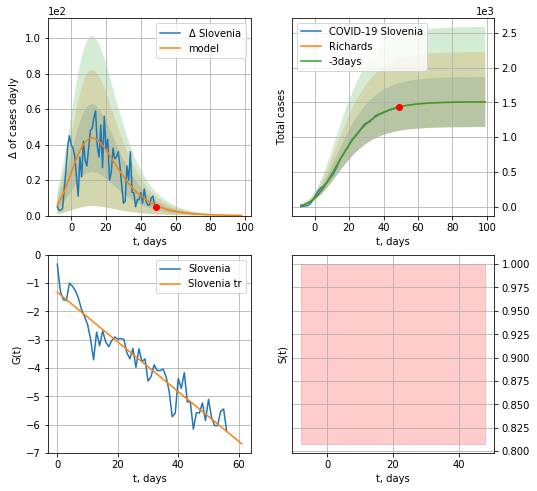

Slovenia data at: 2020-05-01
+3 day model MAPE: 0.0006187750080260054
model: Richards
coeffs:  [ 1.50801484e+03  1.02494631e+00 -1.83215618e+01  8.00175292e-02]
rational stdev:  0.23912537591549016
forecast at the end of period: +50 days
	 deltaDaycases:  0
	 total cases:  1506 ± 360
	 total death:  96 ± 68
trend coefficient of determination: 0.909769
 intercept: -1.320410
 slope: -0.087847


In [341]:
x = forecastRR("Slovenia",dfSV[:],d1,12*7-dT)

[0.35416971, 0.02606324, 4.35859408, 308.86611504] [0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp


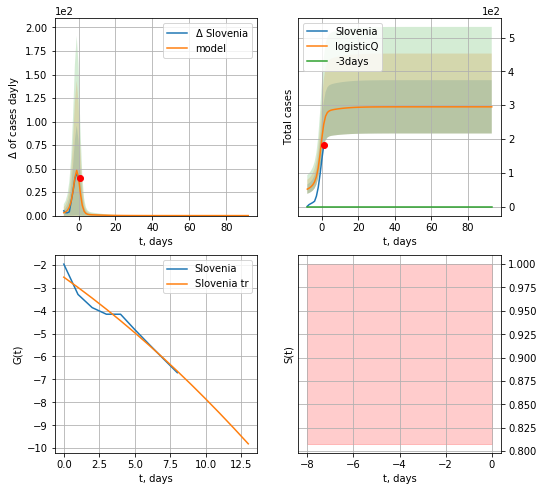

Slovenia data at: 2020-05-01
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +92 days
	 deltaDaycases: 0
	 total cases: 295 ± 78
	 total death: 18 ± 14
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:264: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


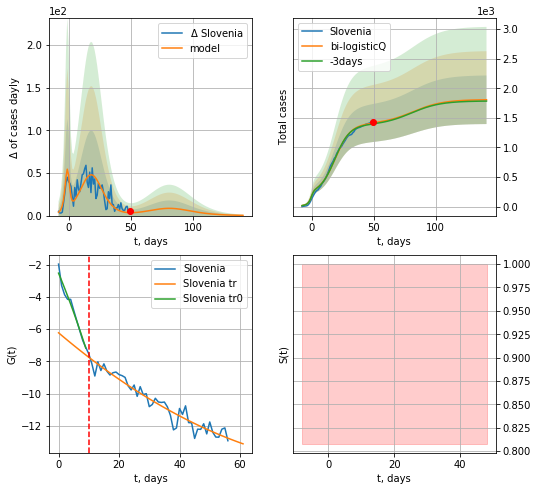

Slovenia data at: 2020-05-01
+3 day model MAPE: 0.010960604008192753
model: bi-logisticQ
coeffs:  [ 1.17476234e+03  1.15813451e-06  1.86650292e+01 -1.40260408e+05] [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs:  [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev:  0.22720750781667157
forecast at the end of period: +92 days
	 deltaDaycases:  0
	 total cases:  1805 ± 410
	 total death:  115 ± 78
bi-logistic approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.933774
 intercept_: -6.233080198776978
 coeffs_: [ 0.         -0.15935141  0.00076194]


In [404]:
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
print(kC,koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
          date  cases  active  death
48 2020-04-27   8275  6904.0  162.0
49 2020-04-28   8497  7069.0  168.0
50 2020-04-29   8724  7259.0  173.0
51 2020-04-30   9009  7487.0  179.0
52 2020-05-01   9205  7641.0  185.0


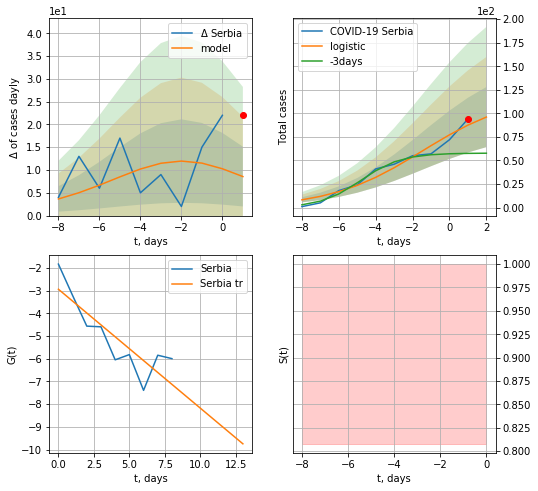

Serbia data at: 2020-05-01
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +1 days
	 deltaDaycases:  8
	 total cases:  96 ± 31
	 total death:  1 ± 0
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


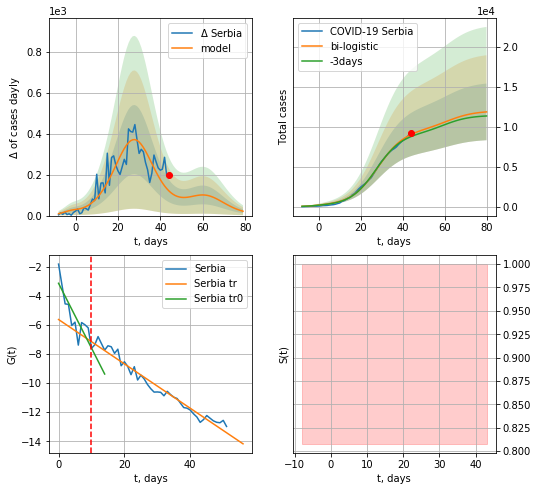

Serbia data at: 2020-05-01
+3 day model MAPE: 0.030881299256136693
model: bi-logistic
coeffs:  [9.51256814e+03 1.55570531e-01 2.80786161e+01] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.2991001211807792
forecast at the end of period: +36 days
	 deltaDaycases:  21
	 total cases:  11875 ± 3552
	 total death:  238 ± 213
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.965418
 intercept: -5.635943
 slope: -0.152384


In [345]:
dfSB = read_df(pd.DataFrame(),"SB")
x = forecast("Serbia",dfSB[:10],d1,5*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


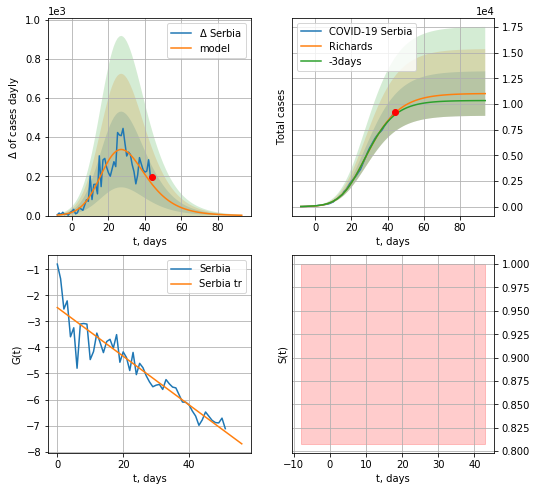

Serbia data at: 2020-05-01
+3 day model MAPE: 0.020876353721517214
model: Richards
coeffs:  [1.10203232e+04 2.73075406e-01 1.69624234e+01 3.58218070e-01]
rational stdev:  0.19675450758695107
forecast at the end of period: +50 days
	 deltaDaycases:  1
	 total cases:  11003 ± 2165
	 total death:  221 ± 130
trend coefficient of determination: 0.891353
 intercept: -2.468512
 slope: -0.093437


In [346]:
x = forecastRR("Serbia",dfSB[:],d1,12*7-dT)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


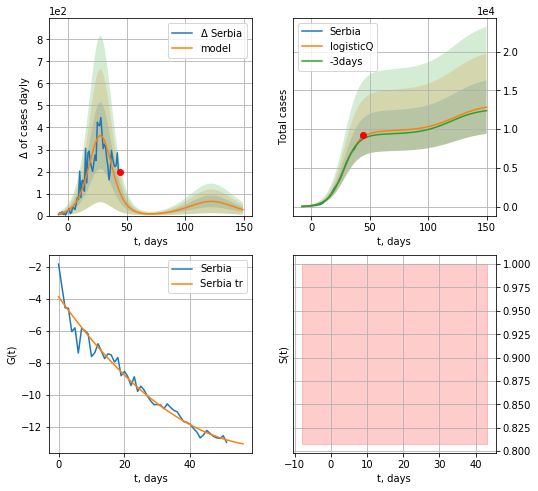

Serbia data at: 2020-05-01
+3 day model MAPE: 0.029366
model: logisticQ
coeffs: [ 9.76620655e+03  4.27245232e-06  2.80953349e+01 -3.47913659e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.268849
forecast at the end of period: +106 days
	 deltaDaycases: 26
	 total cases: 12834 ± 3450
	 total death: 257 ± 207
trend coefficient of determination: 0.963613
 intercept_: -3.8699002454284503
 coeffs_: [ 0.         -0.28988003  0.00224464]


In [347]:
x = forecastRRR("Serbia",dfSB[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
          date  cases  active  death
58 2020-04-27   2039   814.0   59.0
59 2020-04-28   2047   752.0   63.0
60 2020-04-29   2062   707.0   67.0
61 2020-04-30   2076   659.0   69.0
62 2020-05-01   2085   589.0   75.0


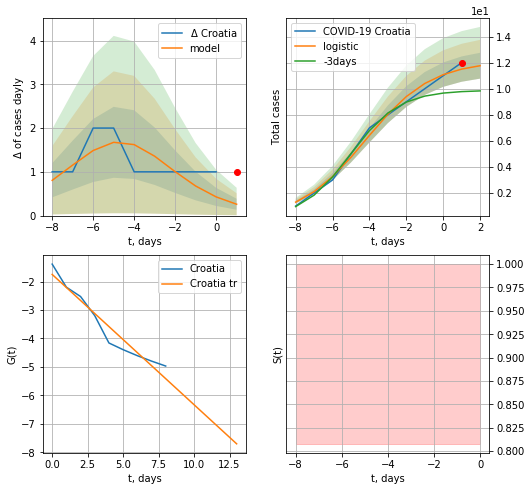

Croatia data at: 2020-05-01
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +1 days
	 deltaDaycases:  0
	 total cases:  11 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


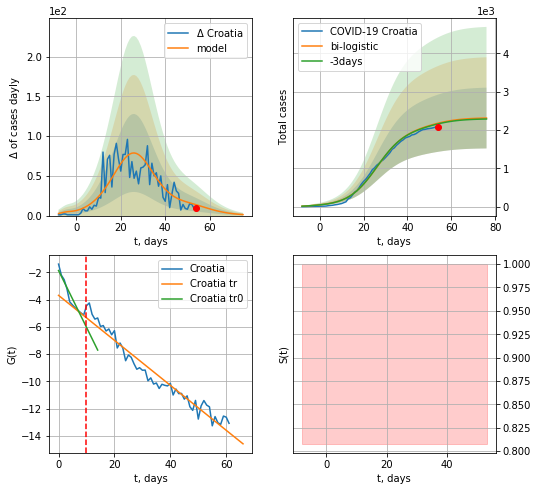

Croatia data at: 2020-05-01
+3 day model MAPE: 0.008102312664538749
model: bi-logistic
coeffs:  [2.05079991e+03 1.52656898e-01 2.62089216e+01] [12.13023855  0.55939634 -4.20963748]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.34286176904222865
forecast at the end of period: +22 days
	 deltaDaycases:  1
	 total cases:  2311 ± 792
	 total death:  83 ± 85
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.949842
 intercept: -3.682898
 slope: -0.165332


In [348]:
dfCT = read_df(pd.DataFrame(),"CT")
x = forecast("Croatia",dfCT[:10],d1,5*7-dT,pMAPE=False)
xx = forecast2("Croatia",dfCT[:],d1,8*7-dT,x,addpred=True,xcoef=[0.25/2,1.,2.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


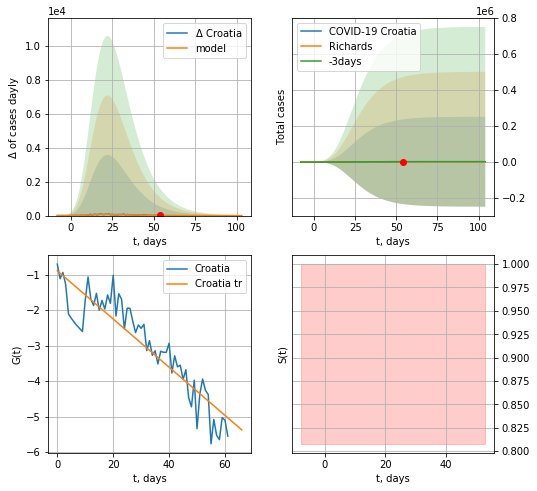

Croatia data at: 2020-05-01
+3 day model MAPE: 0.0021214307669322713
model: Richards
coeffs:  [ 2.22405551e+03  6.78614024e+00 -2.54750560e+01  1.32312050e-02]
rational stdev:  112.35577902402828
forecast at the end of period: +50 days
	 deltaDaycases:  0
	 total cases:  2222 ± 249716
	 total death:  79 ± 26628
trend coefficient of determination: 0.831645
 intercept: -0.891035
 slope: -0.067867


In [349]:
x = forecastRR("Croatia",dfCT[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


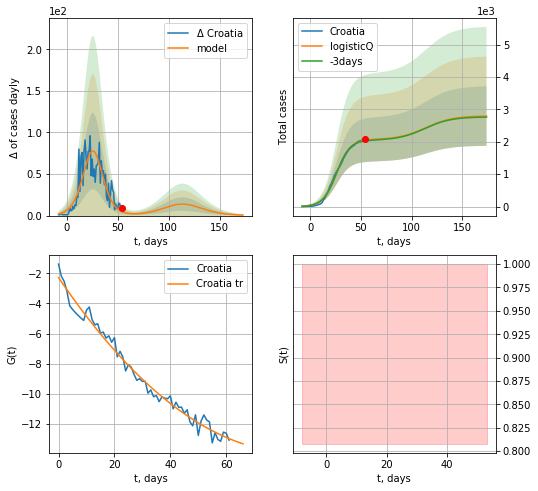

Croatia data at: 2020-05-01
+3 day model MAPE: 0.009727
model: logisticQ
coeffs: [ 2.06699788e+03  1.49437043e-06  2.61390577e+01 -1.00661958e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.328545
forecast at the end of period: +120 days
	 deltaDaycases: 0
	 total cases: 2791 ± 917
	 total death: 100 ± 98
trend coefficient of determination: 0.980829
 intercept_: -2.285062898061895
 coeffs_: [ 0.         -0.27331327  0.00160496]


In [350]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
          date  cases  active  death
52 2020-04-27   4782    3209  337.0
53 2020-04-28   5042    3379  359.0
54 2020-04-29   5268    3553  380.0
55 2020-04-30   5537    3764  392.0
56 2020-05-01   5895    4029  406.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


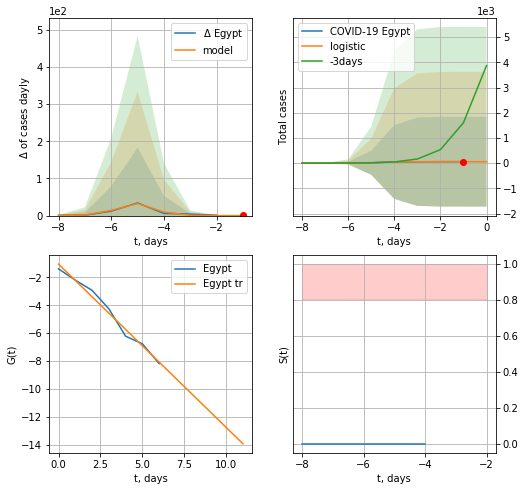

Egypt data at: 2020-05-01
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +1 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  4 ± 365
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


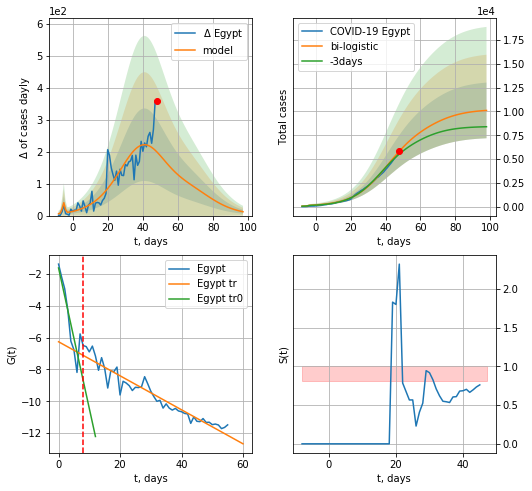

Egypt data at: 2020-05-01
+3 day model MAPE: 0.06085840163891839
model: bi-logistic
coeffs:  [8.12833769e+03 1.03914345e-01 4.05035951e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.2894571682624697
forecast at the end of period: +50 days
	 deltaDaycases:  11
	 total cases:  10104 ± 2924
	 total death:  695 ± 603
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.922607
 intercept: -6.263256
 slope: -0.106836


In [351]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,5*7-dT)
xx = forecast2("Egypt",dfEG[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


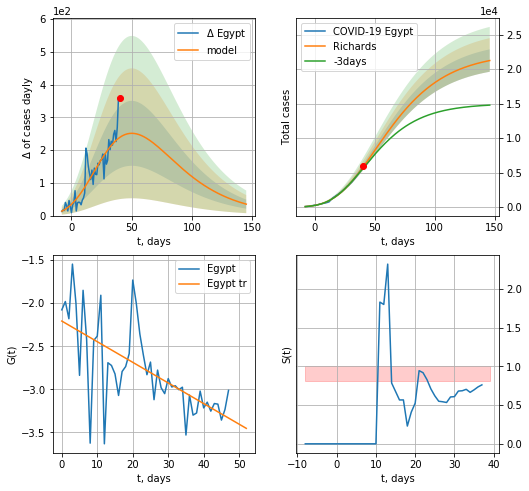

Egypt data at: 2020-05-01
+3 day model MAPE: 0.03387670513579703
model: Richards
coeffs:  [ 2.24025890e+04  1.27273458e+00 -7.00610763e+01  2.42363622e-02]
rational stdev:  0.07649797243956255
forecast at the end of period: +106 days
	 deltaDaycases:  34
	 total cases:  21255 ± 1625
	 total death:  1463 ± 335
trend coefficient of determination: 0.432771
 intercept: -2.207718
 slope: -0.023933


In [352]:
x = forecastRR("Egypt",dfEG[8:],d1,20*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


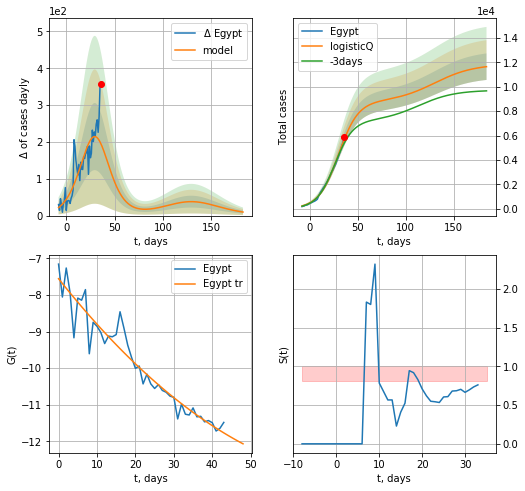

Egypt data at: 2020-05-01
+3 day model MAPE: 0.064483
model: logisticQ
coeffs: [ 8.75764591e+03  2.31329766e-05  2.97975097e+01 -4.18443464e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.093391
forecast at the end of period: +148 days
	 deltaDaycases: 9
	 total cases: 11653 ± 1088
	 total death: 802 ± 224
trend coefficient of determination: 0.923336
 intercept_: -7.553913714650536
 coeffs_: [ 0.        -0.1323093  0.0007971]


In [353]:
x = forecastRRR("Egypt",dfEG[12:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
          date  cases  active  death
55 2020-04-27   1847   473.0   88.0
56 2020-04-28   1928   519.0   90.0
57 2020-04-29   2003   565.0   92.0
58 2020-04-30   2085   617.0   93.0
59 2020-05-01   2153   645.0   94.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


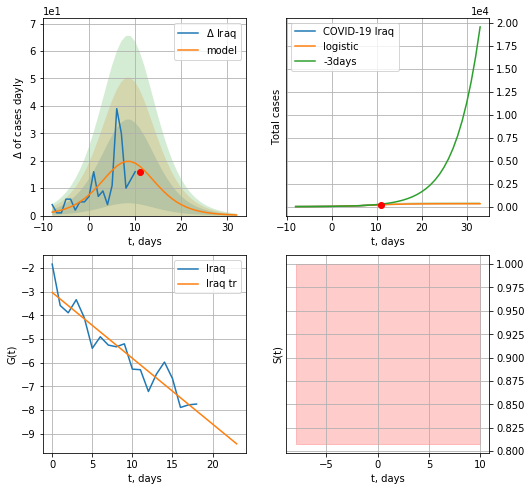

Iraq data at: 2020-05-01
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  316 ± 65
	 total death:  13 ± 8
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


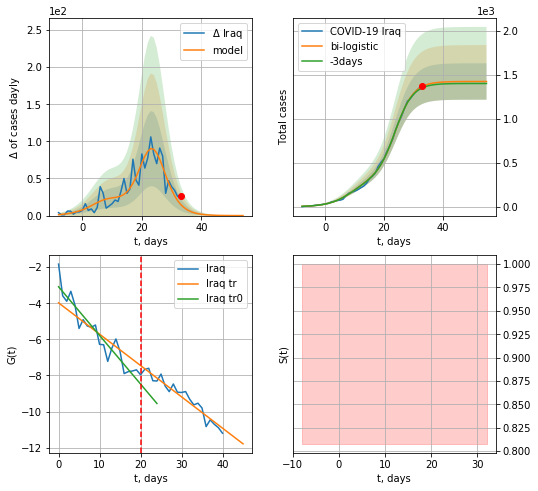

Iraq data at: 2020-05-01
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  1425 ± 207
	 total death:  62 ± 27
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


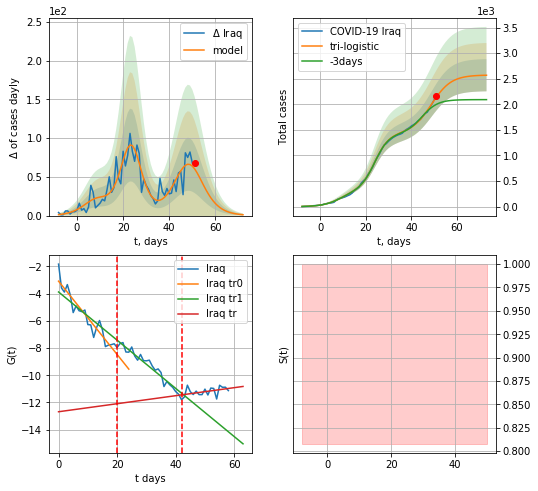

Iraq data at: 2020-05-01
+3 day model MAPE: 0.0894933041506782
model: tri-logistic
coeffs:  [1.14644367e+03 2.31150130e-01 4.88237884e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.12252867787813243
forecast at the end of period: +22 days
	 deltaDaycases:  1
	 total cases:  2568 ± 314
	 total death:  112 ± 41
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.194766
 intercept: -12.683193
 slope: 0.029504


In [354]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
x = forecast("Iraq",dfIQ[:vL],d1,8*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


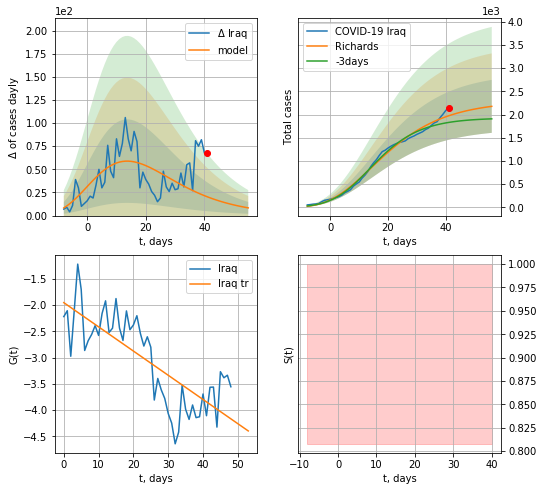

Iraq data at: 2020-05-01
+3 day model MAPE: 0.08324989308596994
model: Richards
coeffs:  [ 2.29598457e+03  5.47661170e+00 -4.79784440e+01  1.28133392e-02]
rational stdev:  0.2621084503323613
forecast at the end of period: +15 days
	 deltaDaycases:  8
	 total cases:  2177 ± 570
	 total death:  95 ± 74
trend coefficient of determination: 0.606179
 intercept: -1.952057
 slope: -0.046086


In [355]:
x = forecastRR("Iraq",dfIQ[10:],d1,7*7-dT)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


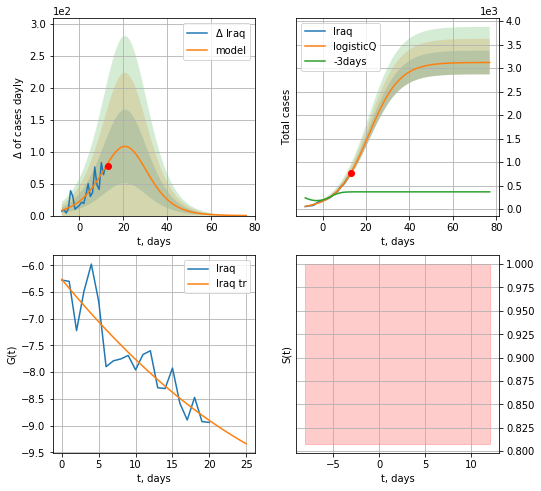

Iraq data at: 2020-05-01
+3 day model MAPE: 1.325310
model: logisticQ
coeffs: [ 3.12023575e+03  1.31776194e-04  2.10594687e+01 -1.03469115e+03]
rational stdev: 0.080850
forecast at the end of period: +64 days
	 deltaDaycases: 0
	 total cases: 3119 ± 252
	 total death: 136 ± 32
trend coefficient of determination: 0.824005
 intercept_: -6.262912434952875
 coeffs_: [ 0.         -0.16770647  0.00178172]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


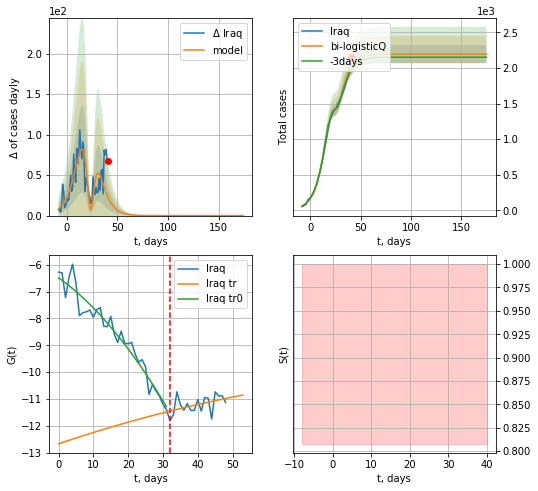

Iraq data at: 2020-05-01
+3 day model MAPE: 0.021603439828035257
model: bi-logisticQ
coeffs:  [-9.25535695e+02  2.78490421e-05  2.39144137e+01 -1.51410503e+04] [ 3.12023575e+03  1.31776194e-04  2.10594687e+01 -1.03469115e+03]
rational stdev:  0.05793788340735471
forecast at the end of period: +134 days
	 deltaDaycases:  0
	 total cases:  2194 ± 127
	 total death:  95 ± 16
bi-logistic approximation splitting point: 32
trend coefficient of determination: 0.943011
 intercept_: -6.485709272215987
 coeffs_: [ 0.         -0.09183938 -0.00203399]
trend coefficient of determination: 0.195599
 intercept_: -12.669022906095176
 coeffs_: [ 0.          0.04387263 -0.00018095]


In [356]:
x = forecastRRR("Iraq",dfIQ[10:32],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[10:],d1,24*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=32)

In [357]:
#len(dfAR)

AR
          date   cases  active  death
54 2020-04-27  3517.0  1527.0  432.0
55 2020-04-28  3649.0  1561.0  437.0
56 2020-04-29  3848.0  1702.0  444.0
57 2020-04-30  4006.0  1777.0  450.0
58 2020-05-01  4154.0  1880.0  453.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


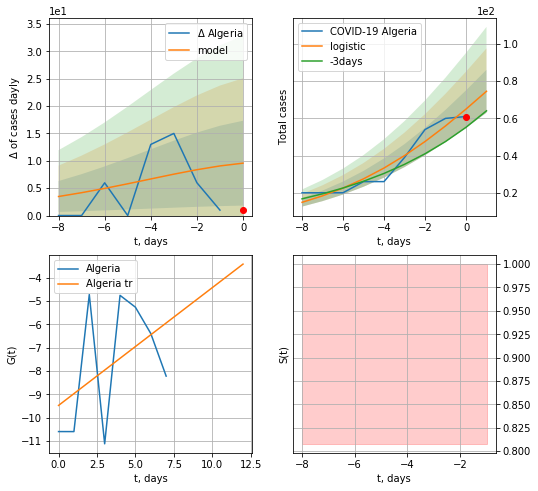

Algeria data at: 2020-05-01
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +1 days
	 deltaDaycases:  9
	 total cases:  74 ± 11
	 total death:  8 ± 3
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


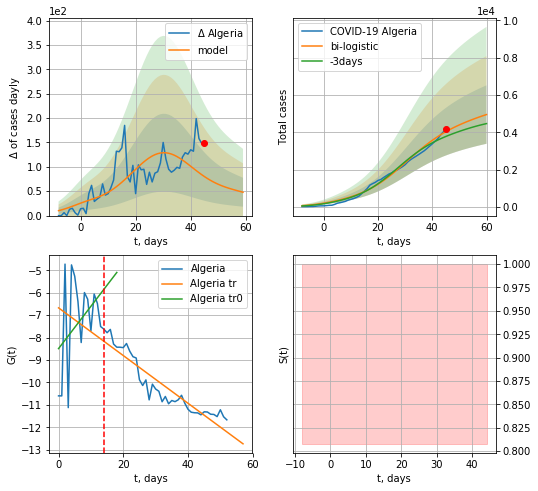

Algeria data at: 2020-05-01
+3 day model MAPE: 0.0718805243905153
model: bi-logistic
coeffs:  [4.39324869e+03 1.13928982e-01 3.02696761e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3160794426198821
forecast at the end of period: +15 days
	 deltaDaycases:  47
	 total cases:  4951 ± 1565
	 total death:  539 ± 511
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.872665
 intercept: -6.676151
 slope: -0.106282


In [358]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,5*7-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


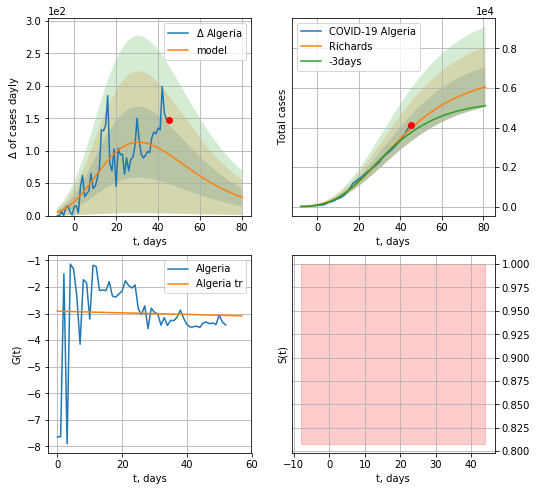

Algeria data at: 2020-05-01
+3 day model MAPE: 0.06102896307141074
model: Richards
coeffs:  [ 6.67155066e+03  4.00730549e+00 -6.49757497e+01  1.15756987e-02]
rational stdev:  0.16768828921876847
forecast at the end of period: +36 days
	 deltaDaycases:  28
	 total cases:  6043 ± 1013
	 total death:  659 ± 331
trend coefficient of determination: 0.001138
 intercept: -2.913514
 slope: -0.003035


In [359]:
x = forecastRR("Algeria",dfAR[5:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


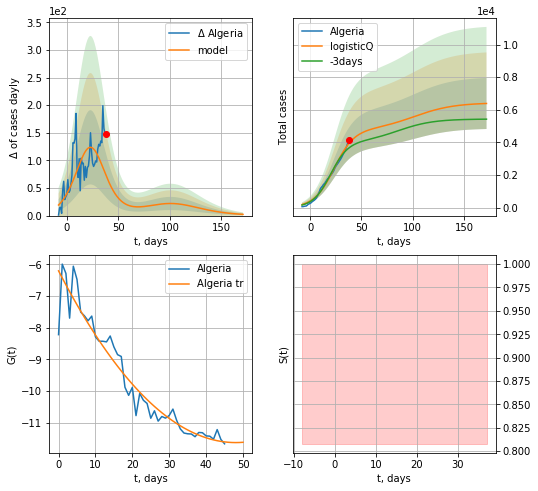

Algeria data at: 2020-05-01
+3 day model MAPE: 0.082929
model: logisticQ
coeffs: [ 4.74574101e+03  1.88263622e-06  2.33116372e+01 -5.46903083e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.245159
forecast at the end of period: +134 days
	 deltaDaycases: 2
	 total cases: 6383 ± 1565
	 total death: 696 ± 511
trend coefficient of determination: 0.925201
 intercept_: -6.20895164534797
 coeffs_: [ 0.         -0.22567621  0.00234981]


In [360]:
x = forecastRRR("Algeria",dfAR[12:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
          date  cases  active  death
46 2020-04-27  822.0   659.0   15.0
47 2020-04-28  837.0   674.0   15.0
48 2020-04-29  843.0   680.0   15.0
49 2020-04-30  850.0   539.0   15.0
50 2020-05-01  857.0   546.0   15.0


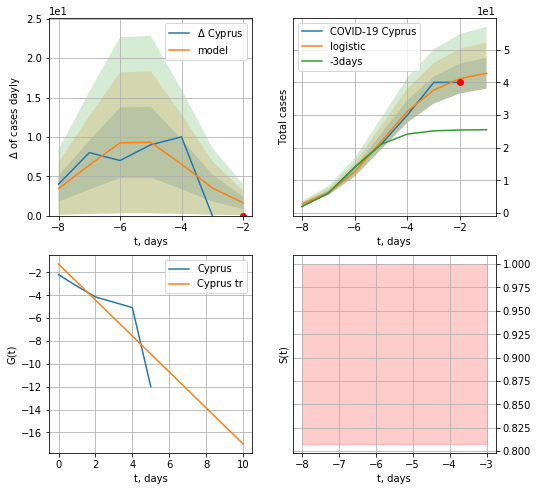

Cyprus data at: 2020-05-01
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +1 days
	 deltaDaycases:  1
	 total cases:  42 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


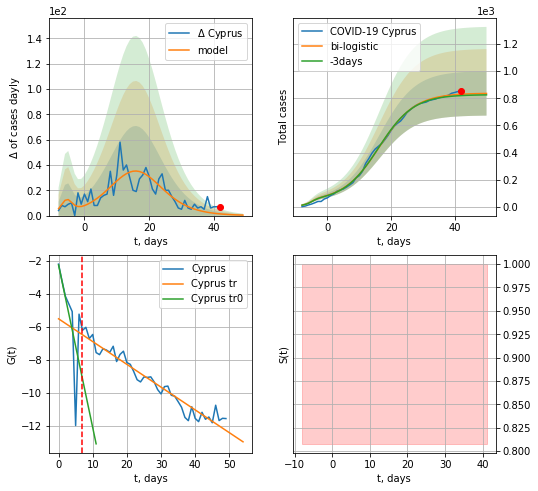

Cyprus data at: 2020-05-01
+3 day model MAPE: 0.012028393342211023
model: bi-logistic
coeffs:  [7.93951486e+02 1.77602067e-01 1.62827623e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.19549372324185707
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  835 ± 163
	 total death:  14 ± 8
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.942000
 intercept: -5.512459
 slope: -0.138093


In [361]:
dfCP = read_df(pd.DataFrame(),"CP")
x = forecast("Cyprus",dfCP[:7],d1,5*7-dT)
xx = forecast2("Cyprus",dfCP[:],d1,6*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)

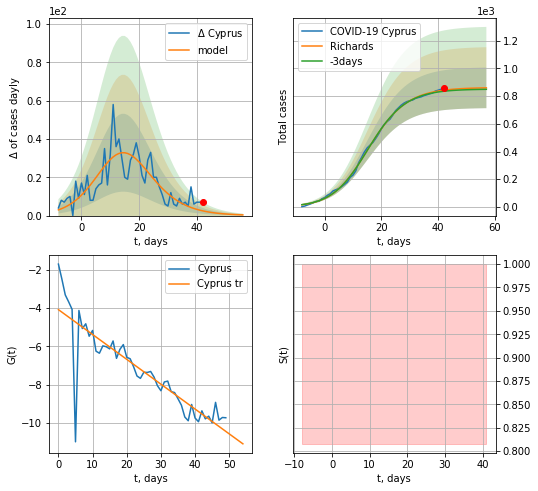

Cyprus data at: 2020-05-01
+3 day model MAPE: 0.009569566232751502
model: Richards
coeffs:  [8.62608400e+02 1.91682533e-01 1.27139583e+01 7.28263013e-01]
rational stdev:  0.17064053232347912
forecast at the end of period: +15 days
	 deltaDaycases:  0
	 total cases:  860 ± 146
	 total death:  15 ± 7
trend coefficient of determination: 0.752190
 intercept: -4.085674
 slope: -0.129622


In [362]:
x = forecastRR("Cyprus",dfCP[:],d1,7*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


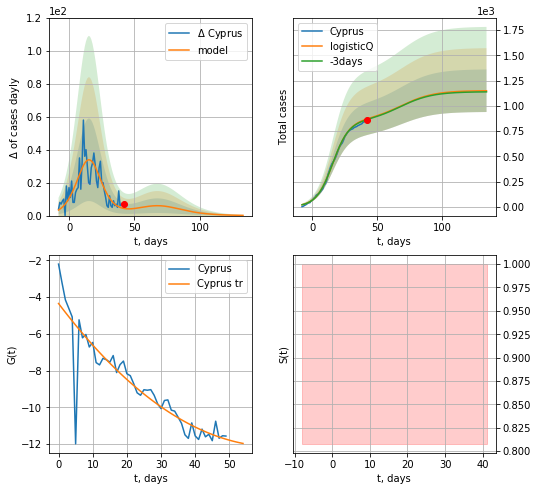

Cyprus data at: 2020-05-01
+3 day model MAPE: 0.007700
model: logisticQ
coeffs: [ 8.50185082e+02  5.13586404e-06  1.56594497e+01 -3.07245825e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.183313
forecast at the end of period: +92 days
	 deltaDaycases: 0
	 total cases: 1149 ± 210
	 total death: 20 ± 10
trend coefficient of determination: 0.812517
 intercept_: -4.342890910147938
 coeffs_: [ 0.         -0.24548216  0.00193263]


In [363]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
          date  cases   active   death
51 2020-04-27  28699  19492.0   782.0
52 2020-04-28  31190  21157.0   854.0
53 2020-04-29  33931  22951.0   943.0
54 2020-04-30  36976  25520.0  1051.0
55 2020-05-01  40459  28206.0  1124.0


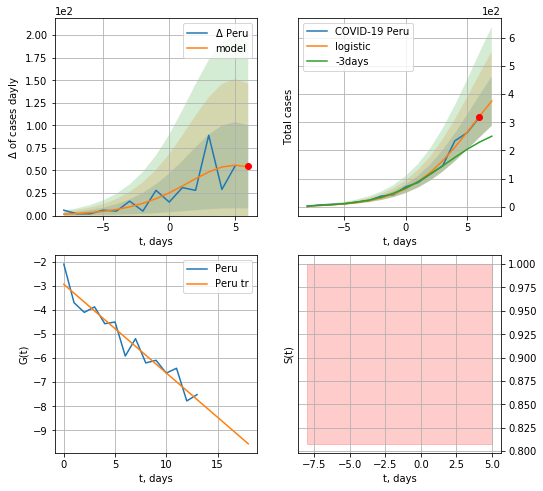

Peru data at: 2020-05-01
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +1 days
	 deltaDaycases:  54
	 total cases:  375 ± 87
	 total death:  10 ± 7
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


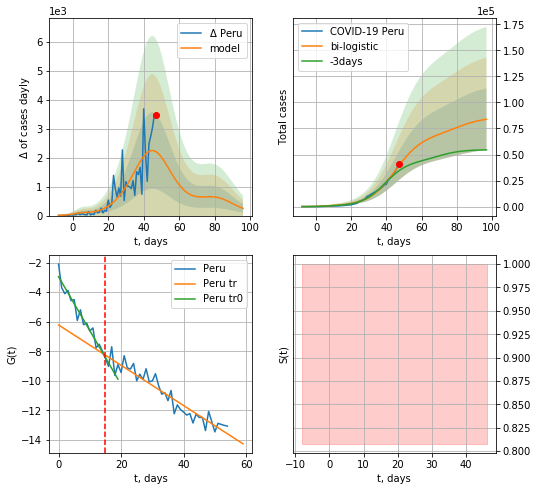

Peru data at: 2020-05-01
+3 day model MAPE: 0.16274508800843787
model: bi-logistic
coeffs:  [6.81904539e+04 1.30617551e-01 4.51823930e+01] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3528035182059672
forecast at the end of period: +50 days
	 deltaDaycases:  248
	 total cases:  83799 ± 29564
	 total death:  2328 ± 2463
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.908816
 intercept: -6.220437
 slope: -0.136305


In [364]:
dfPU = read_df(pd.DataFrame(),"PU")
x = forecast("Peru",dfPU[:15],d1,5*7-dT)
xx = forecast2("Peru",dfPU[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


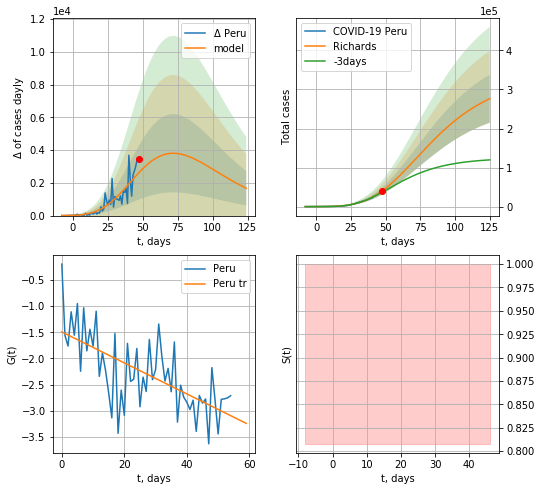

Peru data at: 2020-05-01
+3 day model MAPE: 0.09344385931831568
model: Richards
coeffs:  [ 3.34129601e+05  1.29457795e+00 -4.64587299e+01  2.42209408e-02]
rational stdev:  0.22212102859968477
forecast at the end of period: +78 days
	 deltaDaycases:  1666
	 total cases:  276168 ± 61342
	 total death:  7672 ± 5112
trend coefficient of determination: 0.431593
 intercept: -1.493557
 slope: -0.029539


In [365]:
x = forecastRR("Peru",dfPU[:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


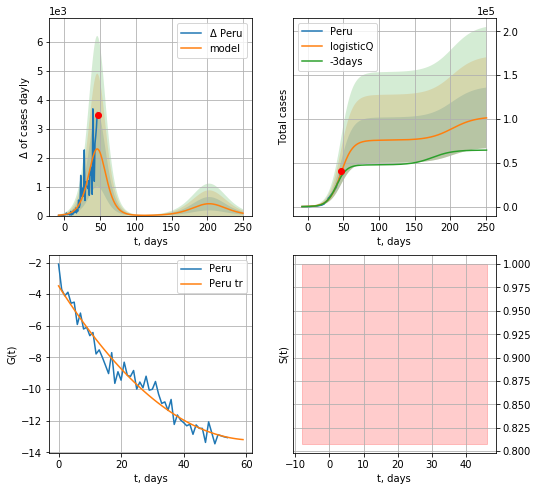

Peru data at: 2020-05-01
+3 day model MAPE: 0.150129
model: logisticQ
coeffs: [ 7.58244929e+04  5.92159072e-06  4.65905225e+01 -2.04532361e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.341680
forecast at the end of period: +204 days
	 deltaDaycases: 81
	 total cases: 101308 ± 34615
	 total death: 2814 ± 2884
trend coefficient of determination: 0.963526
 intercept_: -3.4764925760668186
 coeffs_: [ 0.         -0.31158594  0.00249141]


In [366]:
x = forecastRRR("Peru",dfPU[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
          date  cases   active   death
58 2020-04-27  29451  21375.0   939.0
59 2020-04-28  31332  22577.0  1008.0
60 2020-04-29  33062  23546.0  1079.0
61 2020-04-30  35043  24821.0  1154.0
62 2020-05-01  37336  26106.0  1223.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


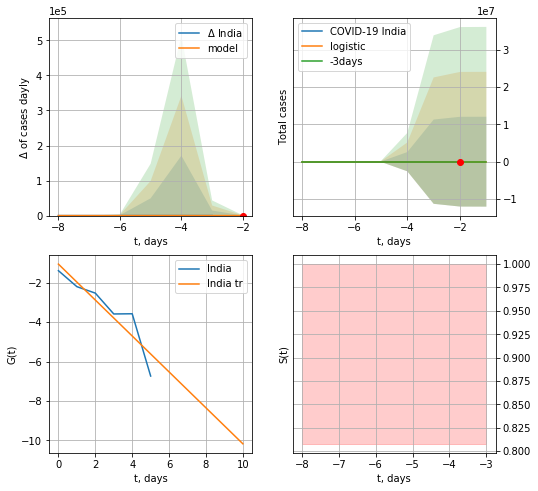

India data at: 2020-05-01
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +1 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035166
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


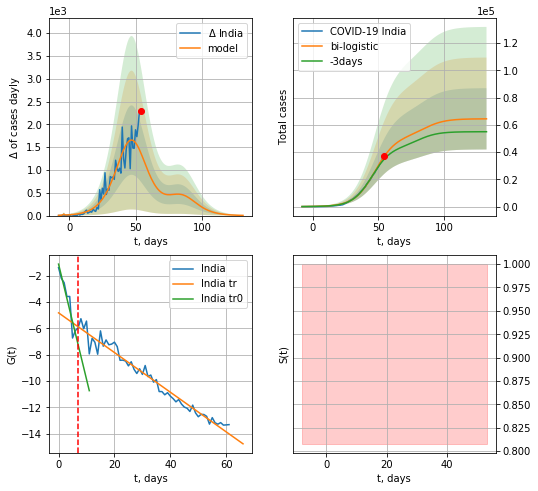

India data at: 2020-05-01
+3 day model MAPE: 0.0639605059100928
model: bi-logistic
coeffs:  [5.15088869e+04 1.27613418e-01 4.73437992e+01] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.34918402500409895
forecast at the end of period: +78 days
	 deltaDaycases:  4
	 total cases:  64381 ± 22481
	 total death:  2108 ± 2208
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.965454
 intercept: -4.819902
 slope: -0.150859


In [367]:
dfID = read_df(pd.DataFrame(),"ID")
x = forecast("India",dfID[:7],d1,5*7-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


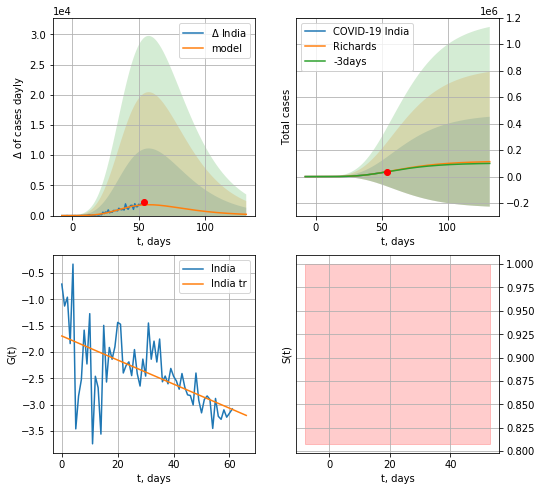

India data at: 2020-05-01
+3 day model MAPE: 0.01863632735117514
model: Richards
coeffs:  [ 1.17483785e+05  1.52883841e+00 -2.70060645e+01  2.76352748e-02]
rational stdev:  3.0166365648963507
forecast at the end of period: +78 days
	 deltaDaycases:  211
	 total cases:  112457 ± 339244
	 total death:  3683 ± 33330
trend coefficient of determination: 0.338996
 intercept: -1.697110
 slope: -0.022840


In [368]:
x = forecastRR("India",dfID[:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


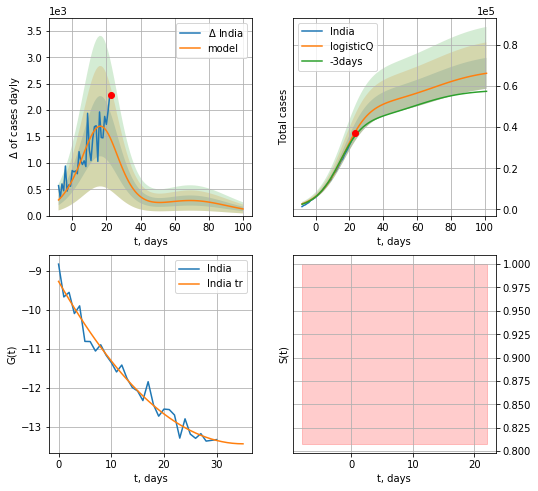

India data at: 2020-05-01
+3 day model MAPE: 0.054637
model: logisticQ
coeffs: [ 5.04915644e+04  4.16598602e-04  1.60751940e+01 -2.98987515e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.113591
forecast at the end of period: +78 days
	 deltaDaycases: 125
	 total cases: 66190 ± 7518
	 total death: 2168 ± 738
trend coefficient of determination: 0.972973
 intercept_: -9.267302135902948
 coeffs_: [ 0.         -0.23741849  0.00338852]


In [369]:
x = forecastRRR("India",dfID[31:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
          date   cases  active  death
54 2020-04-27  4003.0  2666.0  197.0
55 2020-04-28  4127.0  2758.0  207.0
56 2020-04-29  4285.0  2879.0  214.0
57 2020-04-30  4428.0  2954.0  218.0
58 2020-05-01  4532.0  3015.0  225.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


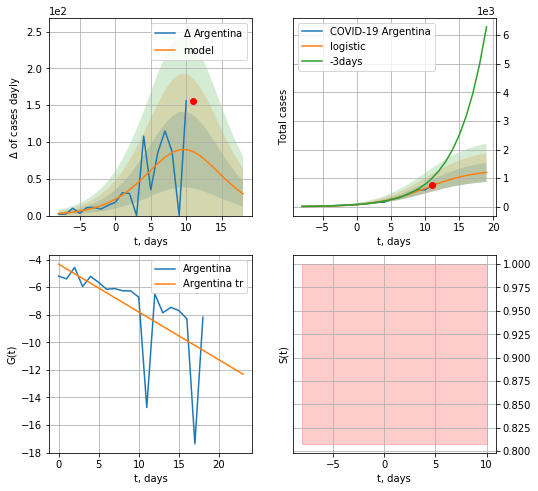

Argentina data at: 2020-05-01
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +8 days
	 deltaDaycases:  29
	 total cases:  1202 ± 333
	 total death:  59 ± 49
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


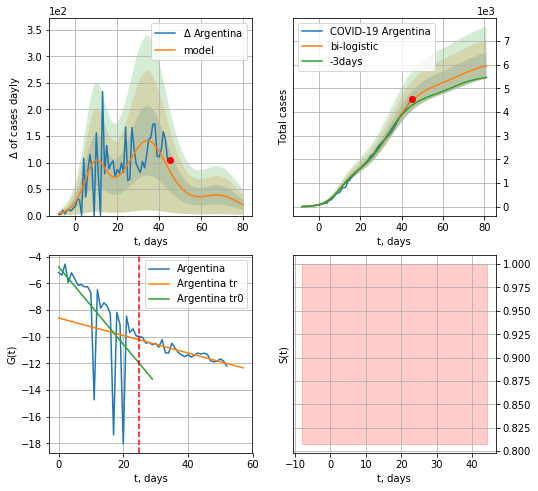

Argentina data at: 2020-05-01
+3 day model MAPE: 0.04810787360255689
model: bi-logistic
coeffs:  [3.84367917e+03 1.46010804e-01 3.48387136e+01] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.09171844086388313
forecast at the end of period: +36 days
	 deltaDaycases:  20
	 total cases:  5951 ± 545
	 total death:  295 ± 81
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.828332
 intercept: -8.598150
 slope: -0.065576


In [370]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,6*7-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,10*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


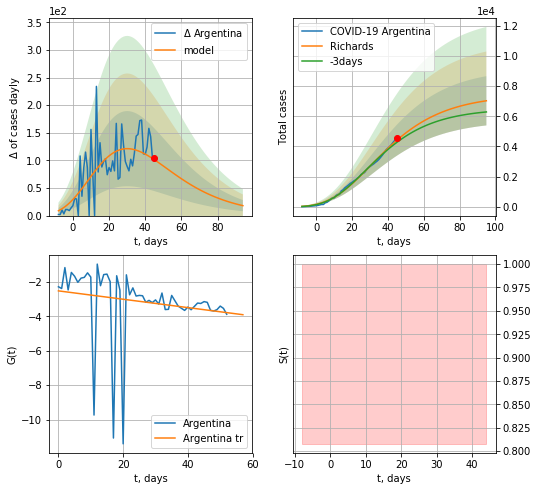

Argentina data at: 2020-05-01
+3 day model MAPE: 0.03522297096727985
model: Richards
coeffs:  [ 7.43381143e+03  3.35405374e+00 -6.63063444e+01  1.33030885e-02]
rational stdev:  0.23212955164930246
forecast at the end of period: +50 days
	 deltaDaycases:  18
	 total cases:  7027 ± 1631
	 total death:  348 ± 242
trend coefficient of determination: 0.033754
 intercept: -2.528855
 slope: -0.024255


In [371]:
x = forecastRR('Argentina',dfAG[5:],d1,12*7-dT,1.0)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


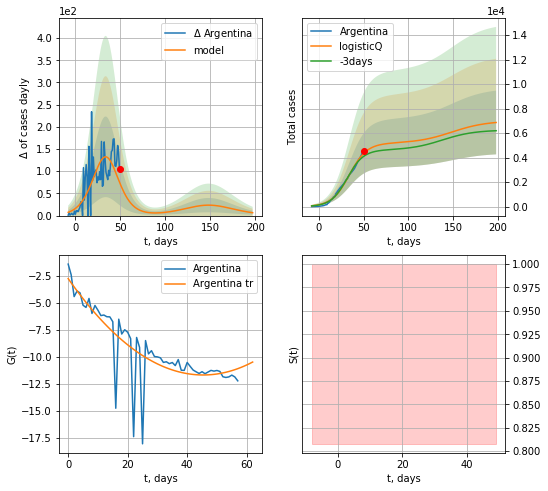

Argentina data at: 2020-05-01
+3 day model MAPE: 0.061338
model: logisticQ
coeffs: [ 5.16728513e+03  2.20690856e-06  3.40677433e+01 -4.63426916e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.378812
forecast at the end of period: +148 days
	 deltaDaycases: 6
	 total cases: 6864 ± 2600
	 total death: 340 ± 386
trend coefficient of determination: 0.666722
 intercept_: -2.7271765274028876
 coeffs_: [ 0.         -0.39327013  0.00433302]


In [372]:
x = forecastRRR('Argentina',dfAG[:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp


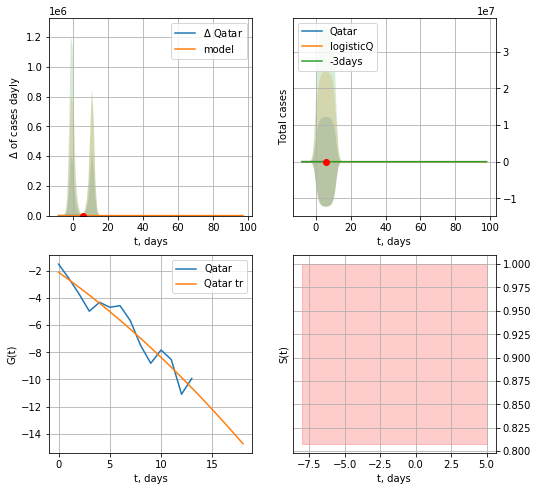

Qatar data at: 2020-05-01
+3 day model MAPE: 10.389766
model: logisticQ
coeffs: [ 4.40923501e+02 -1.12413074e-01  1.14811089e+01  1.00067900e-01]
rational stdev: 28560.888310
forecast at the end of period: +92 days
	 deltaDaycases: 0
	 total cases: 0 ± 0
	 total death: 0 ± 0
trend coefficient of determination: 0.925886
 intercept_: -2.1066548119132458
 coeffs_: [ 0.         -0.53152809 -0.00944941]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:264: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


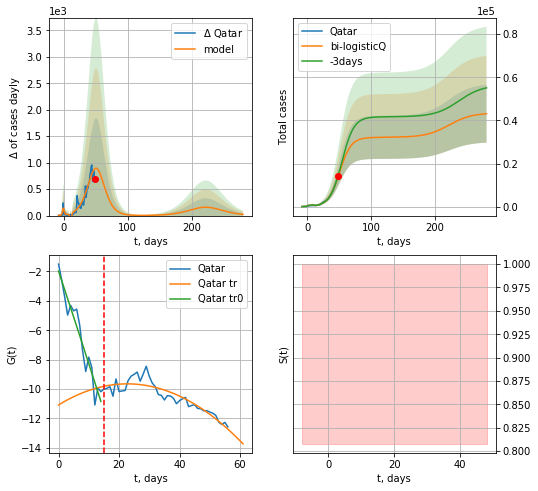

Qatar data at: 2020-05-01
+3 day model MAPE: 0.04307226485361495
model: bi-logisticQ
coeffs:  [ 3.21421186e+04  1.42706144e-05  5.09922191e+01 -7.75446202e+03] [ 4.40923501e+02 -1.12413074e-01  1.14811089e+01  1.00067900e-01]
S.Korea scenario coeffs:  [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev:  0.31144900157449107
forecast at the end of period: +232 days
	 deltaDaycases:  22
	 total cases:  43111 ± 13427
	 total death:  36 ± 33
bi-logistic approximation splitting point: 15
trend coefficient of determination: 0.929567
 intercept_: -1.9786509648817043
 coeffs_: [ 0.         -0.62175364 -0.00080828]
trend coefficient of determination: 0.823623
 intercept_: -11.084170206834015
 coeffs_: [ 0.          0.1264364  -0.00278247]


In [373]:
vL=15
x = forecastRRR('Qatar',dfQR[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:],d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:79: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


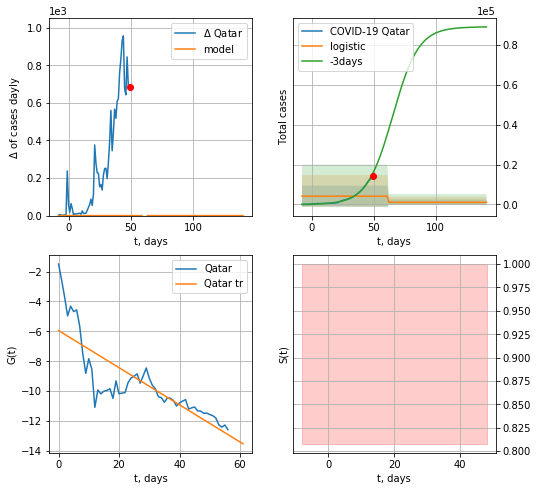

Qatar data at: 2020-05-01
+3 day model MAPE: 0.7485095732981398
model: logistic
coeffs:  [3101.36206897   -9.28824851   61.48001839]
scenario coeffs:  [0.35, 0.5, 4.0, 1]
rational stdev:  1.2591046704286657
forecast at the end of period: +92 days
	 deltaDaycases:  0
	 total cases:  1085 ± 1366
	 total death:  0 ± 0
trend coefficient of determination: 0.671486
 intercept: -5.947911
 slope: -0.124197


In [374]:
x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
          date    cases  active  death
72 2020-04-27  10839.0       0    0.0
73 2020-04-28  11380.0       0    0.0
74 2020-04-29  11929.0       0    0.0
75 2020-04-30  12481.0       0    0.0
76 2020-05-01  13038.0   10384  111.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:129: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


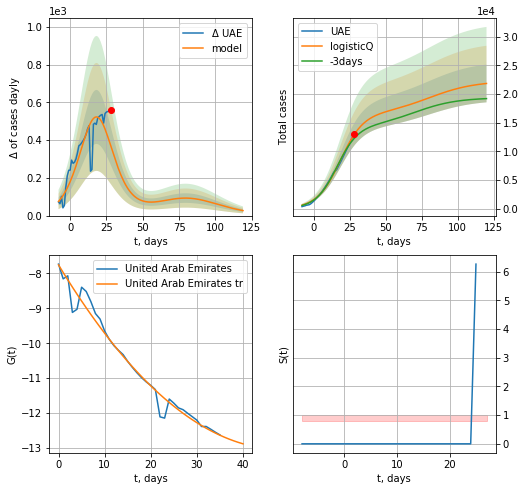

UAE data at: 2020-05-01
+3 day model MAPE: 0.059435
model: logisticQ
coeffs: [ 1.64495933e+04  3.88823958e-06  1.84583464e+01 -3.22658789e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.150795
forecast at the end of period: +92 days
	 deltaDaycases: 26
	 total cases: 21832 ± 3292
	 total death: 185 ± 83
trend coefficient of determination: 0.972728
 intercept_: -7.754460755320794
 coeffs_: [ 0.         -0.21846832  0.00225604]


In [375]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


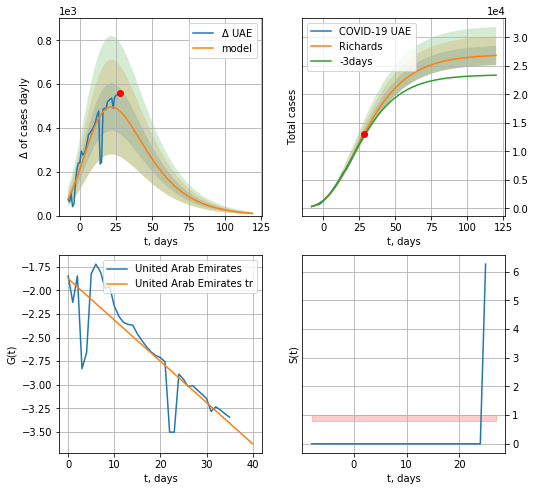

UAE data at: 2020-05-01
+3 day model MAPE: 0.02874909034395536
model: Richards
coeffs:  [ 2.69939291e+04  2.51289228e+00 -5.53175885e+01  2.00536081e-02]
rational stdev:  0.06245139222992612
forecast at the end of period: +92 days
	 deltaDaycases:  10
	 total cases:  26798 ± 1673
	 total death:  228 ± 42
trend coefficient of determination: 0.743269
 intercept: -1.877966
 slope: -0.043672


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


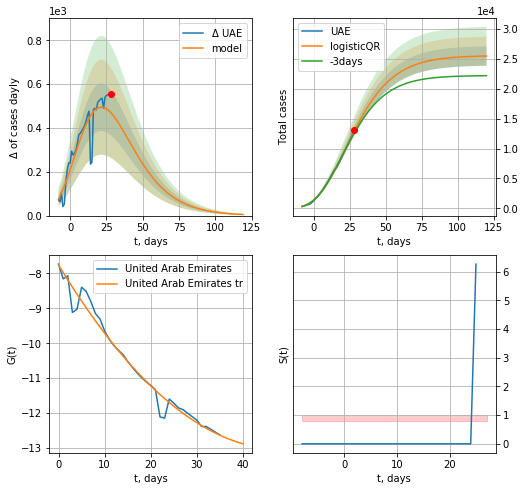

UAE data at: 2020-05-01
+3 day model MAPE: 0.029992344236662492
model: logisticQR
coeffs:  [ 2.55201019e+04  1.06615935e-02 -9.08055631e+01 -6.65684865e+02
  6.20743401e-03]
rational stdev:  0.06366180048991449
forecast at the end of period: +92 days
	 deltaDaycases:  4
	 total cases:  25448 ± 1620
	 total death:  216 ± 41
trend coefficient of determination: 0.972728
 intercept_: -7.754460755320794
 coeffs_: [ 0.         -0.21846832  0.00225604]


In [376]:
x = forecastRR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [386]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
          date    cases  active  death
55 2020-04-27  18811.0       0    0.0
56 2020-04-28  20077.0       0    0.0
57 2020-04-29  21402.0       0    0.0
58 2020-04-30  22753.0       0    0.0
59 2020-05-01  24097.0   20373  169.0


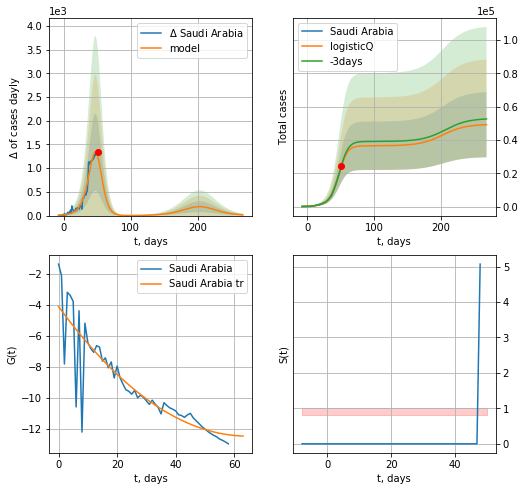

Saudi Arabia data at: 2020-05-01
+3 day model MAPE: 0.018335
model: logisticQ
coeffs: [ 3.64651648e+04  8.29229278e-04  4.65564400e+01 -1.29994391e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.397939
forecast at the end of period: +218 days
	 deltaDaycases: 14
	 total cases: 49140 ± 19554
	 total death: 344 ± 410
trend coefficient of determination: 0.779217
 intercept_: -4.122979369841758
 coeffs_: [ 0.         -0.25847032  0.00199846]


In [88]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


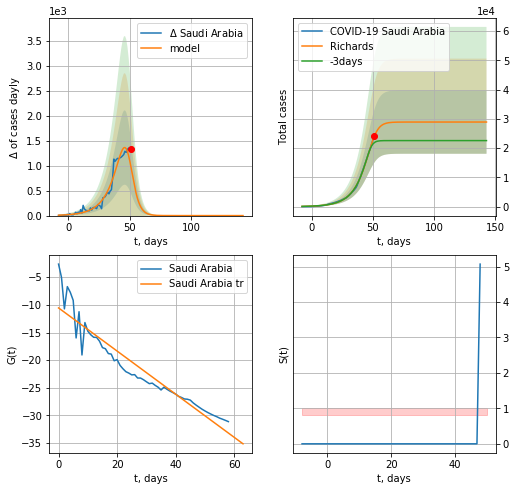

Saudi Arabia data at: 2020-05-01
+3 day model MAPE: 0.12403020087173978
model: Richards
coeffs:  [2.89007269e+04 1.03426200e-01 4.98071308e+01 2.79742660e+00]
rational stdev:  0.37491339576218013
forecast at the end of period: +92 days
	 deltaDaycases:  0
	 total cases:  28900 ± 10835
	 total death:  202 ± 227
trend coefficient of determination: 0.899865
 intercept: -10.551746
 slope: -0.390066


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


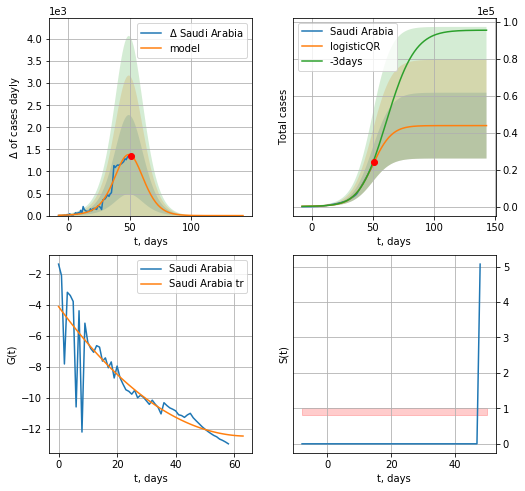

Saudi Arabia data at: 2020-05-01
+3 day model MAPE: 0.06870124833595931
model: logisticQR
coeffs:  [ 4.38817541e+04  1.42835846e-03 -8.54636013e+01  4.15663013e+01
  5.34481354e-01]
rational stdev:  0.40615758610054775
forecast at the end of period: +92 days
	 deltaDaycases:  0
	 total cases:  43881 ± 17822
	 total death:  307 ± 374
trend coefficient of determination: 0.779217
 intercept_: -4.122979369841758
 coeffs_: [ 0.         -0.25847032  0.00199846]


In [388]:
x = forecastRR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
x = forecastQR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [435]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
    "UAE":"UAE",
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [11]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=13:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13]
1:"Country,Other"
2:"TotalCases"
3:"NewCases"
4:"TotalDeaths"
5:"NewDeaths"
6:"TotalRecovered"
7:"ActiveCases"
8:"Serious,Critical"
9:"Tot Cases/1M pop"
10:"Deaths/1M pop"
11:"TotalTests"
12:"Tests/
1M pop
"
13:"Continent"
[461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461]


In [12]:
df.head(10)

,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,"954,532",North America,\nNorth America\n,,"+2,298",140,"17,724",,"1,227,253","71,920","200,801",,
1,"742,300",Europe,\nEurope\n,,79,12,"18,030",,"1,399,142","137,421","519,421",,
2,"239,144",Asia,\nAsia\n,,136,2,"5,627",,"533,977","18,963","275,870",,
3,"116,920",South America,\nSouth America\n,,222,6,"9,816",,"190,321","9,486","63,915",,
4,"1,127",Australia/Oceania,\nOceania\n,,19,1,31,,"8,367",113,"7,127",,
5,"25,915",Africa,\nAfrica\n,,91,5,126,,"41,537","1,696","13,926",,
6,61,,\n\n,,,,4,,721,15,645,,
7,"2,079,999",All,World,30.7,"+2,845",166,"51,358",,"3,401,318","239,614","1,081,705",,436
8,"904,113",North America,USA,199,422,23,"16,481","20,241","1,131,452","65,776","161,563","6,699,878","3,418"
9,"75,714",Europe,Spain,531,,,"2,500","32,699","242,988","24,824","142,450","1,528,833","5,197"


In [13]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",df.columns[3]:"Deathsper1Mpop","Serious,Critical":"Serious_Critical",df.columns[7]:"Testsper1Mpop",df.columns[12]:"TotCasesper1Mpop"})
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,"954,532",North America,\nNorth America\n,,"+2,298",140,"17,724",,"1,227,253","71,920","200,801",,
1,"742,300",Europe,\nEurope\n,,79,12,"18,030",,"1,399,142","137,421","519,421",,
2,"239,144",Asia,\nAsia\n,,136,2,"5,627",,"533,977","18,963","275,870",,
3,"116,920",South America,\nSouth America\n,,222,6,"9,816",,"190,321","9,486","63,915",,
4,"1,127",Australia/Oceania,\nOceania\n,,19,1,31,,"8,367",113,"7,127",,


In [14]:
df[df["Country"]=="Lithuania"]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
89,760,Europe,Lithuania,17,,,17,"48,771","1,399",45,594,"132,768",514
321,760,Europe,Lithuania,17,14,,17,"48,771","1,399",45,594,"132,768",514


In [15]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

230


In [16]:
df.head(22)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,"954,532",North America,\nNorth America\n,,"+2,298",140,"17,724",,"1,227,253","71,920","200,801",,
1,"742,300",Europe,\nEurope\n,,79,12,"18,030",,"1,399,142","137,421","519,421",,
2,"239,144",Asia,\nAsia\n,,136,2,"5,627",,"533,977","18,963","275,870",,
3,"116,920",South America,\nSouth America\n,,222,6,"9,816",,"190,321","9,486","63,915",,
4,"1,127",Australia/Oceania,\nOceania\n,,19,1,31,,"8,367",113,"7,127",,
5,"25,915",Africa,\nAfrica\n,,91,5,126,,"41,537","1,696","13,926",,
6,61,,\n\n,,,,4,,721,15,645,,
7,"2,079,999",All,World,30.7,"+2,845",166,"51,358",,"3,401,318","239,614","1,081,705",,436
8,"904,113",North America,USA,199,422,23,"16,481","20,241","1,131,452","65,776","161,563","6,699,878","3,418"
9,"75,714",Europe,Spain,531,,,"2,500","32,699","242,988","24,824","142,450","1,528,833","5,197"


In [17]:
df.at[11, 'TotalRecovered'] = 0
df.at[21, 'TotalRecovered'] = 0
#df.at[12, 'TotalRecovered'] = 0


In [18]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,954532,North America,\nNorth America\n,NaN,2298.0,140.0,17724.0,NaN,1227253,71920.0,200801.0,NaN,NaN
1,742300,Europe,\nEurope\n,NaN,79.0,12.0,18030.0,NaN,1399142,137421.0,519421.0,NaN,NaN
2,239144,Asia,\nAsia\n,NaN,136.0,2.0,5627.0,NaN,533977,18963.0,275870.0,NaN,NaN
3,116920,South America,\nSouth America\n,NaN,222.0,6.0,9816.0,NaN,190321,9486.0,63915.0,NaN,NaN
4,1127,Australia/Oceania,\nOceania\n,NaN,19.0,1.0,31.0,NaN,8367,113.0,7127.0,NaN,NaN
5,25915,Africa,\nAfrica\n,NaN,91.0,5.0,126.0,NaN,41537,1696.0,13926.0,NaN,NaN
6,61,,\n\n,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
7,2079999,All,World,30.7,2845.0,166.0,51358.0,NaN,3401318,239614.0,1081705.0,NaN,436.0
8,904113,North America,USA,199.0,422.0,23.0,16481.0,20241.0,1131452,65776.0,161563.0,6699878.0,3418.0
9,75714,Europe,Spain,531.0,NaN,NaN,2500.0,32699.0,242988,24824.0,142450.0,1528833.0,5197.0


In [19]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,116920,South America,Total:,NaN,222.0,6.0,9816.0,NaN,190321,9486.0,63915.0,NaN,NaN
226,1127,Australia/Oceania,Total:,NaN,19.0,1.0,31.0,NaN,8367,113.0,7127.0,NaN,NaN
227,25915,Africa,Total:,NaN,91.0,5.0,126.0,NaN,41537,1696.0,13926.0,NaN,NaN
228,61,,Total:,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
229,447423,Europe,European Union,237.551663,79.0,12.0,13378.0,23623.957007,1022788,105770.0,469345.0,10518579.0,2297.106837


In [20]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,954532,North America,North America,NaN,2298.0,140.0,17724.0,NaN,1227253,71920.0,200801.0,NaN,NaN
1,742300,Europe,Europe,NaN,79.0,12.0,18030.0,NaN,1399142,137421.0,519421.0,NaN,NaN
2,239144,Asia,Asia,NaN,136.0,2.0,5627.0,NaN,533977,18963.0,275870.0,NaN,NaN
3,116920,South America,South America,NaN,222.0,6.0,9816.0,NaN,190321,9486.0,63915.0,NaN,NaN
4,1127,Australia/Oceania,Oceania,NaN,19.0,1.0,31.0,NaN,8367,113.0,7127.0,NaN,NaN


In [21]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [22]:
#df

In [23]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,954532,North America,North America,NaN,2298.0,140.0,17724.0,NaN,1227253,71920.0,200801.0,NaN,NaN
1,742300,Europe,Europe,NaN,79.0,12.0,18030.0,NaN,1399142,137421.0,519421.0,NaN,NaN
2,239144,Asia,Asia,NaN,136.0,2.0,5627.0,NaN,533977,18963.0,275870.0,NaN,NaN
3,116920,South America,South America,NaN,222.0,6.0,9816.0,NaN,190321,9486.0,63915.0,NaN,NaN
4,1127,Australia/Oceania,Oceania,NaN,19.0,1.0,31.0,NaN,8367,113.0,7127.0,NaN,NaN
5,25915,Africa,Africa,NaN,91.0,5.0,126.0,NaN,41537,1696.0,13926.0,NaN,NaN
7,2079999,All,World,30.7,2845.0,166.0,51358.0,NaN,3401318,239614.0,1081705.0,NaN,436.0
8,904113,North America,USA,199.0,422.0,23.0,16481.0,20241.0,1131452,65776.0,161563.0,6699878.0,3418.0
9,75714,Europe,Spain,531.0,NaN,NaN,2500.0,32699.0,242988,24824.0,142450.0,1528833.0,5197.0
10,100943,Europe,Italy,467.0,NaN,NaN,1578.0,33962.0,207428,28236.0,78249.0,2053425.0,3431.0


In [24]:
df.to_csv('/home/algiz/Desktop/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [25]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

World World
European Union EU
Spain SP
Malta MT
Iceland IC
Malaysia ML
Morocco MR
UAE UAE
Greece GC
Iraq IQ
Canada CA
Croatia CT
Belgium BG
Pakistan PK
Turkey TR
Poland PL
Indonesia IE
Saudi Arabia SA
Philippines PH
Slovenia SV
Slovakia SL
Panama PM
Germany GR
Egypt EG
Peru PU
Ukraine Ukr
Belarus BR
Estonia ES
UK GB
Romania RM
S. Korea KR
Mexico MX
Netherlands NL
Luxembourg LX
Italy IT
Iran IN
Sweden SW
Australia AS
Serbia SB
Denmark DK
Thailand TH
Bulgaria BL
Portugal PT
France FR
Japan JP
USA US
Argentina AG
Hungary HG
Lithuania LT
Czechia CH
Cyprus CP
Singapore SG
Brazil BZ
Switzerland SZ
Chile CL
Norway NG
Austria AT
Latvia LV
India ID
Ireland IR
Algeria AR
Colombia CB
Ecuador ED
Russia RS
New Zealand ZL
Qatar QR
Finland FI
China CN
Israel IS


In [26]:
df = pd.read_csv('/home/algiz/Desktop/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-05-01,1227253,954532,71920.0
Europe
Europe 2020-05-01,1399142,742300,137421.0
Asia
Asia 2020-05-01,533977,239144,18963.0
South America
South America 2020-05-01,190321,116920,9486.0
Oceania
Oceania 2020-05-01,8367,1127,113.0
Africa
Africa 2020-05-01,41537,25915,1696.0
World
World 2020-05-01,3401318,2079999,239614.0
USA
USA 2020-05-01,1131452,904113,65776.0
Spain
Spain 2020-05-01,242988,75714,24824.0
Italy
Italy 2020-05-01,207428,100943,28236.0
UK
UK 2020-05-01,177454,149600,27510.0
France
France 2020-05-01,167346,92540,24594.0
Germany
Germany 2020-05-01,164077,30441,6736.0
Turkey
Turkey 2020-05-01,122392,65326,3258.0
Russia
Russia 2020-05-01,114431,100042,1169.0
Iran
Iran 2020-05-01,95646,13237,6091.0
Brazil
Brazil 2020-05-01,92202,47751,6412.0
Canada
Canada 2020-05-01,55061,28919,3391.0
Belgium
Belgium 2020-05-01,49032,29437,7703.0
Peru
Peru 2020-05-01,40459,28206,1124.0
Netherlands
Netherlands 2020-05-01,39791,34648,4893.0
India
India 2020-05-01,37336,

British Virgin Islands
British Virgin Islands 2020-05-01,6,2,1.0
Caribbean Netherlands
Caribbean Netherlands 2020-05-01,6,6,nan
St. Barth
St. Barth 2020-05-01,6,0,nan
Western Sahara
Western Sahara 2020-05-01,6,1,nan
Anguilla
Anguilla 2020-05-01,3,0,nan
Comoros
Comoros 2020-05-01,1,1,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-05-01,1,1,nan
China
China 2020-05-01,82875,557,4633.0
Total:
Total: 2020-05-01,1227253,954532,71920.0
Total:
Total: 2020-05-01,1227253,954532,71920.0
Total:
Total: 2020-05-01,1227253,954532,71920.0
Total:
Total: 2020-05-01,1227253,954532,71920.0
Total:
Total: 2020-05-01,1227253,954532,71920.0
Total:
Total: 2020-05-01,1227253,954532,71920.0
Total:
Total: 2020-05-01,1227253,954532,71920.0
European Union
European Union 2020-05-01,1022788,447423,105770.0


In [27]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [28]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("corona%sOneRaw.csv"%(c),'r')
    fff = open("/home/algiz/Desktop/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append /home/algiz/Desktop/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append /home/algiz/Desktop/coronaWorld.csv 2020-05-01,3401318,2079999,239614.0

append /home/algiz/Desktop/coronaEU.csv 2020-05-01,1022788,447423,105770.0

append /home/algiz/Desktop/coronaSP.csv 2020-05-01,242988,75714,24824.0

append /home/algiz/Desktop/coronaMT.csv 2020-05-01,467,80,4.0

append /home/algiz/Desktop/coronaIC.csv 2020-05-01,1798,99,10.0

append /home/algiz/Desktop/coronaML.csv 2020-05-01,6071,1758,103.0

append /home/algiz/Desktop/coronaMR.csv 2020-05-01,4569,3315,171.0

append /home/algiz/Desktop/coronaUAE.csv 2020-05-01,13038,10384,111.0

append /home/algiz/Desktop/coronaGC.csv 2020-05-01,2612,1098,140.0

append /home/algiz/Desktop/coronaIQ.csv 2020-05-01,2153,645,94.0

append /home/algiz/Desktop/coronaCA.csv 2020-05-01,55061,28919,3391.0

append /home/algiz/Desktop/coronaCT.csv 2020-05-01,2085,589,75.0

append /home/algiz/Desktop/coronaBG.csv 2020-05-01,49032,29437,7703.0

append /home/algiz/Desktop/coronaPK.csv 2020-05-01,18114,12982,417.0

append /home/algiz/Deskt

In [283]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("europa_corona.csv", index=False)

In [285]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%(cD3[c]), index=False)#countryDic1

South Africa 0


In [911]:
#dfRM = read_df(pd.DataFrame(),"RM")

RM
          date  cases  active
29 2020-04-01   2245     NaN
30 2020-04-02   2460     NaN
31 2020-04-03   2738     NaN
32 2020-04-04   3183     NaN
33 2020-04-05   3613     0.0


In [892]:
dfc.head()#[['date', 'cases']]

,date,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2018
6873,2020-02-27,27,2,2020,1,0,Romania,RO,ROU,19473936.0
6871,2020-02-29,29,2,2020,3,0,Romania,RO,ROU,19473936.0
6868,2020-03-04,4,3,2020,4,0,Romania,RO,ROU,19473936.0
6867,2020-03-06,6,3,2020,6,0,Romania,RO,ROU,19473936.0
6866,2020-03-07,7,3,2020,7,0,Romania,RO,ROU,19473936.0


In [875]:
date(2012, 3, 16)

datetime.date(2012, 3, 16)

In [7]:
len(countriesEU)

27

In [309]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

World 549497


In [328]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


7185.14611304862

In [287]:
#dfD

In [339]:
#dfAll[dfAll['Country'].isin(cLst)]

In [323]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

13905339.0 1787.8701656037852


In [309]:
TT/7.7776e3

2344.341827813207

In [335]:
sum(dfp.Population)/1e6

16014.157998

In [282]:
dfAll[dfAll.TotalTests>0]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
7,456815,North America,USA,57.000000,0.0,0.0,10917.0,7670.000000,502876,18747.0,27314.0,2538888.0,1519.000000
8,86524,Europe,Spain,344.000000,0.0,0.0,7371.0,7593.000000,158273,16081.0,55668.0,355000.0,3385.000000
9,98273,Europe,Italy,312.000000,0.0,0.0,3497.0,14999.000000,147577,18849.0,30455.0,906864.0,2441.000000
10,86740,Europe,France,202.000000,0.0,0.0,7004.0,5114.000000,124869,13197.0,24932.0,333807.0,1913.000000
11,65522,Europe,Germany,33.000000,0.0,0.0,4895.0,15730.000000,122171,2736.0,53913.0,1317887.0,1458.000000
12,64456,Europe,UK,132.000000,0.0,0.0,1559.0,4667.000000,73758,8958.0,344.0,316836.0,1086.000000
13,28495,Asia,Iran,50.000000,0.0,0.0,3969.0,2888.000000,68192,4232.0,35465.0,242568.0,812.000000
14,43600,Asia,Turkey,12.000000,0.0,0.0,1667.0,3643.000000,47029,1006.0,2423.0,307210.0,558.000000
15,18080,Europe,Belgium,260.000000,0.0,0.0,1278.0,7269.000000,26667,3019.0,5568.0,84248.0,2301.000000
16,12449,Europe,Switzerland,116.000000,0.0,0.0,386.0,20625.000000,24551,1002.0,11100.0,178500.0,2837.000000


In [272]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [300]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [301]:
#cDicEU["Ireland"][1]

In [393]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445

23637.256179775282

In [468]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [469]:
#dfAll

In [394]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/7.777e3

4545.447216150186

In [78]:
CList = ["USA",
"Spain",
"Italy",
"UK",
"France",
"Germany",
"Turkey",
"Russia",
"Iran",
"Brazil",
"Canada",
"Belgium",
"Peru",
"Netherlands",
"India",
"Switzerland",
"Ecuador",
"Portugal",
"Saudi Arabia",
"Sweden",
"Ireland",
"Mexico",
"Pakistan",
"Singapore",
"Chile",
"Israel",
"Austria",
"Belarus",
"Japan",
"Qatar",
"Poland",
"UAE",
"Romania",
"Ukraine",
"South_Korea",
"Indonesia",
"Denmark",
"Serbia",
"Philippines",
"Norway",
"Czechia",
"Colombia",
"Australia",
"Malaysia",
"Egypt",
"Finland",
"Morocco",
"Argentina",
"Algeria",
"Moldova",
"Luxembourg",
"Thailand",
"Hungary",
"Greece",
"Iraq",
"Croatia",
"Iceland",
"Estonia",
"Bulgaria",
"New_Zealand",
"Slovenia",
"Slovakia",
"Lithuania",
"Latvia",
"Cyprus",
"Malta"
]

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)